In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)     

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

C:\Users\User\AppData\Local\Temp\ipykernel_22476\4164614309.py:383: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.42725031 0.69695044 0.32924264 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.51683609 0.42215989 ... 0.66276202 0.49013564 0.22934649]
 [0.43218249 0.62674714 0.3411641  ... 0.37854501 0.40197287 0.23181258]
 ...
 [0.47102343 0.46473952 0.46949509 ... 0.43218249 0.47163995 0.33908755]
 [0.43464858 0.51620076 0.3997195  ... 0.51911221 0.46300863 0.21454994]
 [0.44389642 0.52414231 0.42356241 ... 0.50184957 0.52034525 0.30641184]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.43464858 0.62313675 0.34639831 ... 0.38902589 0.41122072 0.1701603 ]
 [0.42725031 0.71548931 0.32450565 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.53175632 0.4180791  ... 0.66276202 0.49013564 0.22934649]
 ...
 [0.47102343 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 03:57:53,762] A new study created in memory with name: no-name-c3d19e64-5baa-4f87-80f0-4510fa4f5d8f
[I 2025-05-18 04:05:28,710] Trial 0 finished with value: 0.08733056783676148 and parameters: {'lr': 0.006852772587838959, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24291603209456925}. Best is trial 0 with value: 0.08733056783676148.


Cross Validation Accuracies:
[0.0870104432106018, 0.08195406198501587, 0.10535269230604172, 0.08527377247810364, 0.07706186920404434]
Mean Cross Validation Accuracy:
0.08733056783676148
Standard Deviation of Cross Validation Accuracy:
0.009627905733785738


[I 2025-05-18 04:11:02,200] Trial 1 finished with value: 0.06515960693359375 and parameters: {'lr': 0.034521967987560485, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.126616018619194}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.0586191862821579, 0.060745421797037125, 0.07266683131456375, 0.0740114226937294, 0.059755172580480576]
Mean Cross Validation Accuracy:
0.06515960693359375
Standard Deviation of Cross Validation Accuracy:
0.006725817475255363


[I 2025-05-18 04:18:19,827] Trial 2 finished with value: 0.08201485127210617 and parameters: {'lr': 0.9671450393625394, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.19840189991171414}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.07461289316415787, 0.07596247643232346, 0.08993038535118103, 0.08309178799390793, 0.08647671341896057]
Mean Cross Validation Accuracy:
0.08201485127210617
Standard Deviation of Cross Validation Accuracy:
0.005918511828328963


[I 2025-05-18 04:25:51,734] Trial 3 finished with value: 0.07097347155213356 and parameters: {'lr': 0.002093375360864706, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25039931514661645}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.0591355562210083, 0.06806645542383194, 0.08030017465353012, 0.08669491857290268, 0.06067025288939476]
Mean Cross Validation Accuracy:
0.07097347155213356
Standard Deviation of Cross Validation Accuracy:
0.01085259954239311


[I 2025-05-18 04:30:31,259] Trial 4 finished with value: 0.09490444511175156 and parameters: {'lr': 0.009893087760109803, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.49491515706269795}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.09857993572950363, 0.08530549705028534, 0.08563227951526642, 0.11095461249351501, 0.09404990077018738]
Mean Cross Validation Accuracy:
0.09490444511175156
Standard Deviation of Cross Validation Accuracy:
0.009486413537590221


[I 2025-05-18 04:38:55,091] Trial 5 finished with value: 0.08080743551254273 and parameters: {'lr': 0.005952388095858344, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3717952348048309}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.07911556959152222, 0.07102717459201813, 0.07945657521486282, 0.0941181406378746, 0.08031971752643585]
Mean Cross Validation Accuracy:
0.08080743551254273
Standard Deviation of Cross Validation Accuracy:
0.007453233892473891


[I 2025-05-18 04:44:38,687] Trial 6 finished with value: 0.0644819788634777 and parameters: {'lr': 0.031226496051293618, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.29365858571850323}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05829097330570221, 0.0603116899728775, 0.07220349460840225, 0.07324053347110748, 0.05836320295929909]
Mean Cross Validation Accuracy:
0.0644819788634777
Standard Deviation of Cross Validation Accuracy:
0.006774855895544612


[I 2025-05-18 04:51:22,810] Trial 7 finished with value: 0.06480574756860732 and parameters: {'lr': 0.01170830720249485, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3795764149546029}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058910056948661804, 0.06102729216217995, 0.072336845099926, 0.07301124930381775, 0.05874329432845116]
Mean Cross Validation Accuracy:
0.06480574756860732
Standard Deviation of Cross Validation Accuracy:
0.006478223848962451


[I 2025-05-18 04:56:10,559] Trial 8 finished with value: 0.06597714424133301 and parameters: {'lr': 0.05582184353873265, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11961414422554642}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05926438421010971, 0.06191624701023102, 0.07341498136520386, 0.07301132380962372, 0.062278784811496735]
Mean Cross Validation Accuracy:
0.06597714424133301
Standard Deviation of Cross Validation Accuracy:
0.006000516632937694


[I 2025-05-18 05:02:44,960] Trial 9 finished with value: 0.06733584403991699 and parameters: {'lr': 0.6044366212481619, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.23832766659508464}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05363680422306061, 0.06297479569911957, 0.0763048455119133, 0.07751186192035675, 0.06625091284513474]
Mean Cross Validation Accuracy:
0.06733584403991699
Standard Deviation of Cross Validation Accuracy:
0.00885272655784309


[I 2025-05-18 05:09:06,849] Trial 10 finished with value: 1.9088381290435792 and parameters: {'lr': 0.1389436780266168, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.32586627420135345}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[1.6955386400222778, 1.895651936531067, 2.158759832382202, 1.9801356792449951, 1.8141045570373535]
Mean Cross Validation Accuracy:
1.9088381290435792
Standard Deviation of Cross Validation Accuracy:
0.15632606680856914


[I 2025-05-18 05:13:30,788] Trial 11 finished with value: 0.06498941481113434 and parameters: {'lr': 0.016946557795890143, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.42225344950172605}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06000598892569542, 0.06117194518446922, 0.07245074212551117, 0.07298538088798523, 0.05833301693201065]
Mean Cross Validation Accuracy:
0.06498941481113434
Standard Deviation of Cross Validation Accuracy:
0.006376866306043929


[I 2025-05-18 05:20:03,208] Trial 12 finished with value: 0.6170796871185302 and parameters: {'lr': 0.0010141466224767401, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.353580364513228}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.5924214720726013, 0.6659021377563477, 0.592002809047699, 0.5024327635765076, 0.7326392531394958]
Mean Cross Validation Accuracy:
0.6170796871185302
Standard Deviation of Cross Validation Accuracy:
0.0776124209723122


[I 2025-05-18 05:26:46,111] Trial 13 finished with value: 0.06486959904432296 and parameters: {'lr': 0.10457424080830446, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4256735699539732}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05343516170978546, 0.062068238854408264, 0.07276741415262222, 0.07398679852485657, 0.06209038197994232]
Mean Cross Validation Accuracy:
0.06486959904432296
Standard Deviation of Cross Validation Accuracy:
0.007639592049511162


[I 2025-05-18 05:33:13,745] Trial 14 finished with value: 0.06505416855216026 and parameters: {'lr': 0.019325309290182217, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2918771730957758}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05933903157711029, 0.06079639121890068, 0.07251892238855362, 0.07364854961633682, 0.0589679479598999]
Mean Cross Validation Accuracy:
0.06505416855216026
Standard Deviation of Cross Validation Accuracy:
0.006594231953382932


[I 2025-05-18 05:40:31,070] Trial 15 finished with value: 0.07621315121650696 and parameters: {'lr': 0.22989569172414914, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4033363962662422}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.059532009065151215, 0.08304080367088318, 0.08214428275823593, 0.08961466699838638, 0.06673399358987808]
Mean Cross Validation Accuracy:
0.07621315121650696
Standard Deviation of Cross Validation Accuracy:
0.011220612438180181


[I 2025-05-18 05:45:57,633] Trial 16 finished with value: 0.07543852031230927 and parameters: {'lr': 0.004091668905436434, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.47940198968798264}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.08500225841999054, 0.06620180606842041, 0.07670953869819641, 0.0813688263297081, 0.06791017204523087]
Mean Cross Validation Accuracy:
0.07543852031230927
Standard Deviation of Cross Validation Accuracy:
0.007351761985310142


[I 2025-05-18 05:52:46,867] Trial 17 finished with value: 0.06480916440486909 and parameters: {'lr': 0.05104446424669211, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30291325847760037}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05878270044922829, 0.06098467484116554, 0.07224367558956146, 0.07236979156732559, 0.059664979577064514]
Mean Cross Validation Accuracy:
0.06480916440486909
Standard Deviation of Cross Validation Accuracy:
0.0061618611704438945


[I 2025-05-18 05:57:25,174] Trial 18 finished with value: 0.06473578959703445 and parameters: {'lr': 0.01806458508841983, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20201657252409821}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05854441225528717, 0.06104561313986778, 0.072163425385952, 0.07302520424127579, 0.058900292962789536]
Mean Cross Validation Accuracy:
0.06473578959703445
Standard Deviation of Cross Validation Accuracy:
0.006479008337673043


[I 2025-05-18 06:03:56,144] Trial 19 finished with value: 1.3457515478134154 and parameters: {'lr': 0.020902851908805593, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.1782580601487516}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[1.3513787984848022, 1.5079224109649658, 1.4588007926940918, 1.1496223211288452, 1.2610334157943726]
Mean Cross Validation Accuracy:
1.3457515478134154
Standard Deviation of Cross Validation Accuracy:
0.13019602300086755


[I 2025-05-18 06:10:14,749] Trial 20 finished with value: 0.25556874871253965 and parameters: {'lr': 0.0029051925969288605, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16956730056691016}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.3440645933151245, 0.16777995228767395, 0.1861828863620758, 0.27395984530448914, 0.30585646629333496]
Mean Cross Validation Accuracy:
0.25556874871253965
Standard Deviation of Cross Validation Accuracy:
0.06814671255036316


[I 2025-05-18 06:15:58,937] Trial 21 finished with value: 0.06500409469008446 and parameters: {'lr': 0.012805913323055376, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.28208057378244256}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05922934040427208, 0.06132577359676361, 0.07248660922050476, 0.0731114000082016, 0.05886735022068024]
Mean Cross Validation Accuracy:
0.06500409469008446
Standard Deviation of Cross Validation Accuracy:
0.006422676841145945


[I 2025-05-18 06:20:42,601] Trial 22 finished with value: 0.06538009494543076 and parameters: {'lr': 0.03565152732637164, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3467150813039088}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06045181676745415, 0.060752298682928085, 0.07207204401493073, 0.07403423637151718, 0.05959007889032364]
Mean Cross Validation Accuracy:
0.06538009494543076
Standard Deviation of Cross Validation Accuracy:
0.006307218977277371


[I 2025-05-18 06:25:32,377] Trial 23 finished with value: 0.06463759243488312 and parameters: {'lr': 0.06766935319160063, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22052100405669145}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.055232394486665726, 0.061835531145334244, 0.0731724202632904, 0.07296077162027359, 0.059986844658851624]
Mean Cross Validation Accuracy:
0.06463759243488312
Standard Deviation of Cross Validation Accuracy:
0.007211897789132559


[I 2025-05-18 06:30:40,917] Trial 24 finished with value: 0.06516145914793015 and parameters: {'lr': 0.08106014160961159, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20893523577176967}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06109489127993584, 0.06030638515949249, 0.07237853109836578, 0.07453367859125137, 0.05749380961060524]
Mean Cross Validation Accuracy:
0.06516145914793015
Standard Deviation of Cross Validation Accuracy:
0.006911240003313152


[I 2025-05-18 06:36:46,866] Trial 25 finished with value: 0.07158823907375336 and parameters: {'lr': 0.22440637143170364, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.26983303101694267}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.0691615417599678, 0.06491498649120331, 0.07400091737508774, 0.07732764631509781, 0.07253610342741013]
Mean Cross Validation Accuracy:
0.07158823907375336
Standard Deviation of Cross Validation Accuracy:
0.004244559312435272


[I 2025-05-18 06:42:28,138] Trial 26 finished with value: 0.06496029049158096 and parameters: {'lr': 0.028061684810528235, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2145115928108312}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058061037212610245, 0.06152840703725815, 0.07235881686210632, 0.07367153465747833, 0.05918165668845177]
Mean Cross Validation Accuracy:
0.06496029049158096
Standard Deviation of Cross Validation Accuracy:
0.00668422165783497


[I 2025-05-18 06:49:22,360] Trial 27 finished with value: 0.06572922840714454 and parameters: {'lr': 0.1778334342515709, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.14716446195915397}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058129455894231796, 0.06782189011573792, 0.07462859153747559, 0.07151759415864944, 0.05654861032962799]
Mean Cross Validation Accuracy:
0.06572922840714454
Standard Deviation of Cross Validation Accuracy:
0.007198935556852156


[I 2025-05-18 06:56:10,786] Trial 28 finished with value: 0.1992583990097046 and parameters: {'lr': 0.38057637486619605, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.16339182615816195}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.19409805536270142, 0.1897234320640564, 0.21195149421691895, 0.1977914422750473, 0.2027275711297989]
Mean Cross Validation Accuracy:
0.1992583990097046
Standard Deviation of Cross Validation Accuracy:
0.0076530585311935725


[I 2025-05-18 07:02:00,192] Trial 29 finished with value: 0.372409325838089 and parameters: {'lr': 0.0652285275477742, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.23406374797141943}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.3262183368206024, 0.5201787948608398, 0.31830766797065735, 0.31494101881980896, 0.3824008107185364]
Mean Cross Validation Accuracy:
0.372409325838089
Standard Deviation of Cross Validation Accuracy:
0.07784452313085027


[I 2025-05-18 07:07:26,311] Trial 30 finished with value: 0.1076286941766739 and parameters: {'lr': 0.036619750449104635, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25922671720000695}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.09915215522050858, 0.1107976883649826, 0.11185193806886673, 0.11418798565864563, 0.1021537035703659]
Mean Cross Validation Accuracy:
0.1076286941766739
Standard Deviation of Cross Validation Accuracy:
0.005877582031728598


[I 2025-05-18 07:15:11,829] Trial 31 finished with value: 0.06494279056787491 and parameters: {'lr': 0.007416332774918687, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3912393111493974}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05908488854765892, 0.061521515250205994, 0.07226014137268066, 0.07303650677204132, 0.05881090089678764]
Mean Cross Validation Accuracy:
0.06494279056787491
Standard Deviation of Cross Validation Accuracy:
0.006366664379568082


[I 2025-05-18 07:22:41,586] Trial 32 finished with value: 0.06472141891717911 and parameters: {'lr': 0.011810692769369515, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3359129458147553}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05866983160376549, 0.061385490000247955, 0.07224424183368683, 0.07274409383535385, 0.058563437312841415]
Mean Cross Validation Accuracy:
0.06472141891717911
Standard Deviation of Cross Validation Accuracy:
0.006428484201830031


[I 2025-05-18 07:27:59,625] Trial 33 finished with value: 0.06496279910206795 and parameters: {'lr': 0.024475274534672485, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3198000461272283}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05808740481734276, 0.06198922172188759, 0.07255138456821442, 0.07327629625797272, 0.058909688144922256]
Mean Cross Validation Accuracy:
0.06496279910206795
Standard Deviation of Cross Validation Accuracy:
0.006625016612871479


[I 2025-05-18 07:32:51,717] Trial 34 finished with value: 0.0650268018245697 and parameters: {'lr': 0.04123190857091856, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19113982359341888}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05959993600845337, 0.061029981821775436, 0.07265472412109375, 0.07323996722698212, 0.05860939994454384]
Mean Cross Validation Accuracy:
0.0650268018245697
Standard Deviation of Cross Validation Accuracy:
0.006515362984513155


[I 2025-05-18 07:39:36,169] Trial 35 finished with value: 0.06573347300291062 and parameters: {'lr': 0.007181800451130054, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22422872097237623}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.060380324721336365, 0.06273309886455536, 0.07347292453050613, 0.07283781468868256, 0.059243202209472656]
Mean Cross Validation Accuracy:
0.06573347300291062
Standard Deviation of Cross Validation Accuracy:
0.00616689285139581


[I 2025-05-18 07:45:01,052] Trial 36 finished with value: 0.1774233728647232 and parameters: {'lr': 0.014184539402860038, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.10293360221497799}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.10672786831855774, 0.21846117079257965, 0.2242792248725891, 0.20496338605880737, 0.13268521428108215]
Mean Cross Validation Accuracy:
0.1774233728647232
Standard Deviation of Cross Validation Accuracy:
0.0482439244866602


[I 2025-05-18 07:53:06,115] Trial 37 finished with value: 0.06495279669761658 and parameters: {'lr': 0.00482198670479718, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3125224603058566}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058476146310567856, 0.06044933944940567, 0.0726715698838234, 0.07276160269975662, 0.06040532514452934]
Mean Cross Validation Accuracy:
0.06495279669761658
Standard Deviation of Cross Validation Accuracy:
0.006379099240924585


[I 2025-05-18 07:57:55,836] Trial 38 finished with value: 0.2552641421556473 and parameters: {'lr': 0.008842198361902169, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2529314012827731}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.27180126309394836, 0.3458985388278961, 0.17149865627288818, 0.2285454124212265, 0.2585768401622772]
Mean Cross Validation Accuracy:
0.2552641421556473
Standard Deviation of Cross Validation Accuracy:
0.05697296085152923


[I 2025-05-18 08:02:36,525] Trial 39 finished with value: 0.0661480687558651 and parameters: {'lr': 0.07488502109185773, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.34653639031290506}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06246767193078995, 0.06077456846833229, 0.07282795757055283, 0.07400771975517273, 0.06066242605447769]
Mean Cross Validation Accuracy:
0.0661480687558651
Standard Deviation of Cross Validation Accuracy:
0.0059817577748506505


[I 2025-05-18 08:08:44,521] Trial 40 finished with value: 0.06977671161293983 and parameters: {'lr': 0.10929444320475057, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.27171603847060755}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05815328285098076, 0.06812271475791931, 0.07725079357624054, 0.08093801140785217, 0.06441875547170639]
Mean Cross Validation Accuracy:
0.06977671161293983
Standard Deviation of Cross Validation Accuracy:
0.00833047429739968


[I 2025-05-18 08:15:47,305] Trial 41 finished with value: 0.06499473005533218 and parameters: {'lr': 0.011814559234722783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3658166211110136}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05897584930062294, 0.06143830716609955, 0.0724996030330658, 0.07312938570976257, 0.05893050506711006]
Mean Cross Validation Accuracy:
0.06499473005533218
Standard Deviation of Cross Validation Accuracy:
0.006452063779013925


[I 2025-05-18 08:23:57,051] Trial 42 finished with value: 0.06476338729262351 and parameters: {'lr': 0.02724756446539404, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33111040053738494}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05868936702609062, 0.061038270592689514, 0.07238073647022247, 0.0727483257651329, 0.058960236608982086]
Mean Cross Validation Accuracy:
0.06476338729262351
Standard Deviation of Cross Validation Accuracy:
0.006422305277494298


[I 2025-05-18 08:31:54,981] Trial 43 finished with value: 0.06563892662525177 and parameters: {'lr': 0.05154277116855204, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3250618165472974}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.059907782822847366, 0.06309126317501068, 0.07193686068058014, 0.07276272028684616, 0.0604960061609745]
Mean Cross Validation Accuracy:
0.06563892662525177
Standard Deviation of Cross Validation Accuracy:
0.005589251090077308


[I 2025-05-18 08:38:34,955] Trial 44 finished with value: 0.06549851447343827 and parameters: {'lr': 0.024915852222960187, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1411931949688665}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05996907129883766, 0.06113767623901367, 0.07273119688034058, 0.07426098734140396, 0.059393640607595444]
Mean Cross Validation Accuracy:
0.06549851447343827
Standard Deviation of Cross Validation Accuracy:
0.006571967169832126


[I 2025-05-18 08:46:06,932] Trial 45 finished with value: 0.06423451751470566 and parameters: {'lr': 0.0158991624517979, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2949525711187056}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05528297647833824, 0.06053026020526886, 0.07320637255907059, 0.07385191321372986, 0.05830106511712074]
Mean Cross Validation Accuracy:
0.06423451751470566
Standard Deviation of Cross Validation Accuracy:
0.00777233490610637


[I 2025-05-18 08:54:11,631] Trial 46 finished with value: 0.0652372382581234 and parameters: {'lr': 0.010305706199003579, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29230795275161614}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05798908695578575, 0.060833606868982315, 0.07334286719560623, 0.07303476333618164, 0.06098586693406105]
Mean Cross Validation Accuracy:
0.0652372382581234
Standard Deviation of Cross Validation Accuracy:
0.006580341065069097


[I 2025-05-18 08:59:37,070] Trial 47 finished with value: 0.06533191725611687 and parameters: {'lr': 0.017835875082559034, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.24548966861958912}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05973180755972862, 0.061460230499506, 0.0725870132446289, 0.07304586470127106, 0.05983467027544975]
Mean Cross Validation Accuracy:
0.06533191725611687
Standard Deviation of Cross Validation Accuracy:
0.006143489469486794


[I 2025-05-18 09:04:55,229] Trial 48 finished with value: 0.06738410070538521 and parameters: {'lr': 0.005484975406872349, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22846374835796252}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.060533035546541214, 0.06379196792840958, 0.07593858987092972, 0.07374314963817596, 0.06291376054286957]
Mean Cross Validation Accuracy:
0.06738410070538521
Standard Deviation of Cross Validation Accuracy:
0.006219987798698559


[I 2025-05-18 09:12:49,973] Trial 49 finished with value: 0.06613548174500465 and parameters: {'lr': 0.0033922078169913413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1868984656360589}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0601472407579422, 0.059886399656534195, 0.07267685979604721, 0.0742856040596962, 0.06368130445480347]
Mean Cross Validation Accuracy:
0.06613548174500465
Standard Deviation of Cross Validation Accuracy:
0.006166800852798971


[I 2025-05-18 09:18:37,791] Trial 50 finished with value: 0.0656913124024868 and parameters: {'lr': 0.01627550555509799, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20407987570893246}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05967547744512558, 0.06251437216997147, 0.07397334277629852, 0.07404587417840958, 0.05824749544262886]
Mean Cross Validation Accuracy:
0.0656913124024868
Standard Deviation of Cross Validation Accuracy:
0.006929420754832288


[I 2025-05-18 09:24:23,675] Trial 51 finished with value: 0.06513887196779251 and parameters: {'lr': 0.029031056784170072, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33647210623498547}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0598047599196434, 0.060936544090509415, 0.072574183344841, 0.07314300537109375, 0.059235867112874985]
Mean Cross Validation Accuracy:
0.06513887196779251
Standard Deviation of Cross Validation Accuracy:
0.006329419942760781


[I 2025-05-18 09:30:10,841] Trial 52 finished with value: 0.06509150862693787 and parameters: {'lr': 0.03931243857455388, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29886770651324024}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.058657385408878326, 0.06193961203098297, 0.07266098260879517, 0.07396250218153, 0.05823706090450287]
Mean Cross Validation Accuracy:
0.06509150862693787
Standard Deviation of Cross Validation Accuracy:
0.006845543226420953


[I 2025-05-18 09:38:24,500] Trial 53 finished with value: 0.1254415899515152 and parameters: {'lr': 0.022582193033491325, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.36123257157397143}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.16809189319610596, 0.09907849133014679, 0.1149832084774971, 0.12945537269115448, 0.11559898406267166]
Mean Cross Validation Accuracy:
0.1254415899515152
Standard Deviation of Cross Validation Accuracy:
0.02339412926952296


[I 2025-05-18 09:45:10,863] Trial 54 finished with value: 0.06929910555481911 and parameters: {'lr': 0.008874210980391414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3781971423390602}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06354646384716034, 0.06431920826435089, 0.07881082594394684, 0.07786920666694641, 0.061949823051691055]
Mean Cross Validation Accuracy:
0.06929910555481911
Standard Deviation of Cross Validation Accuracy:
0.007427296611609446


[I 2025-05-18 09:53:02,673] Trial 55 finished with value: 0.06610332503914833 and parameters: {'lr': 0.10125146941495537, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27914804746411365}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05544146150350571, 0.06641540676355362, 0.07301326841115952, 0.07580830901861191, 0.059838179498910904]
Mean Cross Validation Accuracy:
0.06610332503914833
Standard Deviation of Cross Validation Accuracy:
0.007680609469850377


[I 2025-05-18 09:59:40,631] Trial 56 finished with value: 0.06552574932575225 and parameters: {'lr': 0.049686168549651986, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.33417617856230675}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0613468661904335, 0.06160401925444603, 0.07233136892318726, 0.07285358011722565, 0.05949291214346886]
Mean Cross Validation Accuracy:
0.06552574932575225
Standard Deviation of Cross Validation Accuracy:
0.005818104806416554


[I 2025-05-18 10:05:46,838] Trial 57 finished with value: 0.404686826467514 and parameters: {'lr': 0.0019753133506939724, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.31064165541161953}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.3197219669818878, 0.40807580947875977, 0.35874608159065247, 0.4596647024154663, 0.47722557187080383]
Mean Cross Validation Accuracy:
0.404686826467514
Standard Deviation of Cross Validation Accuracy:
0.05937255430168947


[I 2025-05-18 10:11:05,130] Trial 58 finished with value: 0.06532563865184784 and parameters: {'lr': 0.015190069076081716, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.26341501993757677}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05634681135416031, 0.06171026453375816, 0.0751522108912468, 0.07414084672927856, 0.059278059750795364]
Mean Cross Validation Accuracy:
0.06532563865184784
Standard Deviation of Cross Validation Accuracy:
0.0078042667258933765


[I 2025-05-18 10:15:34,477] Trial 59 finished with value: 0.06527953073382378 and parameters: {'lr': 0.019451041022929372, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.430891014186365}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.059355493634939194, 0.06180958449840546, 0.07243179529905319, 0.07338589429855347, 0.05941488593816757]
Mean Cross Validation Accuracy:
0.06527953073382378
Standard Deviation of Cross Validation Accuracy:
0.006299155811050961


[I 2025-05-18 10:24:28,937] Trial 60 finished with value: 2.750420093536377 and parameters: {'lr': 0.032475876580529354, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.28697083359695963}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[2.705415964126587, 2.735508680343628, 2.8370532989501953, 2.7337512969970703, 2.7403712272644043]
Mean Cross Validation Accuracy:
2.750420093536377
Standard Deviation of Cross Validation Accuracy:
0.04501524781456091


[I 2025-05-18 10:31:36,522] Trial 61 finished with value: 0.06495164036750793 and parameters: {'lr': 0.010597350898311717, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3777535810936269}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05936073139309883, 0.06116505712270737, 0.07237525284290314, 0.07294118404388428, 0.05891597643494606]
Mean Cross Validation Accuracy:
0.06495164036750793
Standard Deviation of Cross Validation Accuracy:
0.0063398508701440195


[I 2025-05-18 10:38:03,909] Trial 62 finished with value: 0.06522631123661995 and parameters: {'lr': 0.01309029683006456, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39664101784342654}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06011906638741493, 0.06145184859633446, 0.07233452051877975, 0.07304994761943817, 0.05917617306113243]
Mean Cross Validation Accuracy:
0.06522631123661995
Standard Deviation of Cross Validation Accuracy:
0.006142810685096414


[I 2025-05-18 10:44:22,819] Trial 63 finished with value: 0.06510648280382156 and parameters: {'lr': 0.021282718963983153, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3513340090249491}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05972029268741608, 0.06113000959157944, 0.07223828881978989, 0.07328557968139648, 0.059158243238925934]
Mean Cross Validation Accuracy:
0.06510648280382156
Standard Deviation of Cross Validation Accuracy:
0.006292300372380373


[I 2025-05-18 10:49:27,990] Trial 64 finished with value: 0.06515489518642426 and parameters: {'lr': 0.043209401899663054, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4208342130387505}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.058851417154073715, 0.06141702085733414, 0.07324520498514175, 0.07352390885353088, 0.05873692408204079]
Mean Cross Validation Accuracy:
0.06515489518642426
Standard Deviation of Cross Validation Accuracy:
0.006788068875616096


[I 2025-05-18 10:54:00,584] Trial 65 finished with value: 0.06929235011339188 and parameters: {'lr': 0.06534417030827515, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.33782869338627386}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06844446808099747, 0.06333540380001068, 0.07509554922580719, 0.07527969032526016, 0.06430663913488388]
Mean Cross Validation Accuracy:
0.06929235011339188
Standard Deviation of Cross Validation Accuracy:
0.005110514456169185


[I 2025-05-18 11:00:07,667] Trial 66 finished with value: 0.0645978257060051 and parameters: {'lr': 0.03139181399571443, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43723590330100304}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.057205215096473694, 0.06145584210753441, 0.07225863635540009, 0.07331240177154541, 0.058757033199071884]
Mean Cross Validation Accuracy:
0.0645978257060051
Standard Deviation of Cross Validation Accuracy:
0.006830365516928563


[I 2025-05-18 11:06:21,413] Trial 67 finished with value: 0.06493713781237602 and parameters: {'lr': 0.03131279352760301, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.48989109769007055}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05816132202744484, 0.0619787834584713, 0.07284053415060043, 0.07329285144805908, 0.05841219797730446]
Mean Cross Validation Accuracy:
0.06493713781237602
Standard Deviation of Cross Validation Accuracy:
0.006775249130865848


[I 2025-05-18 11:11:09,429] Trial 68 finished with value: 0.06758930906653404 and parameters: {'lr': 0.9939294792476777, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22062701223889677}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.062337908893823624, 0.0622730627655983, 0.0774950310587883, 0.07511844485998154, 0.060722097754478455]
Mean Cross Validation Accuracy:
0.06758930906653404
Standard Deviation of Cross Validation Accuracy:
0.007180661302339529


[I 2025-05-18 11:16:25,915] Trial 69 finished with value: 0.06518158465623855 and parameters: {'lr': 0.025079051156343256, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.41384023320469715}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.059349510818719864, 0.06150728464126587, 0.0727664902806282, 0.07357561588287354, 0.05870902165770531]
Mean Cross Validation Accuracy:
0.06518158465623855
Standard Deviation of Cross Validation Accuracy:
0.006593909177125521


[I 2025-05-18 11:25:16,929] Trial 70 finished with value: 1.3794915437698365 and parameters: {'lr': 0.08669341370119076, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.451584446201294}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[1.2850205898284912, 1.5747876167297363, 1.3674957752227783, 1.2695122957229614, 1.4006414413452148]
Mean Cross Validation Accuracy:
1.3794915437698365
Standard Deviation of Cross Validation Accuracy:
0.10931785662332202


[I 2025-05-18 11:31:32,463] Trial 71 finished with value: 0.06501890271902085 and parameters: {'lr': 0.016730689570080576, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4607613957846833}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05962062254548073, 0.06123349443078041, 0.07237605005502701, 0.07301928102970123, 0.05884506553411484]
Mean Cross Validation Accuracy:
0.06501890271902085
Standard Deviation of Cross Validation Accuracy:
0.006320137346041644


[I 2025-05-18 11:37:09,575] Trial 72 finished with value: 0.06501179784536362 and parameters: {'lr': 0.006835604056232017, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4389473908333981}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05932046100497246, 0.061338938772678375, 0.0722748190164566, 0.0733371302485466, 0.05878764018416405]
Mean Cross Validation Accuracy:
0.06501179784536362
Standard Deviation of Cross Validation Accuracy:
0.006429369853186278


[I 2025-05-18 11:42:38,810] Trial 73 finished with value: 0.065019129216671 and parameters: {'lr': 0.013418218154062009, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3125598698203425}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05894452705979347, 0.061348166316747665, 0.07223623245954514, 0.07310590147972107, 0.05946081876754761]
Mean Cross Validation Accuracy:
0.065019129216671
Standard Deviation of Cross Validation Accuracy:
0.0063048241827751116


[I 2025-05-18 11:48:16,154] Trial 74 finished with value: 0.06504673138260841 and parameters: {'lr': 0.06001152400636838, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39080237719270794}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05903526768088341, 0.06273169070482254, 0.07221575081348419, 0.07260692864656448, 0.058644019067287445]
Mean Cross Validation Accuracy:
0.06504673138260841
Standard Deviation of Cross Validation Accuracy:
0.006181314689286199


[I 2025-05-18 11:53:00,403] Trial 75 finished with value: 0.06509395688772202 and parameters: {'lr': 0.0284581804544907, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24081220163941147}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05906915292143822, 0.0616447888314724, 0.07286111265420914, 0.07289300113916397, 0.059001728892326355]
Mean Cross Validation Accuracy:
0.06509395688772202
Standard Deviation of Cross Validation Accuracy:
0.006425948412446343


[I 2025-05-18 11:59:58,243] Trial 76 finished with value: 0.08711817264556884 and parameters: {'lr': 0.008117420547029507, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.30192996801469746}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.07960186898708344, 0.07532700151205063, 0.0846593901515007, 0.11420926451683044, 0.08179333806037903]
Mean Cross Validation Accuracy:
0.08711817264556884
Standard Deviation of Cross Validation Accuracy:
0.013884187198942402


[I 2025-05-18 12:05:13,914] Trial 77 finished with value: 0.06659530848264694 and parameters: {'lr': 0.149774698532553, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.16292247570864235}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06006214767694473, 0.06384792178869247, 0.07389692217111588, 0.07509732246398926, 0.06007222831249237]
Mean Cross Validation Accuracy:
0.06659530848264694
Standard Deviation of Cross Validation Accuracy:
0.006608762408501648


[I 2025-05-18 12:10:50,878] Trial 78 finished with value: 0.06524699926376343 and parameters: {'lr': 0.04517106148518522, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4060332507298612}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06040382757782936, 0.062201932072639465, 0.07249613851308823, 0.07334400713443756, 0.057789091020822525]
Mean Cross Validation Accuracy:
0.06524699926376343
Standard Deviation of Cross Validation Accuracy:
0.006425896013037856


[I 2025-05-18 12:18:26,442] Trial 79 finished with value: 0.06511145159602165 and parameters: {'lr': 0.010969514493371503, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3657112612217845}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.057353779673576355, 0.06144801527261734, 0.07529627531766891, 0.07164613157510757, 0.05981305614113808]
Mean Cross Validation Accuracy:
0.06511145159602165
Standard Deviation of Cross Validation Accuracy:
0.007044258803002064


[I 2025-05-18 12:24:46,025] Trial 80 finished with value: 0.06500098258256912 and parameters: {'lr': 0.01900496230517884, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3243054731706567}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05943972244858742, 0.06090788543224335, 0.07205462455749512, 0.07316450774669647, 0.05943817272782326]
Mean Cross Validation Accuracy:
0.06500098258256912
Standard Deviation of Cross Validation Accuracy:
0.006245365005436516


[I 2025-05-18 12:31:06,880] Trial 81 finished with value: 0.06537230089306831 and parameters: {'lr': 0.03467031365096178, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29672089069396157}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0594661720097065, 0.06220146641135216, 0.07256355881690979, 0.07434996217489243, 0.0582803450524807]
Mean Cross Validation Accuracy:
0.06537230089306831
Standard Deviation of Cross Validation Accuracy:
0.006746035575959294


[I 2025-05-18 12:38:01,863] Trial 82 finished with value: 0.06491264030337333 and parameters: {'lr': 0.024568213280073165, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27288102986274837}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05865273252129555, 0.06177875027060509, 0.07232750952243805, 0.07291088253259659, 0.05889332666993141]
Mean Cross Validation Accuracy:
0.06491264030337333
Standard Deviation of Cross Validation Accuracy:
0.006390493143545426


[I 2025-05-18 12:45:08,599] Trial 83 finished with value: 0.06437156572937966 and parameters: {'lr': 0.036595687940611604, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2536313909098895}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05640363693237305, 0.061513617634773254, 0.07247345894575119, 0.07268418371677399, 0.05878293141722679]
Mean Cross Validation Accuracy:
0.06437156572937966
Standard Deviation of Cross Validation Accuracy:
0.006893894133136115


[I 2025-05-18 12:51:55,065] Trial 84 finished with value: 0.06542617678642274 and parameters: {'lr': 0.03747246124549218, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2564089029515595}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05936873331665993, 0.06329402327537537, 0.07240988314151764, 0.07285771518945694, 0.059200529009103775]
Mean Cross Validation Accuracy:
0.06542617678642274
Standard Deviation of Cross Validation Accuracy:
0.0060662559741779


[I 2025-05-18 12:58:38,689] Trial 85 finished with value: 0.06489615738391877 and parameters: {'lr': 0.016442229258368392, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.19201633850449243}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05855913087725639, 0.06108425557613373, 0.072405144572258, 0.07311197370290756, 0.05932028219103813]
Mean Cross Validation Accuracy:
0.06489615738391877
Standard Deviation of Cross Validation Accuracy:
0.006475544932851958


[I 2025-05-18 13:04:03,769] Trial 86 finished with value: 0.06489325985312462 and parameters: {'lr': 0.05206949278865617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2041727377304}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05940286070108414, 0.06051512807607651, 0.07207510620355606, 0.07373563200235367, 0.05873757228255272]
Mean Cross Validation Accuracy:
0.06489325985312462
Standard Deviation of Cross Validation Accuracy:
0.006587434590173714


[I 2025-05-18 13:09:02,546] Trial 87 finished with value: 0.06538324579596519 and parameters: {'lr': 0.02163632224981128, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2308757055555115}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06011839956045151, 0.062044501304626465, 0.07223307341337204, 0.07348095625638962, 0.05903929844498634]
Mean Cross Validation Accuracy:
0.06538324579596519
Standard Deviation of Cross Validation Accuracy:
0.00619038838431153


[I 2025-05-18 13:17:24,580] Trial 88 finished with value: 1.3255895137786866 and parameters: {'lr': 0.07609297168983883, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.314872961978324}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[1.5418312549591064, 1.3710297346115112, 1.1621530055999756, 1.3014572858810425, 1.2514762878417969]
Mean Cross Validation Accuracy:
1.3255895137786866
Standard Deviation of Cross Validation Accuracy:
0.12775909453796372


[I 2025-05-18 13:24:22,321] Trial 89 finished with value: 0.06667808070778847 and parameters: {'lr': 0.027572012090884918, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.28096739675506427}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0660010576248169, 0.06338523328304291, 0.07331572473049164, 0.07377456873655319, 0.056913819164037704]
Mean Cross Validation Accuracy:
0.06667808070778847
Standard Deviation of Cross Validation Accuracy:
0.00634130063042004


[I 2025-05-18 13:28:02,531] Trial 90 finished with value: 0.34467551708221433 and parameters: {'lr': 0.009348613588976934, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21522278862850158}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.36847907304763794, 0.388105183839798, 0.32852575182914734, 0.2873567044734955, 0.35091087222099304]
Mean Cross Validation Accuracy:
0.34467551708221433
Standard Deviation of Cross Validation Accuracy:
0.03475021174491778


[I 2025-05-18 13:34:02,615] Trial 91 finished with value: 0.06418712139129638 and parameters: {'lr': 0.06159798934538093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33005465858705746}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05794515833258629, 0.06154700368642807, 0.07128743827342987, 0.07135432213544846, 0.05880168452858925]
Mean Cross Validation Accuracy:
0.06418712139129638
Standard Deviation of Cross Validation Accuracy:
0.0059450571209661105


[I 2025-05-18 13:39:56,960] Trial 92 finished with value: 0.06424802541732788 and parameters: {'lr': 0.06031738898777891, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3432120018738244}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05593768134713173, 0.06042497977614403, 0.07264082878828049, 0.07191146910190582, 0.06032516807317734]
Mean Cross Validation Accuracy:
0.06424802541732788
Standard Deviation of Cross Validation Accuracy:
0.006756238950960009


[I 2025-05-18 13:45:29,400] Trial 93 finished with value: 0.06540740430355071 and parameters: {'lr': 0.11774941525331144, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3319271417485369}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05893706902861595, 0.06340180337429047, 0.07232723385095596, 0.07046141475439072, 0.061909500509500504]
Mean Cross Validation Accuracy:
0.06540740430355071
Standard Deviation of Cross Validation Accuracy:
0.005129328751645546


[I 2025-05-18 13:51:27,853] Trial 94 finished with value: 0.0687219113111496 and parameters: {'lr': 0.08811499837677216, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34460941632219233}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.06179625168442726, 0.061629246920347214, 0.07243981957435608, 0.07898861914873123, 0.0687556192278862]
Mean Cross Validation Accuracy:
0.0687219113111496
Standard Deviation of Cross Validation Accuracy:
0.006595451725625741


[I 2025-05-18 13:58:17,519] Trial 95 finished with value: 0.0666958011686802 and parameters: {'lr': 0.05718332187953938, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3551500663852754}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.06263938546180725, 0.06413506716489792, 0.07328031957149506, 0.07327486574649811, 0.06014936789870262]
Mean Cross Validation Accuracy:
0.0666958011686802
Standard Deviation of Cross Validation Accuracy:
0.005522818644487027


[I 2025-05-18 14:04:47,515] Trial 96 finished with value: 0.06450194045901299 and parameters: {'lr': 0.06737752331275708, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24528295857840038}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05631517246365547, 0.06123511493206024, 0.0724864974617958, 0.07269160449504852, 0.05978131294250488]
Mean Cross Validation Accuracy:
0.06450194045901299
Standard Deviation of Cross Validation Accuracy:
0.00679416501031283


[I 2025-05-18 14:10:51,958] Trial 97 finished with value: 0.06977825313806534 and parameters: {'lr': 0.07077173151823354, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.24726794545734548}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.059497490525245667, 0.06980927288532257, 0.07623325288295746, 0.07776123285293579, 0.0655900165438652]
Mean Cross Validation Accuracy:
0.06977825313806534
Standard Deviation of Cross Validation Accuracy:
0.006762120299572587


[I 2025-05-18 14:16:27,335] Trial 98 finished with value: 0.0647449590265751 and parameters: {'lr': 0.04574419991406429, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1795243662073455}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.059253741055727005, 0.06142866984009743, 0.072517029941082, 0.07135370373725891, 0.0591716505587101]
Mean Cross Validation Accuracy:
0.0647449590265751
Standard Deviation of Cross Validation Accuracy:
0.005937905506166378


[I 2025-05-18 14:23:44,056] Trial 99 finished with value: 0.22606630027294158 and parameters: {'lr': 0.13413447688148594, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.26629073878068854}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.30571815371513367, 0.2124321311712265, 0.20927391946315765, 0.23546892404556274, 0.16743837296962738]
Mean Cross Validation Accuracy:
0.22606630027294158
Standard Deviation of Cross Validation Accuracy:
0.045470728102425556
Number of finished trials: 100
Best trial: {'lr': 0.06159798934538093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33005465858705746}
Best hyperparameters:  {'lr': 0.06159798934538093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33005465858705746}
Fold 1:
Epoch 1/100
84/84 [==============================] - 26s 193ms/step - loss: 0.1560 - val_loss: 0.2043
Epoch 2/100
84/84 [==============================] - 12s 145ms/step - loss: 0.0694 - val_loss: 0.2002
Epoch 3/100
84/84 [==============================] - 11s 129ms/step - loss: 0.0704 - val_loss: 0.1976
Epoch 4/100
84/84 [==============================] - 13s 155ms/step - loss: 0.0676 - v

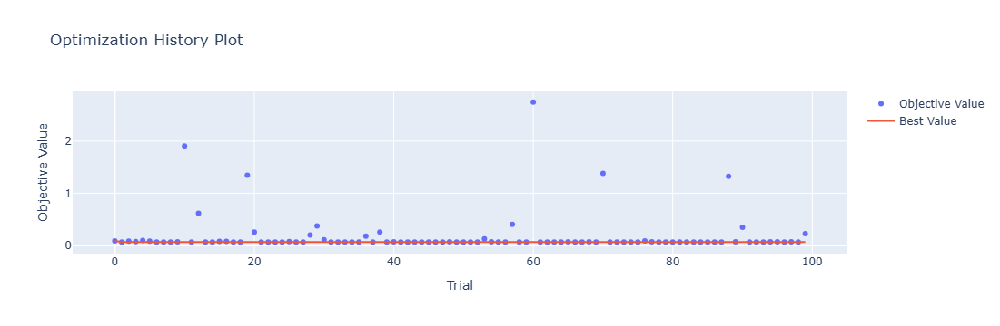

In [4]:
optuna.visualization.plot_optimization_history(study)

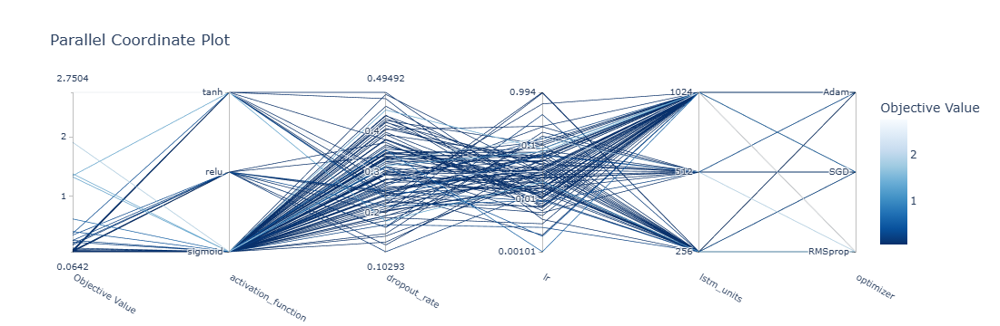

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

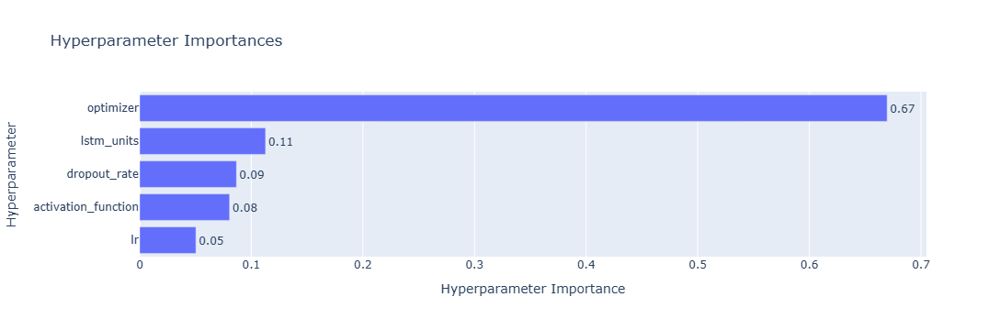

In [6]:
optuna.visualization.plot_param_importances(study)

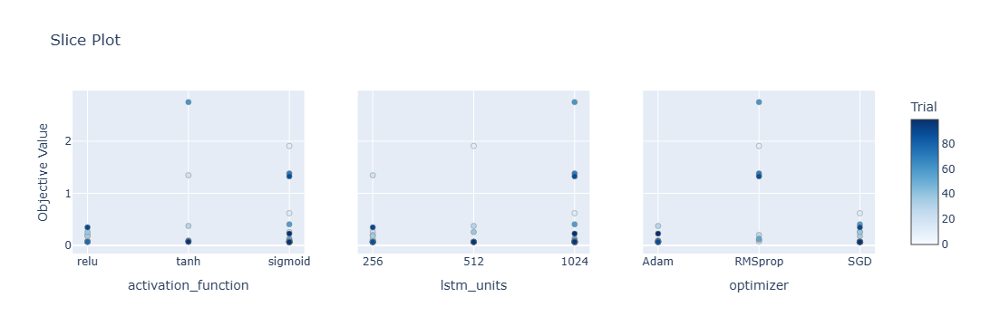

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

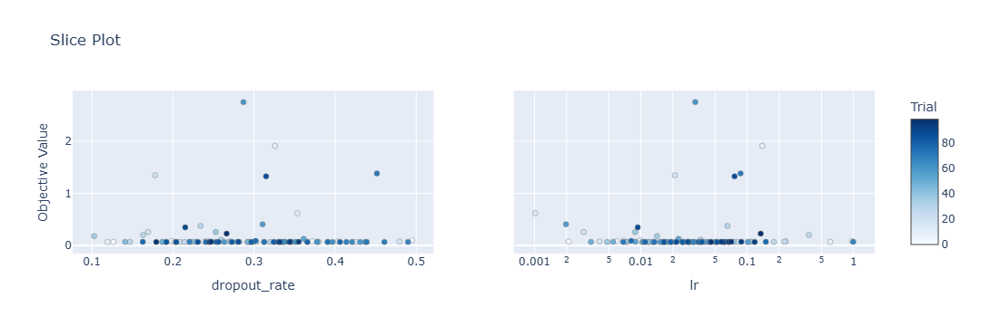

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 34s 193ms/step - loss: 0.1944 - accuracy: 0.2619 - mae: 0.1534 - rmse: 0.1944 - mape: 31.7770 - pearson: 0.5589 - val_loss: 0.0745 - val_accuracy: 0.7000 - val_mae: 0.0585 - val_rmse: 0.0745 - val_mape: 12.5026 - val_pearson: 0.7333
Epoch 2/100
84/84 [==============================] - 10s 119ms/step - loss: 0.0680 - accuracy: 0.3929 - mae: 0.0533 - rmse: 0.0680 - mape: 12.0629 - pearson: 0.7676 - val_loss: 0.0625 - val_accuracy: 0.7000 - val_mae: 0.0474 - val_rmse: 0.0625 - val_mape: 10.3353 - val_pearson: 0.7643
Epoch 3/100
84/84 [==============================] - 11s 126ms/step - loss: 0.0689 - accuracy: 0.4048 - mae: 0.0538 - rmse: 0.0689 - mape: 12.1473 - pearson: 0.7620

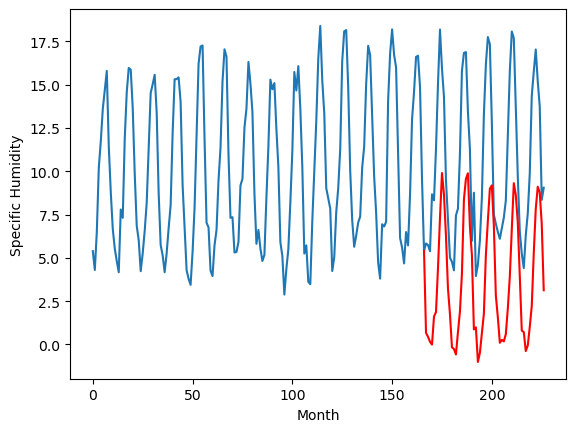

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		1.92		2.78
-0.53		1.69		2.22
-0.97		1.40		2.37
-0.24		1.24		1.48
3.64		2.86		-0.78
1.85		3.11		1.26
4.17		5.66		1.49
7.85		8.55		0.70
9.51		11.15		1.64
9.45		9.90		0.45
7.35		7.51		0.16
4.79		4.48		-0.31
1.46		3.00		1.54
-2.06		1.09		3.15
-1.71		0.99		2.70
-1.00		0.67		1.67
1.21		1.95		0.74
1.43		3.15		1.72
3.92		5.34		1.42
8.67		9.62		0.95
9.47		10.81		1.34
9.63		11.13		1.50
7.47		8.06		0.59
4.39		6.40		2.01
-1.27		2.11		3.38
2.37		2.23		-0.14
-2.39		0.23		2.62
-1.17		0.76		1.93
0.74		1.89		1.15
2.04		3.01		0.97
6.28		6.41		0.13
8.89		8.39		-0.50
9.79		10.23		0.44
9.22		10.43		1.21
6.16		8.09		1.93
1.02		4.06		3.04
0.82		2.81		1.99
-0.38		1.34		1.72
-0.29		1.50		1.79
1.40		1.42		0.02
1.78		1.84		0.06
2.57		3.33		0.76
4.76		5.16		0.40
8.09		7.92		-0.17
9.76		10.56		0.80
10.54		9.86		-0.68
6.52		8.27		1.75
1.82		5.17		3.35
-0.36		2.04		2.40
-1.80		1.95		3.75
-2.58		0.85		3.43
-1.36		1.1

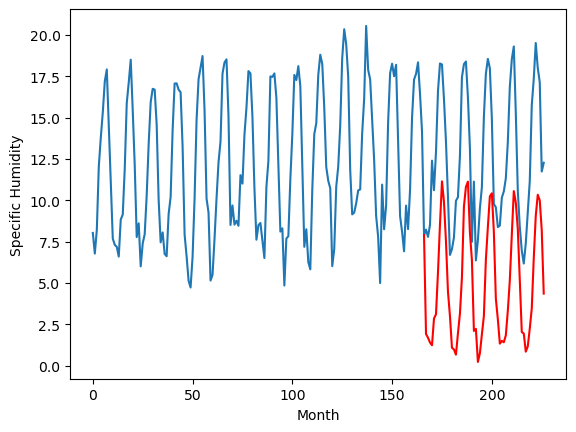

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		4.56		2.33
2.48		4.33		1.85
2.31		4.04		1.73
2.86		3.88		1.02
5.46		5.50		0.04
4.21		5.76		1.55
7.07		8.31		1.24
10.98		11.19		0.21
13.38		13.80		0.42
13.47		12.55		-0.92
10.38		10.15		-0.23
7.63		7.13		-0.50
4.30		5.65		1.35
1.14		3.74		2.60
1.52		3.64		2.12
1.67		3.33		1.66
3.52		4.61		1.09
3.76		5.81		2.05
6.52		8.00		1.48
11.14		12.28		1.14
13.05		13.47		0.42
13.25		13.79		0.54
10.25		10.72		0.47
7.53		9.06		1.53
1.66		4.77		3.11
4.06		4.89		0.83
0.65		2.90		2.25
1.86		3.42		1.56
2.57		4.56		1.99
4.02		5.68		1.66
8.16		9.08		0.92
10.94		11.06		0.12
13.14		12.91		-0.23
12.44		13.10		0.66
8.71		10.76		2.05
3.71		6.73		3.02
3.39		5.48		2.09
2.06		4.01		1.95
2.43		4.18		1.75
3.54		4.10		0.56
2.90		4.52		1.62
4.34		6.01		1.67
7.12		7.85		0.73
9.70		10.60		0.90
12.56		13.25		0.69
12.65		12.55		-0.10
9.07		10.96		1.89
5.16		7.86		2.70
2.63		4.73		2.10
1.82		4.64		2.82
1.02		3.54		2.52
1.66

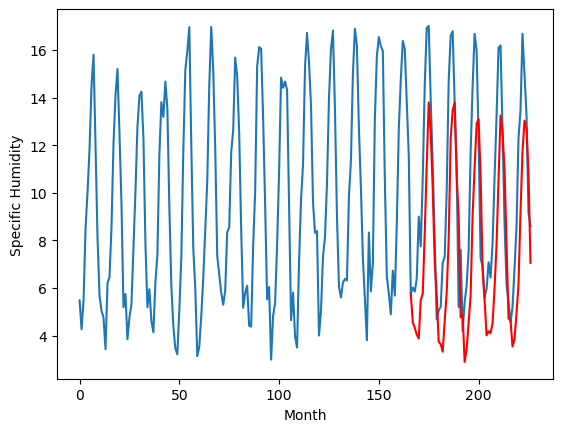

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		2.01		2.49
0.06		1.78		1.72
0.30		1.50		1.20
0.44		1.33		0.89
4.75		2.95		-1.80
3.60		3.21		-0.39
5.75		5.76		0.01
8.24		8.64		0.40
10.99		11.24		0.25
9.74		9.99		0.25
8.39		7.60		-0.79
4.58		4.57		-0.01
1.53		3.09		1.56
-1.54		1.18		2.72
-1.47		1.09		2.56
-1.56		0.77		2.33
1.89		2.06		0.17
2.46		3.26		0.80
5.97		5.45		-0.52
9.87		9.72		-0.15
10.71		10.91		0.20
10.33		11.23		0.90
8.02		8.16		0.14
5.59		6.50		0.91
-0.62		2.20		2.82
2.43		2.32		-0.11
-2.69		0.33		3.02
-1.48		0.85		2.33
-0.39		1.99		2.38
2.53		3.10		0.57
6.77		6.51		-0.26
8.78		8.49		-0.29
9.99		10.33		0.34
9.27		10.53		1.26
5.89		8.19		2.30
0.79		4.16		3.37
0.27		2.92		2.65
-0.23		1.44		1.67
-0.04		1.61		1.65
0.63		1.53		0.90
1.71		1.95		0.24
2.11		3.44		1.33
4.96		5.27		0.31
9.11		8.03		-1.08
10.14		10.67		0.53
9.89		9.98		0.09
7.71		8.38		0.67
3.14		5.28		2.14
0.15		2.15		2.00
-1.25		2.06		3.31
-2.17		0.96		3.13
-0.39	

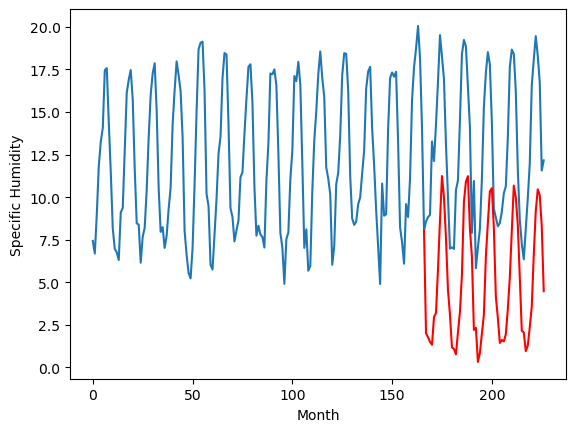

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		3.96		-0.33
3.04		3.73		0.69
3.83		3.45		-0.38
3.22		3.28		0.06
7.67		4.90		-2.77
7.39		5.15		-2.24
9.97		7.71		-2.26
12.33		10.59		-1.74
15.19		13.19		-2.00
12.92		11.94		-0.98
11.61		9.55		-2.06
7.33		6.52		-0.81
5.48		5.03		-0.45
2.70		3.12		0.42
2.63		3.03		0.40
2.23		2.72		0.49
5.07		4.00		-1.07
6.47		5.20		-1.27
10.48		7.39		-3.09
14.17		11.67		-2.50
14.88		12.86		-2.02
14.80		13.18		-1.62
10.57		10.10		-0.47
8.48		8.44		-0.04
4.26		4.15		-0.11
7.02		4.27		-2.75
1.52		2.27		0.75
1.78		2.79		1.01
3.33		3.93		0.60
7.25		5.04		-2.21
10.95		8.45		-2.50
11.92		10.43		-1.49
11.68		12.28		0.60
12.77		12.47		-0.30
9.94		10.14		0.20
5.14		6.11		0.97
5.13		4.86		-0.27
4.05		3.39		-0.66
3.29		3.56		0.27
3.63		3.47		-0.16
5.82		3.90		-1.92
6.58		5.38		-1.20
10.52		7.22		-3.30
14.64		9.97		-4.67
13.22		12.62		-0.60
11.40		11.92		0.52
11.36		10.33		-1.03
7.61		7.23		-0.38
4.81		4.09		-0.72
2.95

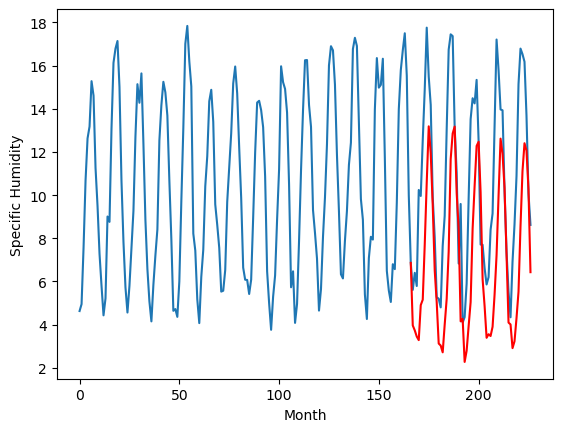

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		1.16		1.97
-0.85		0.93		1.78
-1.33		0.64		1.97
-1.44		0.48		1.92
0.32		2.10		1.78
0.66		2.35		1.69
3.79		4.91		1.12
7.52		7.80		0.28
11.00		10.39		-0.61
11.03		9.15		-1.88
8.13		6.75		-1.38
4.43		3.72		-0.71
1.48		2.25		0.77
-2.28		0.34		2.62
-2.89		0.24		3.13
-2.30		-0.07		2.23
-0.73		1.21		1.94
0.28		2.41		2.13
2.78		4.61		1.83
8.04		8.89		0.85
9.16		10.08		0.92
10.32		10.40		0.08
6.23		7.32		1.09
3.91		5.66		1.75
-1.35		1.37		2.72
0.07		1.50		1.43
-3.04		-0.50		2.54
-1.66		0.02		1.68
-0.33		1.17		1.50
0.80		2.28		1.48
5.58		5.69		0.11
6.67		7.66		0.99
11.00		9.51		-1.49
9.21		9.70		0.49
6.51		7.36		0.85
1.87		3.34		1.47
1.21		2.09		0.88
-2.14		0.62		2.76
-1.39		0.79		2.18
-0.46		0.71		1.17
-0.68		1.14		1.82
2.00		2.63		0.63
2.76		4.46		1.70
6.66		7.22		0.56
11.01		9.86		-1.15
10.12		9.17		-0.95
7.00		7.58		0.58
2.60		4.47		1.87
-0.42		1.34		1.76
-1.24		1.25		2.49
-2.03		0.16		2.19
-

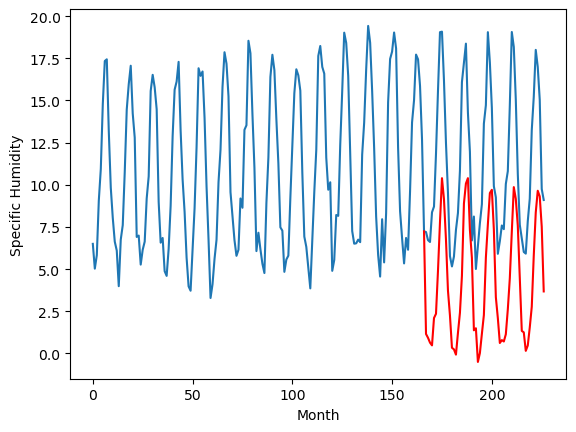

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		3.03		1.65
1.50		2.80		1.30
1.42		2.51		1.09
1.78		2.35		0.57
3.41		3.97		0.56
3.19		4.22		1.03
6.29		6.78		0.49
10.01		9.67		-0.34
12.80		12.27		-0.53
12.74		11.02		-1.72
9.21		8.62		-0.59
6.49		5.60		-0.89
3.64		4.12		0.48
0.77		2.21		1.44
0.62		2.12		1.50
0.67		1.81		1.14
2.26		3.09		0.83
2.86		4.29		1.43
5.86		6.48		0.62
10.24		10.76		0.52
11.68		11.95		0.27
12.21		12.27		0.06
8.89		9.19		0.30
6.78		7.53		0.75
1.03		3.25		2.22
2.87		3.37		0.50
0.09		1.37		1.28
1.37		1.89		0.52
2.38		3.04		0.66
3.38		4.15		0.77
7.74		7.56		-0.18
9.62		9.54		-0.08
13.24		11.39		-1.85
11.89		11.58		-0.31
8.45		9.24		0.79
3.89		5.22		1.33
3.29		3.97		0.68
1.11		2.50		1.39
1.97		2.68		0.71
2.65		2.59		-0.06
2.24		3.02		0.78
4.45		4.51		0.06
6.04		6.34		0.30
8.77		9.10		0.33
12.51		11.74		-0.77
12.14		11.05		-1.09
9.20		9.45		0.25
4.94		6.35		1.41
1.61		3.22		1.61
1.54		3.13		1.59
0.87		2.03		1.16
1.03		2

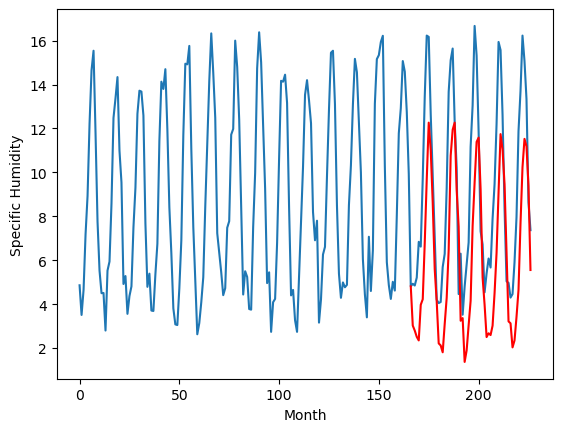

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.39		1.44
0.20		1.16		0.96
0.23		0.87		0.64
0.45		0.71		0.26
1.75		2.33		0.58
1.69		2.58		0.89
3.68		5.14		1.46
8.35		8.03		-0.32
11.16		10.63		-0.53
11.40		9.38		-2.02
7.50		6.99		-0.51
4.79		3.96		-0.83
2.25		2.48		0.23
-0.62		0.58		1.20
-0.93		0.49		1.42
-0.90		0.18		1.08
0.72		1.46		0.74
1.42		2.66		1.24
4.44		4.85		0.41
8.71		9.13		0.42
10.21		10.32		0.11
10.49		10.64		0.15
7.00		7.57		0.57
5.12		5.91		0.79
-0.67		1.62		2.29
1.10		1.74		0.64
-1.41		-0.25		1.16
-0.18		0.27		0.45
0.81		1.42		0.61
1.71		2.53		0.82
6.00		5.94		-0.06
7.45		7.92		0.47
10.82		9.77		-1.05
9.75		9.96		0.21
6.96		7.62		0.66
2.54		3.59		1.05
1.84		2.35		0.51
-0.50		0.88		1.38
0.43		1.06		0.63
0.79		0.97		0.18
0.71		1.40		0.69
2.99		2.89		-0.10
4.31		4.72		0.41
6.93		7.48		0.55
11.28		10.13		-1.15
10.22		9.43		-0.79
7.42		7.84		0.42
3.67		4.74		1.07
0.15		1.60		1.45
0.35		1.51		1.16
-0.34		0.42		0.76
-0.31		

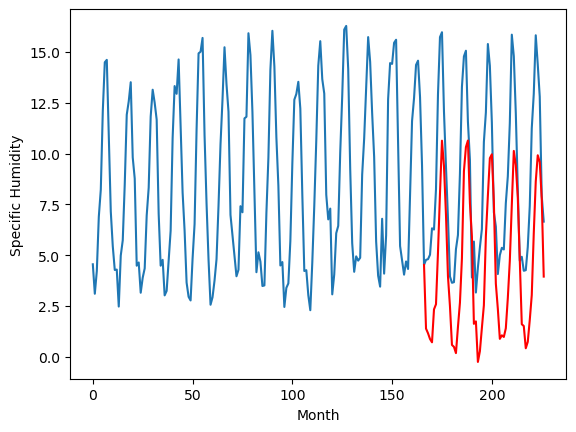

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		1.08		-0.19
1.36		0.85		-0.51
0.96		0.56		-0.40
0.95		0.40		-0.55
3.21		2.02		-1.19
3.45		2.27		-1.18
6.67		4.83		-1.84
10.32		7.72		-2.60
13.41		10.32		-3.09
11.38		9.06		-2.32
8.66		6.66		-2.00
4.21		3.64		-0.57
2.45		2.16		-0.29
0.54		0.26		-0.28
0.31		0.16		-0.15
-0.37		-0.15		0.22
2.69		1.14		-1.55
3.42		2.34		-1.08
6.33		4.53		-1.80
11.31		8.81		-2.50
12.81		10.00		-2.81
13.00		10.32		-2.68
9.19		7.24		-1.95
6.77		5.59		-1.18
1.48		1.30		-0.18
3.07		1.42		-1.65
-0.21		-0.58		-0.37
0.38		-0.06		-0.44
2.06		1.09		-0.97
3.64		2.20		-1.44
7.83		5.61		-2.22
10.01		7.59		-2.42
13.67		9.44		-4.23
12.70		9.63		-3.07
8.25		7.28		-0.97
3.02		3.25		0.23
2.02		2.01		-0.01
1.09		0.54		-0.55
1.69		0.71		-0.98
1.76		0.63		-1.13
2.20		1.06		-1.14
3.42		2.54		-0.88
6.91		4.38		-2.53
9.19		7.14		-2.05
12.74		9.79		-2.95
12.74		9.09		-3.65
8.67		7.50		-1.17
4.61		4.40		-0.21
1.95		1.26		-0.69
1.34		

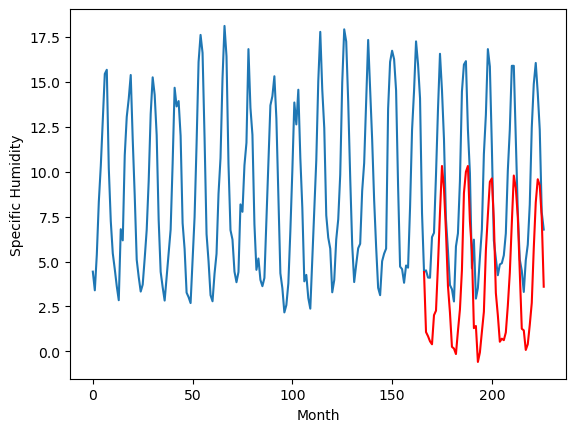

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		0.96		0.18
1.19		0.74		-0.45
0.69		0.46		-0.23
0.37		0.29		-0.08
2.33		1.91		-0.42
2.39		2.16		-0.23
5.53		4.72		-0.81
8.22		7.61		-0.61
11.36		10.21		-1.15
10.14		8.95		-1.19
7.35		6.55		-0.80
4.01		3.53		-0.48
1.96		2.05		0.09
0.30		0.15		-0.15
-0.03		0.05		0.08
-0.48		-0.25		0.23
1.32		1.03		-0.29
2.64		2.23		-0.41
4.73		4.43		-0.30
9.50		8.70		-0.80
10.43		9.89		-0.54
10.85		10.21		-0.64
7.68		7.14		-0.54
6.37		5.48		-0.89
0.85		1.19		0.34
1.69		1.31		-0.38
-0.60		-0.69		-0.09
0.14		-0.16		-0.30
1.42		0.99		-0.43
3.04		2.11		-0.93
7.65		5.52		-2.13
9.33		7.49		-1.84
12.91		9.34		-3.57
11.37		9.53		-1.84
8.31		7.18		-1.13
2.52		3.15		0.63
1.80		1.91		0.11
0.87		0.44		-0.43
1.48		0.61		-0.87
1.25		0.53		-0.72
1.35		0.96		-0.39
3.08		2.44		-0.64
5.52		4.28		-1.24
8.14		7.04		-1.10
11.96		9.69		-2.27
10.66		8.99		-1.67
7.94		7.39		-0.55
4.70		4.30		-0.40
1.35		1.16		-0.19
1.54		1.07		-

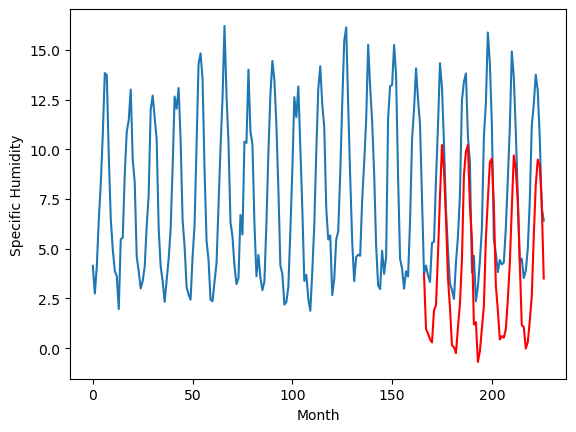

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		0.66		0.17
0.61		0.44		-0.17
0.23		0.16		-0.07
-0.28		-0.01		0.27
1.32		1.61		0.29
1.68		1.86		0.18
4.58		4.42		-0.16
7.68		7.31		-0.37
10.73		9.91		-0.82
9.16		8.65		-0.51
6.50		6.25		-0.25
3.05		3.22		0.17
1.64		1.75		0.11
0.11		-0.15		-0.26
-0.27		-0.25		0.02
-1.01		-0.55		0.46
0.61		0.73		0.12
2.21		1.93		-0.28
3.73		4.13		0.40
8.86		8.41		-0.45
9.93		9.60		-0.33
10.42		9.92		-0.50
6.80		6.84		0.04
5.81		5.18		-0.63
0.96		0.89		-0.07
0.96		1.01		0.05
-1.11		-0.99		0.12
-0.51		-0.46		0.05
0.74		0.68		-0.06
1.68		1.80		0.12
5.40		5.21		-0.19
6.67		7.18		0.51
9.16		9.03		-0.13
10.15		9.22		-0.93
7.55		6.88		-0.67
2.53		2.84		0.31
1.39		1.60		0.21
0.22		0.12		-0.10
0.62		0.30		-0.32
0.06		0.21		0.15
0.52		0.64		0.12
2.16		2.13		-0.03
3.37		3.96		0.59
6.38		6.72		0.34
10.21		9.38		-0.83
9.46		8.68		-0.78
8.15		7.09		-1.06
4.39		3.99		-0.40
0.98		0.85		-0.13
1.51		0.77		-0.74
-0.01		-0.3

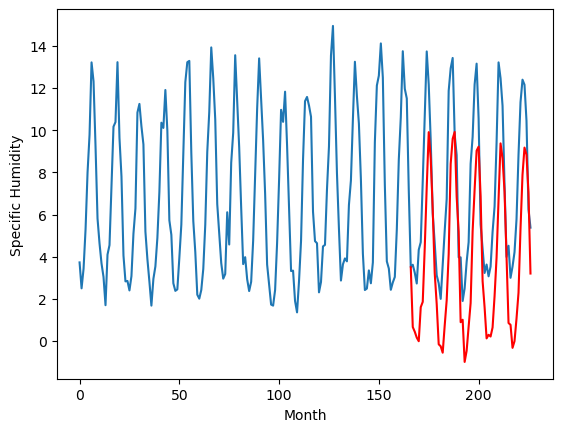

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03   0.672619
1                 1   -0.86   1.922001
2                 2    2.23   4.559256
3                 3   -0.48   2.010186
4                 4    4.29   3.962644
5                 5   -0.81   1.157494
6                 6    1.38   3.026299
7                 7   -0.05   1.385043
8                 8    1.27   1.076632
9                 9    0.78   0.963654
10               10    0.49   0.664786


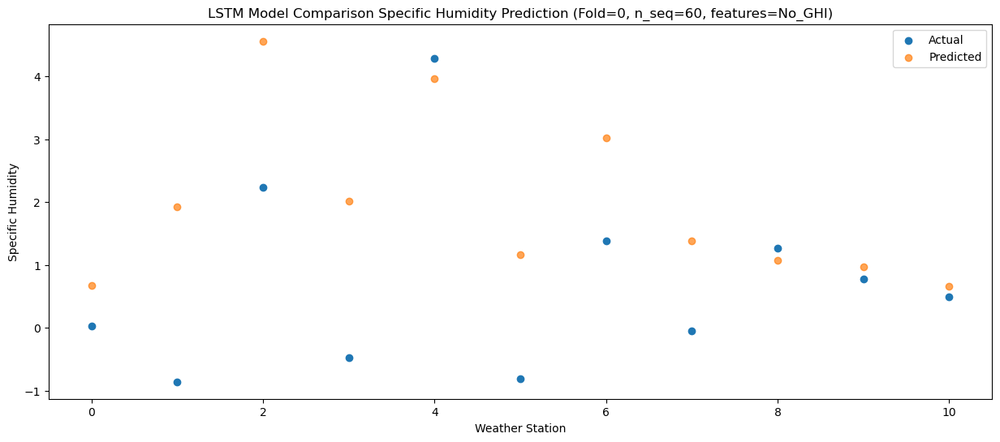

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46   0.442606
1                 1   -0.53   1.692076
2                 2    2.48   4.330910
3                 3    0.06   1.784114
4                 4    3.04   3.734323
5                 5   -0.85   0.928692
6                 6    1.50   2.797687
7                 7    0.20   1.157260
8                 8    1.36   0.848730
9                 9    1.19   0.737872
10               10    0.61   0.441604


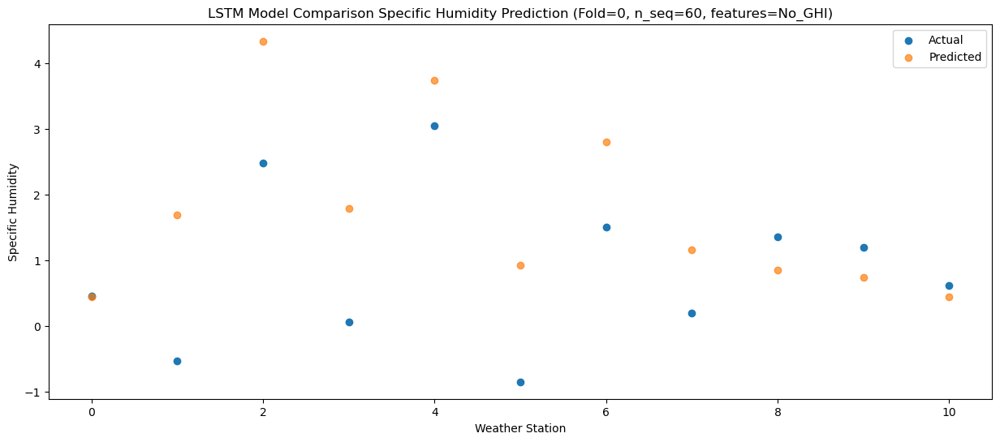

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37   0.155917
1                 1   -0.97   1.404903
2                 2    2.31   4.043547
3                 3    0.30   1.497632
4                 4    3.83   3.445562
5                 5   -1.33   0.643095
6                 6    1.42   2.511762
7                 7    0.23   0.872972
8                 8    0.96   0.563327
9                 9    0.69   0.455783
10               10    0.23   0.161818


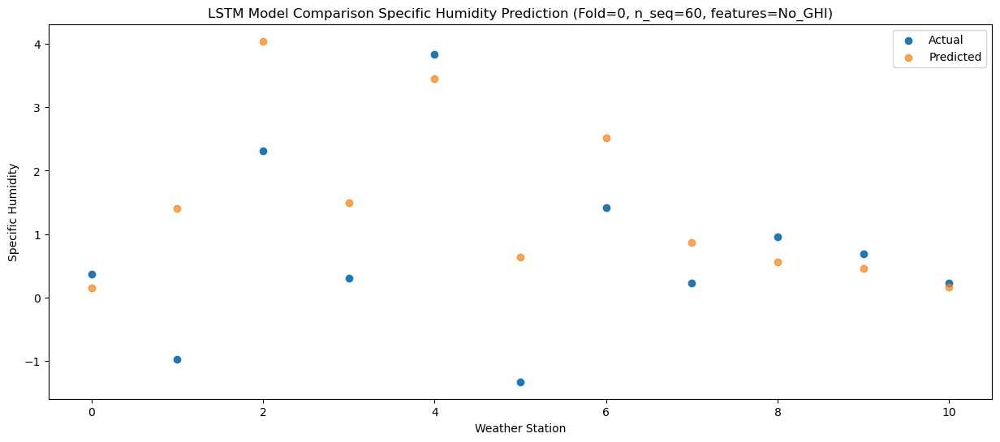

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01  -0.006623
1                 1   -0.24   1.241847
2                 2    2.86   3.880728
3                 3    0.44   1.334200
4                 4    3.22   3.282098
5                 5   -1.44   0.480730
6                 6    1.78   2.349399
7                 7    0.45   0.710567
8                 8    0.95   0.397685
9                 9    0.37   0.289626
10               10   -0.28  -0.009182


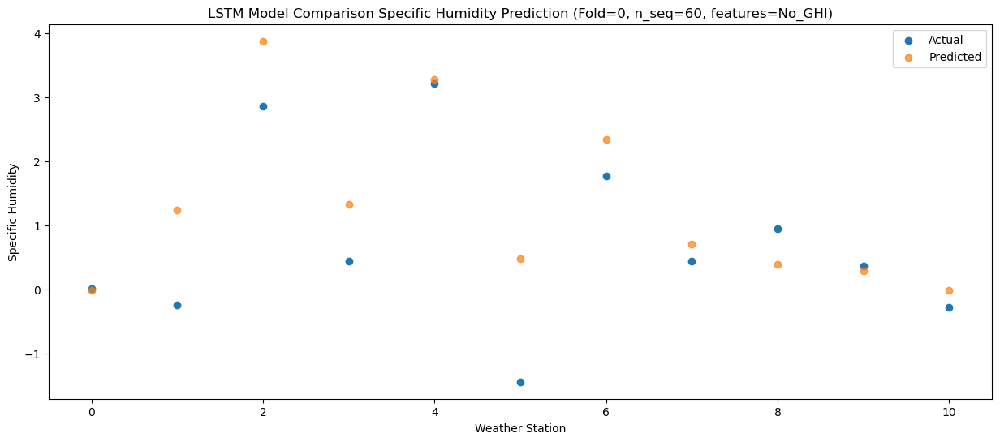

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   1.615314
1                 1    3.64   2.864192
2                 2    5.46   5.504025
3                 3    4.75   2.954563
4                 4    7.67   4.903876
5                 5    0.32   2.102428
6                 6    3.41   3.971635
7                 7    1.75   2.332691
8                 8    3.21   2.018041
9                 9    2.33   1.908134
10               10    1.32   1.607537


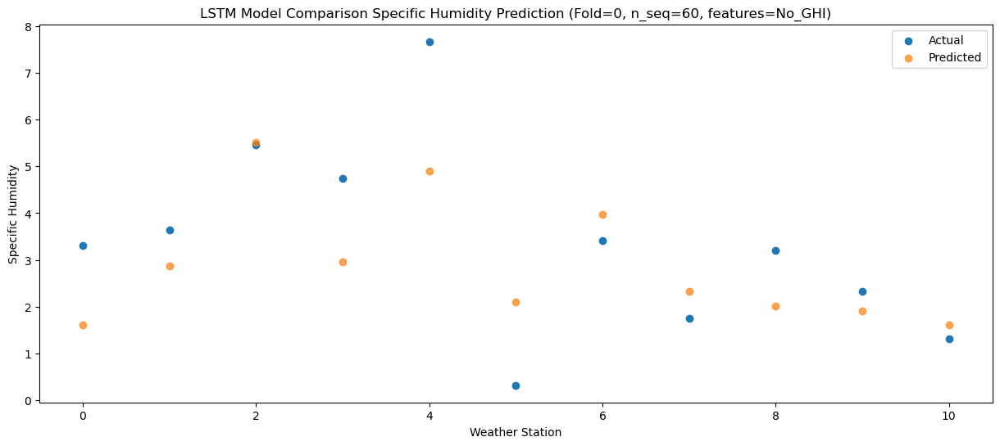

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   1.868883
1                 1    1.85   3.114310
2                 2    4.21   5.755517
3                 3    3.60   3.205185
4                 4    7.39   5.154870
5                 5    0.66   2.354804
6                 6    3.19   4.224314
7                 7    1.69   2.584339
8                 8    3.45   2.268362
9                 9    2.39   2.159090
10               10    1.68   1.858484


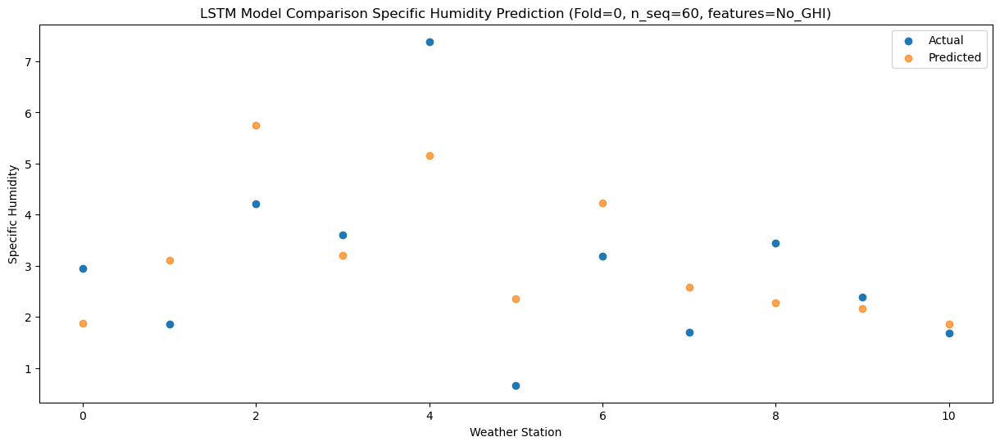

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   4.415303
1                 1    4.17   5.663803
2                 2    7.07   8.310482
3                 3    5.75   5.759924
4                 4    9.97   7.707962
5                 5    3.79   4.911056
6                 6    6.29   6.780495
7                 7    3.68   5.143900
8                 8    6.67   4.829286
9                 9    5.53   4.721803
10               10    4.58   4.419986


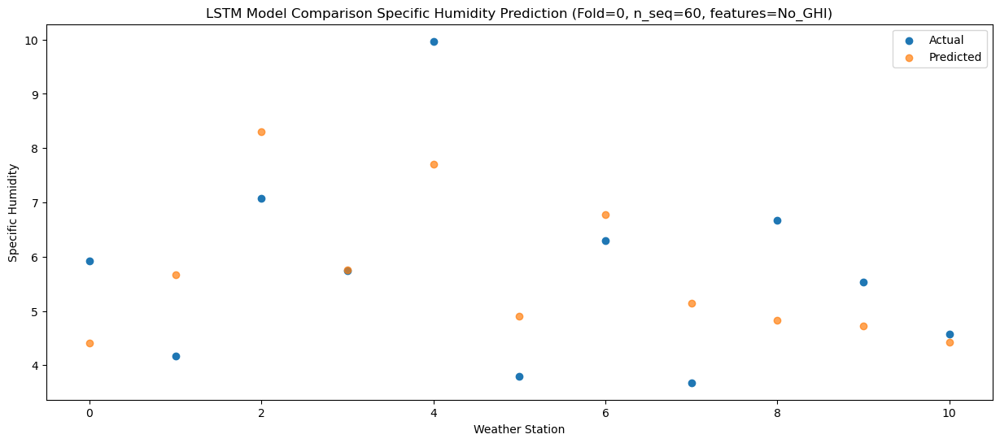

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68   7.298467
1                 1    7.85   8.546267
2                 2   10.98  11.194187
3                 3    8.24   8.639655
4                 4   12.33  10.589306
5                 5    7.52   7.795154
6                 6   10.01   9.666053
7                 7    8.35   8.031423
8                 8   10.32   7.716558
9                 9    8.22   7.611383
10               10    7.68   7.310263


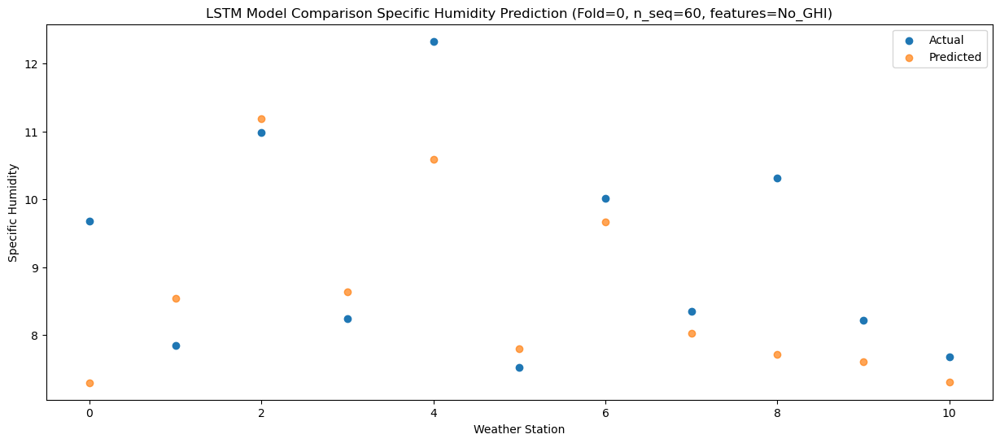

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81   9.896738
1                 1    9.51  11.146226
2                 2   13.38  13.795098
3                 3   10.99  11.238741
4                 4   15.19  13.187090
5                 5   11.00  10.393905
6                 6   12.80  12.265843
7                 7   11.16  10.632767
8                 8   13.41  10.316284
9                 9   11.36  10.210507
10               10   10.73   9.909896


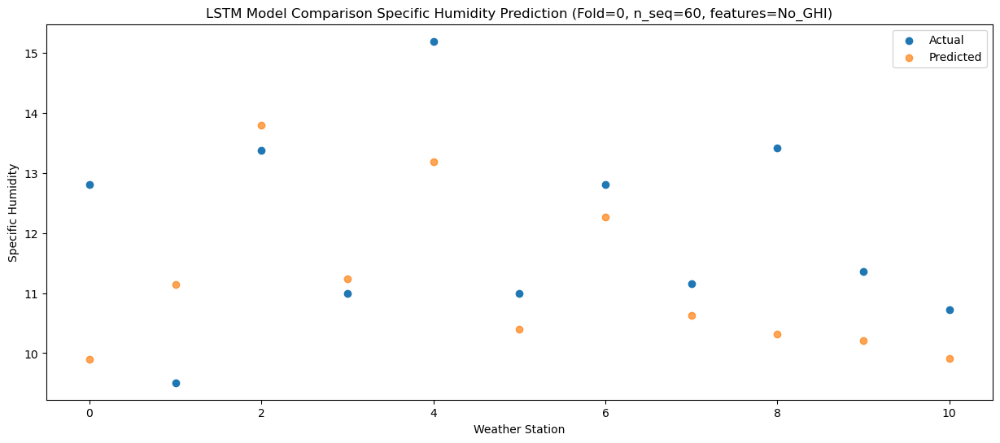

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   8.649889
1                 1    9.45   9.899654
2                 2   13.47  12.547310
3                 3    9.74   9.990679
4                 4   12.92  11.938639
5                 5   11.03   9.146651
6                 6   12.74  11.016779
7                 7   11.40   9.381351
8                 8   11.38   9.061662
9                 9   10.14   8.952571
10               10    9.16   8.649782


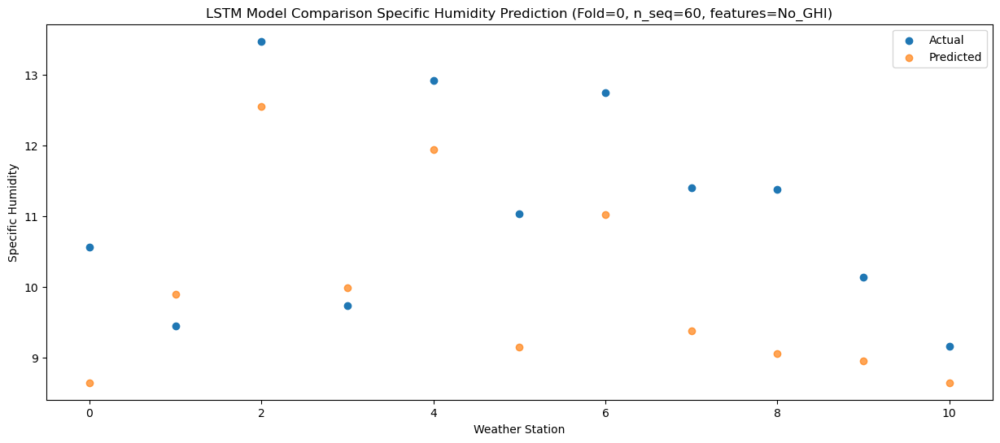

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92   6.255917
1                 1    7.35   7.507576
2                 2   10.38  10.153638
3                 3    8.39   7.597409
4                 4   11.61   9.545388
5                 5    8.13   6.752772
6                 6    9.21   8.622974
7                 7    7.50   6.986451
8                 8    8.66   6.664681
9                 9    7.35   6.554709
10               10    6.50   6.250359


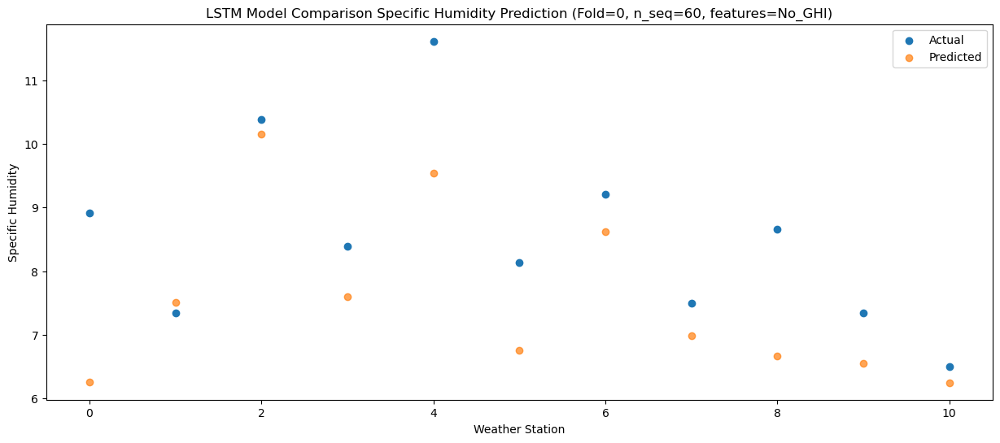

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   3.228361
1                 1    4.79   4.478723
2                 2    7.63   7.126595
3                 3    4.58   4.569070
4                 4    7.33   6.515436
5                 5    4.43   3.724728
6                 6    6.49   5.596895
7                 7    4.79   3.960877
8                 8    4.21   3.636751
9                 9    4.01   3.526935
10               10    3.05   3.221822


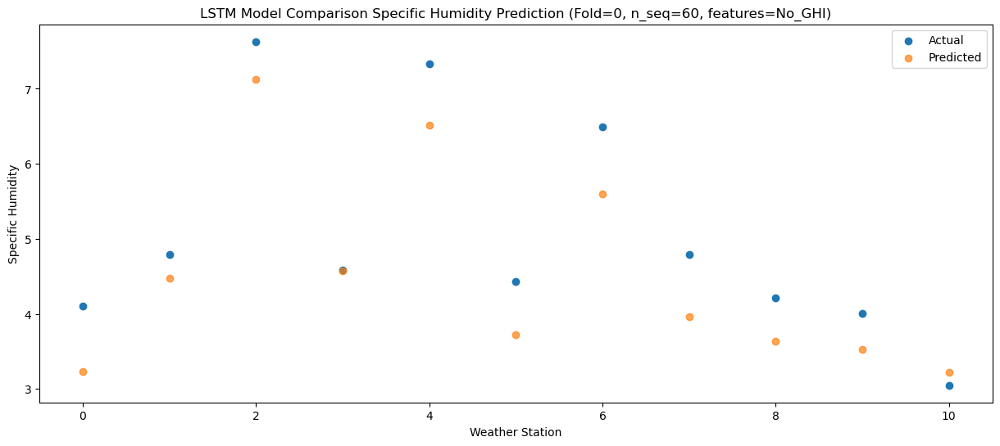

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87   1.749125
1                 1    1.46   2.998936
2                 2    4.30   5.647672
3                 3    1.53   3.091158
4                 4    5.48   5.034930
5                 5    1.48   2.246182
6                 6    3.64   4.118784
7                 7    2.25   2.483632
8                 8    2.45   2.159538
9                 9    1.96   2.051945
10               10    1.64   1.749516


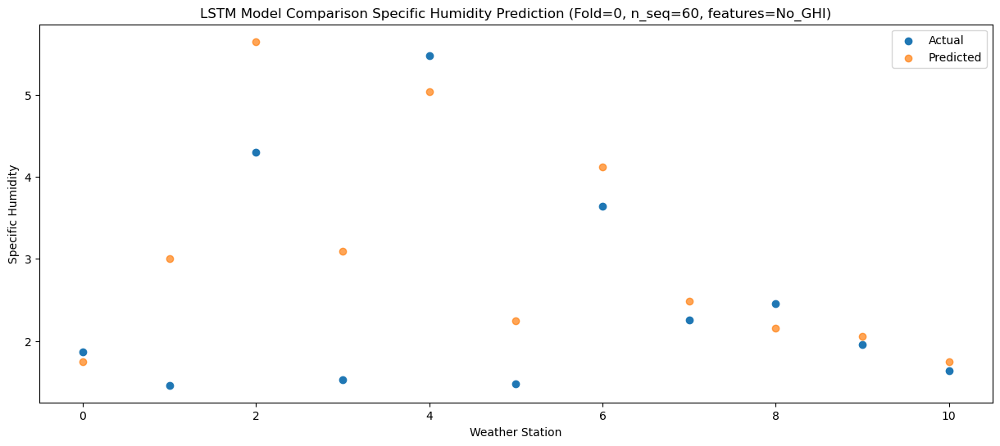

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36  -0.163253
1                 1   -2.06   1.087869
2                 2    1.14   3.739641
3                 3   -1.54   1.181020
4                 4    2.70   3.124259
5                 5   -2.28   0.339969
6                 6    0.77   2.214703
7                 7   -0.62   0.581577
8                 8    0.54   0.255406
9                 9    0.30   0.148969
10               10    0.11  -0.154131


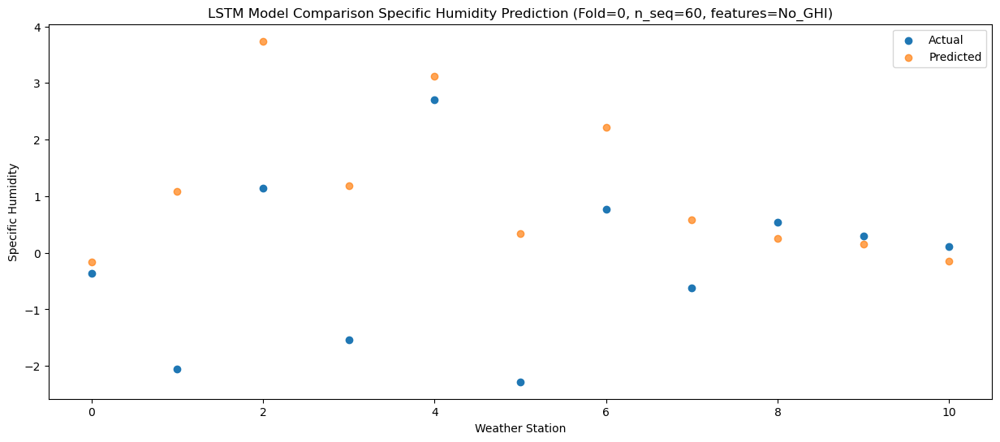

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60  -0.261190
1                 1   -1.71   0.988973
2                 2    1.52   3.642470
3                 3   -1.47   1.085158
4                 4    2.63   3.029523
5                 5   -2.89   0.242654
6                 6    0.62   2.119386
7                 7   -0.93   0.486670
8                 8    0.31   0.161914
9                 9   -0.03   0.054989
10               10   -0.27  -0.249851


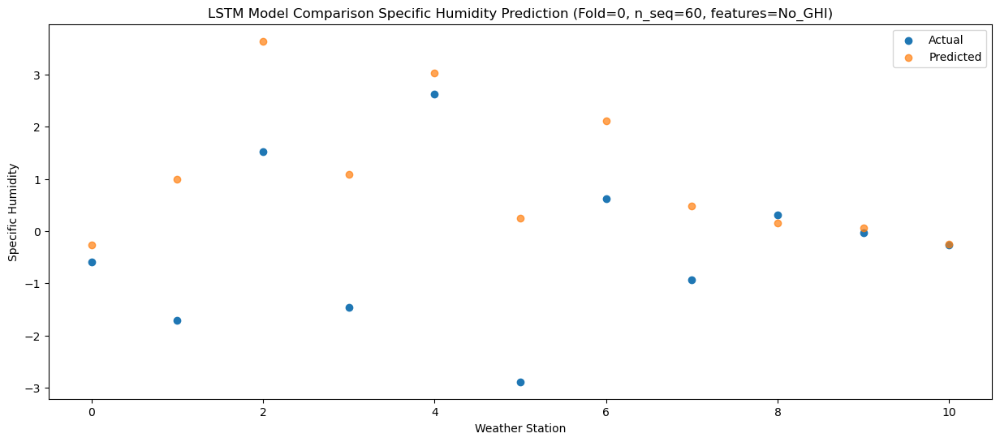

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -0.579219
1                 1   -1.00   0.672039
2                 2    1.67   3.327909
3                 3   -1.56   0.772301
4                 4    2.23   2.715222
5                 5   -2.30  -0.068350
6                 6    0.67   1.808554
7                 7   -0.90   0.178145
8                 8   -0.37  -0.145818
9                 9   -0.48  -0.250127
10               10   -1.01  -0.554423


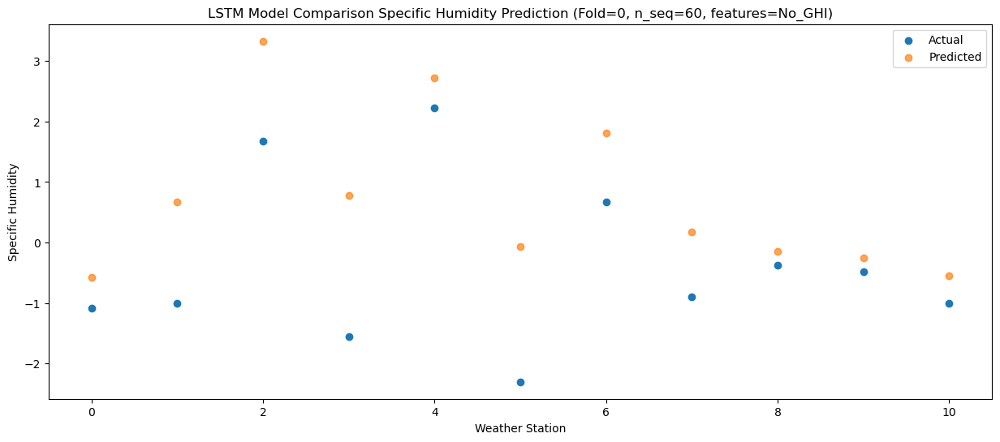

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08   0.703054
1                 1    1.21   1.954375
2                 2    3.52   4.611329
3                 3    1.89   2.056901
4                 4    5.07   3.998792
5                 5   -0.73   1.214163
6                 6    2.26   3.090534
7                 7    0.72   1.459979
8                 8    2.69   1.136451
9                 9    1.32   1.032470
10               10    0.61   0.730921


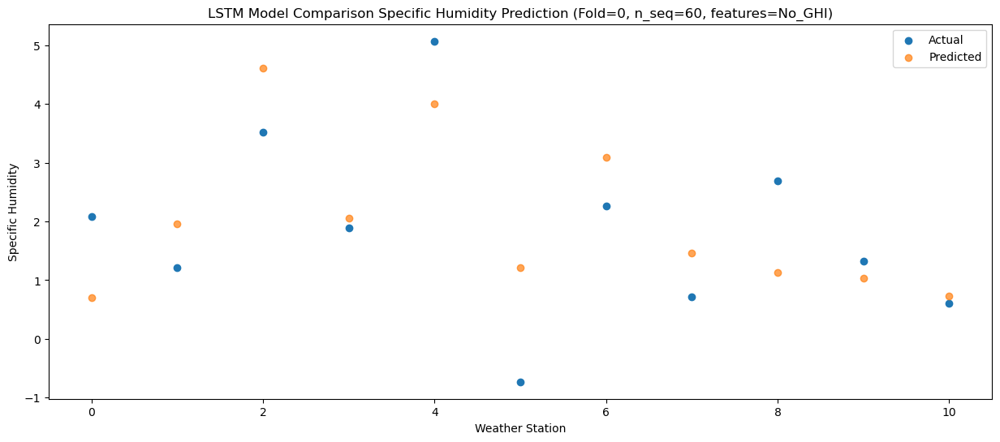

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47   1.903582
1                 1    1.43   3.152017
2                 2    3.76   5.809432
3                 3    2.46   3.255005
4                 4    6.47   5.196488
5                 5    0.28   2.413096
6                 6    2.86   4.288731
7                 7    1.42   2.659312
8                 8    3.42   2.337282
9                 9    2.64   2.232540
10               10    2.21   1.932896


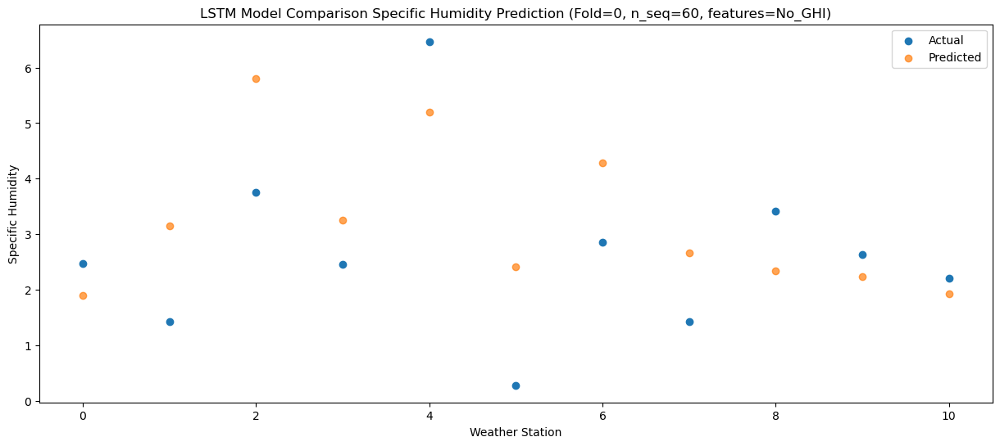

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   4.097773
1                 1    3.92   5.344290
2                 2    6.52   8.001330
3                 3    5.97   5.446219
4                 4   10.48   7.391560
5                 5    2.78   4.606650
6                 6    5.86   6.480213
7                 7    4.44   4.850910
8                 8    6.33   4.531891
9                 9    4.73   4.425721
10               10    3.73   4.126036


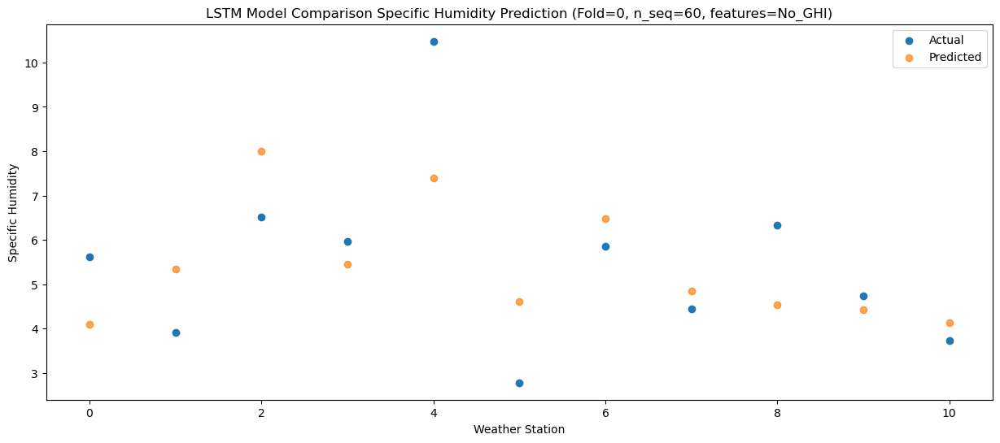

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43   8.371825
1                 1    8.67   9.620454
2                 2   11.14  12.280578
3                 3    9.87   9.724237
4                 4   14.17  11.666877
5                 5    8.04   8.887640
6                 6   10.24  10.760161
7                 7    8.71   9.132883
8                 8   11.31   8.810077
9                 9    9.50   8.704156
10               10    8.86   8.405253


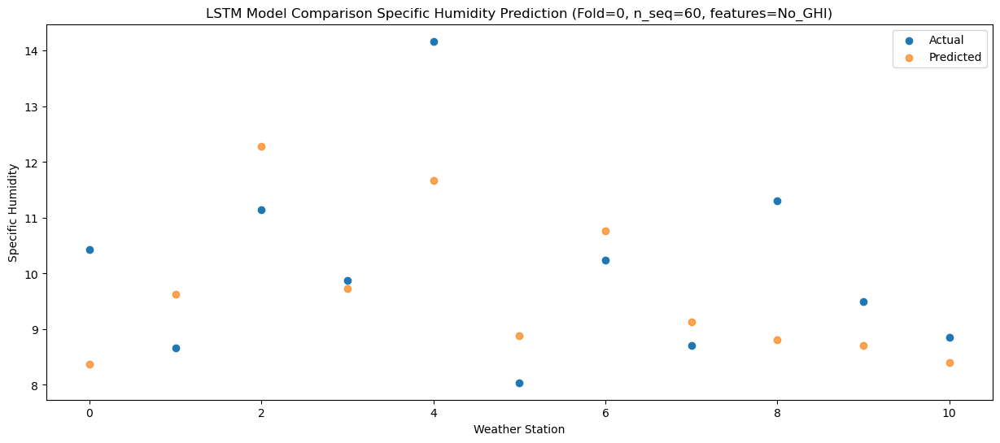

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46   9.561947
1                 1    9.47  10.808219
2                 2   13.05  13.468868
3                 3   10.71  10.911291
4                 4   14.88  12.856012
5                 5    9.16  10.076399
6                 6   11.68  11.945483
7                 7   10.21  10.317906
8                 8   12.81   9.997426
9                 9   10.43   9.891832
10               10    9.93   9.595817


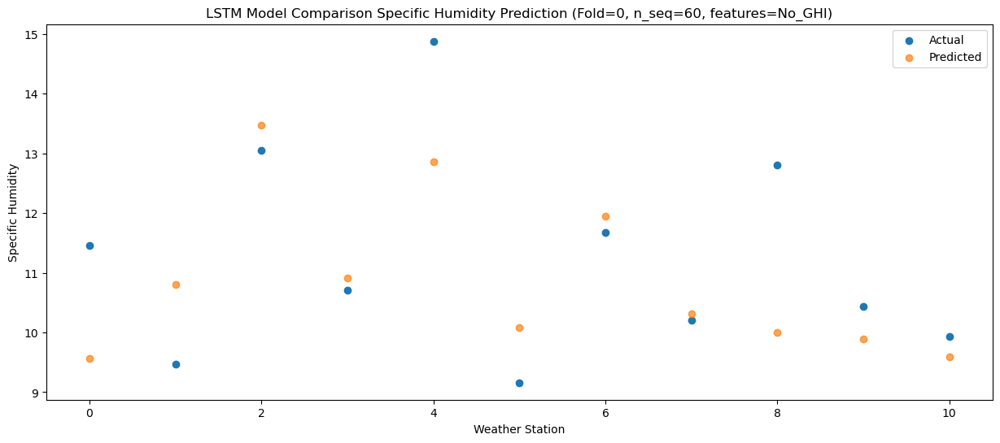

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51   9.883375
1                 1    9.63  11.129600
2                 2   13.25  13.788881
3                 3   10.33  11.232372
4                 4   14.80  13.176221
5                 5   10.32  10.395402
6                 6   12.21  12.265803
7                 7   10.49  10.639303
8                 8   13.00  10.318682
9                 9   10.85  10.214248
10               10   10.42   9.918141


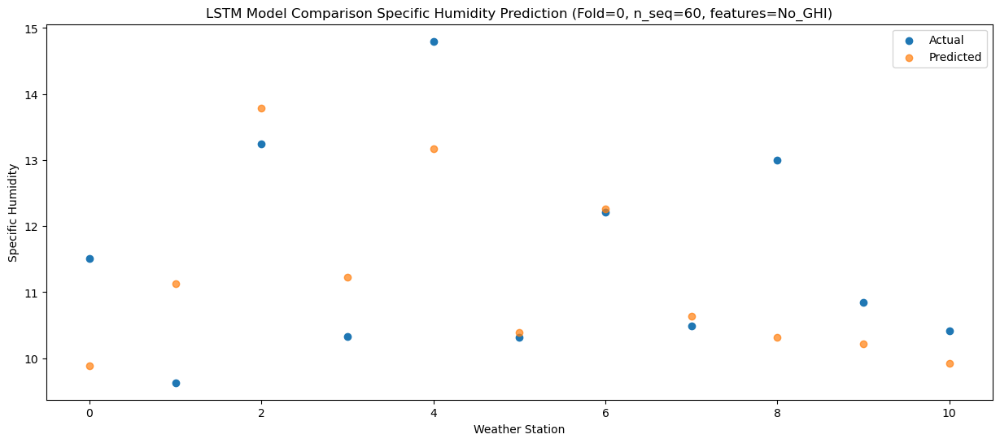

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   6.810879
1                 1    7.47   8.057247
2                 2   10.25  10.716849
3                 3    8.02   8.158727
4                 4   10.57  10.101946
5                 5    6.23   7.321003
6                 6    8.89   9.193277
7                 7    7.00   7.566124
8                 8    9.19   7.243343
9                 9    7.68   7.137328
10               10    6.80   6.839444


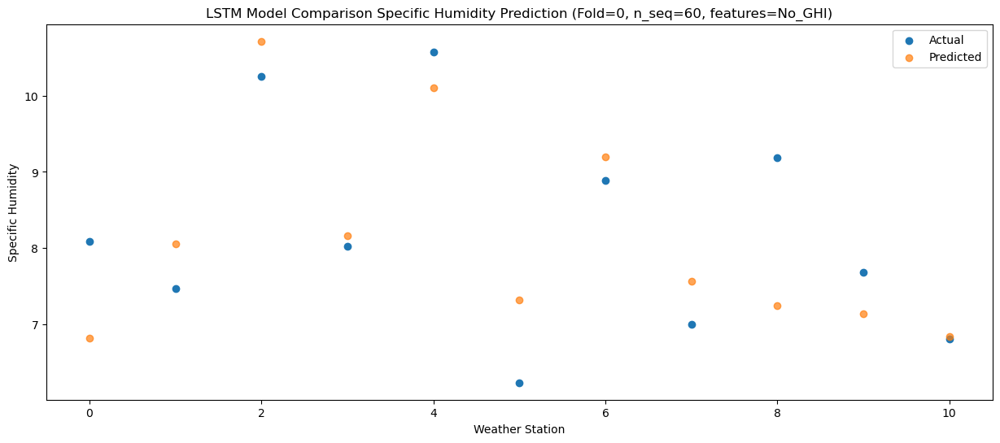

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   5.152360
1                 1    4.39   6.396266
2                 2    7.53   9.057130
3                 3    5.59   6.497223
4                 4    8.48   8.440567
5                 5    3.91   5.662385
6                 6    6.78   7.534764
7                 7    5.12   5.909621
8                 8    6.77   5.587334
9                 9    6.37   5.481910
10               10    5.81   5.183239


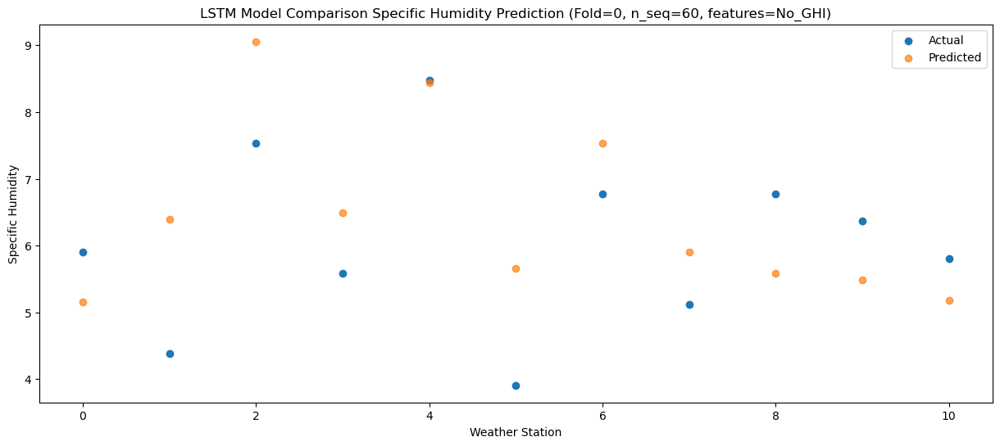

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61   0.867903
1                 1   -1.27   2.107965
2                 2    1.66   4.767676
3                 3   -0.62   2.204523
4                 4    4.26   4.150729
5                 5   -1.35   1.374194
6                 6    1.03   3.245307
7                 7   -0.67   1.619877
8                 8    1.48   1.296493
9                 9    0.85   1.192663
10               10    0.96   0.892913


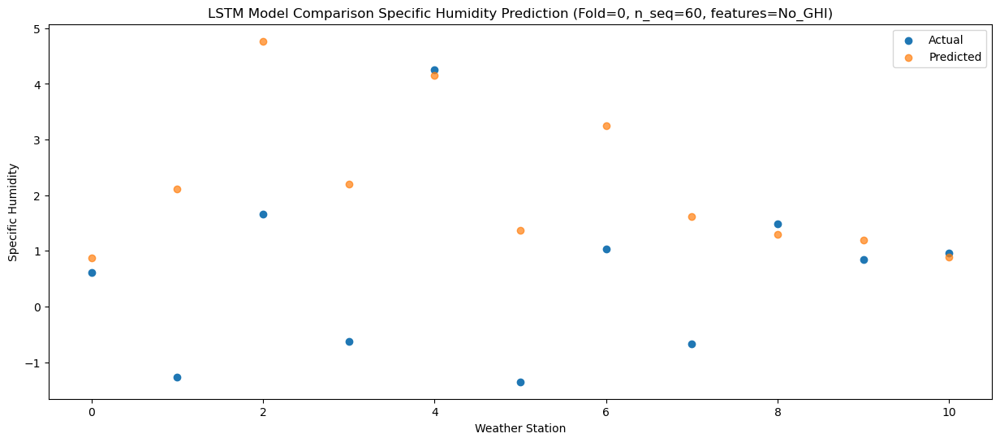

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39   0.988115
1                 1    2.37   2.230081
2                 2    4.06   4.890199
3                 3    2.43   2.324460
4                 4    7.02   4.267876
5                 5    0.07   1.495787
6                 6    2.87   3.365858
7                 7    1.10   1.741233
8                 8    3.07   1.415926
9                 9    1.69   1.311889
10               10    0.96   1.010417


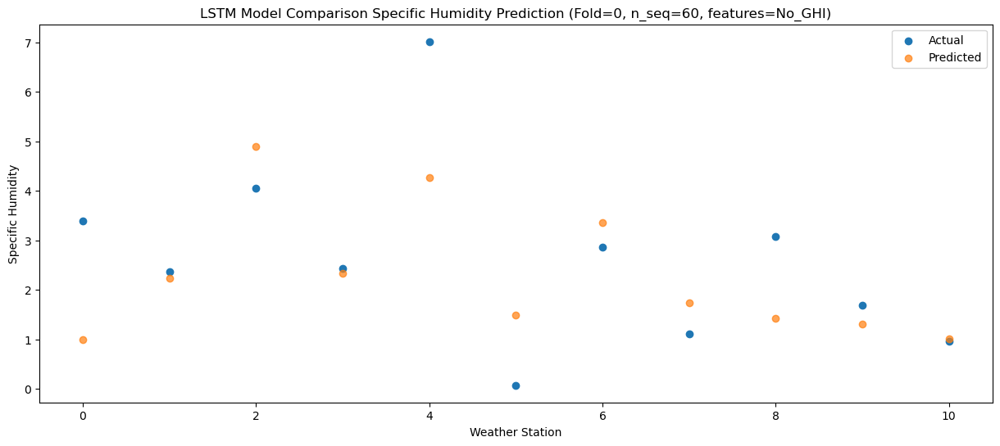

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -1.007560
1                 1   -2.39   0.233985
2                 2    0.65   2.895291
3                 3   -2.69   0.326787
4                 4    1.52   2.271598
5                 5   -3.04  -0.500053
6                 6    0.09   1.370714
7                 7   -1.41  -0.254594
8                 8   -0.21  -0.583661
9                 9   -0.60  -0.688782
10               10   -1.11  -0.991163


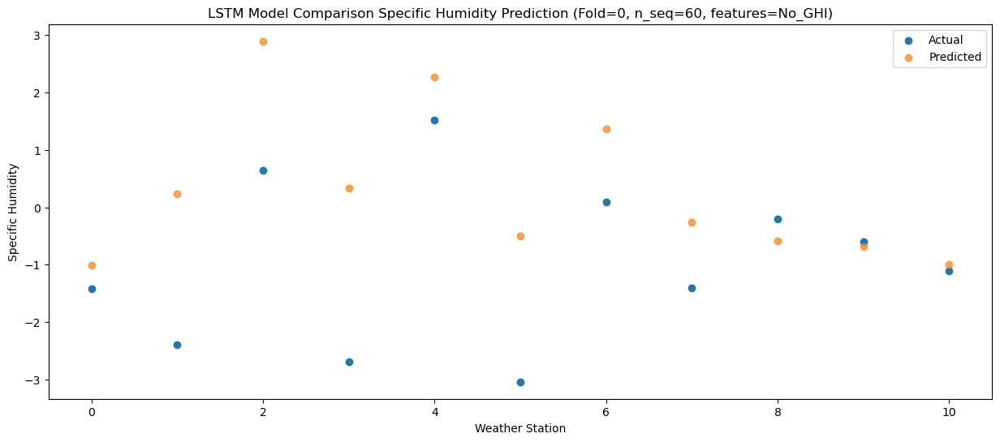

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76  -0.484565
1                 1   -1.17   0.756130
2                 2    1.86   3.418943
3                 3   -1.48   0.847218
4                 4    1.78   2.790088
5                 5   -1.66   0.023139
6                 6    1.37   1.894646
7                 7   -0.18   0.271387
8                 8    0.38  -0.059538
9                 9    0.14  -0.162433
10               10   -0.51  -0.463887


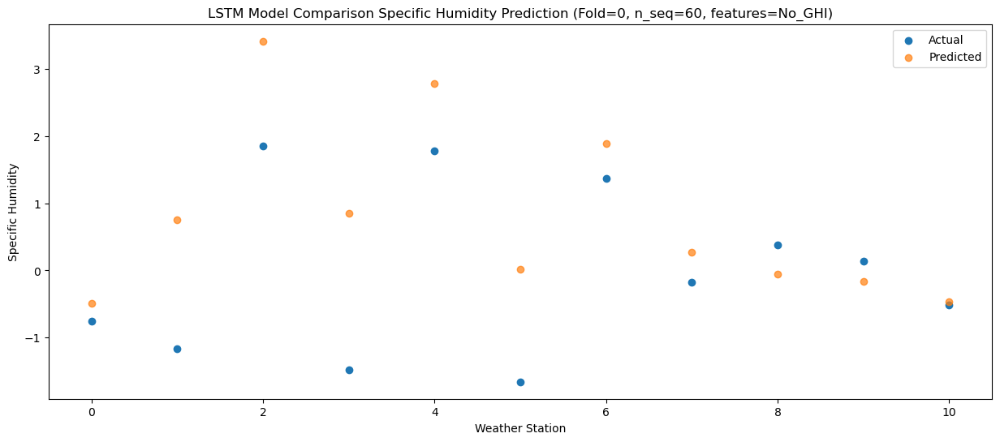

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64   0.651654
1                 1    0.74   1.894096
2                 2    2.57   4.559054
3                 3   -0.39   1.989414
4                 4    3.33   3.931058
5                 5   -0.33   1.166015
6                 6    2.38   3.038299
7                 7    0.81   1.416384
8                 8    2.06   1.086840
9                 9    1.42   0.985596
10               10    0.74   0.684466


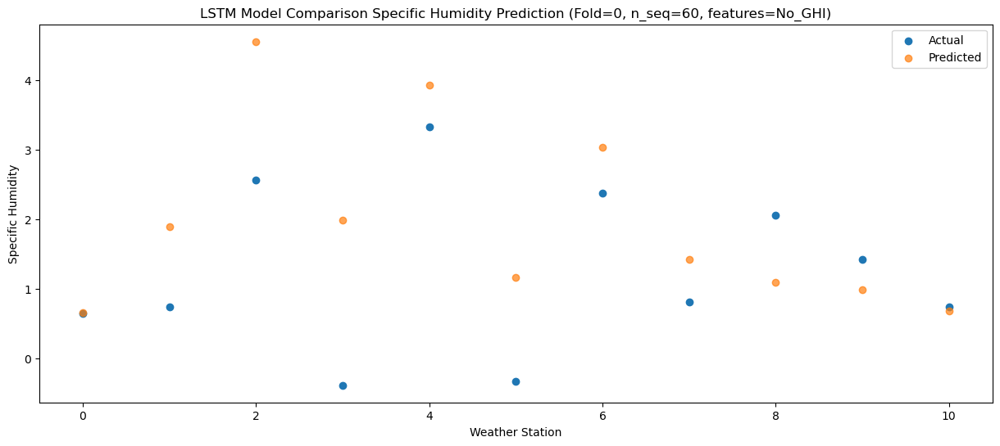

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11   1.768139
1                 1    2.04   3.010131
2                 2    4.02   5.676240
3                 3    2.53   3.102816
4                 4    7.25   5.043064
5                 5    0.80   2.281084
6                 6    3.38   4.154978
7                 7    1.71   2.532996
8                 8    3.64   2.204133
9                 9    3.04   2.105658
10               10    1.68   1.802399


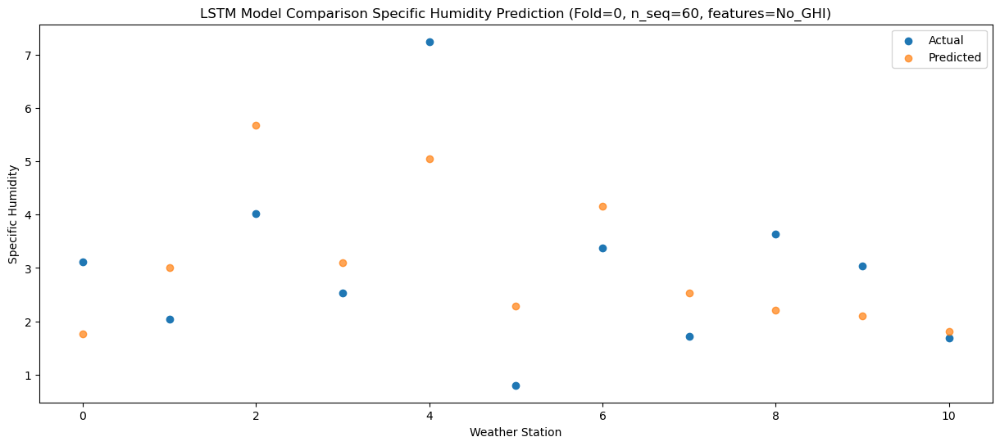

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88   5.170942
1                 1    6.28   6.414533
2                 2    8.16   9.082409
3                 3    6.77   6.509154
4                 4   10.95   8.448857
5                 5    5.58   5.686303
6                 6    7.74   7.562963
7                 7    6.00   5.941876
8                 8    7.83   5.612674
9                 9    7.65   5.516167
10               10    5.40   5.210368


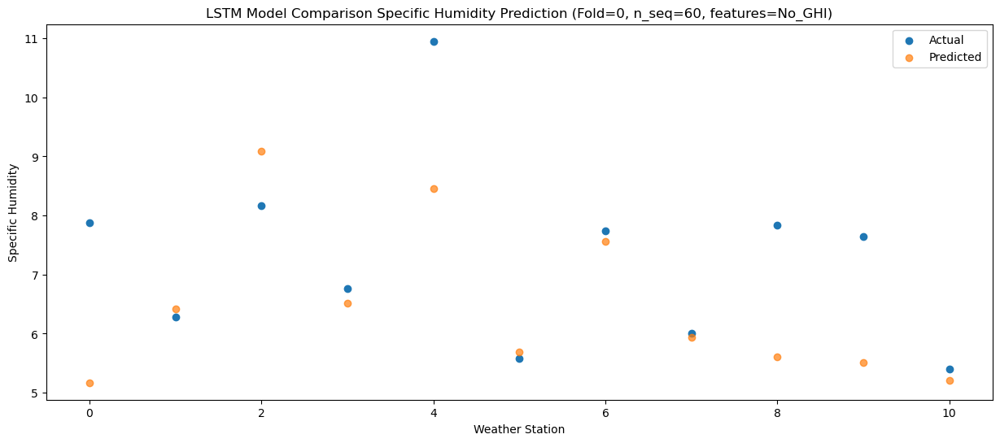

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80   7.148650
1                 1    8.89   8.390448
2                 2   10.94  11.059516
3                 3    8.78   8.488117
4                 4   11.92  10.427187
5                 5    6.67   7.661922
6                 6    9.62   9.540070
7                 7    7.45   7.918810
8                 8   10.01   7.587376
9                 9    9.33   7.489801
10               10    6.67   7.184900


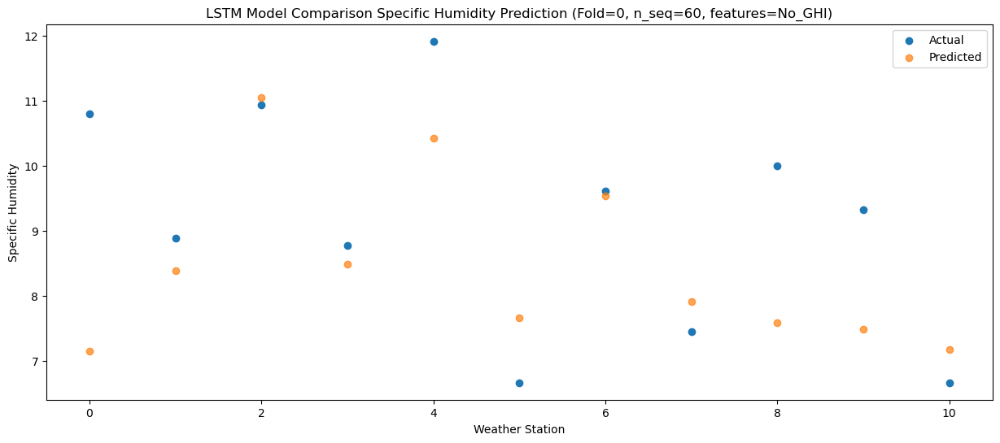

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38   8.993538
1                 1    9.79  10.234834
2                 2   13.14  12.905701
3                 3    9.99  10.334516
4                 4   11.68  12.277944
5                 5   11.00   9.510831
6                 6   13.24  11.389426
7                 7   10.82   9.768932
8                 8   13.67   9.435535
9                 9   12.91   9.338058
10               10    9.16   9.031811


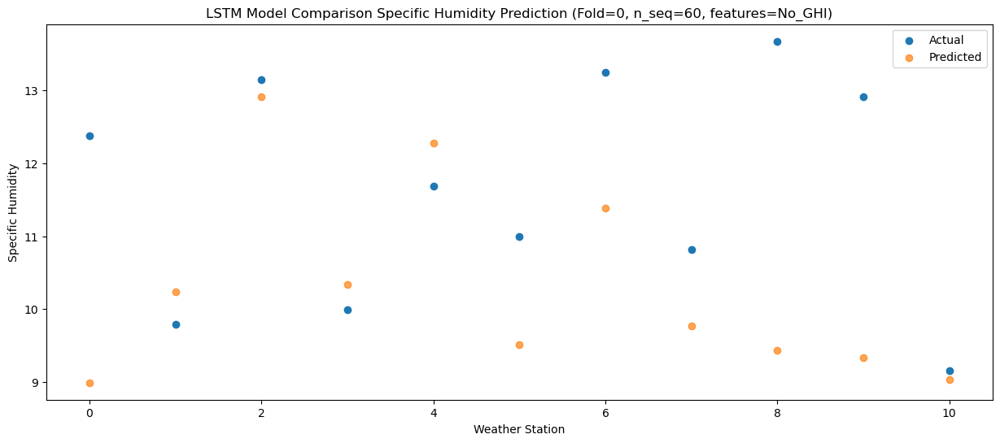

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96   9.184879
1                 1    9.22  10.426259
2                 2   12.44  13.095954
3                 3    9.27  10.527947
4                 4   12.77  12.473988
5                 5    9.21   9.703647
6                 6   11.89  11.583644
7                 7    9.75   9.961310
8                 8   12.70   9.626106
9                 9   11.37   9.528149
10               10   10.15   9.220978


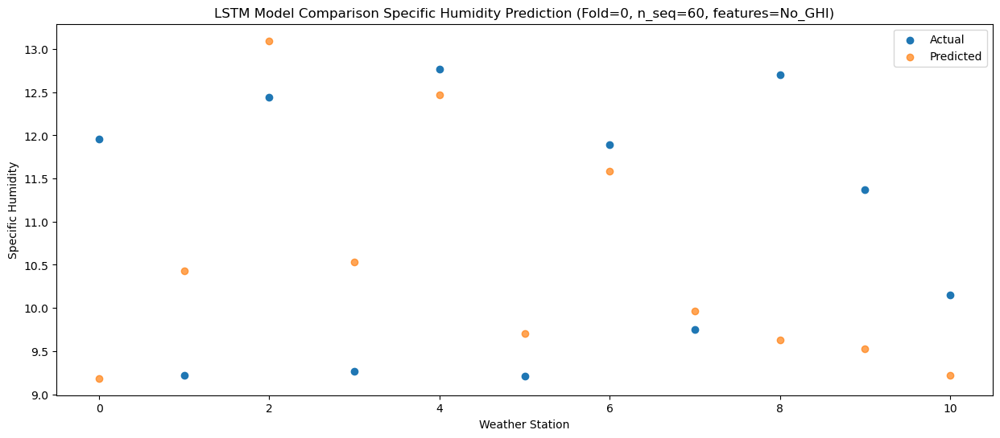

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   6.846611
1                 1    6.16   8.086987
2                 2    8.71  10.756034
3                 3    5.89   8.187127
4                 4    9.94  10.135074
5                 5    6.51   7.363270
6                 6    8.45   9.242091
7                 7    6.96   7.619922
8                 8    8.25   7.283725
9                 9    8.31   7.183845
10               10    7.55   6.876526


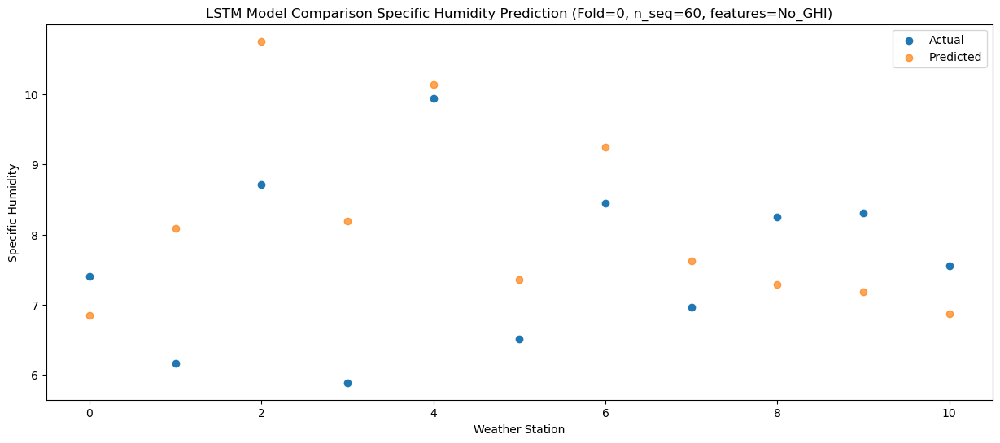

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   2.822146
1                 1    1.02   4.061512
2                 2    3.71   6.731132
3                 3    0.79   4.161007
4                 4    5.14   6.109680
5                 5    1.87   3.338189
6                 6    3.89   5.216628
7                 7    2.54   3.593766
8                 8    3.02   3.253623
9                 9    2.52   3.152354
10               10    2.53   2.844343


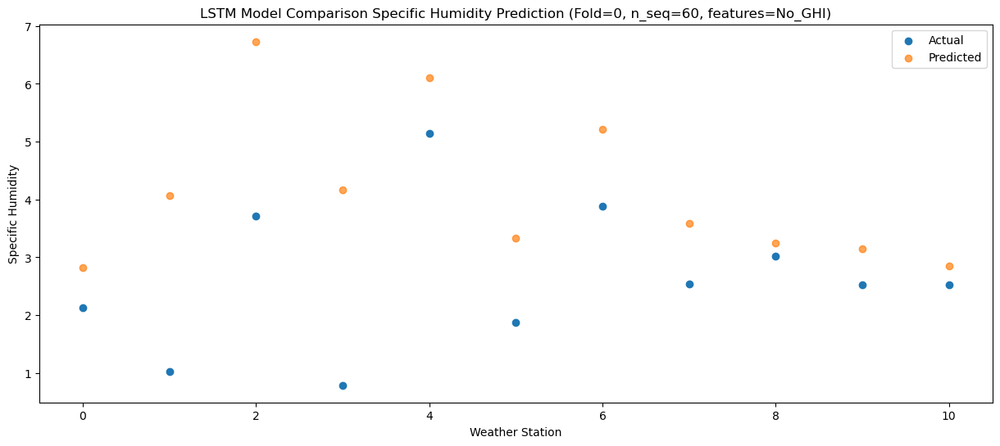

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59   1.569834
1                 1    0.82   2.811919
2                 2    3.39   5.484556
3                 3    0.27   2.916027
4                 4    5.13   4.863401
5                 5    1.21   2.093735
6                 6    3.29   3.973468
7                 7    1.84   2.352029
8                 8    2.02   2.009801
9                 9    1.80   1.908965
10               10    1.39   1.599464


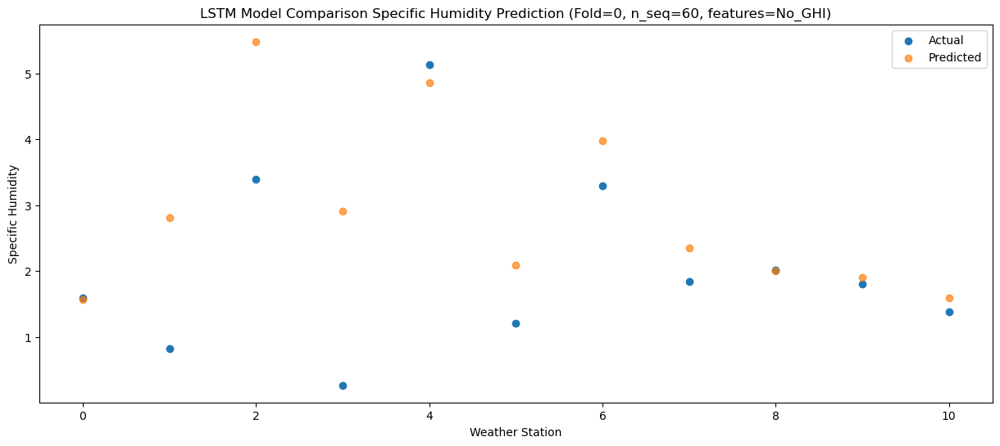

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13   0.096939
1                 1   -0.38   1.338865
2                 2    2.06   4.011205
3                 3   -0.23   1.441627
4                 4    4.05   3.389512
5                 5   -2.14   0.621771
6                 6    1.11   2.502540
7                 7   -0.50   0.880559
8                 8    1.09   0.538264
9                 9    0.87   0.437887
10               10    0.22   0.124562


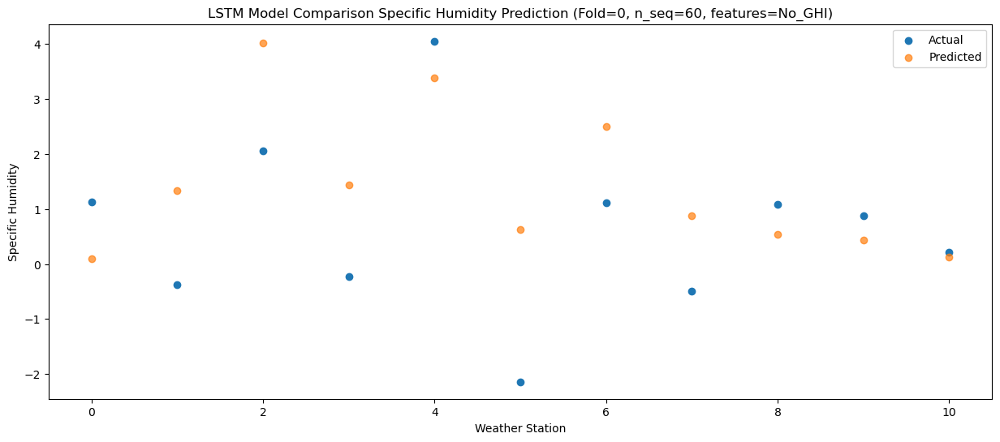

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73   0.263164
1                 1   -0.29   1.504897
2                 2    2.43   4.181307
3                 3   -0.04   1.610984
4                 4    3.29   3.555857
5                 5   -1.39   0.793329
6                 6    1.97   2.675917
7                 7    0.43   1.055305
8                 8    1.69   0.710593
9                 9    1.48   0.612430
10               10    0.62   0.296179


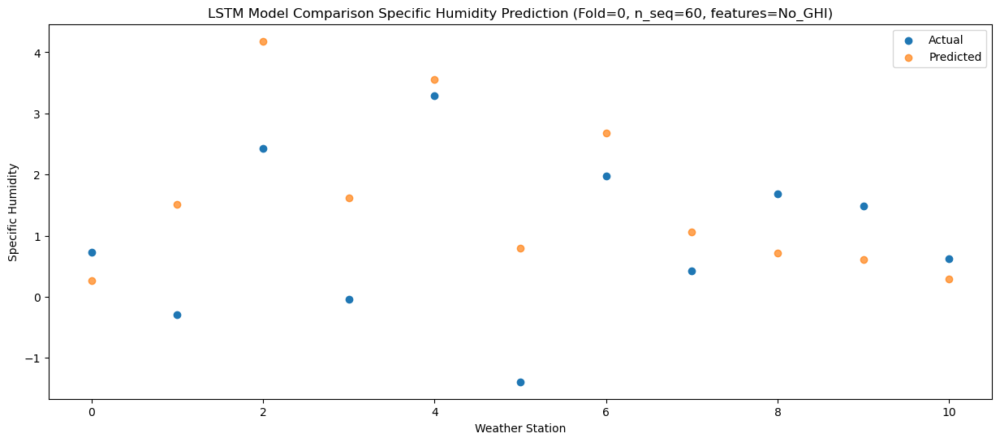

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35   0.178187
1                 1    1.40   1.421869
2                 2    3.54   4.100105
3                 3    0.63   1.528686
4                 4    3.63   3.471890
5                 5   -0.46   0.711878
6                 6    2.65   2.593765
7                 7    0.79   0.974470
8                 8    1.76   0.627262
9                 9    1.25   0.529373
10               10    0.06   0.214222


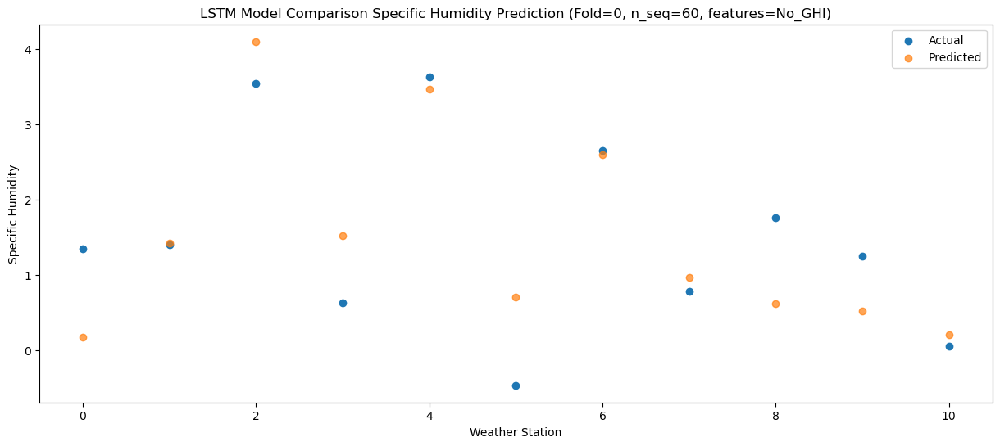

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95   0.599915
1                 1    1.78   1.844305
2                 2    2.90   4.524674
3                 3    1.71   1.954654
4                 4    5.82   3.899326
5                 5   -0.68   1.138987
6                 6    2.24   3.019619
7                 7    0.71   1.401700
8                 8    2.20   1.055404
9                 9    1.35   0.956175
10               10    0.52   0.643552


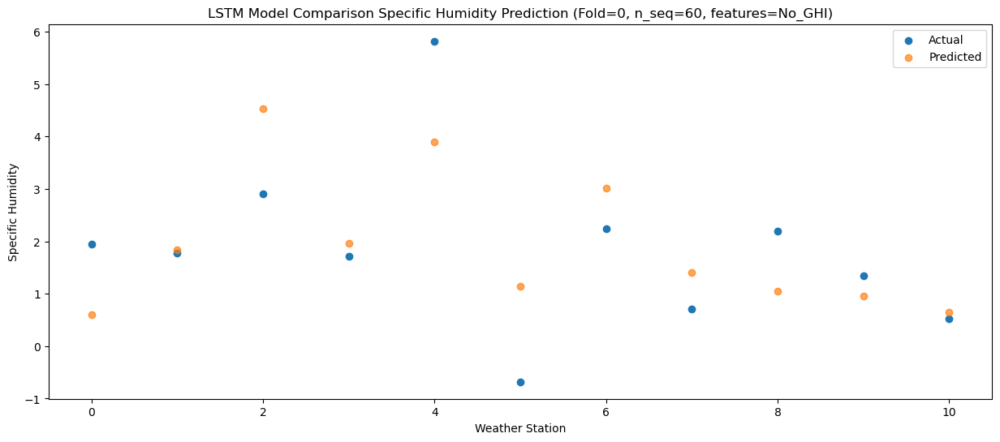

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94   2.082507
1                 1    2.57   3.328604
2                 2    4.34   6.010944
3                 3    2.11   3.440193
4                 4    6.58   5.384156
5                 5    2.00   2.625207
6                 6    4.45   4.506892
7                 7    2.99   2.890224
8                 8    3.42   2.543562
9                 9    3.08   2.444111
10               10    2.16   2.129503


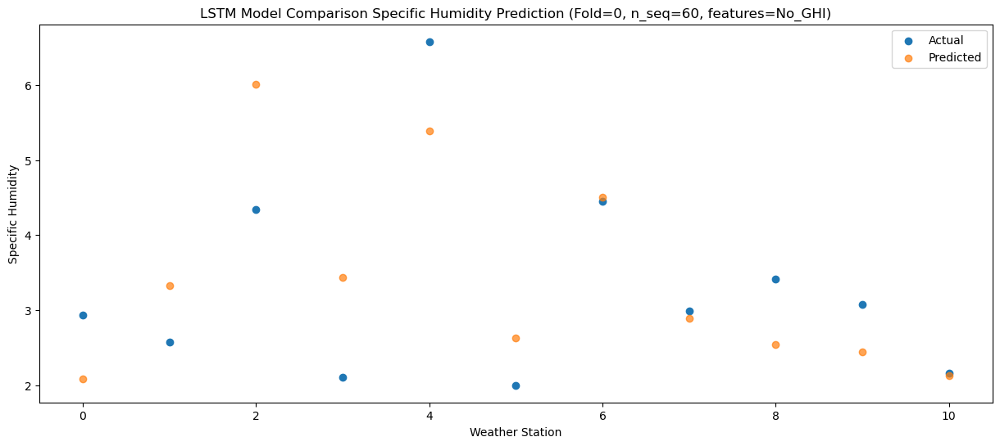

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62   3.919184
1                 1    4.76   5.162429
2                 2    7.12   7.845741
3                 3    4.96   5.273950
4                 4   10.52   7.220152
5                 5    2.76   4.459772
6                 6    6.04   6.339867
7                 7    4.31   4.722025
8                 8    6.91   4.376835
9                 9    5.52   4.276499
10               10    3.37   3.961514


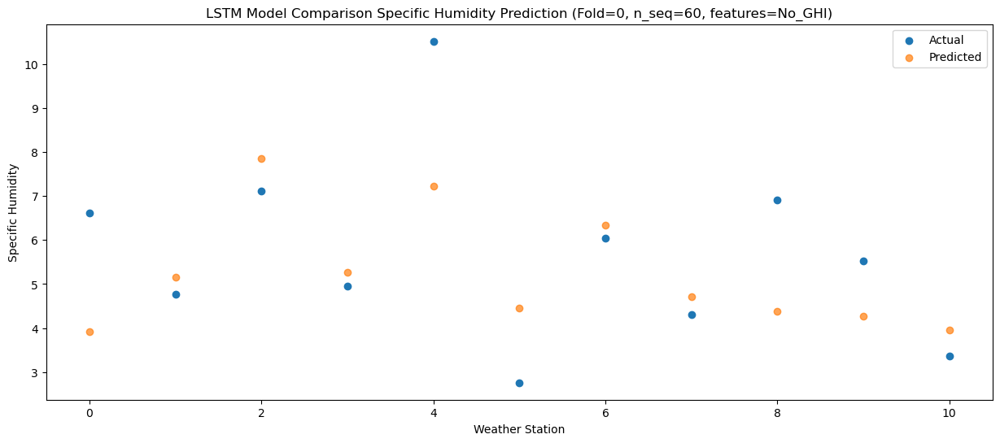

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41   6.670929
1                 1    8.09   7.916740
2                 2    9.70  10.602533
3                 3    9.11   8.030597
4                 4   14.64   9.974965
5                 5    6.66   7.218720
6                 6    8.77   9.098190
7                 7    6.93   7.481992
8                 8    9.19   7.136585
9                 9    8.14   7.035943
10               10    6.38   6.722656


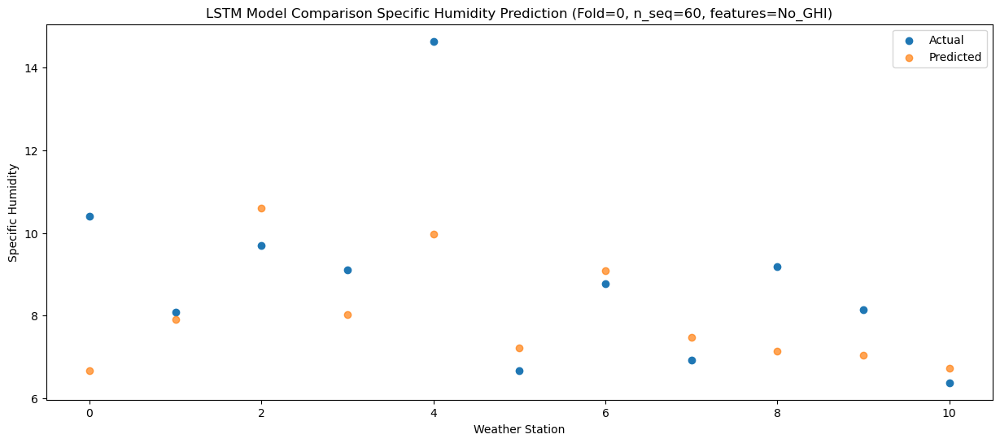

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70   9.314261
1                 1    9.76  10.558155
2                 2   12.56  13.246199
3                 3   10.14  10.673188
4                 4   13.22  12.617518
5                 5   11.01   9.863451
6                 6   12.51  11.743711
7                 7   11.28  10.128916
8                 8   12.74   9.786232
9                 9   11.96   9.688425
10               10   10.21   9.377119


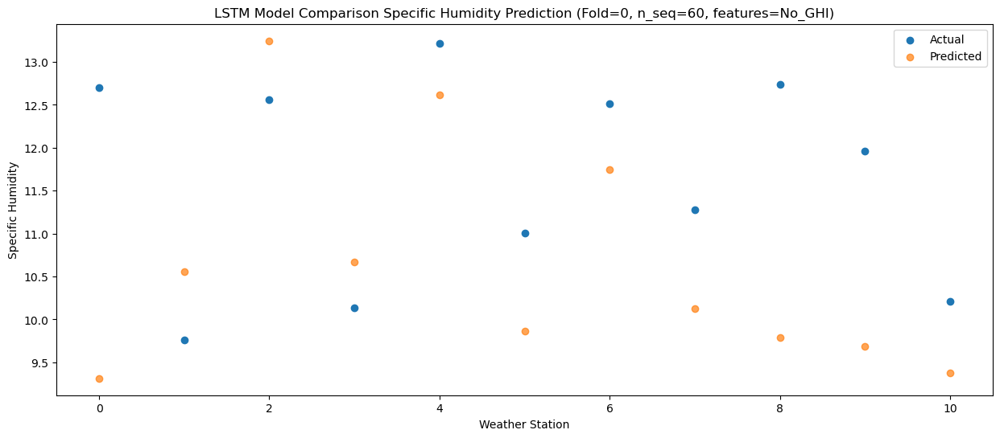

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32   8.620747
1                 1   10.54   9.863013
2                 2   12.65  12.549968
3                 3    9.89   9.975814
4                 4   11.40  11.923282
5                 5   10.12   9.166029
6                 6   12.14  11.046297
7                 7   10.22   9.431522
8                 8   12.74   9.090215
9                 9   10.66   8.990635
10               10    9.46   8.679287


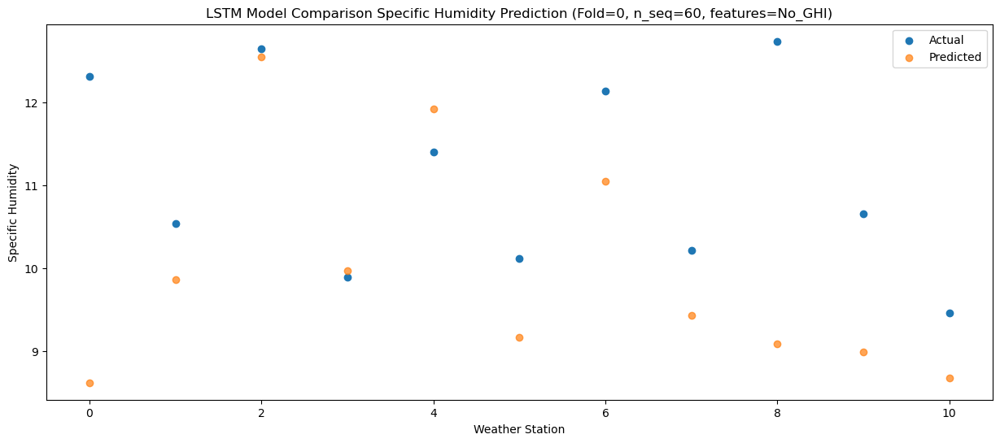

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35   7.029346
1                 1    6.52   8.270393
2                 2    9.07  10.958418
3                 3    7.71   8.384166
4                 4   11.36  10.331483
5                 5    7.00   7.575086
6                 6    9.20   9.454617
7                 7    7.42   7.838950
8                 8    8.67   7.495018
9                 9    7.94   7.394426
10               10    8.15   7.085007


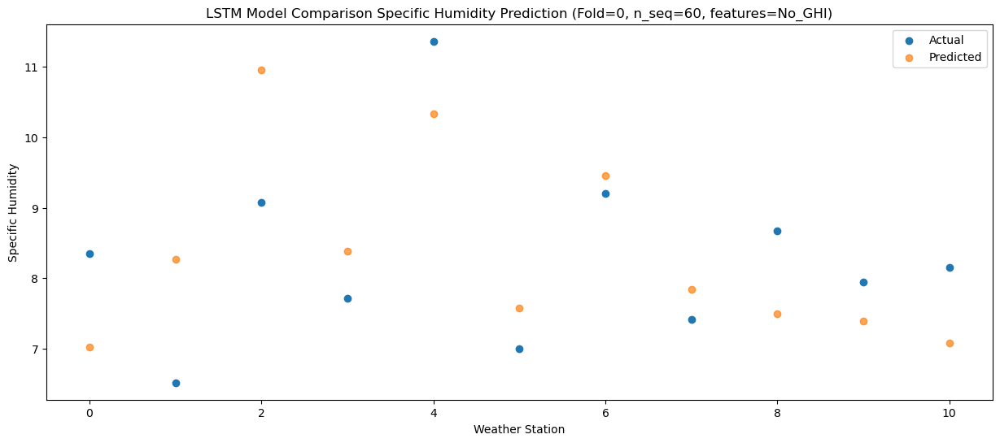

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32   3.934604
1                 1    1.82   5.172078
2                 2    5.16   7.859921
3                 3    3.14   5.283580
4                 4    7.61   7.230803
5                 5    2.60   4.474997
6                 6    4.94   6.354060
7                 7    3.67   4.738697
8                 8    4.61   4.398018
9                 9    4.70   4.297805
10               10    4.39   3.991741


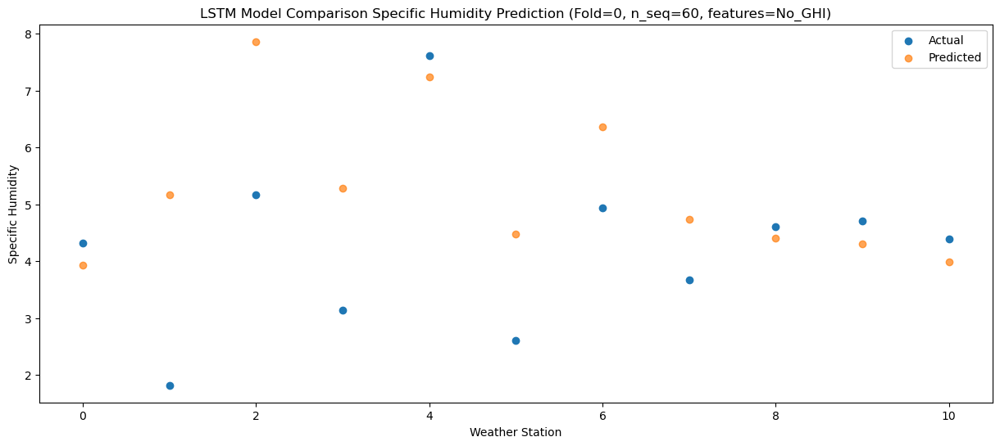

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14   0.799686
1                 1   -0.36   2.037946
2                 2    2.63   4.725506
3                 3    0.15   2.148768
4                 4    4.81   4.093953
5                 5   -0.42   1.338469
6                 6    1.61   3.215294
7                 7    0.15   1.600016
8                 8    1.95   1.261898
9                 9    1.35   1.160403
10               10    0.98   0.854323


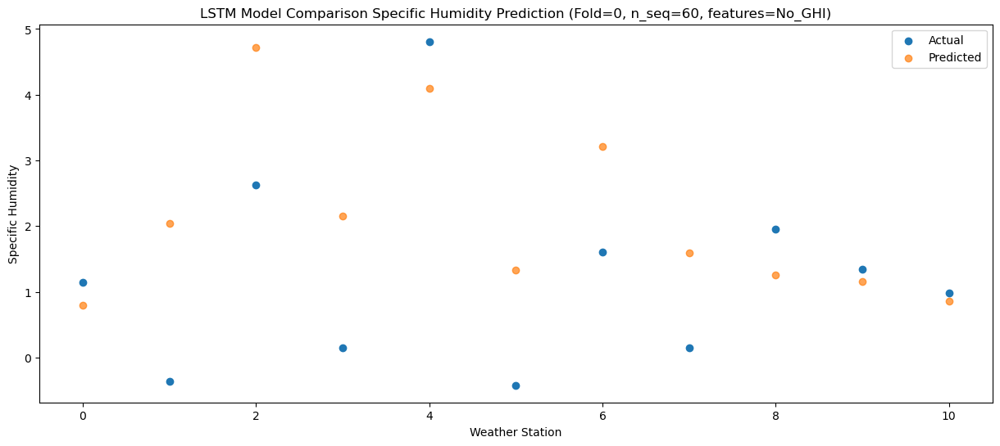

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14   0.714664
1                 1   -1.80   1.951039
2                 2    1.82   4.639534
3                 3   -1.25   2.061567
4                 4    2.95   4.007746
5                 5   -1.24   1.253936
6                 6    1.54   3.128727
7                 7    0.35   1.512560
8                 8    1.34   1.173368
9                 9    1.54   1.072560
10               10    1.51   0.768586


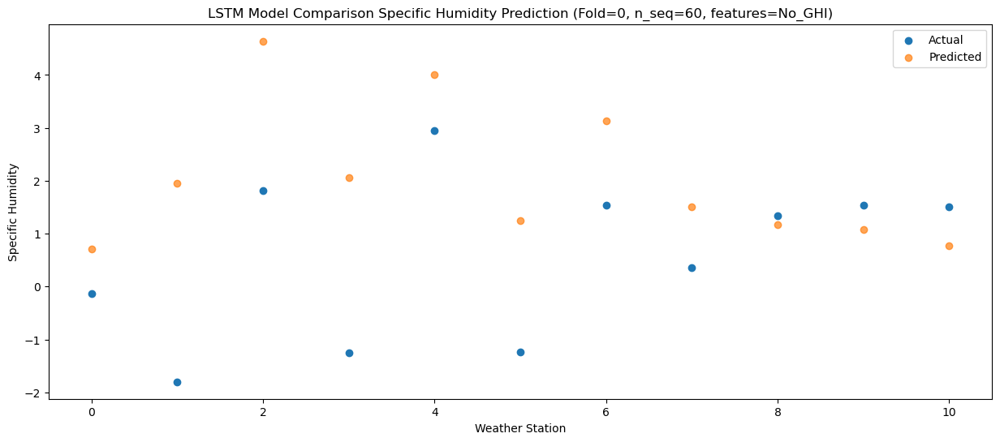

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -0.382371
1                 1   -2.58   0.853749
2                 2    1.02   3.541966
3                 3   -2.17   0.963561
4                 4    1.77   2.909930
5                 5   -2.03   0.155758
6                 6    0.87   2.031760
7                 7   -0.34   0.417022
8                 8    0.16   0.081725
9                 9    0.57  -0.018569
10               10   -0.01  -0.324551


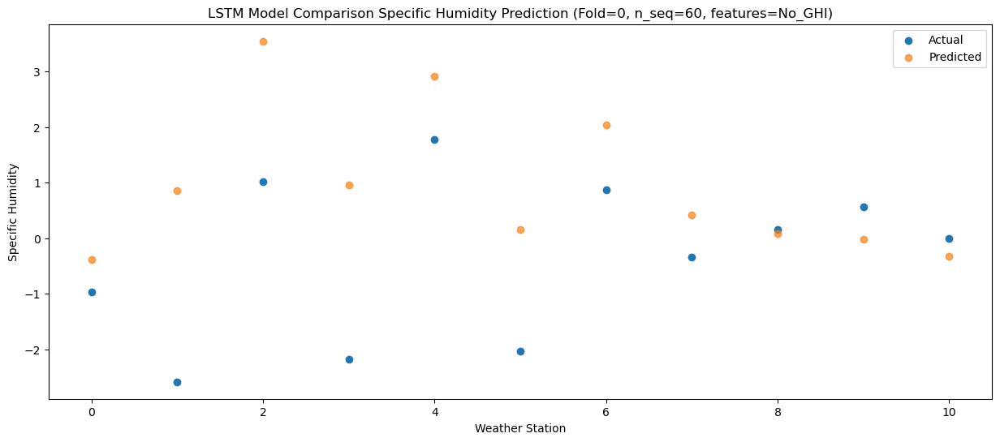

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94  -0.059137
1                 1   -1.36   1.172530
2                 2    1.66   3.860325
3                 3   -0.39   1.281006
4                 4    4.34   3.230437
5                 5   -2.13   0.472446
6                 6    1.03   2.349192
7                 7   -0.31   0.734255
8                 8    1.92   0.400355
9                 9    0.92   0.299992
10               10    0.52  -0.003870


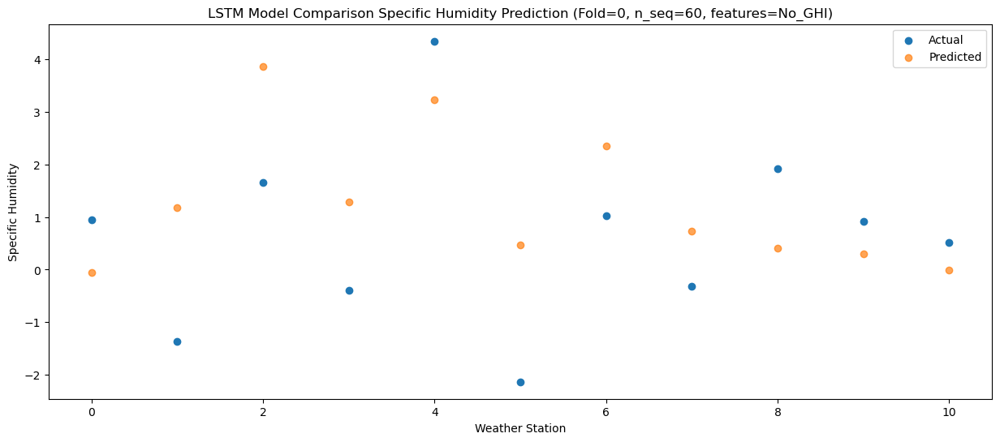

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20   1.009904
1                 1    0.49   2.246043
2                 2    3.29   4.934877
3                 3    1.40   2.357780
4                 4    6.08   4.306887
5                 5   -0.21   1.545986
6                 6    2.48   3.422995
7                 7    0.83   1.808807
8                 8    2.79   1.476078
9                 9    2.05   1.375282
10               10    1.21   1.067664


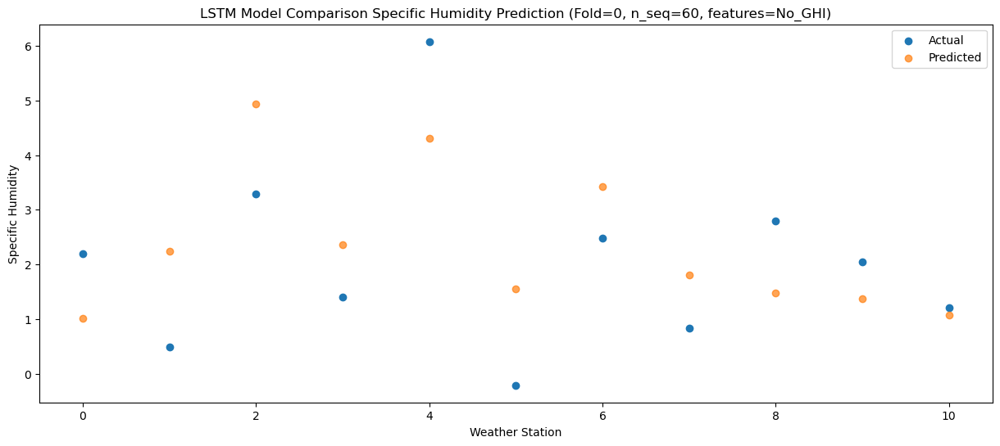

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51   2.226612
1                 1    2.40   3.461926
2                 2    5.03   6.153996
3                 3    3.45   3.575839
4                 4    8.32   5.523622
5                 5    1.13   2.767381
6                 6    4.54   4.646050
7                 7    2.85   3.033603
8                 8    5.02   2.698165
9                 9    4.42   2.599631
10               10    2.77   2.291385


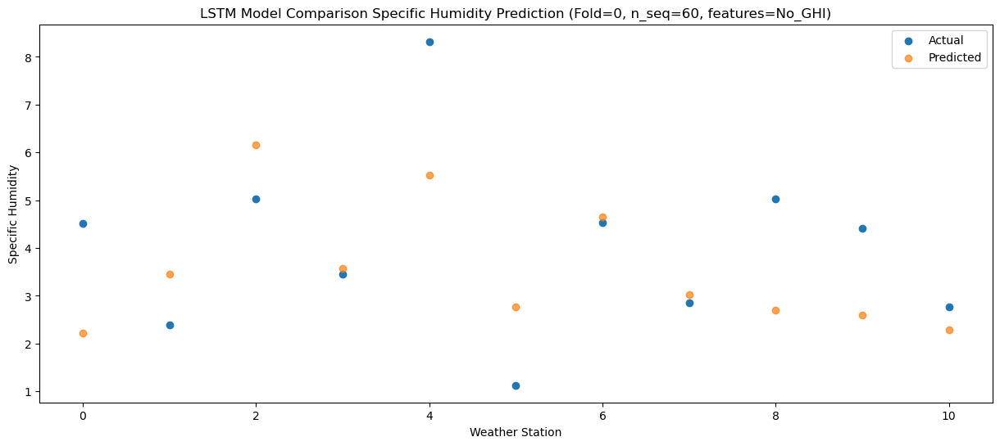

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   5.262178
1                 1    6.98   6.494158
2                 2    8.78   9.183605
3                 3    8.02   6.606411
4                 4   12.57   8.555903
5                 5    5.19   5.795369
6                 6    8.45   7.673494
7                 7    6.67   6.059565
8                 8    9.30   5.724783
9                 9    8.22   5.624339
10               10    5.82   5.317198


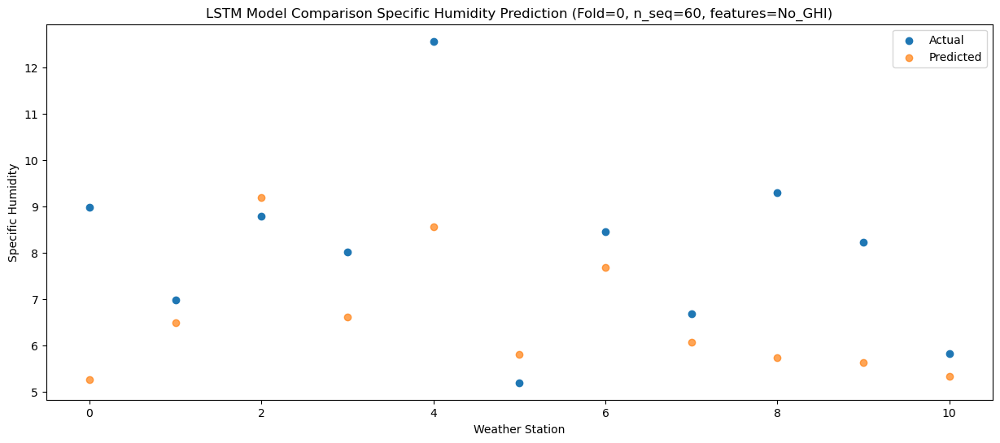

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37   7.819385
1                 1    8.58   9.050921
2                 2    9.91  11.743663
3                 3    9.53   9.165863
4                 4   14.22  11.115311
5                 5    7.16   8.356991
6                 6   10.27  10.233776
7                 7    8.36   8.621917
8                 8   11.72   8.287094
9                 9    9.29   8.187697
10               10    8.32   7.881752


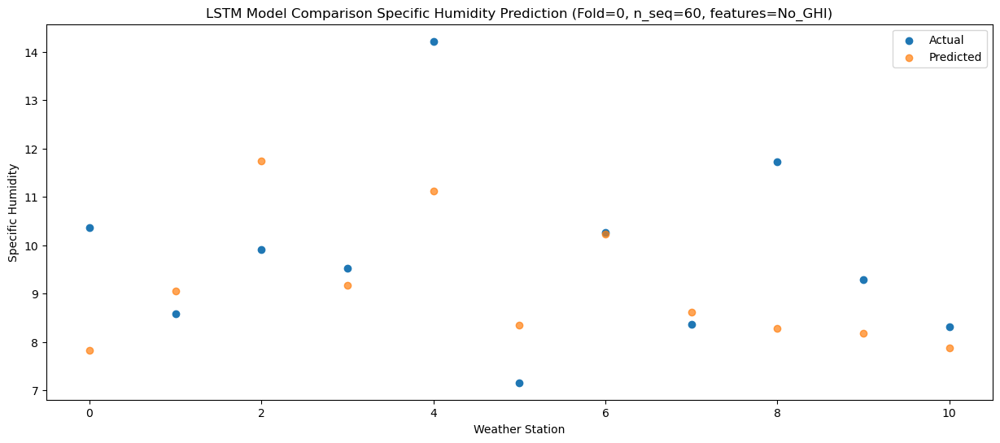

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66   9.105854
1                 1   10.75  10.337604
2                 2   13.14  13.032135
3                 3   10.93  10.455981
4                 4   13.96  12.403851
5                 5    9.95   9.648549
6                 6   12.80  11.526610
7                 7   11.25   9.916394
8                 8   12.90   9.579785
9                 9   10.79   9.483546
10               10    9.39   9.178116


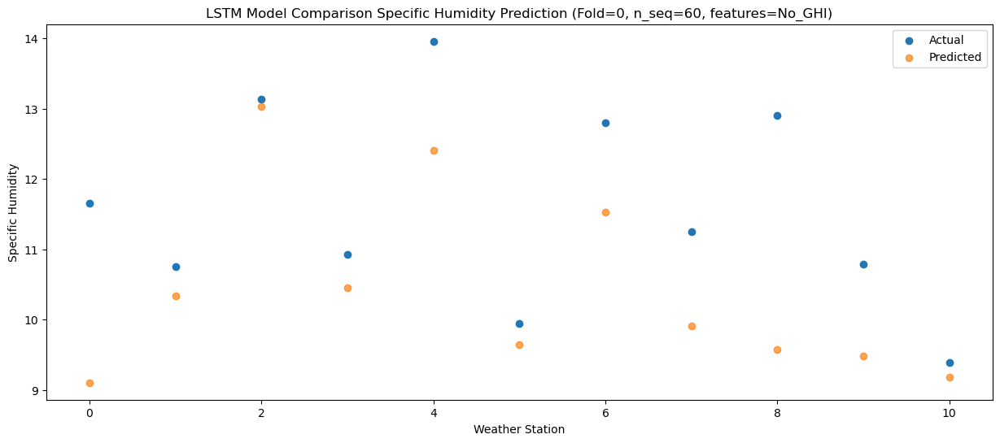

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83   8.763877
1                 1    9.25   9.997308
2                 2   11.45  12.691350
3                 3    9.79  10.116417
4                 4   13.61  12.064133
5                 5    8.94   9.310791
6                 6   11.64  11.188193
7                 7    9.82   9.578421
8                 8   11.23   9.239756
9                 9    9.99   9.144160
10               10    9.15   8.841323


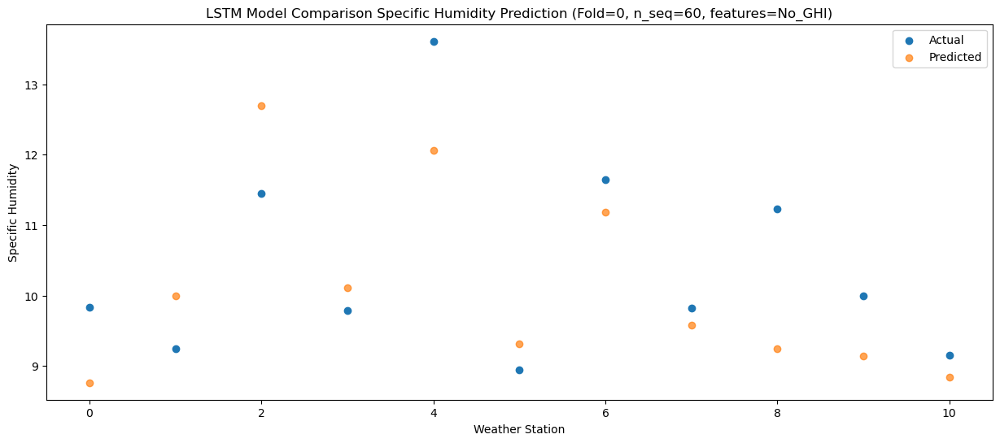

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36   6.968476
1                 1    8.38   8.200705
2                 2    9.76  10.894956
3                 3    8.23   8.317965
4                 4   11.12  10.267217
5                 5    6.99   7.515030
6                 6    9.91   9.391663
7                 7    8.23   7.780443
8                 8    9.19   7.437505
9                 9    7.64   7.341781
10               10    7.44   7.039668


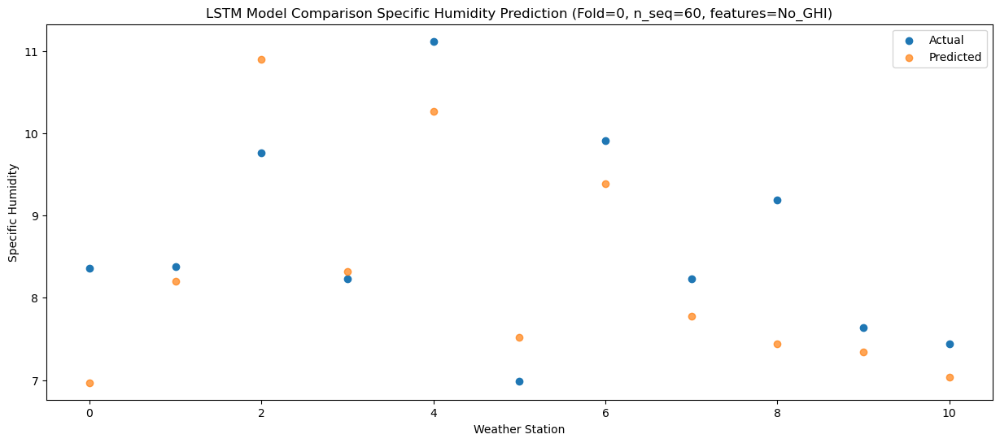

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98   3.131346
1                 1    2.98   4.362938
2                 2    5.63   7.057506
3                 3    3.04   4.479713
4                 4    7.51   6.429834
5                 5    1.70   3.678946
6                 6    5.21   5.555722
7                 7    3.34   3.944442
8                 8    4.59   3.600160
9                 9    4.11   3.504359
10               10    3.24   3.202364


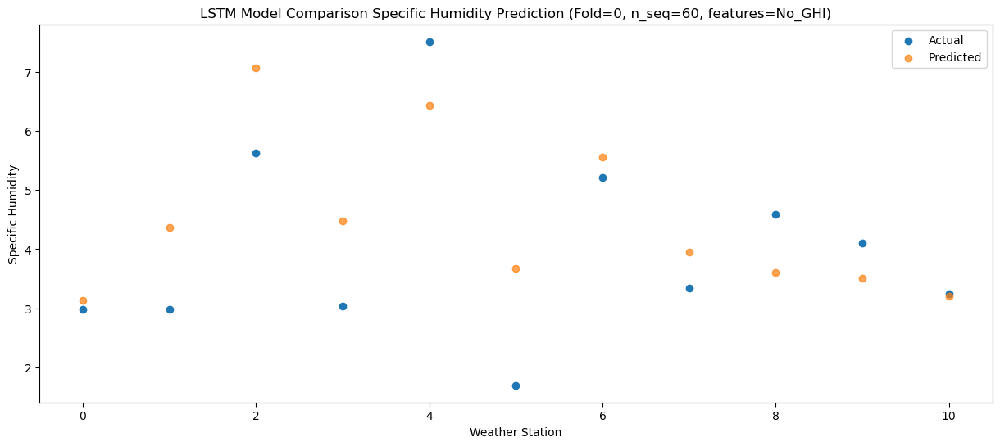

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

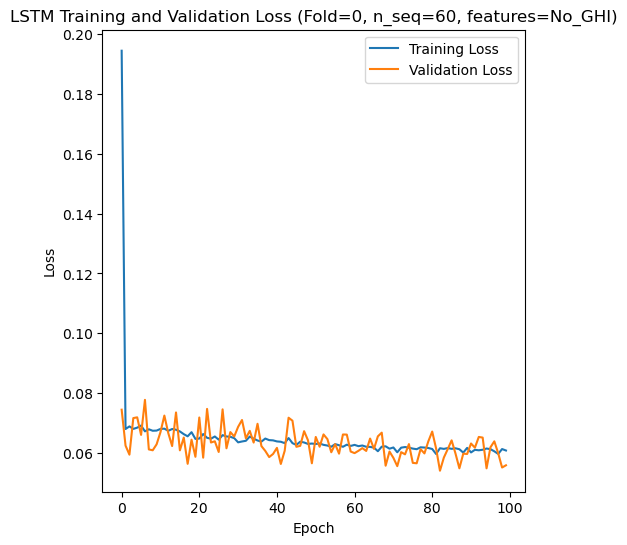

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 50s 291ms/step - loss: 0.1775 - accuracy: 0.3929 - mae: 0.1410 - rmse: 0.1775 - mape: 30.5354 - pearson: 0.6073 - val_loss: 0.0618 - val_accuracy: 0.5000 - val_mae: 0.0481 - val_rmse: 0.0618 - val_mape: 10.5096 - val_pearson: 0.7729
Epoch 2/100
84/84 [==============================] - 14s 170ms/step - loss: 0.0684 - accuracy: 0.4762 - mae: 0.0538 - rmse: 0.0684 - mape: 12.2150 - pearson: 0.7633 - val_loss: 0.0683 - val_accuracy: 0.5000 - val_mae: 0.0513 - val_rmse: 0.0683 - val_mape: 11.9624 - val_pearson: 0.7322
Epoch 3/100
84/84 [==============================] - 14s 173ms/step - loss: 0.0688 - accuracy: 0.4167 - mae: 0.0543 - rmse: 0.0688 - mape: 12.4365 - pearson: 0.7644

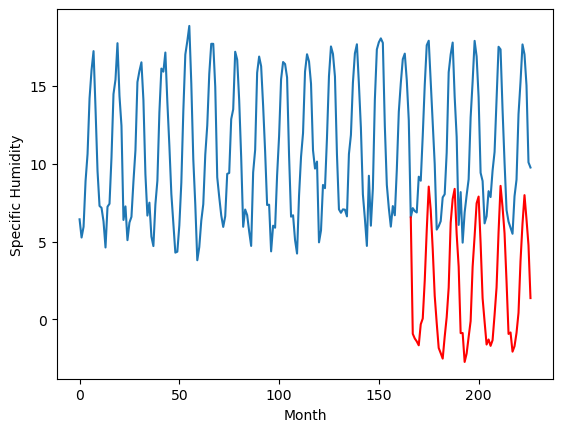

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		3.13		2.02
1.16		2.83		1.67
0.91		2.64		1.73
1.43		2.39		0.96
3.66		3.75		0.09
2.07		4.11		2.04
5.08		6.55		1.47
8.88		9.78		0.90
10.92		12.60		1.68
10.97		11.09		0.12
8.07		8.58		0.51
5.40		5.58		0.18
2.34		3.83		1.49
-0.25		2.22		2.47
-0.23		1.89		2.12
-0.04		1.54		1.58
1.49		2.94		1.45
1.85		4.20		2.35
4.77		6.10		1.33
8.75		10.27		1.52
10.62		11.80		1.18
10.83		12.45		1.62
7.88		9.54		1.66
5.84		7.45		1.61
0.25		3.17		2.92
2.42		3.18		0.76
-0.58		1.33		1.91
0.37		1.87		1.50
1.05		2.92		1.87
2.11		3.95		1.84
6.28		7.44		1.16
8.68		9.41		0.73
11.35		11.52		0.17
10.94		11.95		1.01
7.58		8.96		1.38
2.69		5.42		2.73
2.21		3.91		1.70
0.62		2.45		1.83
1.03		2.77		1.74
2.15		2.36		0.21
1.28		2.73		1.45
2.88		4.35		1.47
5.62		6.12		0.50
7.97		9.67		1.70
10.93		12.65		1.72
11.06		11.28		0.22
7.95		9.60		1.65
4.10		6.50		2.40
1.09		3.13		2.04
0.51		3.22		2.71
-0.26		1.99		2.25
0.08		2.34		2.26

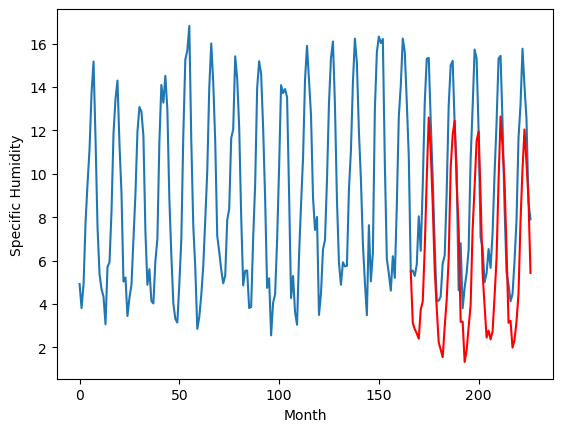

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.62		1.67
0.86		1.33		0.47
0.35		1.14		0.79
0.74		0.89		0.15
3.90		2.24		-1.66
2.28		2.61		0.33
5.05		5.04		-0.01
8.90		8.27		-0.63
11.45		11.09		-0.36
10.97		9.58		-1.39
8.02		7.07		-0.95
5.26		4.07		-1.19
2.08		2.32		0.24
-0.69		0.71		1.40
-0.54		0.38		0.92
-0.54		0.03		0.57
2.08		1.44		-0.64
1.79		2.69		0.90
4.63		4.59		-0.04
9.15		8.76		-0.39
10.74		10.29		-0.45
10.96		10.94		-0.02
8.20		8.02		-0.18
5.45		5.94		0.49
-0.05		1.66		1.71
2.59		1.67		-0.92
-1.29		-0.18		1.11
-0.26		0.36		0.62
0.53		1.41		0.88
2.29		2.44		0.15
6.65		5.93		-0.72
9.74		7.90		-1.84
11.37		10.02		-1.35
10.50		10.45		-0.05
6.99		7.45		0.46
1.88		3.92		2.04
1.51		2.40		0.89
0.82		0.94		0.12
0.79		1.27		0.48
1.84		0.86		-0.98
1.37		1.23		-0.14
2.73		2.85		0.12
6.03		4.62		-1.41
8.68		8.17		-0.51
11.82		11.14		-0.68
11.75		9.77		-1.98
7.94		8.09		0.15
3.43		4.99		1.56
0.88		1.63		0.75
-0.14		1.72		1.86
-0.77		0

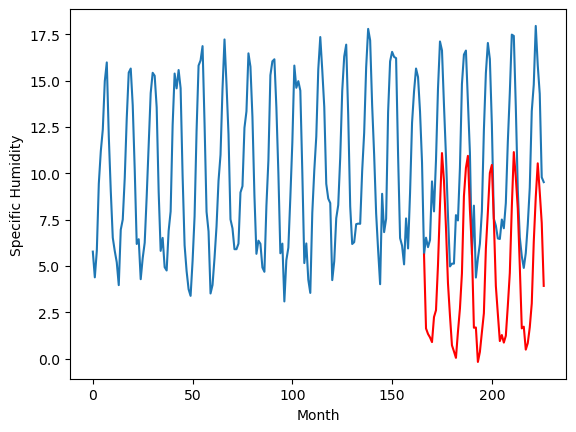

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		2.48		0.59
0.69		2.18		1.49
1.59		1.99		0.40
0.89		1.74		0.85
5.25		3.09		-2.16
4.91		3.45		-1.46
6.89		5.89		-1.00
9.01		9.11		0.10
11.52		11.93		0.41
10.41		10.43		0.02
8.83		7.91		-0.92
5.43		4.91		-0.52
3.33		3.16		-0.17
0.78		1.55		0.77
0.44		1.22		0.78
0.51		0.87		0.36
3.15		2.27		-0.88
4.49		3.53		-0.96
8.38		5.43		-2.95
11.57		9.59		-1.98
12.05		11.12		-0.93
12.39		11.77		-0.62
9.30		8.86		-0.44
7.05		6.77		-0.28
2.60		2.49		-0.11
5.52		2.51		-3.01
-0.13		0.65		0.78
0.04		1.19		1.15
1.72		2.24		0.52
5.88		3.28		-2.60
9.69		6.76		-2.93
10.74		8.73		-2.01
11.66		10.84		-0.82
11.91		11.27		-0.64
8.62		8.28		-0.34
3.66		4.74		1.08
3.16		3.23		0.07
2.35		1.77		-0.58
1.93		2.09		0.16
2.71		1.68		-1.03
4.26		2.05		-2.21
4.63		3.67		-0.96
8.41		5.44		-2.97
11.81		8.99		-2.82
12.37		11.96		-0.41
10.70		10.59		-0.11
9.50		8.91		-0.59
6.08		5.81		-0.27
2.75		2.44		-0.31
1.11		2.53		1.42
0.

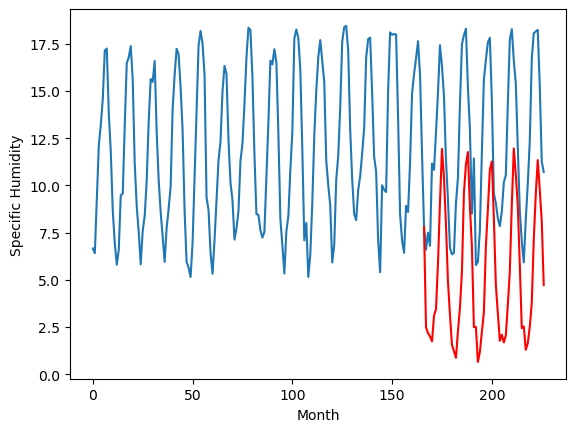

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		3.37		0.93
1.20		3.07		1.87
2.11		2.88		0.77
1.43		2.63		1.20
6.16		3.98		-2.18
5.85		4.34		-1.51
7.97		6.77		-1.20
10.26		10.00		-0.26
12.86		12.82		-0.04
11.41		11.31		-0.10
9.92		8.79		-1.13
6.07		5.80		-0.27
3.59		4.04		0.45
0.77		2.44		1.67
0.52		2.10		1.58
0.56		1.75		1.19
3.28		3.15		-0.13
4.54		4.41		-0.13
8.57		6.31		-2.26
11.98		10.48		-1.50
12.16		12.00		-0.16
12.20		12.66		0.46
9.10		9.74		0.64
7.15		7.66		0.51
2.56		3.38		0.82
5.49		3.40		-2.09
-0.05		1.54		1.59
0.15		2.08		1.93
1.85		3.13		1.28
5.95		4.17		-1.78
9.83		7.65		-2.18
10.95		9.62		-1.33
11.70		11.74		0.04
12.08		12.16		0.08
8.73		9.17		0.44
3.83		5.63		1.80
3.45		4.12		0.67
2.63		2.66		0.03
2.15		2.98		0.83
2.75		2.57		-0.18
4.45		2.94		-1.51
4.90		4.55		-0.35
8.57		6.33		-2.24
11.83		9.88		-1.95
11.91		12.84		0.93
10.51		11.48		0.97
9.76		9.80		0.04
6.37		6.70		0.33
3.03		3.33		0.30
1.31		3.42		2.11
0.14		2.19

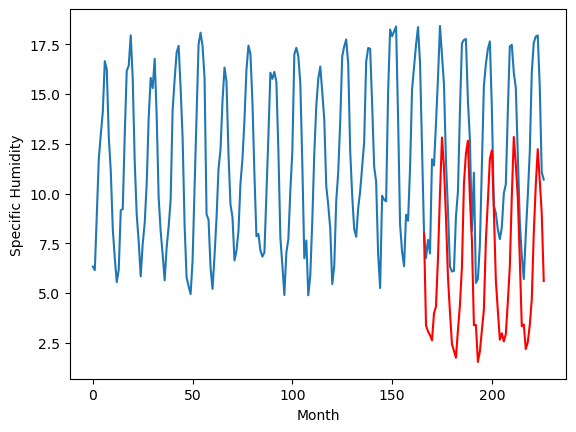

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		3.04		-1.72
3.28		2.75		-0.53
3.00		2.56		-0.44
3.18		2.30		-0.88
5.85		3.65		-2.20
4.84		4.01		-0.83
7.52		6.45		-1.07
9.34		9.67		0.33
10.33		12.49		2.16
9.10		10.98		1.88
8.67		8.47		-0.20
5.16		5.47		0.31
4.60		3.71		-0.89
2.16		2.11		-0.05
2.99		1.78		-1.21
2.36		1.43		-0.93
3.15		2.83		-0.32
4.45		4.08		-0.37
8.76		5.99		-2.77
10.93		10.16		-0.77
12.26		11.69		-0.57
12.48		12.34		-0.14
8.94		9.43		0.49
5.83		7.34		1.51
3.99		3.07		-0.92
2.94		3.09		0.15
1.67		1.23		-0.44
1.55		1.77		0.22
2.10		2.83		0.73
4.37		3.86		-0.51
6.14		7.35		1.21
8.74		9.32		0.58
9.69		11.43		1.74
11.80		11.86		0.06
10.53		8.86		-1.67
7.34		5.33		-2.01
4.47		3.81		-0.66
3.80		2.35		-1.45
2.25		2.68		0.43
2.28		2.27		-0.01
3.33		2.64		-0.69
3.59		4.25		0.66
7.96		6.02		-1.94
7.91		9.58		1.67
10.08		12.54		2.46
10.23		11.18		0.95
9.87		9.50		-0.37
7.89		6.40		-1.49
5.26		3.04		-2.22
3.39		3.13		-0.26
2.24		

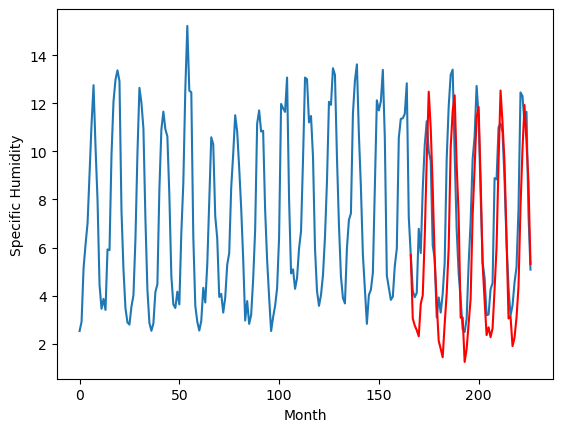

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		-0.77		1.78
-2.52		-1.07		1.45
-2.94		-1.26		1.68
-2.46		-1.51		0.95
-0.49		-0.16		0.33
-1.14		0.20		1.34
2.06		2.63		0.57
5.70		5.86		0.16
8.14		8.68		0.54
8.16		7.17		-0.99
4.85		4.66		-0.19
2.36		1.66		-0.70
-0.75		-0.10		0.65
-3.47		-1.69		1.78
-3.58		-2.03		1.55
-3.46		-2.37		1.09
-1.90		-0.98		0.92
-1.28		0.28		1.56
1.65		2.18		0.53
6.00		6.35		0.35
8.50		7.88		-0.62
8.79		8.53		-0.26
5.44		5.62		0.18
3.31		3.54		0.23
-2.62		-0.74		1.88
-0.75		-0.73		0.02
-3.75		-2.58		1.17
-2.62		-2.04		0.58
-1.87		-0.99		0.88
-0.68		0.05		0.73
3.58		3.54		-0.04
6.30		5.51		-0.79
9.29		7.62		-1.67
8.20		8.05		-0.15
4.72		5.06		0.34
-0.34		1.52		1.86
-0.83		0.01		0.84
-2.73		-1.45		1.28
-2.37		-1.12		1.25
-1.17		-1.53		-0.36
-1.93		-1.17		0.76
-0.12		0.45		0.57
2.44		2.22		-0.22
5.02		5.78		0.76
8.64		8.74		0.10
8.53		7.38		-1.15
5.56		5.70		0.14
1.31		2.60		1.29
-2.04		-0.77		1.27
-2.54		-0.68		

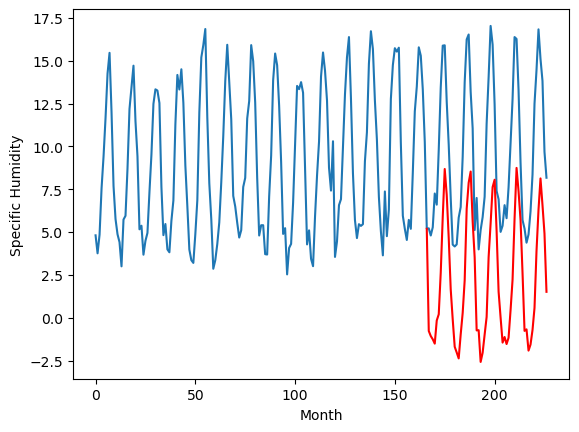

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		1.52		0.26
0.93		1.23		0.30
0.85		1.04		0.19
0.73		0.78		0.05
3.39		2.13		-1.26
3.65		2.50		-1.15
6.55		4.93		-1.62
10.38		8.16		-2.22
13.46		10.98		-2.48
11.29		9.47		-1.82
9.49		6.96		-2.53
4.67		3.96		-0.71
2.65		2.21		-0.44
0.33		0.61		0.28
0.20		0.28		0.08
-0.32		-0.07		0.25
2.41		1.32		-1.09
3.64		2.58		-1.06
6.85		4.48		-2.37
11.61		8.65		-2.96
12.24		10.18		-2.06
12.09		10.83		-1.26
8.84		7.92		-0.92
6.11		5.83		-0.28
1.55		1.56		0.01
3.19		1.57		-1.62
-0.56		-0.28		0.28
0.12		0.26		0.14
1.65		1.31		-0.34
3.84		2.34		-1.50
8.29		5.83		-2.46
11.05		7.80		-3.25
12.02		9.92		-2.10
11.93		10.35		-1.58
7.97		7.35		-0.62
3.43		3.82		0.39
2.18		2.31		0.13
1.27		0.84		-0.43
1.39		1.17		-0.22
1.49		0.76		-0.73
2.25		1.13		-1.12
3.45		2.74		-0.71
7.49		4.52		-2.97
10.41		8.07		-2.34
12.98		11.04		-1.94
12.56		9.67		-2.89
8.07		7.99		-0.08
4.82		4.89		0.07
2.11		1.53		-0.58
0.72		1.62		0.9

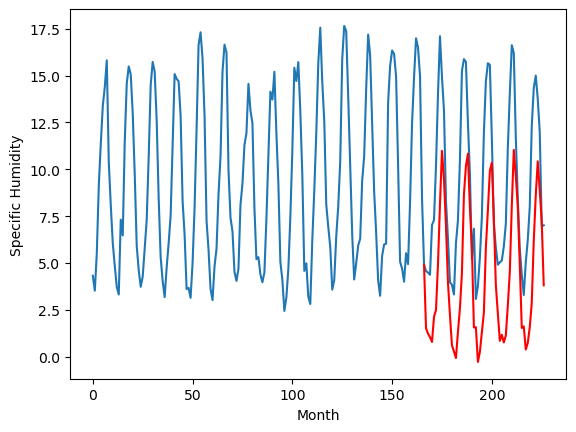

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		1.03		-0.99
1.18		0.74		-0.44
1.63		0.54		-1.09
1.01		0.29		-0.72
4.03		1.64		-2.39
4.22		2.00		-2.22
7.55		4.44		-3.11
9.69		7.66		-2.03
13.05		10.48		-2.57
10.15		8.97		-1.18
8.67		6.46		-2.21
4.00		3.46		-0.54
2.89		1.71		-1.18
0.61		0.11		-0.50
0.77		-0.22		-0.99
-0.04		-0.57		-0.53
2.57		0.83		-1.74
3.73		2.08		-1.65
7.95		3.98		-3.97
11.09		8.16		-2.93
12.14		9.68		-2.46
11.72		10.33		-1.39
8.15		7.42		-0.73
5.71		5.33		-0.38
2.18		1.06		-1.12
1.57		1.08		-0.49
-0.41		-0.77		-0.36
0.12		-0.24		-0.36
1.21		0.82		-0.39
4.33		1.85		-2.48
8.57		5.34		-3.23
10.47		7.31		-3.16
9.83		9.42		-0.41
10.57		9.85		-0.72
7.83		6.86		-0.97
3.88		3.32		-0.56
2.90		1.81		-1.09
1.16		0.35		-0.81
0.68		0.67		-0.01
1.01		0.26		-0.75
2.43		0.63		-1.80
3.65		2.24		-1.41
8.70		4.02		-4.68
11.28		7.57		-3.71
11.51		10.53		-0.98
9.68		9.17		-0.51
8.73		7.49		-1.24
5.30		4.39		-0.91
2.63		1.03		-1.60
1.58	

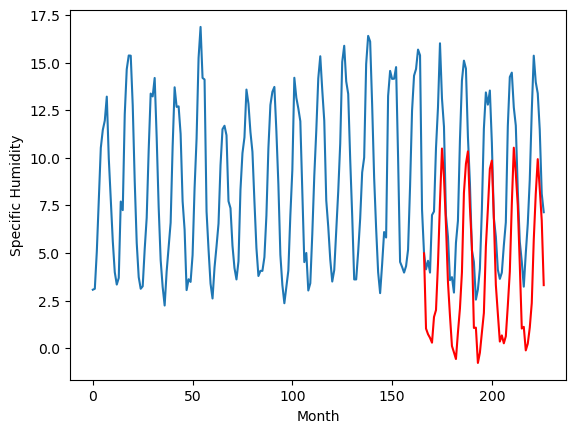

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		-0.22		-1.57
0.70		-0.51		-1.21
0.55		-0.71		-1.26
0.56		-0.96		-1.52
2.45		0.38		-2.07
2.61		0.74		-1.87
5.43		3.18		-2.25
7.14		6.41		-0.73
10.03		9.23		-0.80
8.71		7.72		-0.99
5.92		5.20		-0.72
2.40		2.21		-0.19
2.08		0.45		-1.63
0.22		-1.14		-1.36
0.41		-1.48		-1.89
-0.33		-1.83		-1.50
1.49		-0.43		-1.92
1.66		0.82		-0.84
6.81		2.72		-4.09
9.80		6.90		-2.90
11.04		8.42		-2.62
10.01		9.08		-0.93
7.05		6.16		-0.89
3.61		4.08		0.47
1.25		-0.19		-1.44
0.27		-0.18		-0.45
-0.37		-2.03		-1.66
-0.45		-1.49		-1.04
0.51		-0.44		-0.95
1.48		0.60		-0.88
4.04		4.09		0.05
8.22		6.05		-2.17
8.87		8.17		-0.70
9.28		8.60		-0.68
7.28		5.60		-1.68
3.89		2.07		-1.82
1.91		0.56		-1.35
0.70		-0.90		-1.60
0.39		-0.58		-0.97
0.25		-1.00		-1.25
1.04		-0.63		-1.67
1.56		0.99		-0.57
7.29		2.77		-4.52
8.90		6.32		-2.58
10.83		9.27		-1.56
8.92		7.92		-1.00
7.27		6.24		-1.03
4.16		3.14		-1.02
1.84		-0.22		-2.06

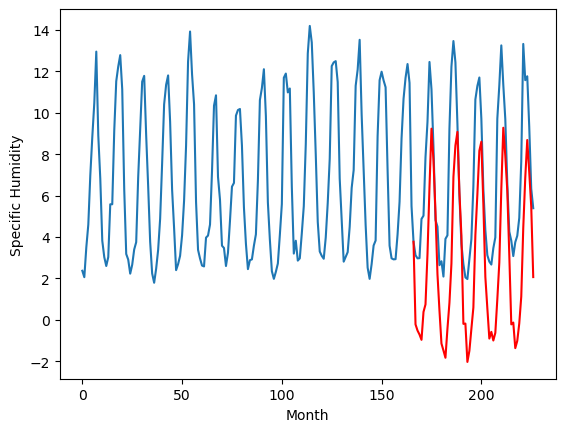

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-0.92		0.90
-1.83		-1.22		0.61
-1.98		-1.41		0.57
-1.91		-1.67		0.24
-0.96		-0.32		0.64
-0.67		0.05		0.72
1.90		2.48		0.58
5.54		5.71		0.17
9.18		8.54		-0.64
9.09		7.02		-2.07
5.61		4.51		-1.10
2.69		1.51		-1.18
0.31		-0.24		-0.55
-1.85		-1.84		0.01
-2.58		-2.17		0.41
-2.54		-2.52		0.02
-1.30		-1.12		0.18
0.07		0.13		0.06
1.60		2.03		0.43
6.92		6.20		-0.72
8.78		7.72		-1.06
9.12		8.38		-0.74
5.93		5.47		-0.46
4.07		3.38		-0.69
-1.12		-0.89		0.23
-1.24		-0.88		0.36
-2.85		-2.73		0.12
-2.11		-2.19		-0.08
-1.09		-1.13		-0.04
-0.43		-0.10		0.33
3.70		3.39		-0.31
5.29		5.35		0.06
8.92		7.47		-1.45
8.49		7.90		-0.59
5.24		4.91		-0.33
1.80		1.37		-0.43
0.30		-0.14		-0.44
-1.83		-1.60		0.23
-0.97		-1.27		-0.30
-1.77		-1.69		0.08
-1.74		-1.33		0.41
0.87		0.29		-0.58
1.17		2.07		0.90
4.46		5.62		1.16
9.17		8.59		-0.58
6.88		7.22		0.34
5.62		5.54		-0.08
2.57		2.44		-0.13
-1.09		-0.92		0.17
-0.85

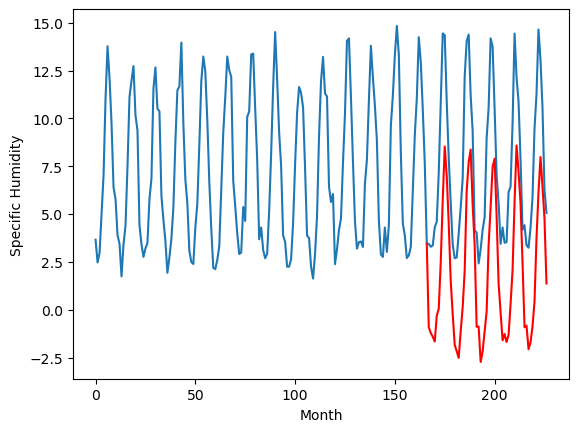

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88  -0.930428
1                 1    1.11   3.131534
2                 2   -0.05   1.622075
3                 3    1.89   2.477685
4                 4    2.44   3.369194
5                 5    4.76   3.041598
6                 6   -2.55  -0.772094
7                 7    1.26   1.521179
8                 8    2.02   1.029701
9                 9    1.35  -0.218663
10               10   -1.82  -0.919061


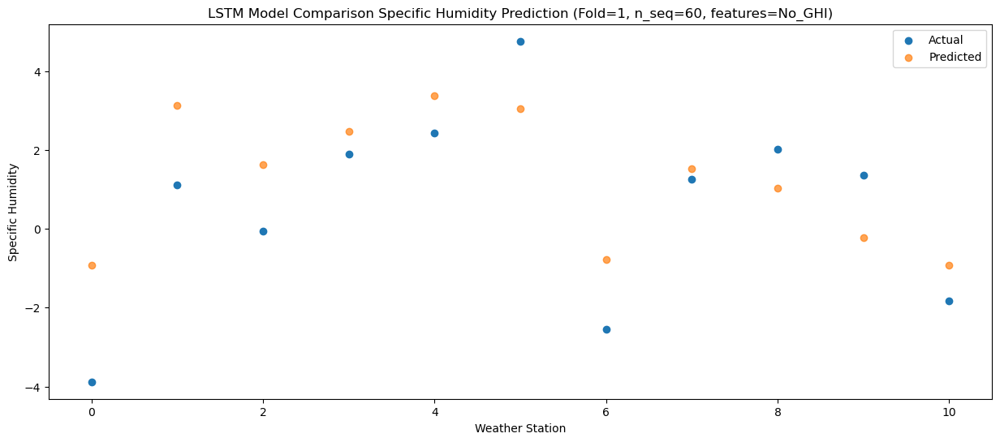

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28  -1.227695
1                 1    1.16   2.833589
2                 2    0.86   1.325868
3                 3    0.69   2.182272
4                 4    1.20   3.074365
5                 5    3.28   2.748361
6                 6   -2.52  -1.067274
7                 7    0.93   1.226863
8                 8    1.18   0.735293
9                 9    0.70  -0.514481
10               10   -1.83  -1.220543


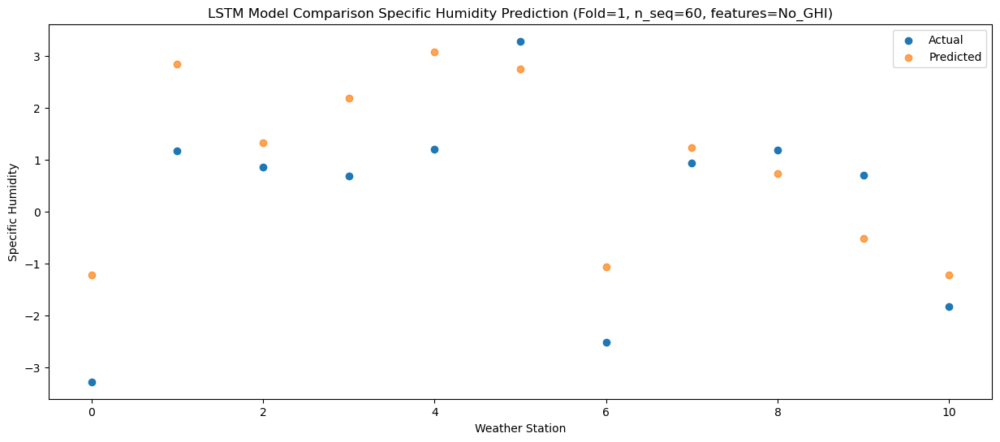

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -1.417411
1                 1    0.91   2.644706
2                 2    0.35   1.137613
3                 3    1.59   1.993218
4                 4    2.11   2.883744
5                 5    3.00   2.556393
6                 6   -2.94  -1.258336
7                 7    0.85   1.036610
8                 8    1.63   0.543336
9                 9    0.55  -0.708345
10               10   -1.98  -1.413827


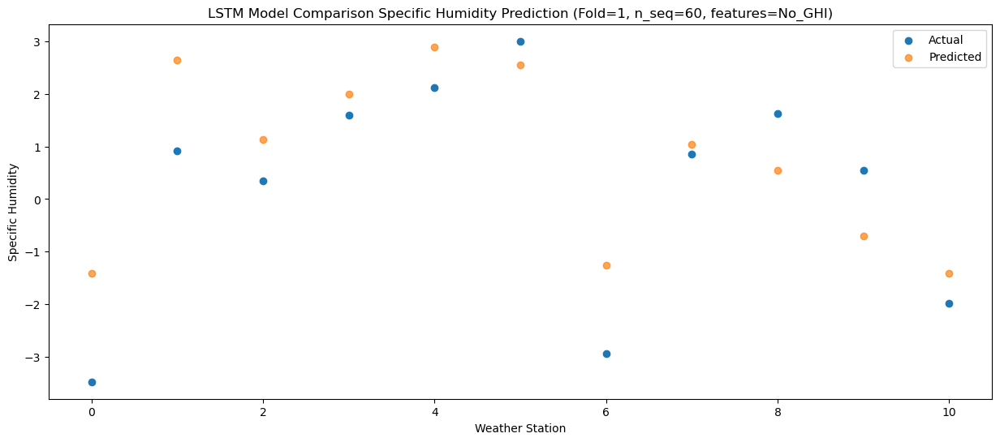

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -1.667056
1                 1    1.43   2.394196
2                 2    0.74   0.886035
3                 3    0.89   1.738278
4                 4    1.43   2.628219
5                 5    3.18   2.301121
6                 6   -2.46  -1.510389
7                 7    0.73   0.784569
8                 8    1.01   0.289175
9                 9    0.56  -0.964421
10               10   -1.91  -1.666096


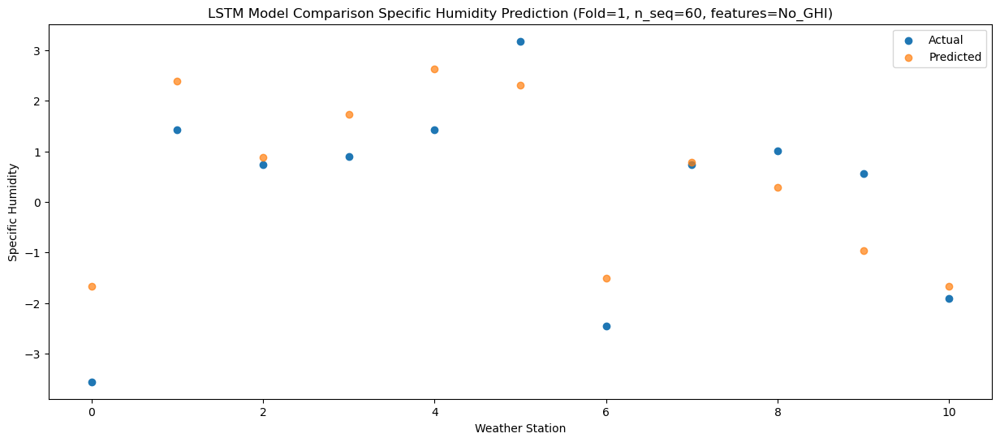

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26  -0.315711
1                 1    3.66   3.745594
2                 2    3.90   2.237407
3                 3    5.25   3.088056
4                 4    6.16   3.977390
5                 5    5.85   3.651003
6                 6   -0.49  -0.160405
7                 7    3.39   2.132133
8                 8    4.03   1.636629
9                 9    2.45   0.382265
10               10   -0.96  -0.316701


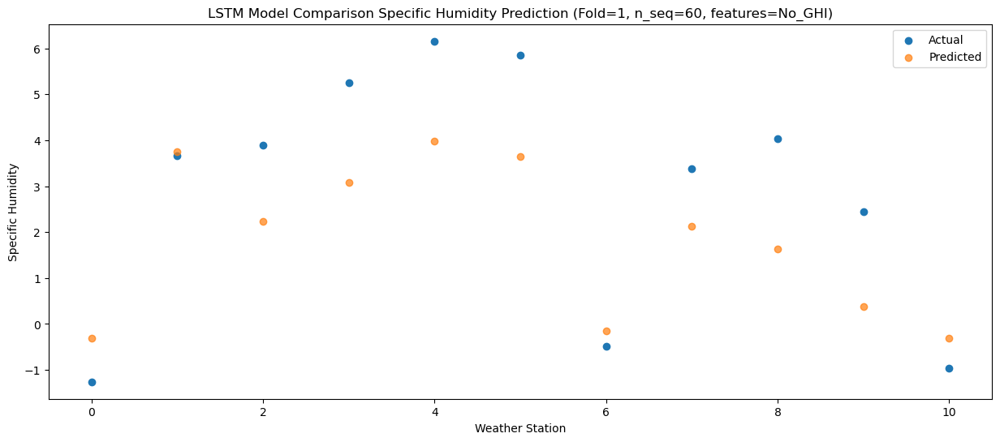

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52   0.053490
1                 1    2.07   4.114690
2                 2    2.28   2.605439
3                 3    4.91   3.451754
4                 4    5.85   4.339136
5                 5    4.84   4.011884
6                 6   -1.14   0.202143
7                 7    3.65   2.496524
8                 8    4.22   2.000591
9                 9    2.61   0.744938
10               10   -0.67   0.047928


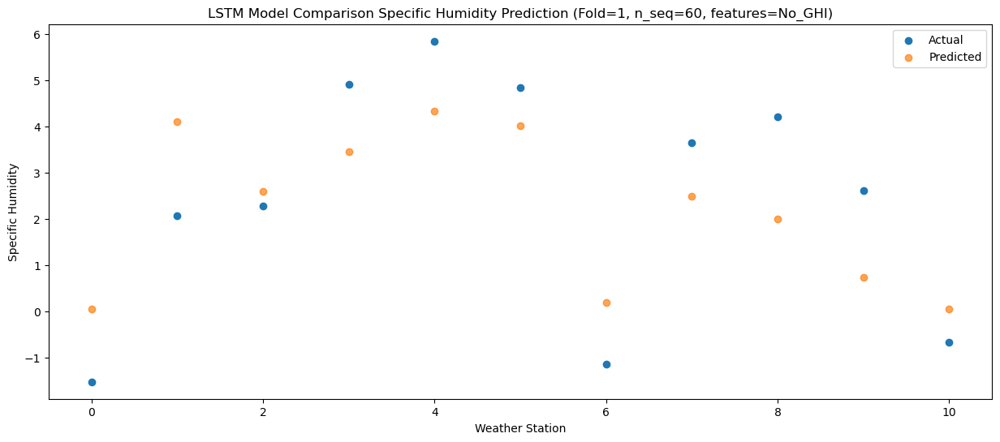

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38   2.489301
1                 1    5.08   6.549510
2                 2    5.05   5.040066
3                 3    6.89   5.886659
4                 4    7.97   6.773960
5                 5    7.52   6.446762
6                 6    2.06   2.634732
7                 7    6.55   4.931955
8                 8    7.55   4.436310
9                 9    5.43   3.181350
10               10    1.90   2.483762


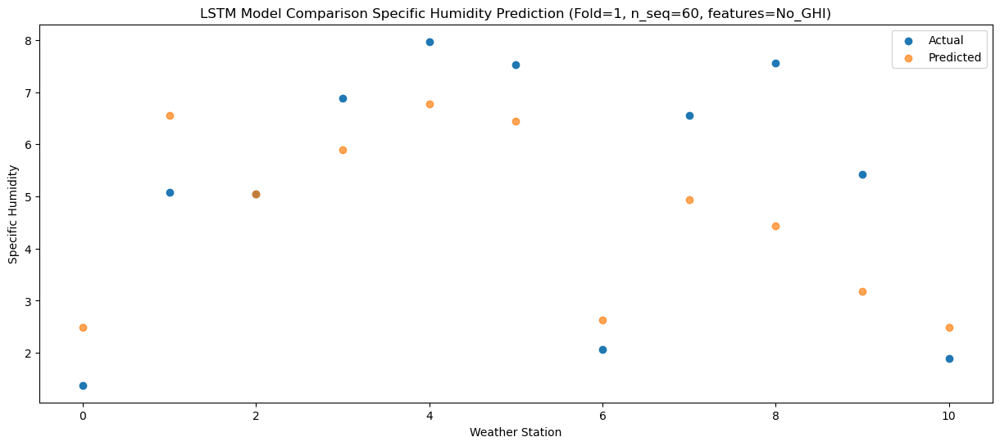

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.718718
1                 1    8.88   9.779985
2                 2    8.90   8.269627
3                 3    9.01   9.113532
4                 4   10.26  10.000182
5                 5    9.34   9.669966
6                 6    5.70   5.861330
7                 7   10.38   8.159213
8                 8    9.69   7.663740
9                 9    7.14   6.407962
10               10    5.54   5.714720


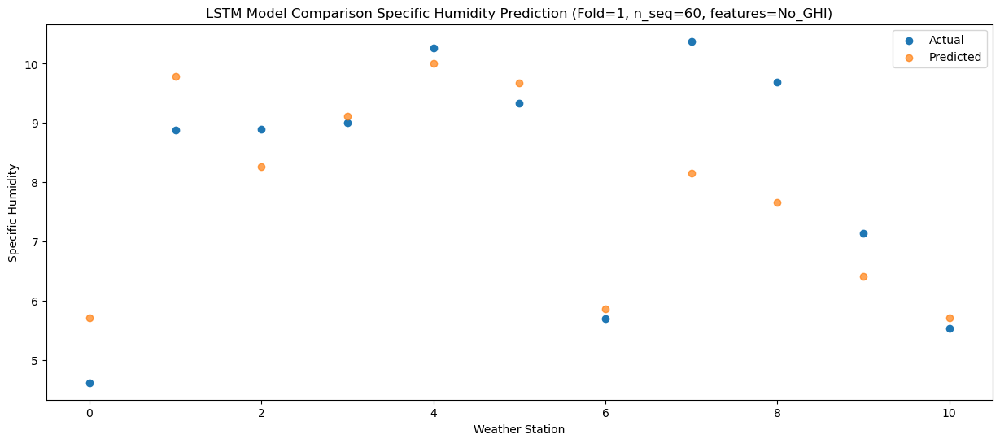

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19   8.534060
1                 1   10.92  12.597277
2                 2   11.45  11.087003
3                 3   11.52  11.931763
4                 4   12.86  12.817700
5                 5   10.33  12.490254
6                 6    8.14   8.680573
7                 7   13.46  10.981846
8                 8   13.05  10.484422
9                 9   10.03   9.230276
10               10    9.18   8.535030


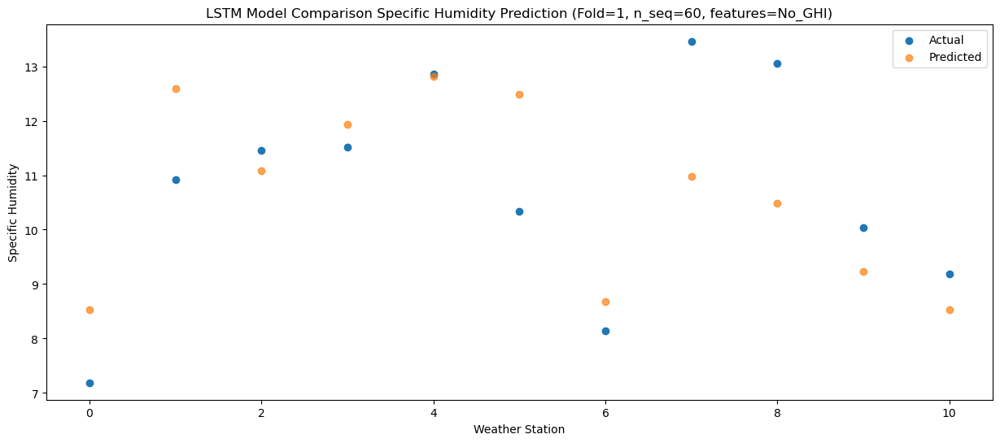

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   7.032743
1                 1   10.97  11.094802
2                 2   10.97   9.584880
3                 3   10.41  10.425136
4                 4   11.41  11.307699
5                 5    9.10  10.978725
6                 6    8.16   7.172982
7                 7   11.29   9.472614
8                 8   10.15   8.973314
9                 9    8.71   7.717937
10               10    9.09   7.023888


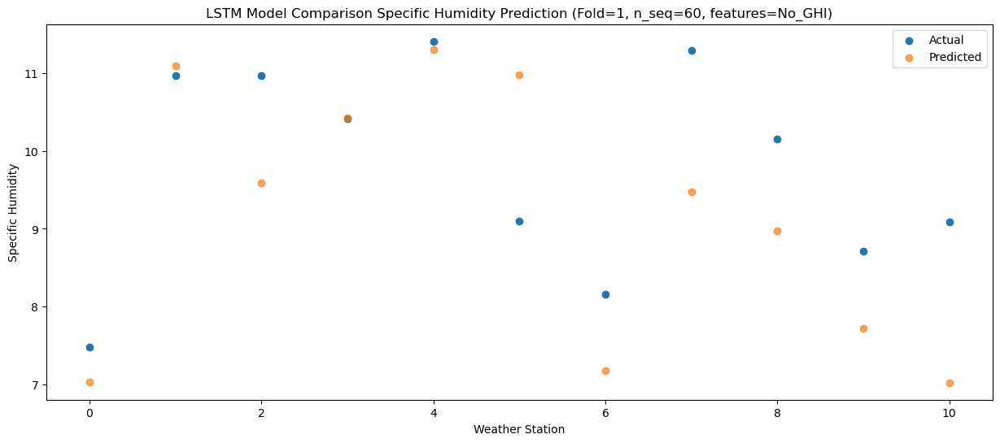

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   4.518395
1                 1    8.07   8.580703
2                 2    8.02   7.069347
3                 3    8.83   7.910178
4                 4    9.92   8.793381
5                 5    8.67   8.466538
6                 6    4.85   4.658627
7                 7    9.49   6.958706
8                 8    8.67   6.459764
9                 9    5.92   5.204709
10               10    5.61   4.508765


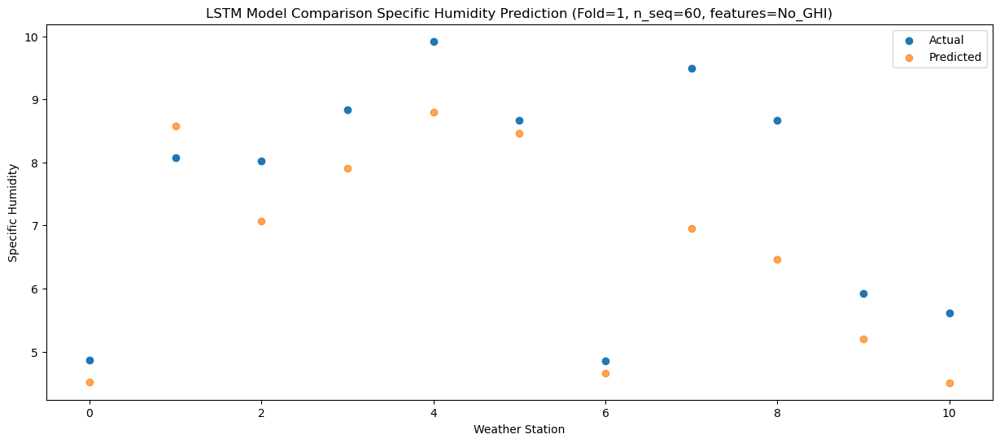

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   1.515232
1                 1    5.40   5.579092
2                 2    5.26   4.069041
3                 3    5.43   4.910548
4                 4    6.07   5.796464
5                 5    5.16   5.469675
6                 6    2.36   1.661379
7                 7    4.67   3.962956
8                 8    4.00   3.463838
9                 9    2.40   2.207879
10               10    2.69   1.511409


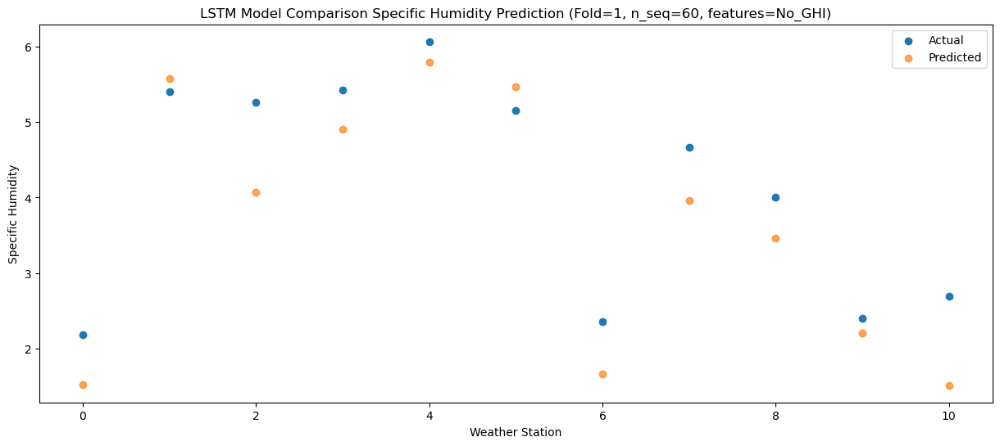

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -0.233323
1                 1    2.34   3.829615
2                 2    2.08   2.319982
3                 3    3.33   3.155391
4                 4    3.59   4.038330
5                 5    4.60   3.709560
6                 6   -0.75  -0.096600
7                 7    2.65   2.208740
8                 8    2.89   1.713149
9                 9    2.08   0.454485
10               10    0.31  -0.241549


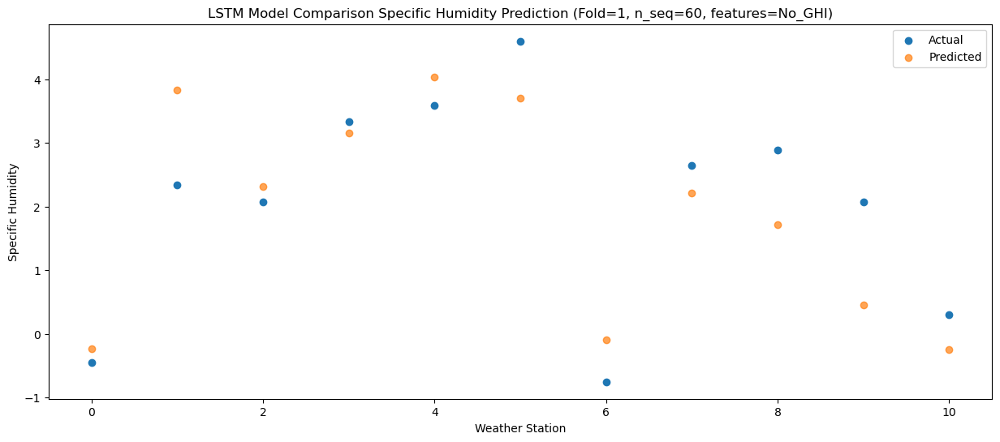

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -1.839982
1                 1   -0.25   2.224060
2                 2   -0.69   0.713641
3                 3    0.78   1.552451
4                 4    0.77   2.437255
5                 5    2.16   2.112200
6                 6   -3.47  -1.694257
7                 7    0.33   0.609160
8                 8    0.61   0.113118
9                 9    0.22  -1.143558
10               10   -1.85  -1.837862


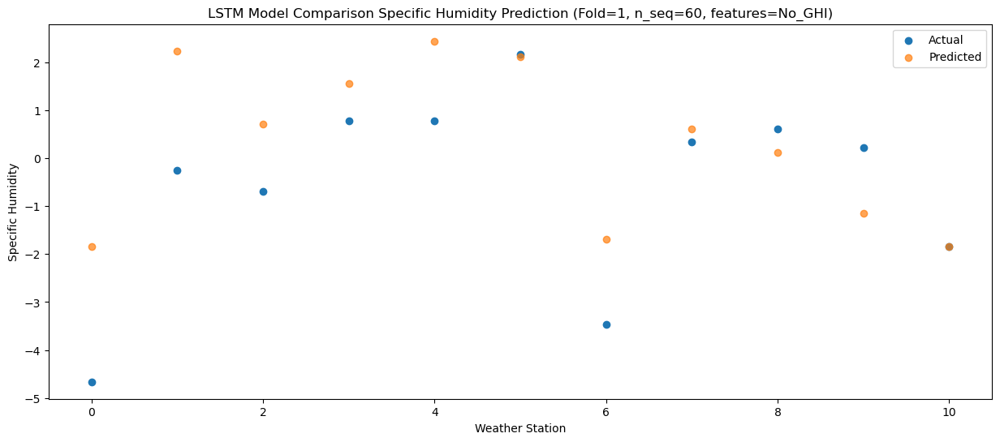

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -2.171535
1                 1   -0.23   1.894061
2                 2   -0.54   0.384323
3                 3    0.44   1.220204
4                 4    0.52   2.103960
5                 5    2.99   1.778404
6                 6   -3.58  -2.025207
7                 7    0.20   0.276188
8                 8    0.77  -0.220029
9                 9    0.41  -1.477422
10               10   -2.58  -2.172599


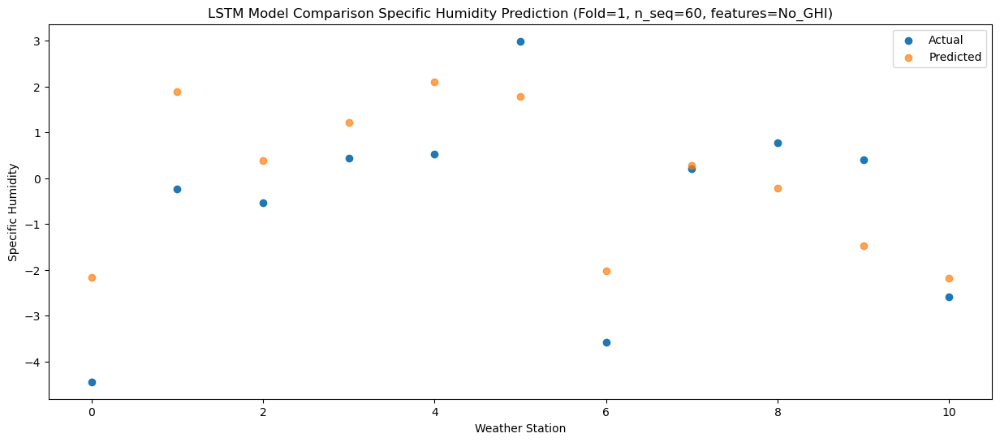

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -2.522406
1                 1   -0.04   1.543277
2                 2   -0.54   0.034670
3                 3    0.51   0.867737
4                 4    0.56   1.750616
5                 5    2.36   1.428003
6                 6   -3.46  -2.373824
7                 7   -0.32  -0.072744
8                 8   -0.04  -0.569828
9                 9   -0.33  -1.828545
10               10   -2.54  -2.519061


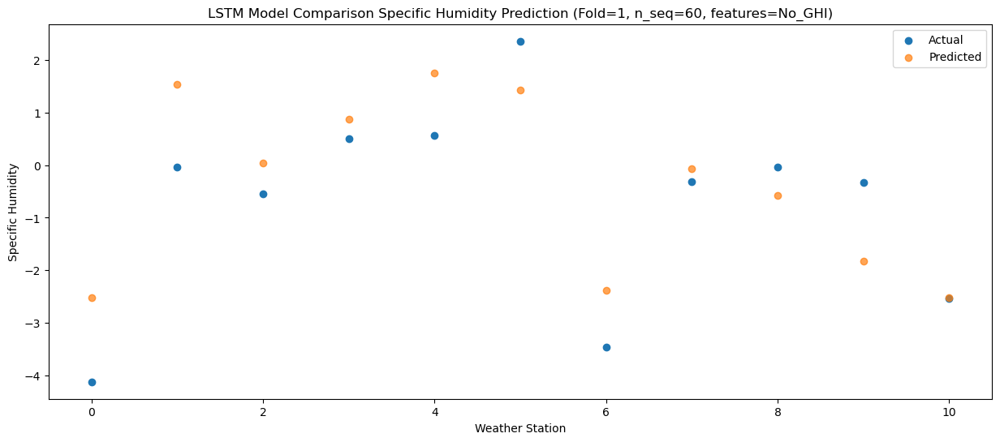

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59  -1.119609
1                 1    1.49   2.944922
2                 2    2.08   1.435499
3                 3    3.15   2.266737
4                 4    3.28   3.149194
5                 5    3.15   2.825126
6                 6   -1.90  -0.976909
7                 7    2.41   1.322841
8                 8    2.57   0.826709
9                 9    1.49  -0.431934
10               10   -1.30  -1.123775


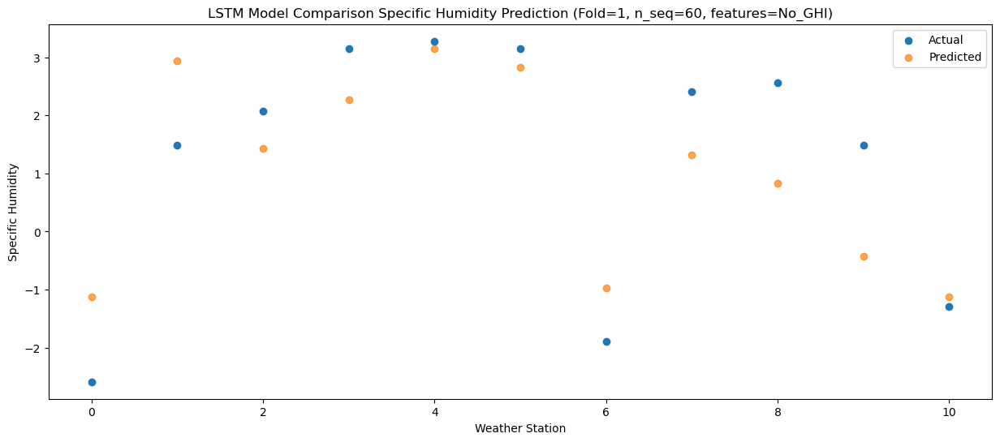

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39   0.138332
1                 1    1.85   4.202601
2                 2    1.79   2.693536
3                 3    4.49   3.525698
4                 4    4.54   4.409034
5                 5    4.45   4.084712
6                 6   -1.28   0.283470
7                 7    3.64   2.579690
8                 8    3.73   2.082438
9                 9    1.66   0.821194
10               10    0.07   0.133852


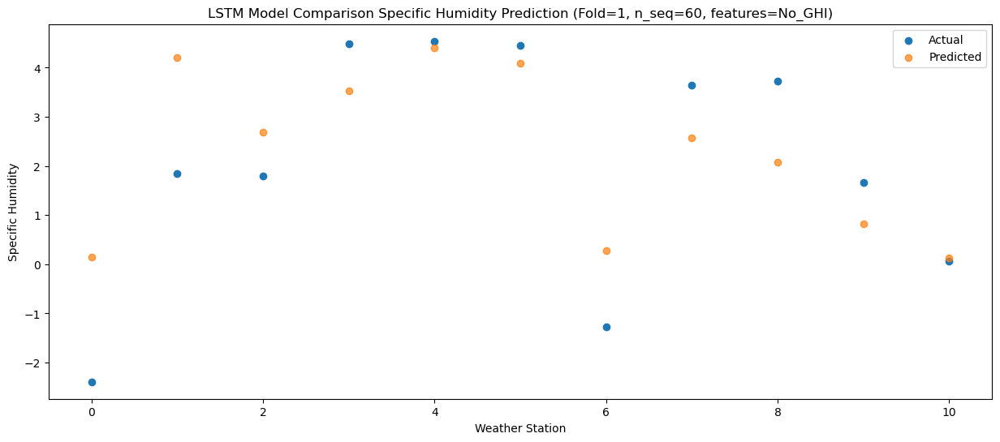

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29   2.040108
1                 1    4.77   6.103411
2                 2    4.63   4.593336
3                 3    8.38   5.425812
4                 4    8.57   6.309998
5                 5    8.76   5.986607
6                 6    1.65   2.183516
7                 7    6.85   4.478515
8                 8    7.95   3.980797
9                 9    6.81   2.719237
10               10    1.60   2.029114


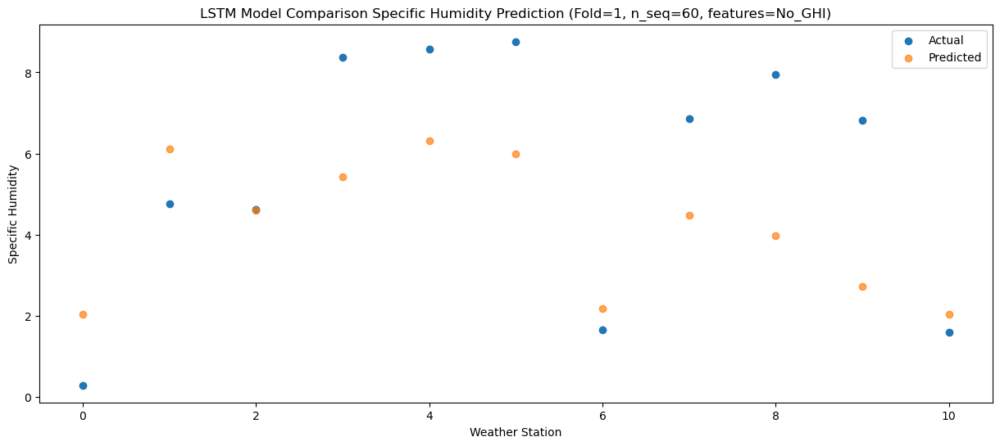

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45   6.213082
1                 1    8.75  10.272916
2                 2    9.15   8.761134
3                 3   11.57   9.594996
4                 4   11.98  10.481336
5                 5   10.93  10.162008
6                 6    6.00   6.354186
7                 7   11.61   8.649949
8                 8   11.09   8.155463
9                 9    9.80   6.895819
10               10    6.92   6.202411


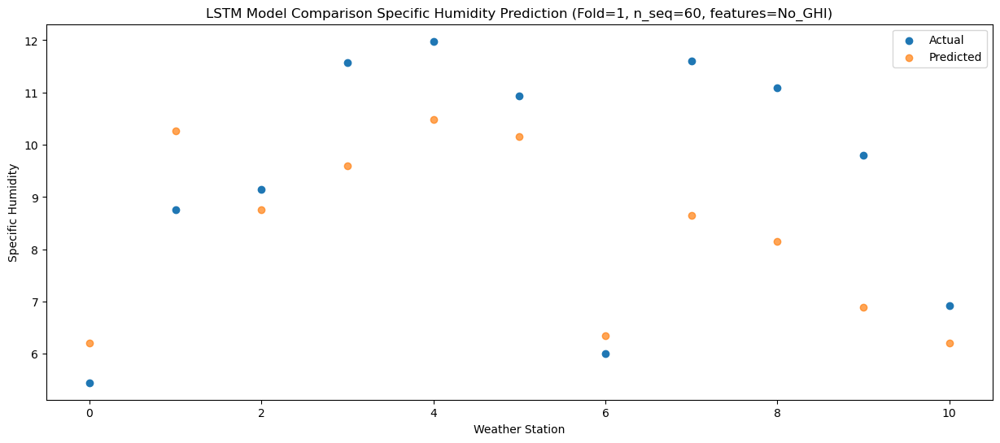

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   7.736785
1                 1   10.62  11.795736
2                 2   10.74  10.285329
3                 3   12.05  11.117065
4                 4   12.16  12.004153
5                 5   12.26  11.687497
6                 6    8.50   7.878727
7                 7   12.24  10.176502
8                 8   12.14   9.679619
9                 9   11.04   8.423231
10               10    8.78   7.724201


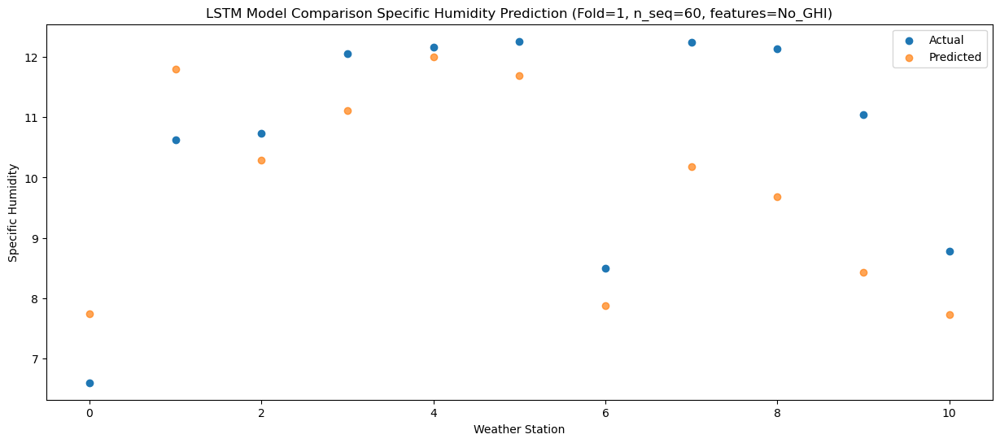

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   8.387100
1                 1   10.83  12.447396
2                 2   10.96  10.937978
3                 3   12.39  11.768319
4                 4   12.20  12.655351
5                 5   12.48  12.338417
6                 6    8.79   8.531594
7                 7   12.09  10.831932
8                 8   11.72  10.333553
9                 9   10.01   9.075334
10               10    9.12   8.375711


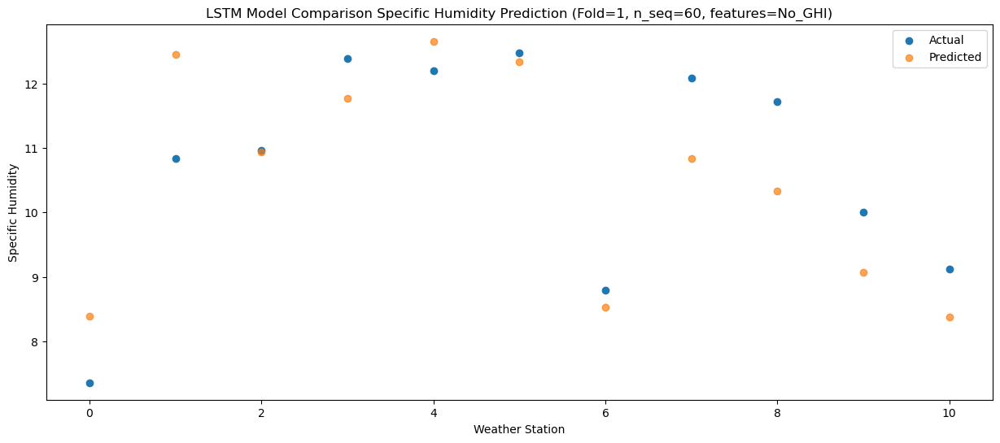

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   5.478325
1                 1    7.88   9.536371
2                 2    8.20   8.024772
3                 3    9.30   8.856522
4                 4    9.10   9.744150
5                 5    8.94   9.427332
6                 6    5.44   5.619354
7                 7    8.84   7.916918
8                 8    8.15   7.419988
9                 9    7.05   6.163488
10               10    5.93   5.465435


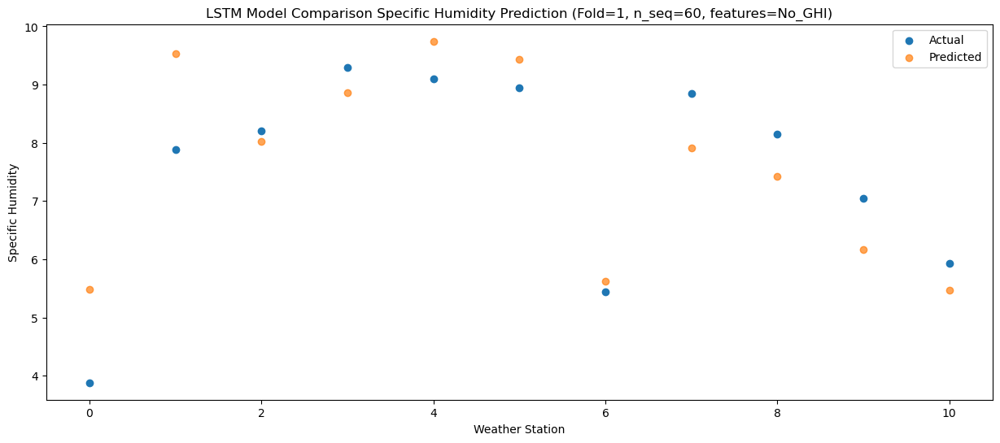

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   3.395951
1                 1    5.84   7.453122
2                 2    5.45   5.939901
3                 3    7.05   6.771288
4                 4    7.15   7.657849
5                 5    5.83   7.344028
6                 6    3.31   3.535868
7                 7    6.11   5.831305
8                 8    5.71   5.334895
9                 9    3.61   4.077391
10               10    4.07   3.383645


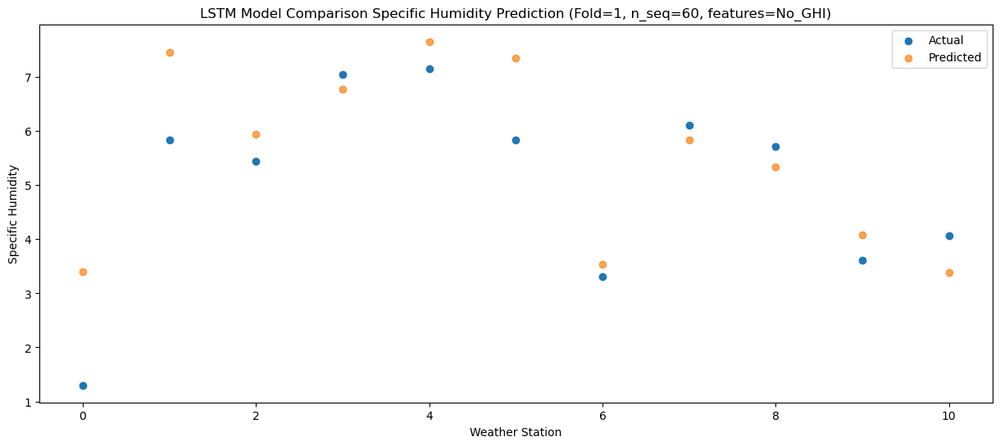

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36  -0.885069
1                 1    0.25   3.172639
2                 2   -0.05   1.660156
3                 3    2.60   2.494890
4                 4    2.56   3.382914
5                 5    3.99   3.072971
6                 6   -2.62  -0.739846
7                 7    1.55   1.556827
8                 8    2.18   1.061954
9                 9    1.25  -0.193805
10               10   -1.12  -0.894287


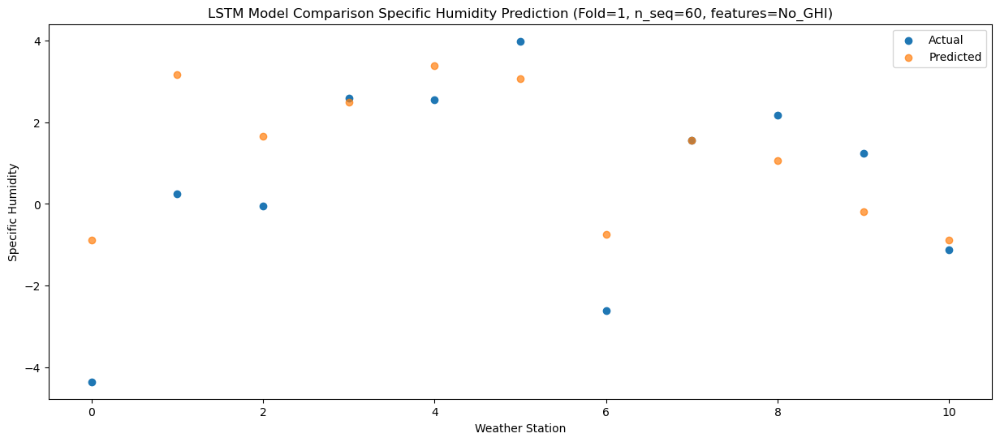

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25  -0.877385
1                 1    2.42   3.182723
2                 2    2.59   1.674442
3                 3    5.52   2.509296
4                 4    5.49   3.398275
5                 5    2.94   3.089040
6                 6   -0.75  -0.725181
7                 7    3.19   1.573263
8                 8    1.57   1.079409
9                 9    0.27  -0.178244
10               10   -1.24  -0.881648


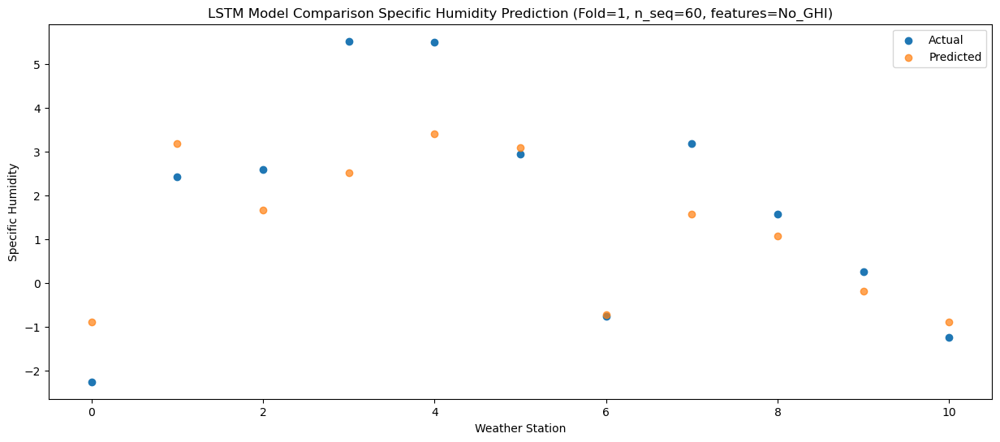

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50  -2.735429
1                 1   -0.58   1.325100
2                 2   -1.29  -0.184494
3                 3   -0.13   0.651005
4                 4   -0.05   1.541257
5                 5    1.67   1.234469
6                 6   -3.75  -2.577813
7                 7   -0.56  -0.280190
8                 8   -0.41  -0.774245
9                 9   -0.37  -2.030468
10               10   -2.85  -2.731215


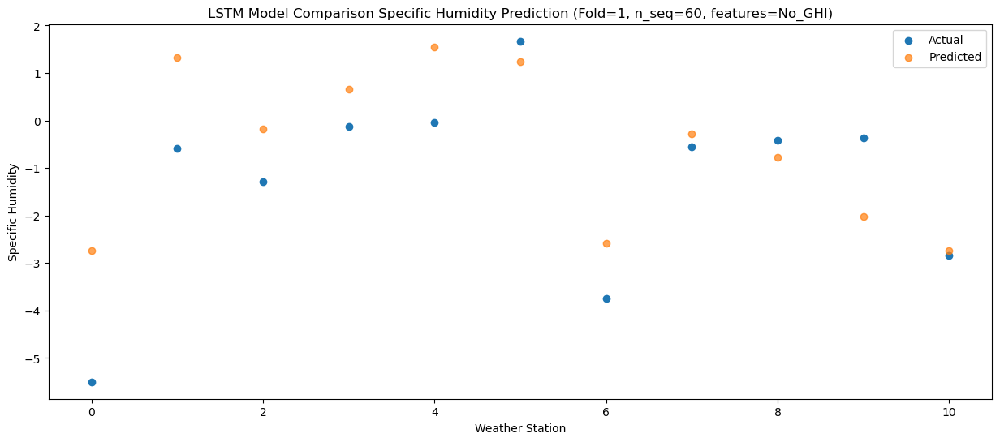

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -2.193915
1                 1    0.37   1.866799
2                 2   -0.26   0.356588
3                 3    0.04   1.189277
4                 4    0.15   2.077554
5                 5    1.55   1.770975
6                 6   -2.62  -2.039507
7                 7    0.12   0.256024
8                 8    0.12  -0.238401
9                 9   -0.45  -1.494507
10               10   -2.11  -2.190652


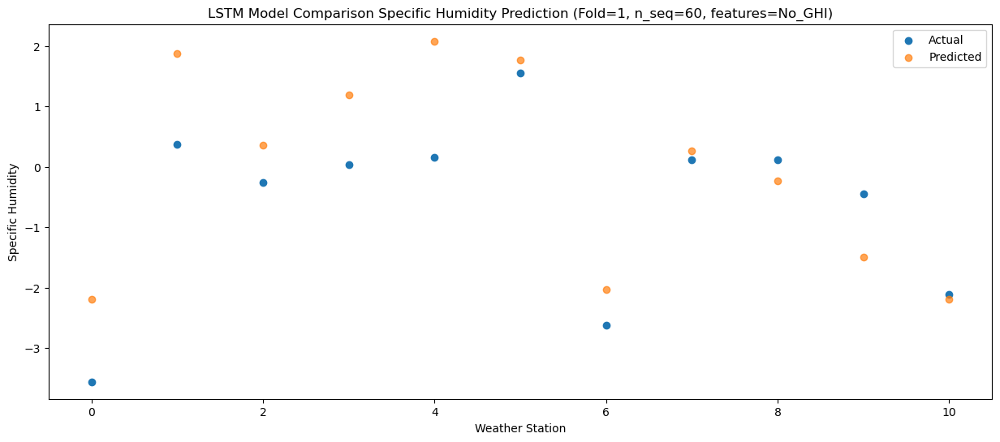

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45  -1.136498
1                 1    1.05   2.922923
2                 2    0.53   1.411373
3                 3    1.72   2.244310
4                 4    1.85   3.132150
5                 5    2.10   2.826380
6                 6   -1.87  -0.985075
7                 7    1.65   1.312861
8                 8    1.21   0.817647
9                 9    0.51  -0.435483
10               10   -1.09  -1.133158


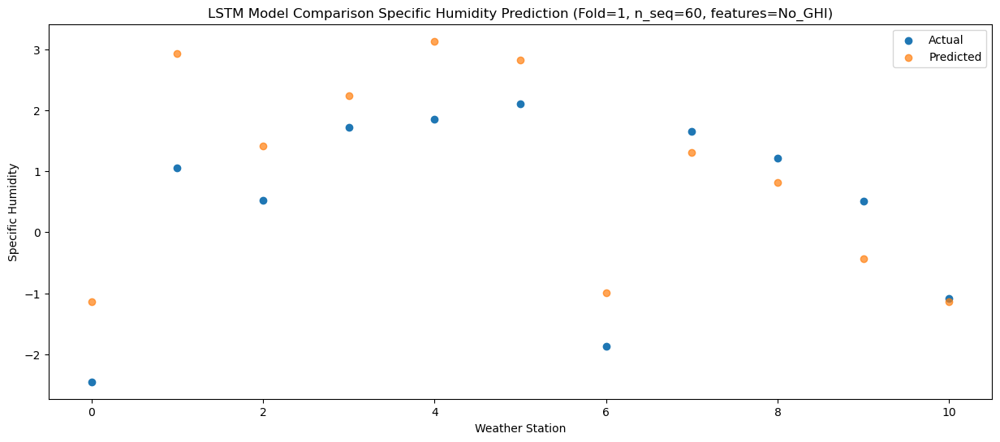

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -0.109010
1                 1    2.11   3.950781
2                 2    2.29   2.440912
3                 3    5.88   3.275430
4                 4    5.95   4.165035
5                 5    4.37   3.859049
6                 6   -0.68   0.045758
7                 7    3.84   2.342315
8                 8    4.33   1.848955
9                 9    1.48   0.596577
10               10   -0.43  -0.104434


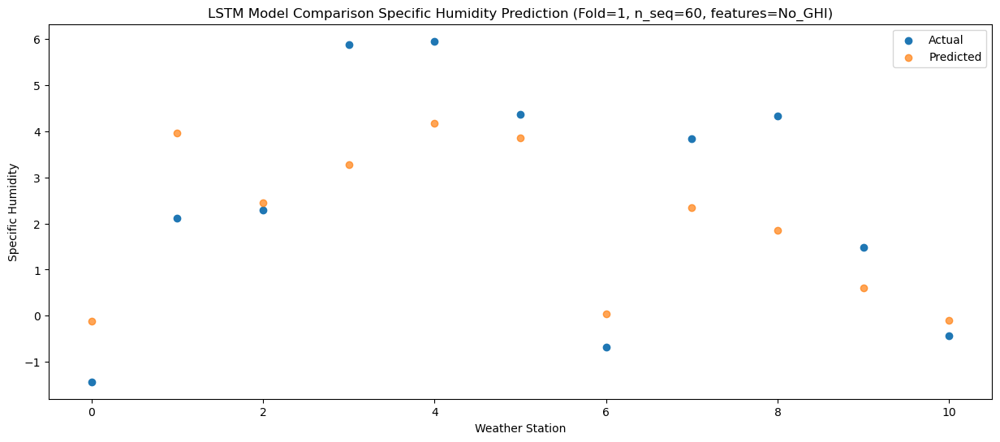

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   3.378556
1                 1    6.28   7.439570
2                 2    6.65   5.930845
3                 3    9.69   6.762911
4                 4    9.83   7.653405
5                 5    6.14   7.348019
6                 6    3.58   3.537755
7                 7    8.29   5.834303
8                 8    8.57   5.340134
9                 9    4.04   4.087842
10               10    3.70   3.385909


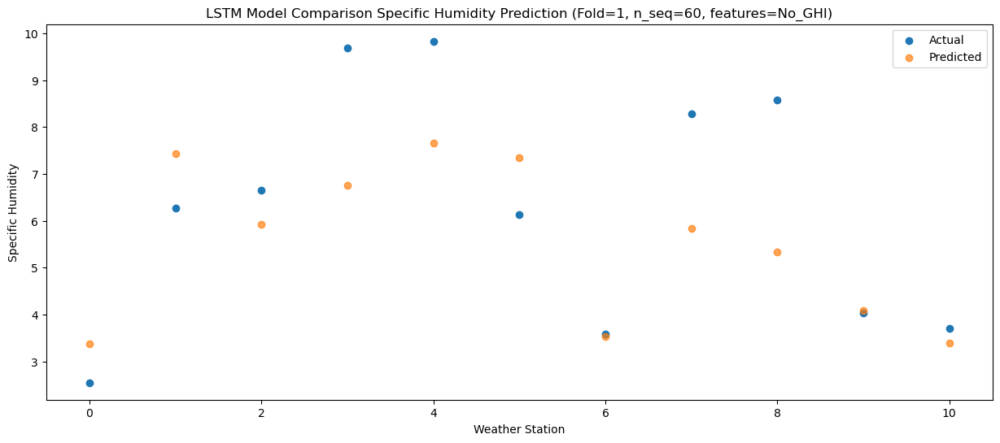

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85   5.350798
1                 1    8.68   9.411470
2                 2    9.74   7.901969
3                 3   10.74   8.731347
4                 4   10.95   9.621983
5                 5    8.74   9.316121
6                 6    6.30   5.508234
7                 7   11.05   7.802551
8                 8   10.47   7.305373
9                 9    8.22   6.053088
10               10    5.29   5.353157


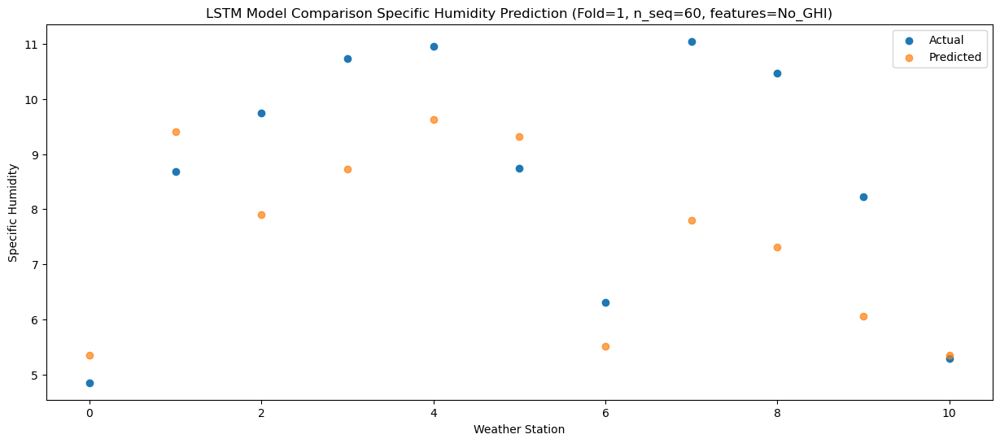

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47   7.462706
1                 1   11.35  11.524565
2                 2   11.37  10.016130
3                 3   11.66  10.844781
4                 4   11.70  11.735418
5                 5    9.69  11.428835
6                 6    9.29   7.621764
7                 7   12.02   9.916798
8                 8    9.83   9.418161
9                 9    8.87   8.166092
10               10    8.92   7.468537


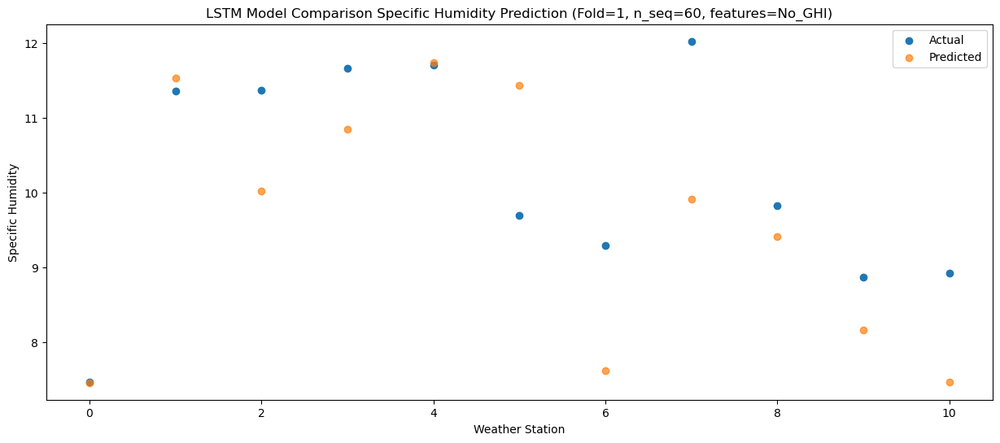

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47   7.890105
1                 1   10.94  11.953369
2                 2   10.50  10.445129
3                 3   11.91  11.273654
4                 4   12.08  12.164374
5                 5   11.80  11.859024
6                 6    8.20   8.052502
7                 7   11.93  10.349748
8                 8   10.57   9.851551
9                 9    9.28   8.599994
10               10    8.49   7.900608


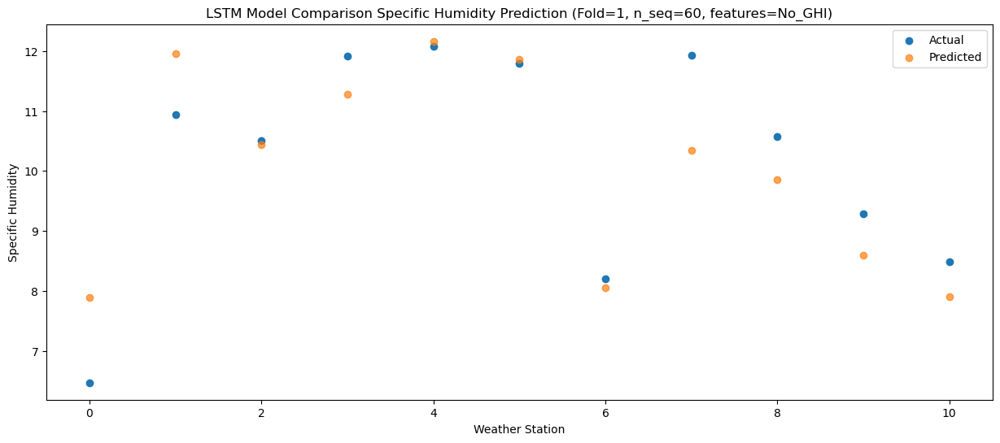

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   4.900050
1                 1    7.58   8.963941
2                 2    6.99   7.454384
3                 3    8.62   8.280511
4                 4    8.73   9.167988
5                 5   10.53   8.863676
6                 6    4.72   5.059470
7                 7    7.97   7.354815
8                 8    7.83   6.856184
9                 9    7.28   5.604719
10               10    5.24   4.909026


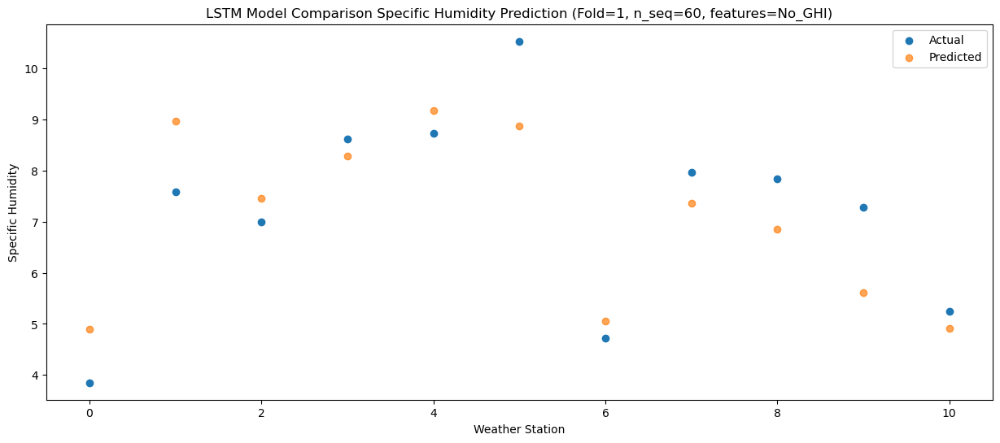

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01   1.359899
1                 1    2.69   5.424773
2                 2    1.88   3.915427
3                 3    3.66   4.741622
4                 4    3.83   5.628433
5                 5    7.34   5.325589
6                 6   -0.34   1.521285
7                 7    3.43   3.816908
8                 8    3.88   3.319030
9                 9    3.89   2.069350
10               10    1.80   1.370635


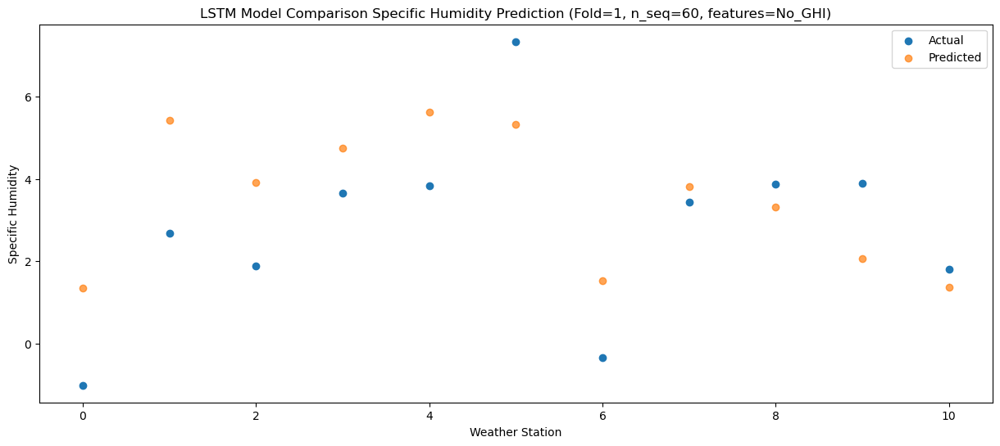

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54  -0.153750
1                 1    2.21   3.911717
2                 2    1.51   2.404227
3                 3    3.16   3.229459
4                 4    3.45   4.117051
5                 5    4.47   3.812718
6                 6   -0.83   0.011321
7                 7    2.18   2.307097
8                 8    2.90   1.810657
9                 9    1.91   0.559413
10               10    0.30  -0.142394


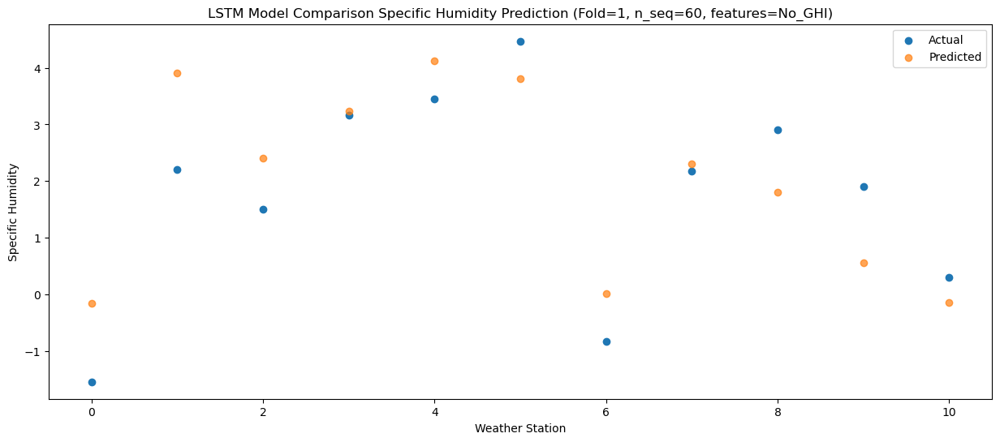

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26  -1.617436
1                 1    0.62   2.448070
2                 2    0.82   0.940274
3                 3    2.35   1.767007
4                 4    2.63   2.656467
5                 5    3.80   2.353621
6                 6   -2.73  -1.450551
7                 7    1.27   0.843502
8                 8    1.16   0.346328
9                 9    0.70  -0.903227
10               10   -1.83  -1.601448


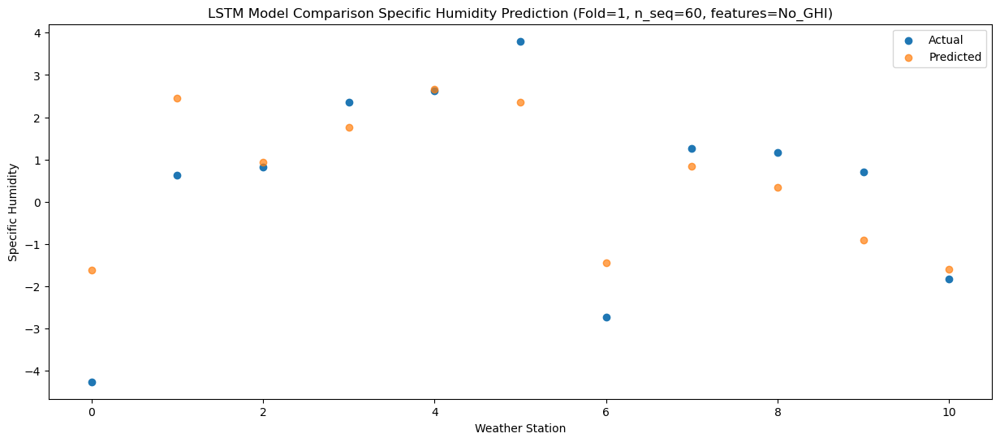

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80  -1.293204
1                 1    1.03   2.773244
2                 2    0.79   1.266839
3                 3    1.93   2.093563
4                 4    2.15   2.982444
5                 5    2.25   2.678107
6                 6   -2.37  -1.124045
7                 7    1.39   1.170188
8                 8    0.68   0.671432
9                 9    0.39  -0.578583
10               10   -0.97  -1.271668


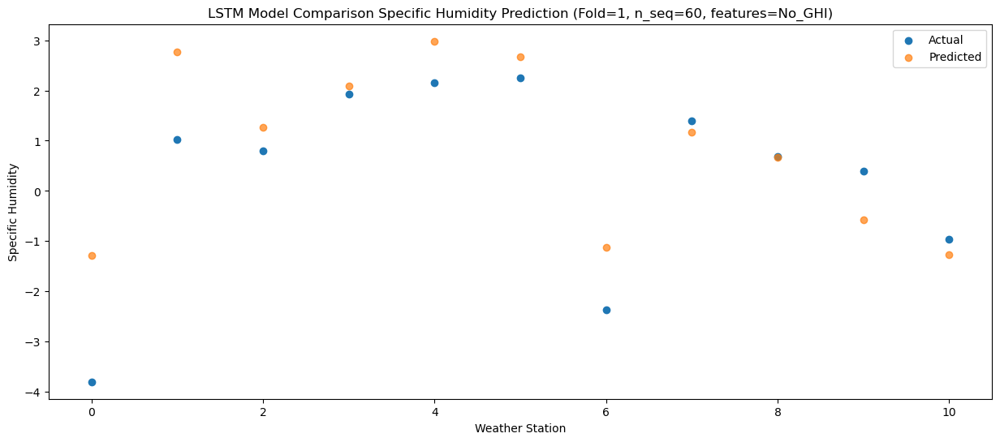

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19  -1.702636
1                 1    2.15   2.364473
2                 2    1.84   0.858822
3                 3    2.71   1.682912
4                 4    2.75   2.571340
5                 5    2.28   2.265366
6                 6   -1.17  -1.534295
7                 7    1.49   0.758102
8                 8    1.01   0.255861
9                 9    0.25  -0.996788
10               10   -1.77  -1.690738


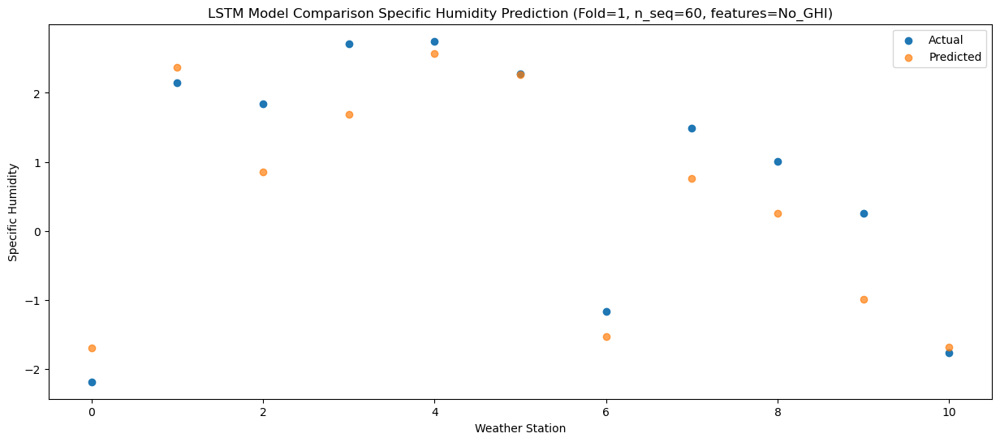

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57  -1.337398
1                 1    1.28   2.730848
2                 2    1.37   1.225811
3                 3    4.26   2.051230
4                 4    4.45   2.939880
5                 5    3.33   2.636872
6                 6   -1.93  -1.165709
7                 7    2.25   1.127569
8                 8    2.43   0.625656
9                 9    1.04  -0.626305
10               10   -1.74  -1.325532


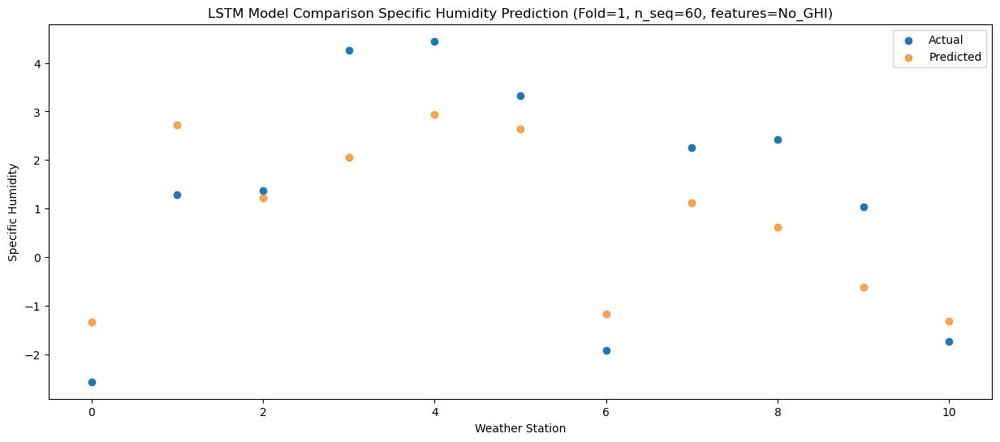

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87   0.284987
1                 1    2.88   4.352168
2                 2    2.73   2.846396
3                 3    4.63   3.668657
4                 4    4.90   4.554330
5                 5    3.59   4.250228
6                 6   -0.12   0.450793
7                 7    3.45   2.744391
8                 8    3.65   2.242030
9                 9    1.56   0.991078
10               10    0.87   0.294911


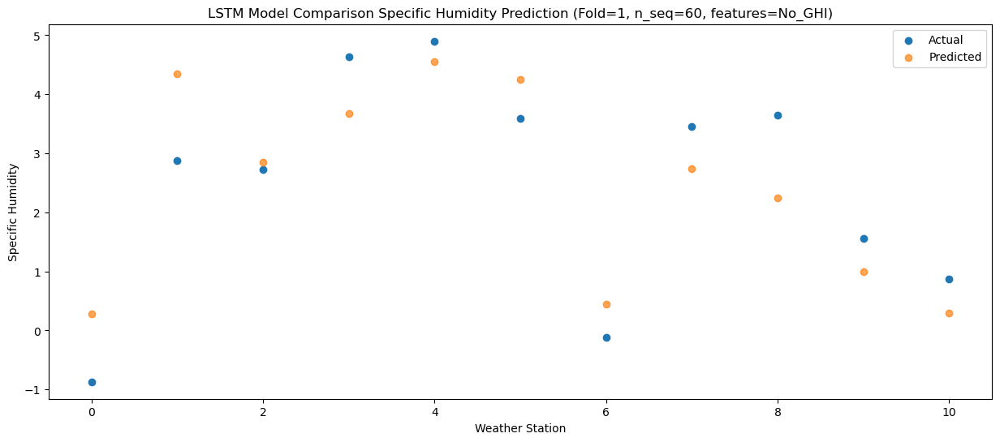

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33   2.057461
1                 1    5.62   6.123574
2                 2    6.03   4.617718
3                 3    8.41   5.438902
4                 4    8.57   6.326315
5                 5    7.96   6.022236
6                 6    2.44   2.221857
7                 7    7.49   4.518322
8                 8    8.70   4.016610
9                 9    7.29   2.767742
10               10    1.17   2.066893


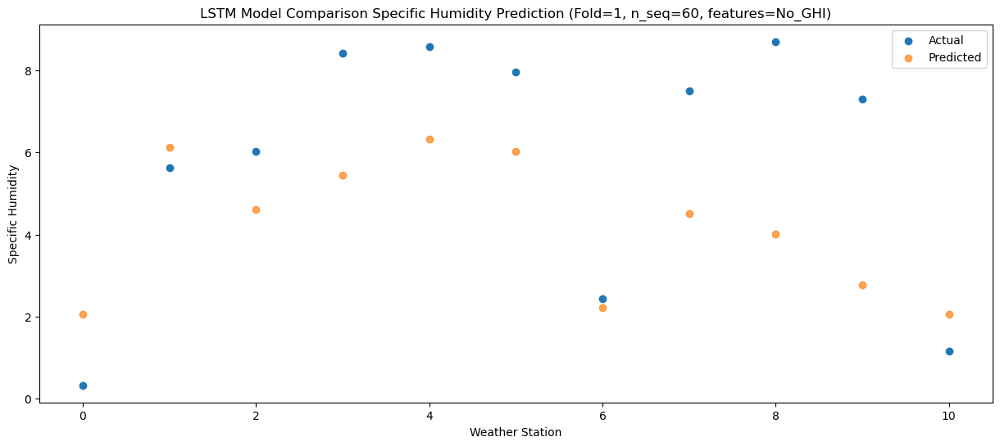

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68   5.605936
1                 1    7.97   9.672984
2                 2    8.68   8.167615
3                 3   11.81   8.990080
4                 4   11.83   9.878356
5                 5    7.91   9.575187
6                 6    5.02   5.775211
7                 7   10.41   8.069657
8                 8   11.28   7.565469
9                 9    8.90   6.315236
10               10    4.46   5.617387


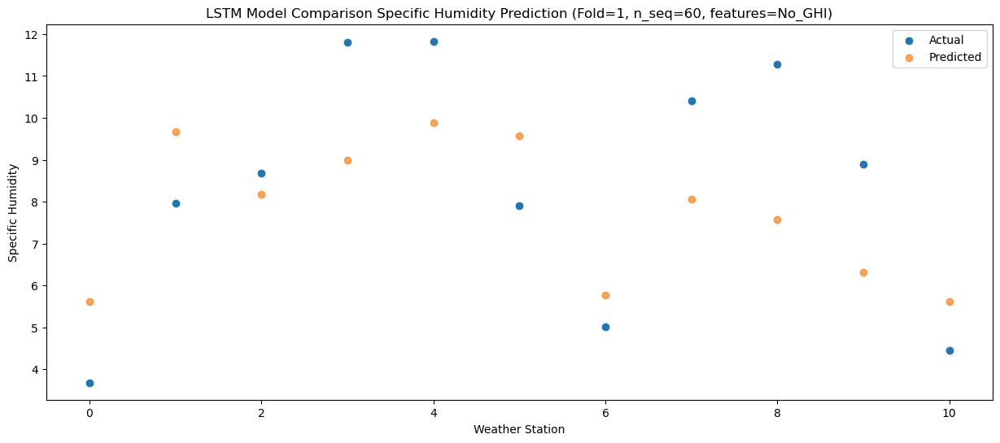

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09   8.580063
1                 1   10.93  12.647596
2                 2   11.82  11.140765
3                 3   12.37  11.958427
4                 4   11.91  12.843926
5                 5   10.08  12.539195
6                 6    8.64   8.743664
7                 7   12.98  11.035503
8                 8   11.51  10.528149
9                 9   10.83   9.274635
10               10    9.17   8.586407


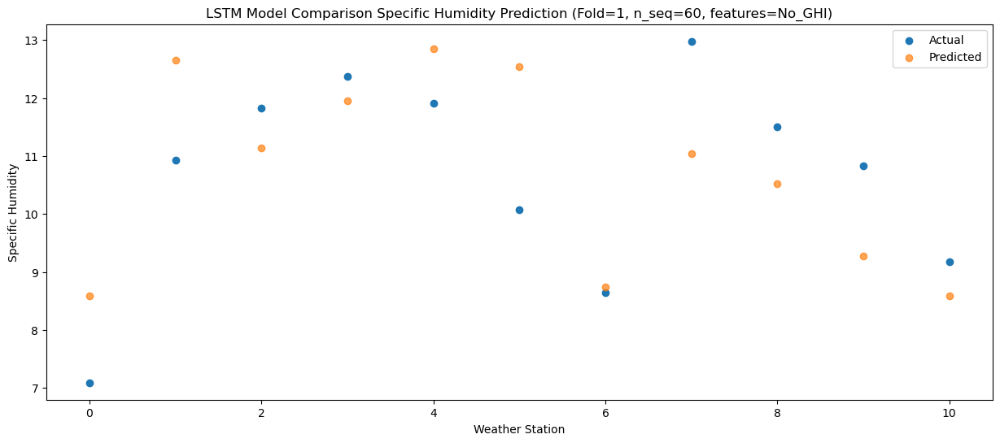

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   7.213708
1                 1   11.06  11.281544
2                 2   11.75   9.774670
3                 3   10.70  10.592370
4                 4   10.51  11.479937
5                 5   10.23  11.179123
6                 6    8.53   7.380515
7                 7   12.56   9.673452
8                 8    9.68   9.168051
9                 9    8.92   7.918112
10               10    6.88   7.224942


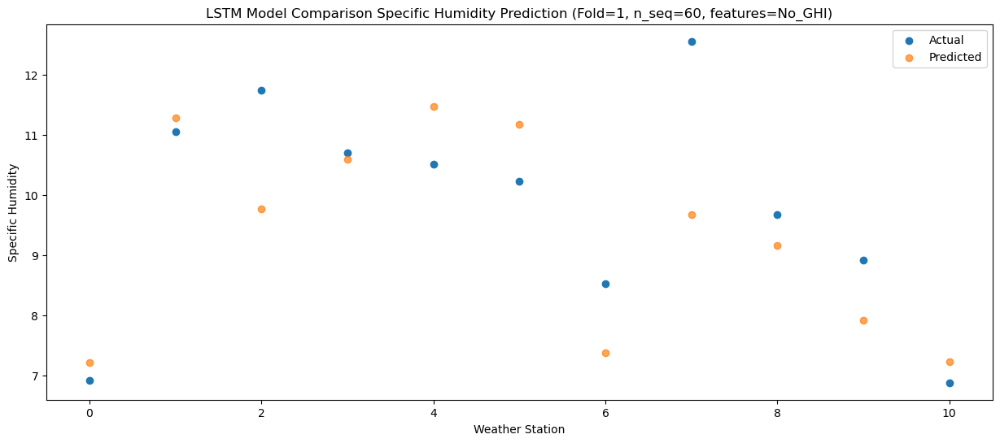

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06   5.531017
1                 1    7.95   9.597968
2                 2    7.94   8.091277
3                 3    9.50   8.909788
4                 4    9.76   9.799322
5                 5    9.87   9.501277
6                 6    5.56   5.700374
7                 7    8.07   7.990716
8                 8    8.73   7.487529
9                 9    7.27   6.236676
10               10    5.62   5.543054


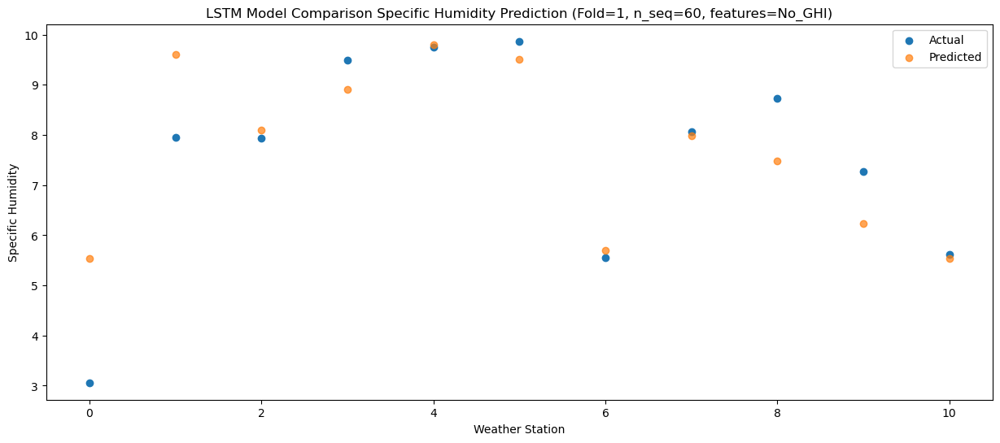

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34   2.429579
1                 1    4.10   6.495062
2                 2    3.43   4.990834
3                 3    6.08   5.807465
4                 4    6.37   6.697316
5                 5    7.89   6.401216
6                 6    1.31   2.597552
7                 7    4.82   4.889626
8                 8    5.30   4.389039
9                 9    4.16   3.138979
10               10    2.57   2.440017


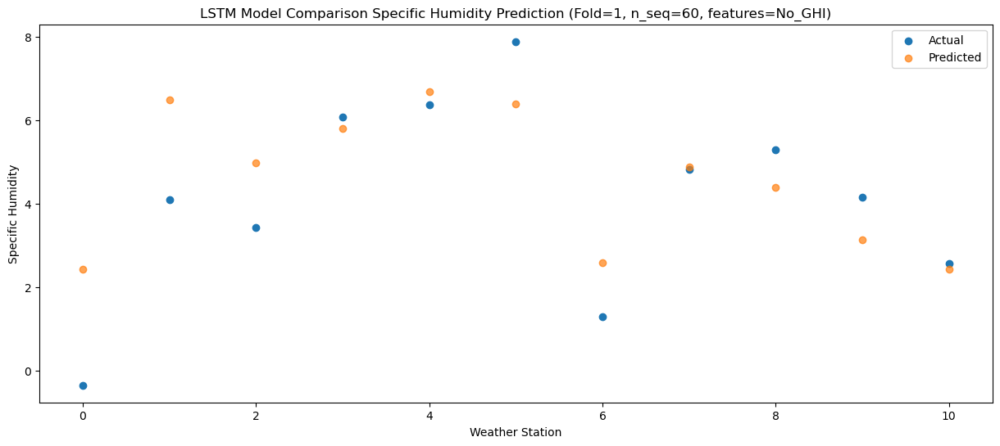

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40  -0.935457
1                 1    1.09   3.130028
2                 2    0.88   1.626835
3                 3    2.75   2.444166
4                 4    3.03   3.334754
5                 5    5.26   3.041836
6                 6   -2.04  -0.766269
7                 7    2.11   1.529117
8                 8    2.63   1.032267
9                 9    1.84  -0.217888
10               10   -1.09  -0.922049


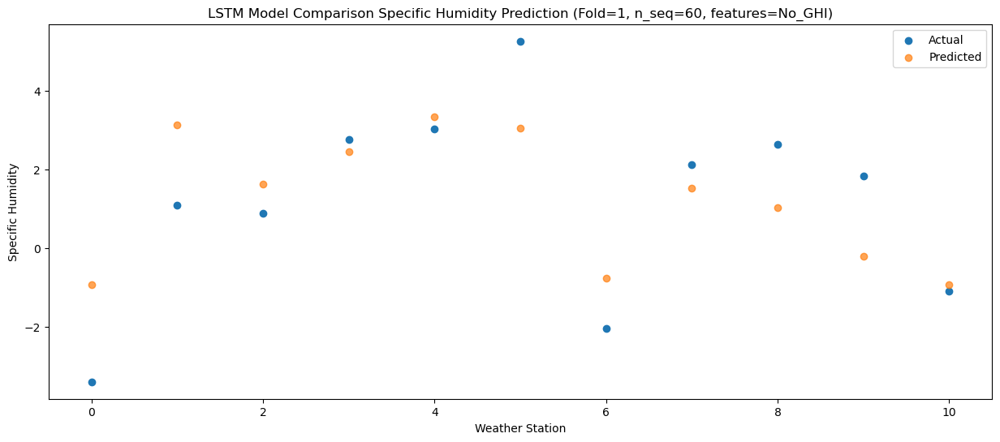

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15  -0.843121
1                 1    0.51   3.222074
2                 2   -0.14   1.717317
3                 3    1.11   2.534069
4                 4    1.31   3.423467
5                 5    3.39   3.129796
6                 6   -2.54  -0.677676
7                 7    0.72   1.618087
8                 8    1.58   1.119895
9                 9    1.40  -0.130613
10               10   -0.85  -0.832784


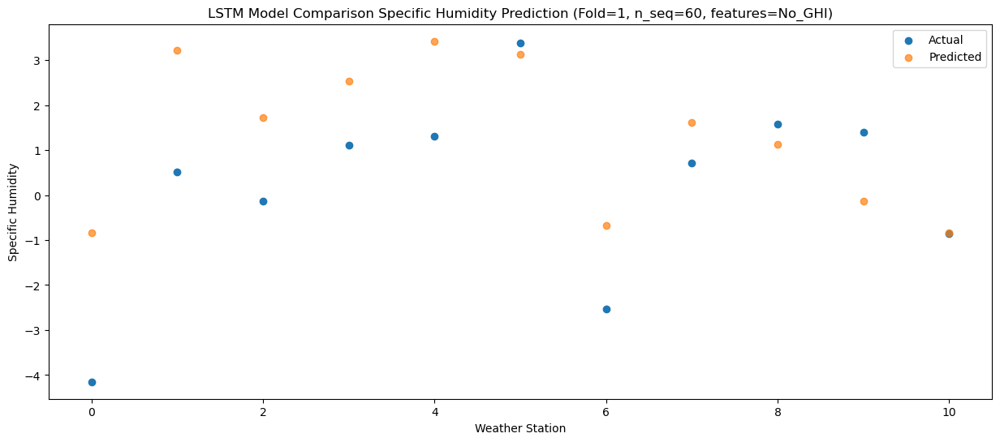

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54  -2.076512
1                 1   -0.26   1.985466
2                 2   -0.77   0.478727
3                 3    0.01   1.295245
4                 4    0.14   2.186155
5                 5    2.24   1.892051
6                 6   -3.36  -1.917741
7                 7   -0.35   0.378288
8                 8    0.27  -0.116954
9                 9    0.66  -1.365799
10               10   -1.90  -2.069379


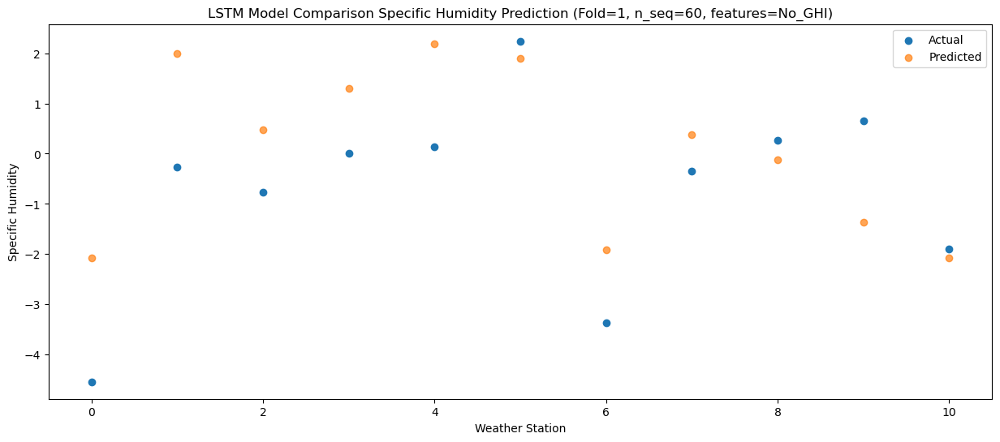

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93  -1.725626
1                 1    0.08   2.336241
2                 2    0.03   0.829536
3                 3    2.26   1.644342
4                 4    2.39   2.534983
5                 5    2.65   2.242306
6                 6   -2.88  -1.565052
7                 7    1.40   0.732495
8                 8    2.02   0.235478
9                 9    1.33  -1.011695
10               10   -2.03  -1.715866


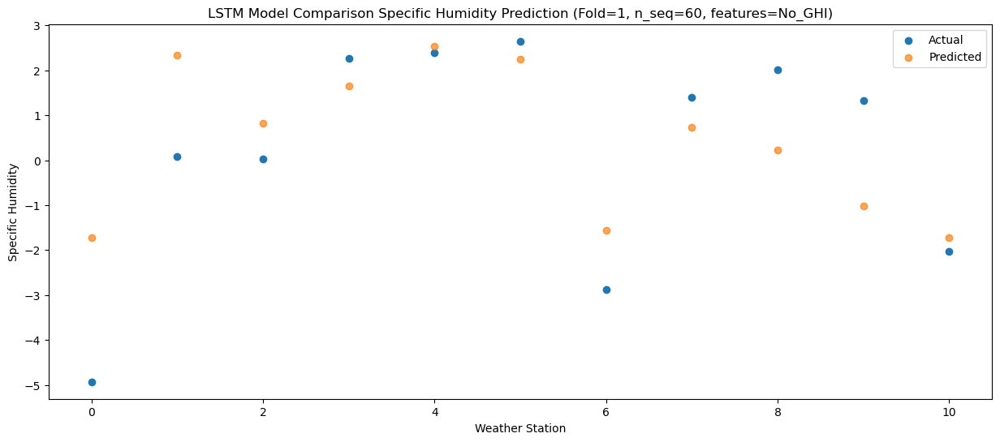

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52  -0.869912
1                 1    1.59   3.190644
2                 2    1.57   1.682710
3                 3    4.17   2.492778
4                 4    4.32   3.382680
5                 5    3.61   3.087659
6                 6   -1.54  -0.716503
7                 7    2.59   1.577502
8                 8    3.57   1.078393
9                 9    1.64  -0.169871
10               10   -1.00  -0.868208


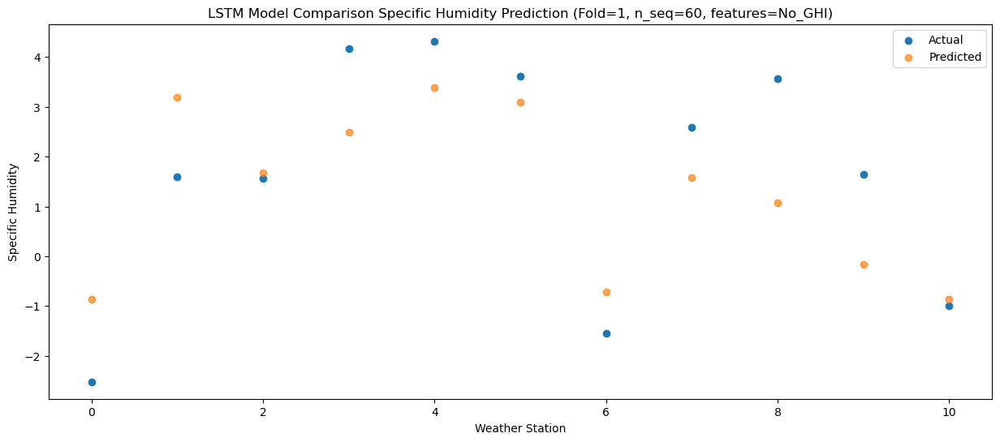

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45   0.419863
1                 1    3.48   4.480074
2                 2    3.56   2.972018
3                 3    6.42   3.781799
4                 4    6.52   4.672949
5                 5    4.25   4.379410
6                 6    0.61   0.574567
7                 7    4.36   2.869694
8                 8    5.89   2.370818
9                 9    2.50   1.124561
10               10    0.61   0.427334


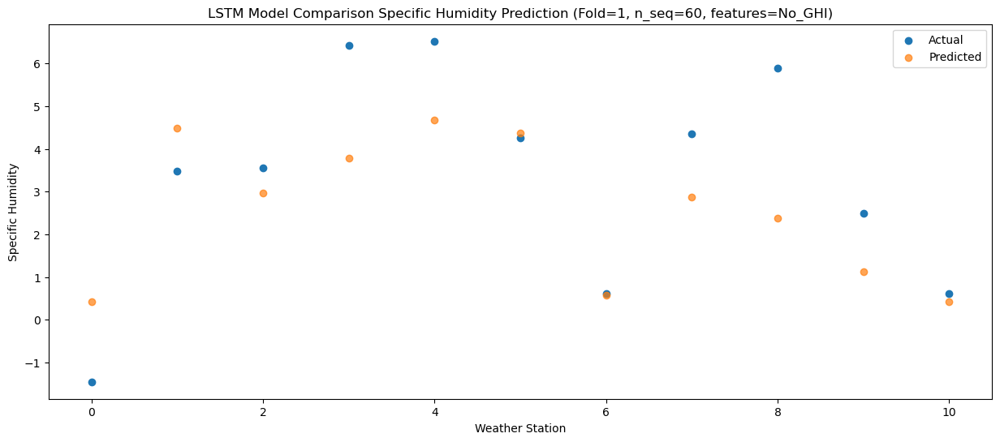

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75   3.735560
1                 1    7.28   7.795206
2                 2    7.69   6.287554
3                 3   10.77   7.096503
4                 4   10.50   7.986680
5                 5    6.68   7.692208
6                 6    4.75   3.887642
7                 7    8.67   6.183375
8                 8    9.49   5.683615
9                 9    5.23   4.437195
10               10    4.19   3.738138


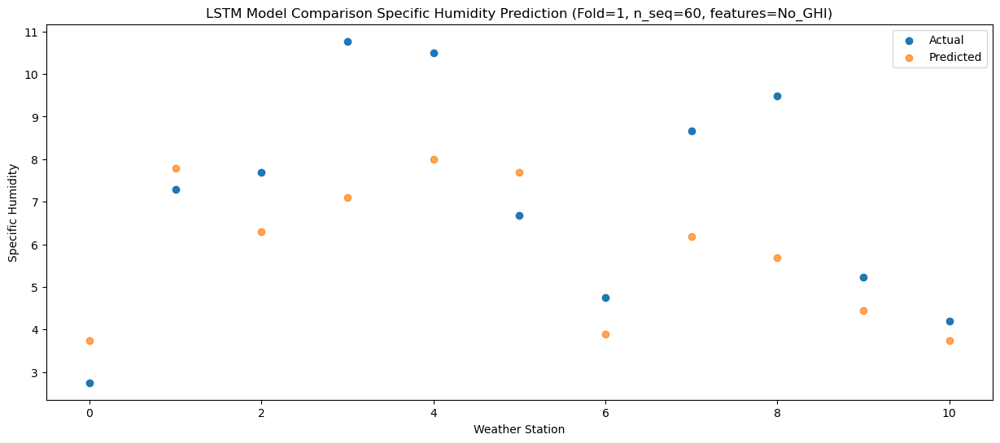

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   6.149371
1                 1    8.79  10.207106
2                 2    9.12   8.696380
3                 3   12.16   9.506119
4                 4   12.01  10.395974
5                 5   11.53  10.103346
6                 6    6.71   6.296865
7                 7   10.69   8.593461
8                 8   12.40   8.095263
9                 9   10.90   6.851656
10               10    6.01   6.151483


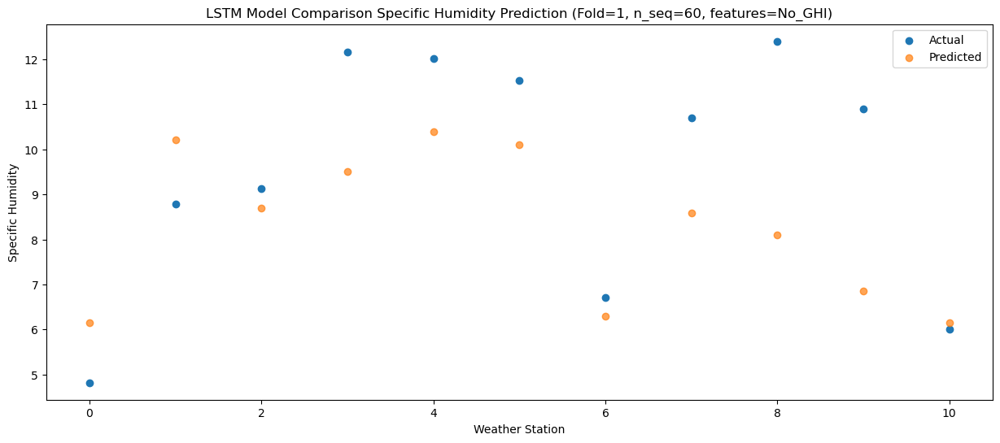

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24   7.984333
1                 1   11.39  12.044000
2                 2   12.29  10.533753
3                 3   12.24  11.341787
4                 4   12.33  12.229296
5                 5   11.38  11.935122
6                 6    9.09   8.130544
7                 7   11.36  10.425990
8                 8   11.01   9.926551
9                 9    9.15   8.682686
10               10    9.38   7.983501


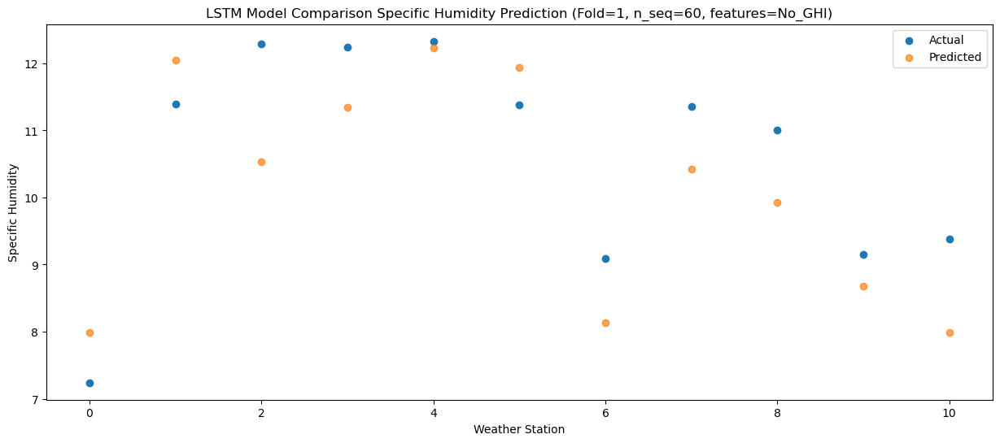

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60   6.431702
1                 1    9.66  10.492769
2                 2   10.17   8.981711
3                 3   12.33   9.786261
4                 4   12.38  10.672156
5                 5   10.24  10.379888
6                 6    7.37   6.575105
7                 7   10.12   8.873551
8                 8   10.42   8.373733
9                 9    9.34   7.131613
10               10    7.80   6.430570


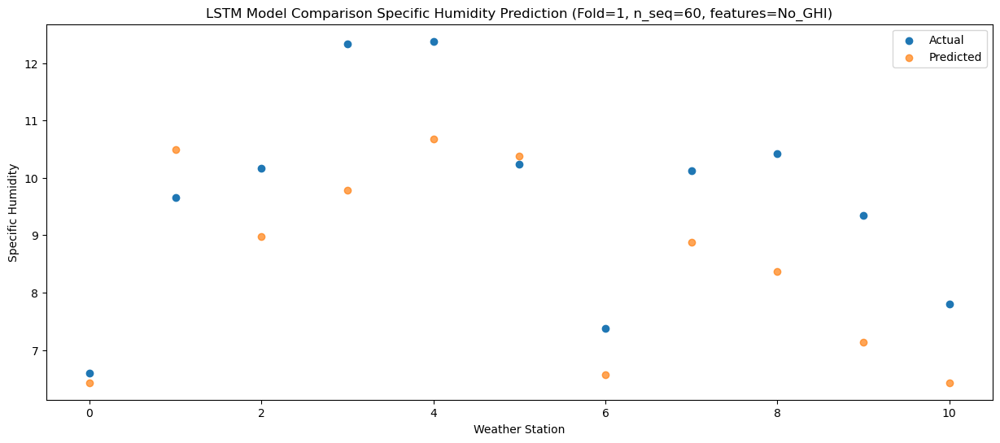

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61   4.764289
1                 1    8.14   8.825663
2                 2    8.62   7.313236
3                 3    9.41   8.118983
4                 4    9.84   9.005865
5                 5   10.72   8.714899
6                 6    6.08   4.911664
7                 7    8.36   7.209609
8                 8    8.51   6.709199
9                 9    6.90   5.466221
10               10    5.31   4.768748


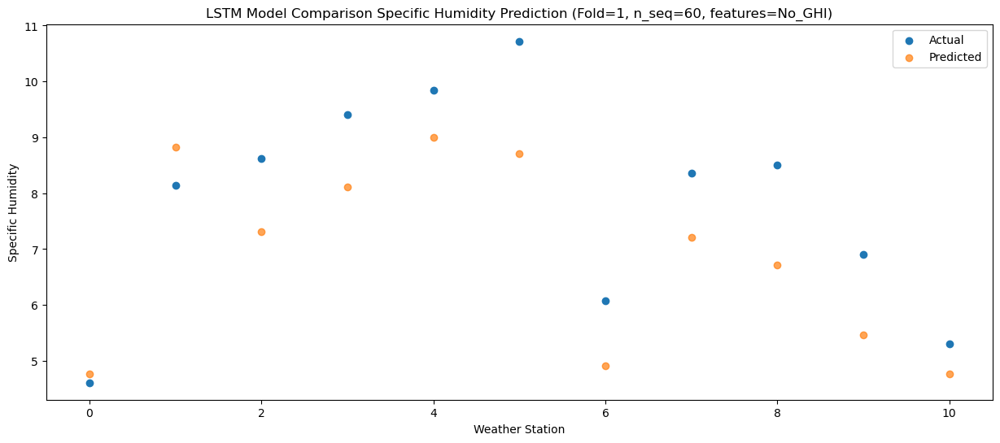

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34   1.367249
1                 1    4.31   5.429016
2                 2    4.12   3.918954
3                 3    5.36   4.722640
4                 4    5.51   5.607462
5                 5    6.45   5.316126
6                 6    1.94   1.512707
7                 7    3.32   3.811068
8                 8    5.15   3.310688
9                 9    3.91   2.065032
10               10    1.00   1.369843


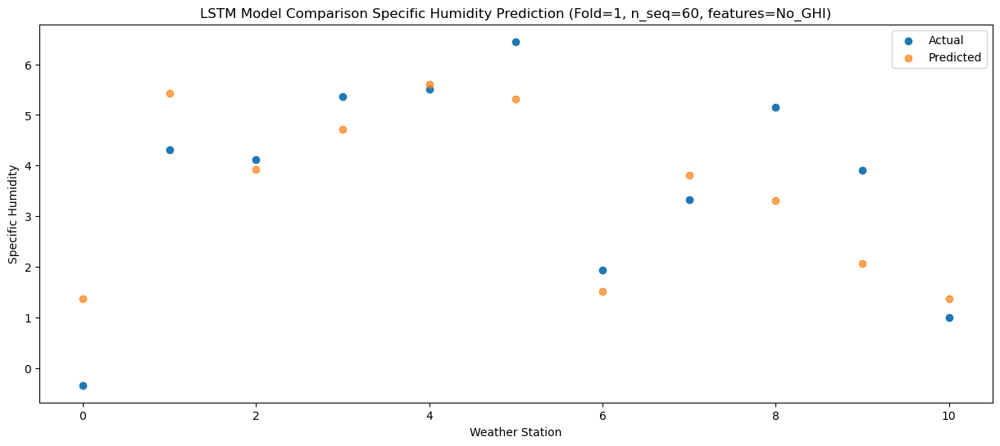

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

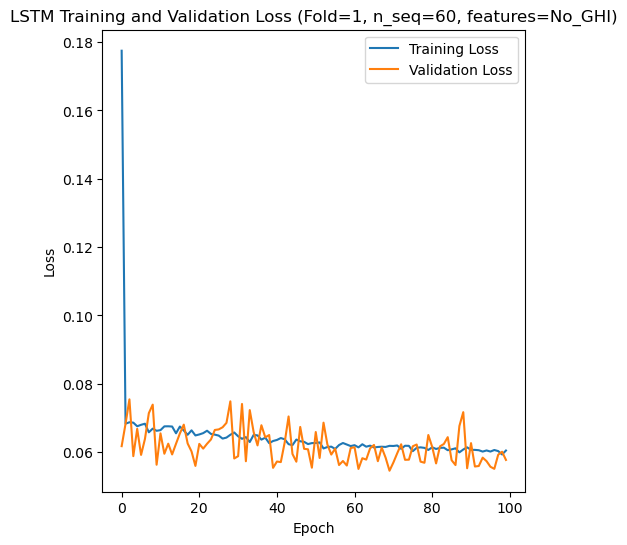

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 43s 219ms/step - loss: 0.1590 - accuracy: 0.3571 - mae: 0.1291 - rmse: 0.1590 - mape: 28.4680 - pearson: 0.6126 - val_loss: 0.0652 - val_accuracy: 0.8000 - val_mae: 0.0518 - val_rmse: 0.0652 - val_mape: 12.3091 - val_pearson: 0.8469
Epoch 2/100
84/84 [==============================] - 14s 163ms/step - loss: 0.0708 - accuracy: 0.3929 - mae: 0.0552 - rmse: 0.0708 - mape: 12.5512 - pearson: 0.7590 - val_loss: 0.0398 - val_accuracy: 0.8000 - val_mae: 0.0302 - val_rmse: 0.0398 - val_mape: 6.8911 - val_pearson: 0.9245
Epoch 3/100
84/84 [==============================] - 13s 160ms/step - loss: 0.0684 - accuracy: 0.4762 - mae: 0.0537 - rmse: 0.0684 - mape: 12.1416 - pearson: 0.7700 

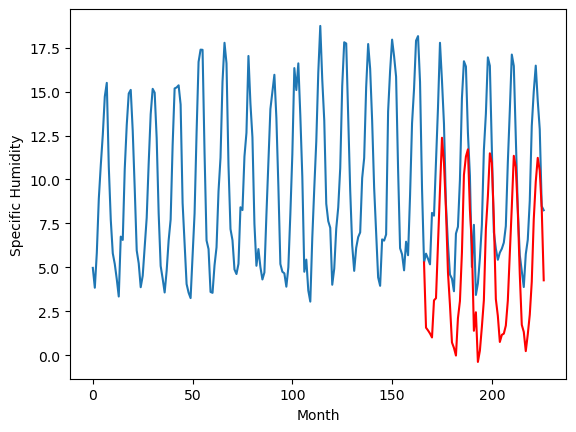

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		1.48		-1.86
2.83		1.32		-1.51
2.81		1.15		-1.66
2.87		0.93		-1.94
4.66		3.04		-1.62
4.95		3.16		-1.79
7.85		6.25		-1.60
9.27		9.32		0.05
14.08		12.29		-1.79
12.65		10.86		-1.79
8.59		8.19		-0.40
4.86		4.63		-0.23
4.64		2.78		-1.86
2.91		0.65		-2.26
2.86		0.34		-2.52
2.18		-0.10		-2.28
4.03		2.02		-2.01
4.15		3.00		-1.15
9.27		5.76		-3.51
12.18		10.17		-2.01
13.79		11.22		-2.57
12.17		11.63		-0.54
9.35		8.19		-1.16
5.96		6.16		0.20
3.53		1.31		-2.22
2.47		2.35		-0.12
2.14		-0.47		-2.61
2.05		0.17		-1.88
2.93		1.53		-1.40
4.08		3.05		-1.03
6.47		7.09		0.62
10.83		8.95		-1.88
12.17		11.40		-0.77
11.67		10.86		-0.81
9.10		7.64		-1.46
5.42		3.11		-2.31
3.92		2.15		-1.77
2.73		0.67		-2.06
2.72		1.08		-1.64
2.64		1.15		-1.49
3.33		1.61		-1.72
3.95		3.03		-0.92
9.73		5.72		-4.01
12.38		8.38		-4.00
14.44		11.27		-3.17
12.55		10.63		-1.92
9.96		8.14		-1.82
6.50		4.52		-1.98
3.94		1.64		-2.30
3.55

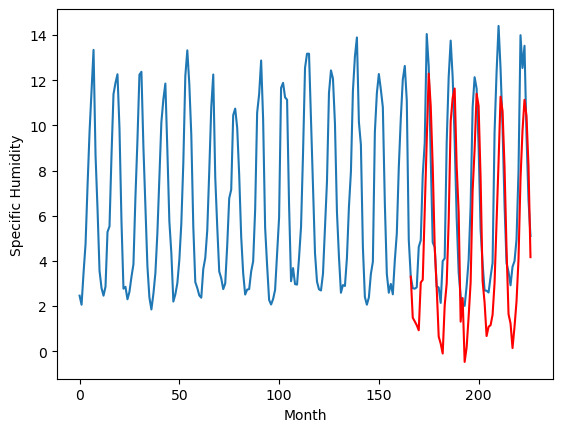

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-1.03		1.43
-2.15		-1.19		0.96
-3.71		-1.37		2.34
-2.83		-1.59		1.24
-1.66		0.52		2.18
-0.18		0.64		0.82
0.93		3.73		2.80
4.27		6.80		2.53
5.29		9.77		4.48
5.99		8.34		2.35
5.29		5.68		0.39
2.70		2.12		-0.58
-0.25		0.27		0.52
-4.92		-1.87		3.05
-4.43		-2.18		2.25
-2.30		-2.61		-0.31
-2.08		-0.49		1.59
-1.11		0.49		1.60
0.20		3.25		3.05
3.98		7.67		3.69
4.38		8.71		4.33
5.00		9.12		4.12
3.72		5.68		1.96
1.06		3.66		2.60
-2.89		-1.20		1.69
-1.49		-0.15		1.34
-5.14		-2.98		2.16
-3.95		-2.33		1.62
-2.14		-0.97		1.17
-0.78		0.55		1.33
2.32		4.60		2.28
4.25		6.45		2.20
5.08		8.90		3.82
4.97		8.37		3.40
4.82		5.15		0.33
0.43		0.62		0.19
0.32		-0.33		-0.65
-3.34		-1.81		1.53
-3.72		-1.41		2.31
-1.87		-1.33		0.54
-1.48		-0.87		0.61
0.03		0.54		0.51
0.84		3.23		2.39
4.00		5.90		1.90
4.97		8.78		3.81
5.69		8.15		2.46
3.30		5.66		2.36
0.38		2.04		1.66
-2.12		-0.84		1.28
-2.69		-1.25		1.44
-3.76		-

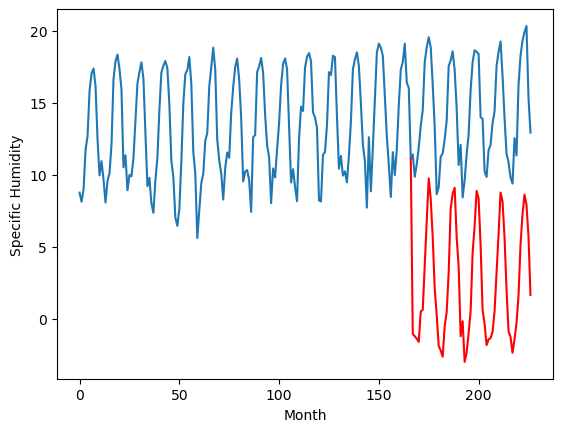

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		5.29		0.80
3.93		5.13		1.20
3.75		4.96		1.21
3.77		4.74		0.97
4.29		6.85		2.56
4.67		6.97		2.30
6.92		10.06		3.14
10.93		13.13		2.20
14.31		16.10		1.79
13.48		14.67		1.19
10.39		12.00		1.61
7.88		8.44		0.56
6.01		6.59		0.58
4.09		4.46		0.37
3.01		4.15		1.14
3.18		3.72		0.54
3.82		5.84		2.02
5.17		6.81		1.64
6.85		9.57		2.72
11.45		13.99		2.54
14.05		15.04		0.99
14.79		15.44		0.65
12.13		12.00		-0.13
9.17		9.98		0.81
4.72		5.12		0.40
4.36		6.16		1.80
3.03		3.34		0.31
3.60		3.98		0.38
4.36		5.34		0.98
5.06		6.86		1.80
8.36		10.91		2.55
10.62		12.77		2.15
13.98		15.21		1.23
14.66		14.68		0.02
10.86		11.46		0.60
7.99		6.93		-1.06
6.17		5.98		-0.19
4.08		4.50		0.42
4.59		4.91		0.32
3.83		4.98		1.15
4.08		5.44		1.36
6.16		6.86		0.70
6.97		9.55		2.58
10.87		12.22		1.35
15.13		15.11		-0.02
12.79		14.47		1.68
11.78		11.98		0.20
8.42		8.36		-0.06
4.59		5.48		0.89
4.88		5.08		0.20
3.55		3.99		0.44

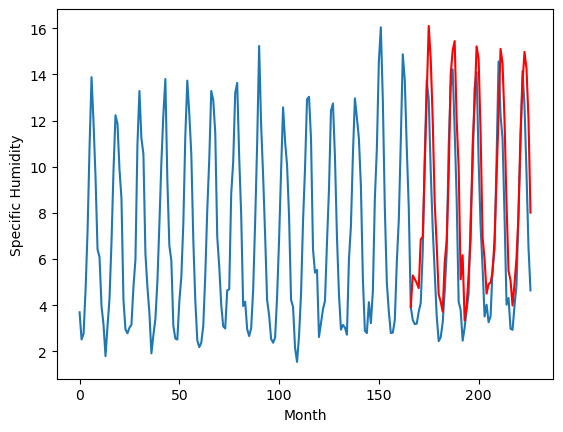

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		0.20		2.27
-1.27		0.04		1.31
-1.24		-0.14		1.10
-0.92		-0.36		0.56
2.57		1.76		-0.81
1.61		1.88		0.27
3.73		4.97		1.24
7.07		8.04		0.97
9.20		11.01		1.81
8.47		9.58		1.11
6.67		6.92		0.25
3.46		3.36		-0.10
0.73		1.51		0.78
-2.55		-0.63		1.92
-2.42		-0.94		1.48
-2.44		-1.37		1.07
0.85		0.76		-0.09
0.87		1.73		0.86
4.07		4.49		0.42
7.96		8.91		0.95
8.99		9.96		0.97
8.59		10.36		1.77
6.45		6.93		0.48
3.92		4.90		0.98
-1.74		0.05		1.79
1.54		1.09		-0.45
-3.37		-1.73		1.64
-1.91		-1.09		0.82
-1.06		0.28		1.34
1.37		1.80		0.43
5.40		5.85		0.45
7.70		7.70		0.00
8.99		10.16		1.17
9.39		9.62		0.23
5.88		6.40		0.52
0.70		1.87		1.17
0.26		0.92		0.66
-0.29		-0.56		-0.27
-0.38		-0.15		0.23
0.92		-0.08		-1.00
1.80		0.38		-1.42
2.35		1.80		-0.55
5.41		4.49		-0.92
8.72		7.16		-1.56
10.06		10.05		-0.01
10.09		9.42		-0.67
7.74		6.92		-0.82
2.51		3.30		0.79
-0.01		0.43		0.44
-1.60		0.02		1.62
-2.47		-1.0

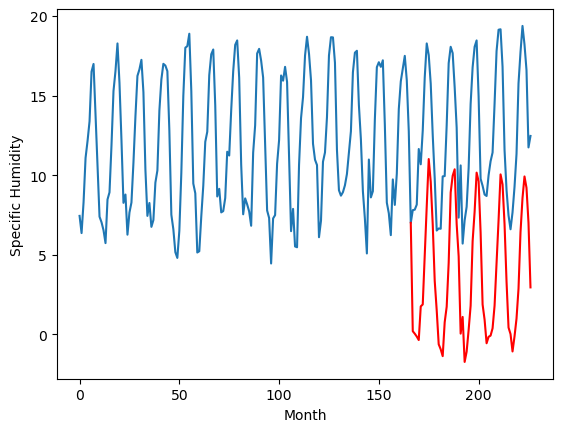

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		3.95		0.18
2.58		3.79		1.21
3.41		3.61		0.20
2.74		3.39		0.65
7.35		5.51		-1.84
6.83		5.63		-1.20
8.91		8.72		-0.19
11.03		11.79		0.76
13.61		14.76		1.15
12.17		13.33		1.16
10.72		10.67		-0.05
6.85		7.11		0.26
4.79		5.26		0.47
2.47		3.12		0.65
2.34		2.81		0.47
2.29		2.37		0.08
5.28		4.50		-0.78
6.85		5.48		-1.37
11.68		8.24		-3.44
14.32		12.65		-1.67
13.28		13.70		0.42
13.41		14.11		0.70
9.85		10.67		0.82
8.26		8.64		0.38
4.07		3.79		-0.28
6.94		4.84		-2.10
1.31		2.01		0.70
1.53		2.66		1.13
3.15		4.02		0.87
7.11		5.54		-1.57
10.76		9.60		-1.16
11.79		11.45		-0.34
12.89		13.90		1.01
13.35		13.36		0.01
9.99		10.15		0.16
5.17		5.62		0.45
5.03		4.66		-0.37
4.12		3.19		-0.93
3.74		3.60		-0.14
4.19		3.67		-0.52
5.97		4.13		-1.84
6.52		5.55		-0.97
10.22		8.24		-1.98
13.68		10.91		-2.77
13.39		13.80		0.41
11.96		13.17		1.21
11.41		10.68		-0.73
7.88		7.06		-0.82
4.71		4.18		-0.53
2.78		3.78		1.0

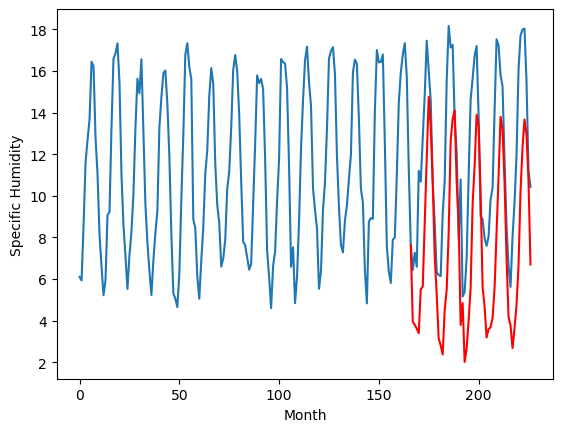

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		2.61		-0.28
1.79		2.45		0.66
2.47		2.27		-0.20
1.91		2.05		0.14
6.13		4.16		-1.97
5.71		4.28		-1.43
8.65		7.37		-1.28
10.93		10.45		-0.48
13.84		13.41		-0.43
11.14		11.98		0.84
10.20		9.33		-0.87
5.71		5.77		0.06
4.12		3.91		-0.21
1.41		1.78		0.37
1.31		1.46		0.15
0.98		1.03		0.05
3.84		3.16		-0.68
5.16		4.13		-1.03
9.36		6.89		-2.47
13.11		11.31		-1.80
13.93		12.35		-1.58
14.31		12.76		-1.55
9.86		9.32		-0.54
7.25		7.30		0.05
3.26		2.44		-0.82
5.76		3.49		-2.27
0.47		0.67		0.20
0.94		1.31		0.37
2.57		2.67		0.10
6.47		4.19		-2.28
10.56		8.25		-2.31
11.36		10.10		-1.26
10.68		12.55		1.87
11.74		12.01		0.27
9.07		8.79		-0.28
4.29		4.27		-0.02
3.84		3.31		-0.53
2.67		1.84		-0.83
1.89		2.25		0.36
2.29		2.32		0.03
4.20		2.78		-1.42
4.87		4.20		-0.67
8.76		6.89		-1.87
12.66		9.56		-3.10
11.95		12.45		0.50
9.90		11.82		1.92
9.27		9.33		0.06
6.12		5.71		-0.41
3.50		2.83		-0.67
1.68		2.42		0.74


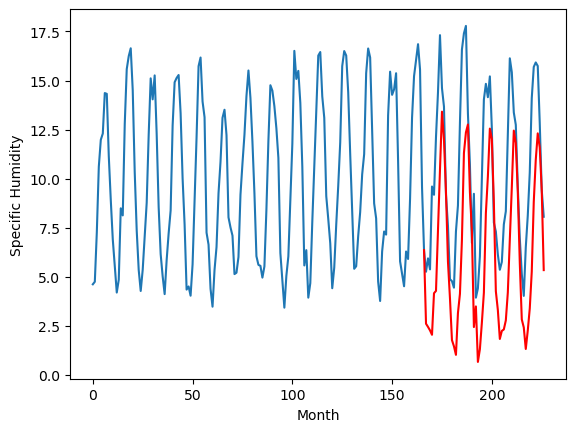

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		1.14		-2.41
3.10		0.97		-2.13
2.15		0.79		-1.36
2.68		0.57		-2.11
4.14		2.69		-1.45
2.74		2.81		0.07
2.98		5.89		2.91
4.66		8.97		4.31
8.10		11.93		3.83
6.37		10.50		4.13
5.72		7.84		2.12
2.65		4.28		1.63
2.70		2.42		-0.28
1.44		0.29		-1.15
1.72		-0.03		-1.75
1.59		-0.47		-2.06
1.68		1.66		-0.02
1.98		2.63		0.65
2.10		5.38		3.28
4.76		9.79		5.03
10.00		10.84		0.84
10.29		11.25		0.96
7.53		7.81		0.28
3.82		5.78		1.96
2.17		0.93		-1.24
2.30		1.97		-0.33
2.02		-0.86		-2.88
1.03		-0.21		-1.24
1.43		1.15		-0.28
1.44		2.66		1.22
1.37		6.71		5.34
6.87		8.56		1.69
9.43		11.01		1.58
11.40		10.47		-0.93
8.36		7.26		-1.10
6.28		2.73		-3.55
2.31		1.78		-0.53
3.13		0.30		-2.83
2.24		0.72		-1.52
2.12		0.79		-1.33
2.46		1.25		-1.21
1.62		2.66		1.04
3.62		5.35		1.73
3.42		8.02		4.60
6.77		10.90		4.13
8.96		10.27		1.31
7.15		7.78		0.63
4.70		4.16		-0.54
3.78		1.28		-2.50
2.26		0.87		-1.39
2.68		-0.23		-

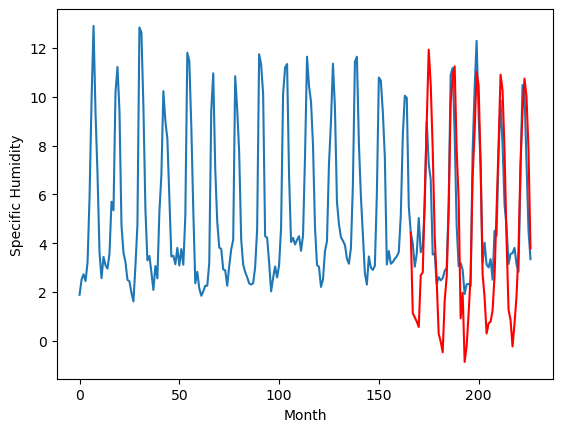

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		-1.60		-3.83
2.05		-1.77		-3.82
1.84		-1.94		-3.78
1.12		-2.16		-3.28
2.76		-0.04		-2.80
4.17		0.08		-4.09
4.93		3.16		-1.77
4.91		6.23		1.32
5.68		9.18		3.50
6.76		7.76		1.00
4.98		5.10		0.12
3.85		1.55		-2.30
1.61		-0.31		-1.92
0.04		-2.44		-2.48
0.89		-2.77		-3.66
1.42		-3.20		-4.62
1.53		-1.08		-2.61
2.85		-0.12		-2.97
4.33		2.64		-1.69
5.58		7.05		1.47
6.73		8.10		1.37
6.13		8.49		2.36
5.67		5.05		-0.62
2.87		3.03		0.16
2.33		-1.82		-4.15
2.15		-0.79		-2.94
0.79		-3.61		-4.40
0.05		-2.97		-3.02
1.79		-1.61		-3.40
2.63		-0.10		-2.73
3.89		3.95		0.06
5.66		5.80		0.14
6.55		8.25		1.70
6.65		7.72		1.07
7.50		4.50		-3.00
5.73		-0.02		-5.75
1.09		-0.98		-2.07
1.94		-2.45		-4.39
2.03		-2.03		-4.06
0.62		-1.96		-2.58
2.54		-1.50		-4.04
3.24		-0.08		-3.32
4.64		2.60		-2.04
5.02		5.27		0.25
6.36		8.15		1.79
6.97		7.52		0.55
6.72		5.03		-1.69
4.42		1.41		-3.01
1.39		-1.47		-2.86
2.18		-1.89		

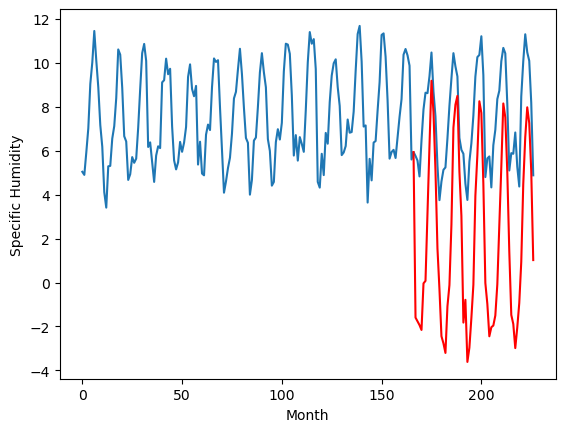

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		1.55		1.72
-0.06		1.39		1.45
-0.08		1.21		1.29
0.31		0.99		0.68
1.94		3.10		1.16
1.85		3.22		1.37
5.18		6.31		1.13
8.69		9.38		0.69
11.54		12.34		0.80
11.53		10.92		-0.61
7.81		8.26		0.45
5.19		4.70		-0.49
2.54		2.85		0.31
-0.68		0.71		1.39
-0.80		0.39		1.19
-0.73		-0.04		0.69
1.00		2.08		1.08
1.53		3.05		1.52
4.24		5.81		1.57
8.74		10.22		1.48
10.26		11.27		1.01
10.84		11.67		0.83
7.24		8.23		0.99
5.08		6.21		1.13
-0.48		1.35		1.83
1.37		2.39		1.02
-1.41		-0.44		0.97
-0.10		0.21		0.31
0.86		1.57		0.71
1.90		3.08		1.18
6.22		7.13		0.91
8.02		8.98		0.96
11.60		11.43		-0.17
10.03		10.90		0.87
6.60		7.68		1.08
2.24		3.15		0.91
1.77		2.20		0.43
-0.47		0.72		1.19
0.39		1.13		0.74
1.15		1.21		0.06
0.84		1.67		0.83
2.97		3.08		0.11
4.50		5.77		1.27
7.36		8.43		1.07
11.20		11.32		0.12
10.71		10.69		-0.02
7.57		8.20		0.63
3.38		4.58		1.20
0.27		1.70		1.43
0.18		1.29		1.11
-0.51		0.20		0.71
-0.

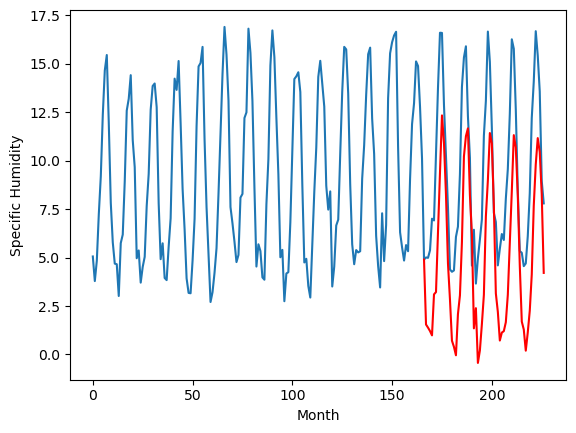

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		1.57		1.05
0.97		1.41		0.44
0.77		1.23		0.46
0.88		1.01		0.13
2.73		3.12		0.39
2.16		3.24		1.08
4.95		6.33		1.38
8.39		9.40		1.01
11.09		12.37		1.28
10.85		10.94		0.09
8.24		8.28		0.04
5.05		4.72		-0.33
1.93		2.87		0.94
0.14		0.73		0.59
0.15		0.42		0.27
0.39		-0.01		-0.40
1.42		2.11		0.69
2.03		3.09		1.06
4.70		5.84		1.14
8.80		10.26		1.46
10.21		11.30		1.09
10.60		11.71		1.11
7.39		8.27		0.88
5.66		6.24		0.58
0.30		1.39		1.09
1.86		2.43		0.57
-0.56		-0.39		0.17
0.34		0.25		-0.09
0.96		1.61		0.65
2.23		3.12		0.89
6.39		7.18		0.79
8.35		9.03		0.68
11.56		11.48		-0.08
10.57		10.95		0.38
7.09		7.73		0.64
2.43		3.20		0.77
1.81		2.25		0.44
0.72		0.77		0.05
0.99		1.18		0.19
1.39		1.25		-0.14
0.99		1.71		0.72
2.63		3.13		0.50
5.22		5.81		0.59
7.06		8.48		1.42
10.37		11.37		1.00
10.48		10.74		0.26
8.06		8.25		0.19
3.95		4.63		0.68
1.00		1.75		0.75
0.79		1.34		0.55
0.17		0.25		0.08
0.57		1.20		

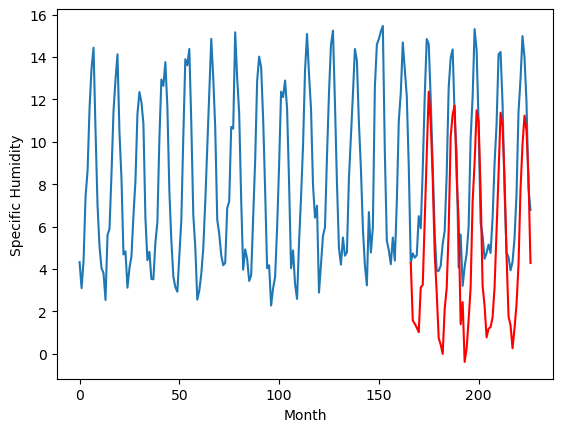

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.567285
1                 1    3.34   1.481837
2                 2   -2.46  -1.033915
3                 3    4.49   5.287140
4                 4   -2.07   0.198228
5                 5    3.77   3.953218
6                 6    2.89   2.613424
7                 7    3.55   1.135677
8                 8    2.23  -1.595217
9                 9   -0.17   1.548638
10               10    0.52   1.565397


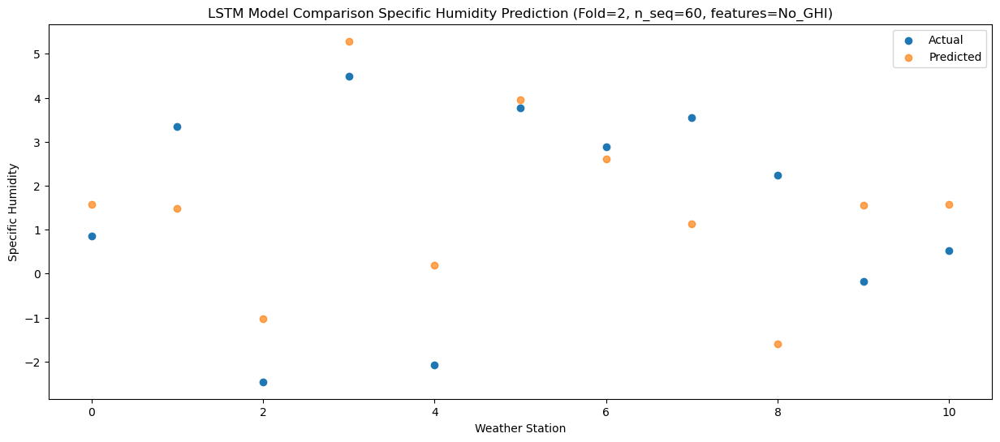

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   1.412329
1                 1    2.83   1.321562
2                 2   -2.15  -1.190405
3                 3    3.93   5.131379
4                 4   -1.27   0.041659
5                 5    2.58   3.791507
6                 6    1.79   2.449982
7                 7    3.10   0.967832
8                 8    2.05  -1.765402
9                 9   -0.06   1.386688
10               10    0.97   1.407036


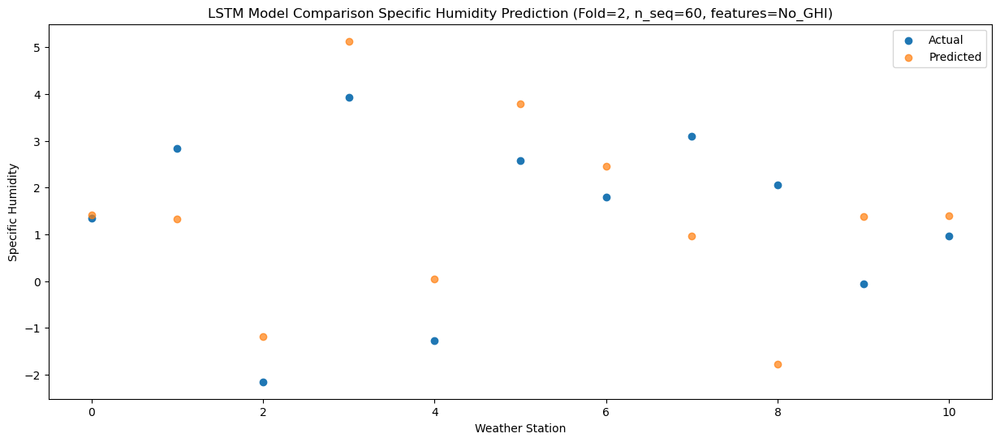

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   1.233487
1                 1    2.81   1.149207
2                 2   -3.71  -1.367904
3                 3    3.75   4.957120
4                 4   -1.24  -0.136620
5                 5    3.41   3.614901
6                 6    2.47   2.271880
7                 7    2.15   0.794082
8                 8    1.84  -1.936366
9                 9   -0.08   1.210001
10               10    0.77   1.229232


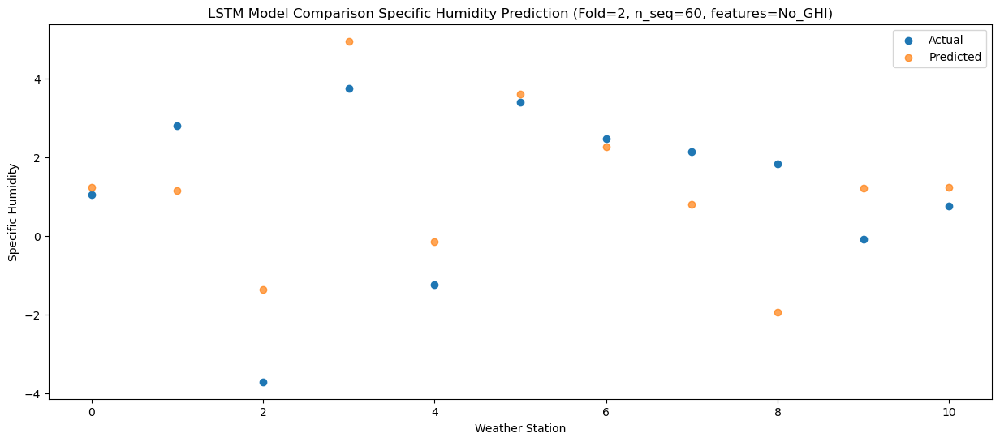

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   1.010336
1                 1    2.87   0.927463
2                 2   -2.83  -1.587316
3                 3    3.77   4.738030
4                 4   -0.92  -0.356788
5                 5    2.74   3.393120
6                 6    1.91   2.048260
7                 7    2.68   0.571833
8                 8    1.12  -2.158071
9                 9    0.31   0.987341
10               10    0.88   1.008037


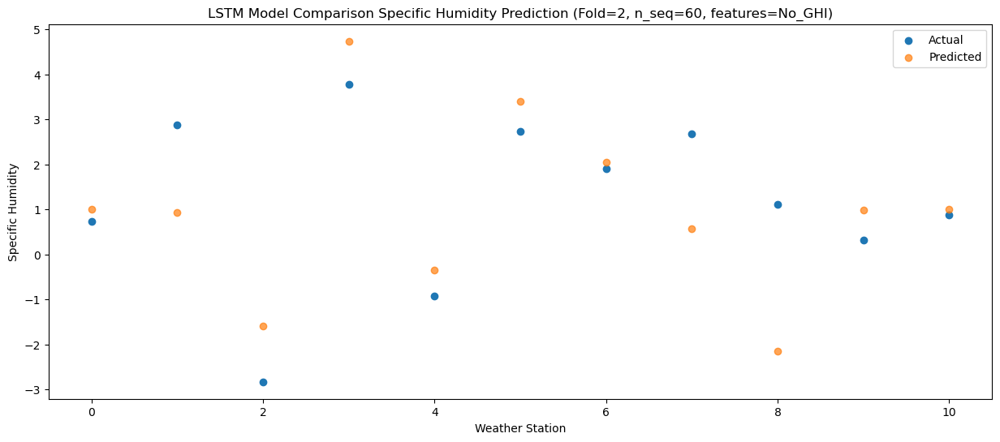

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.121658
1                 1    4.66   3.040637
2                 2   -1.66   0.523213
3                 3    4.29   6.848457
4                 4    2.57   1.755528
5                 5    7.35   5.507122
6                 6    6.13   4.164697
7                 7    4.14   2.690221
8                 8    2.76  -0.039061
9                 9    1.94   3.104017
10               10    2.73   3.121993


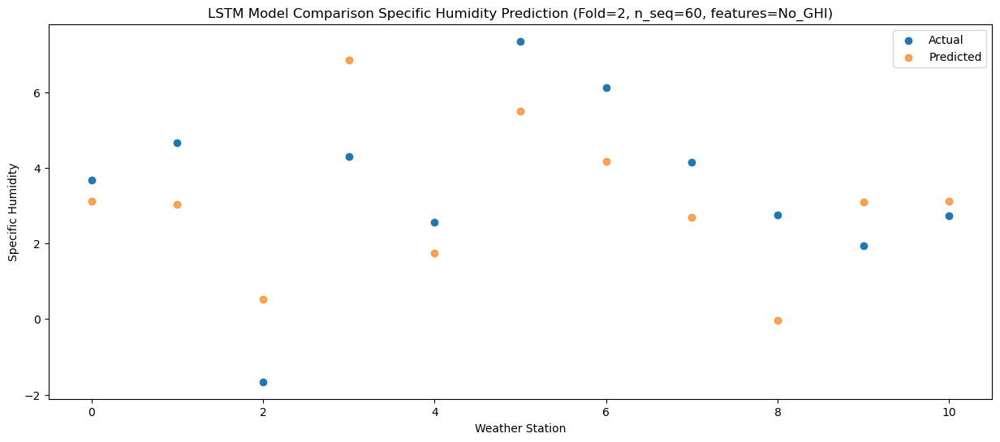

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   3.245755
1                 1    4.95   3.163143
2                 2   -0.18   0.644949
3                 3    4.67   6.972273
4                 4    1.61   1.878792
5                 5    6.83   5.628991
6                 6    5.71   4.284550
7                 7    2.74   2.807947
8                 8    4.17   0.075436
9                 9    1.85   3.221710
10               10    2.16   3.241047


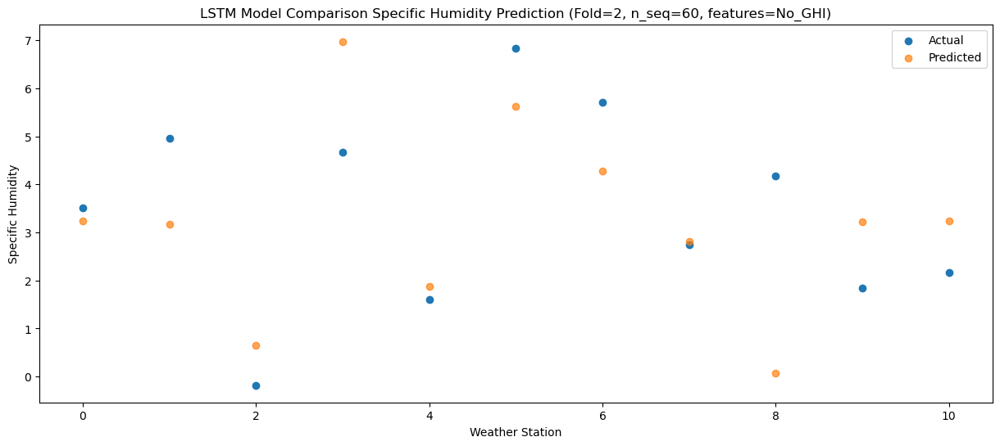

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   6.333220
1                 1    7.85   6.248917
2                 2    0.93   3.728665
3                 3    6.92  10.058591
4                 4    3.73   4.967115
5                 5    8.91   8.716598
6                 6    8.65   7.373918
7                 7    2.98   5.894930
8                 8    4.93   3.157971
9                 9    5.18   6.309283
10               10    4.95   6.330484


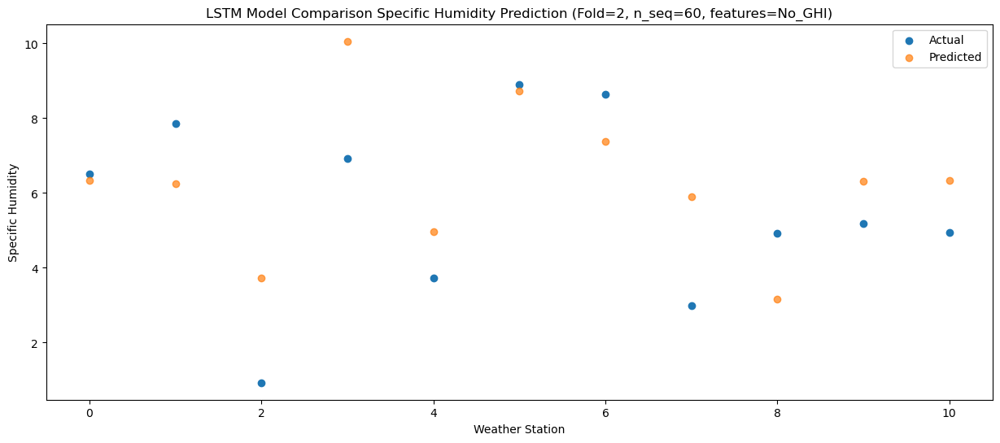

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65   9.407365
1                 1    9.27   9.323216
2                 2    4.27   6.801031
3                 3   10.93  13.132508
4                 4    7.07   8.042533
5                 5   11.03  11.792982
6                 6   10.93  10.450288
7                 7    4.66   8.969204
8                 8    4.91   6.230472
9                 9    8.69   9.383082
10               10    8.39   9.404076


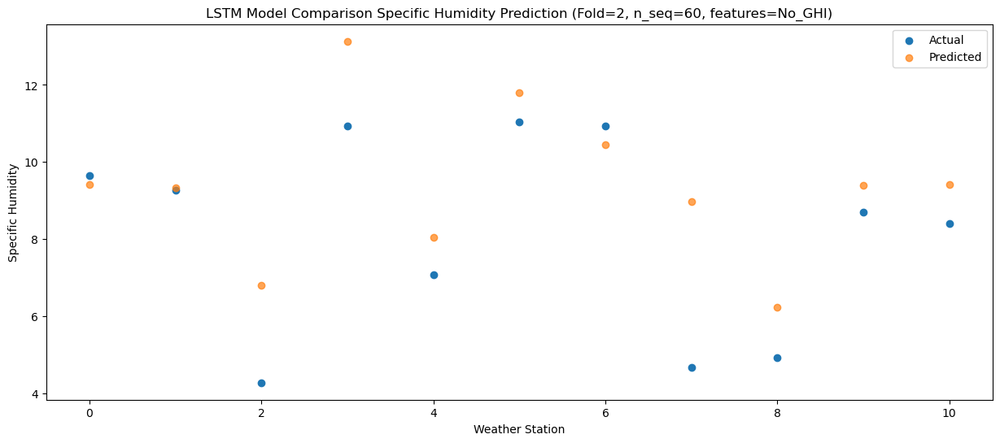

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35  12.375569
1                 1   14.08  12.288748
2                 2    5.29   9.766886
3                 3   14.31  16.100009
4                 4    9.20  11.009564
5                 5   13.61  14.756488
6                 6   13.84  13.412940
7                 7    8.10  11.925688
8                 8    5.68   9.184652
9                 9   11.54  12.342456
10               10   11.09  12.366458


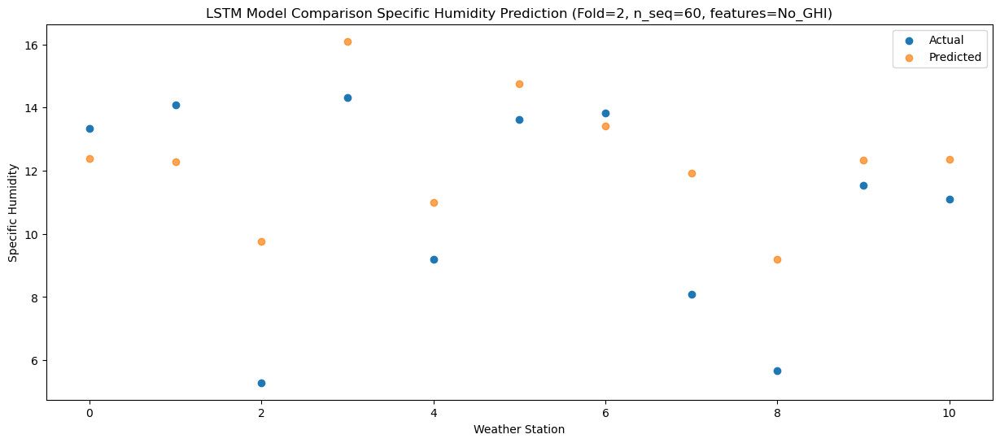

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19  10.941824
1                 1   12.65  10.858931
2                 2    5.99   8.342434
3                 3   13.48  14.670342
4                 4    8.47   9.582164
5                 5   12.17  13.329395
6                 6   11.14  11.984962
7                 7    6.37  10.497340
8                 8    6.76   7.759734
9                 9   11.53  10.917699
10               10   10.85  10.940928


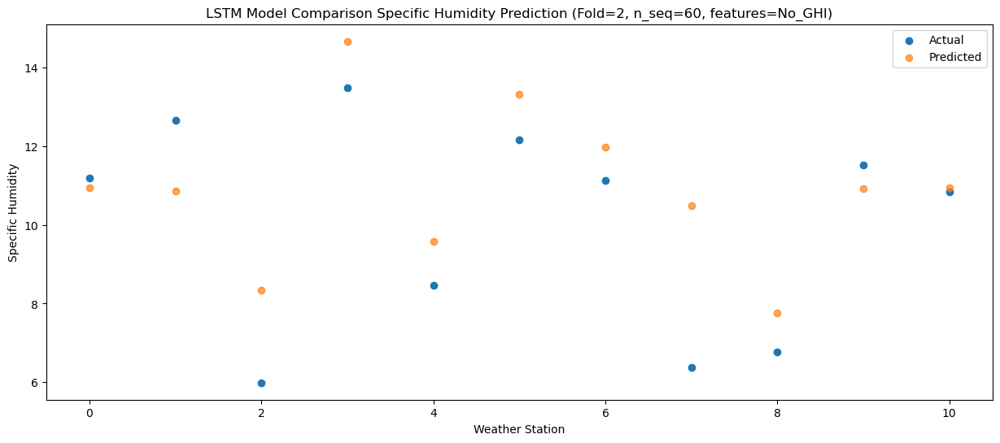

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73   8.276348
1                 1    8.59   8.193390
2                 2    5.29   5.682082
3                 3   10.39  12.004999
4                 4    6.67   6.921798
5                 5   10.72  10.671152
6                 6   10.20   9.326730
7                 7    5.72   7.839094
8                 8    4.98   5.103337
9                 9    7.81   8.260273
10               10    8.24   8.282231


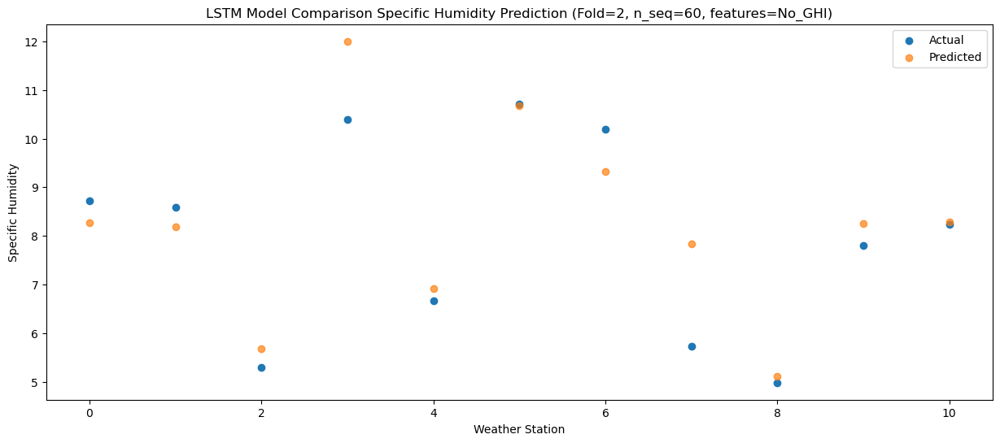

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   4.708689
1                 1    4.86   4.628700
2                 2    2.70   2.121861
3                 3    7.88   8.442418
4                 4    3.46   3.362330
5                 5    6.85   7.111357
6                 6    5.71   5.765252
7                 7    2.65   4.280176
8                 8    3.85   1.546009
9                 9    5.19   4.702503
10               10    5.05   4.724456


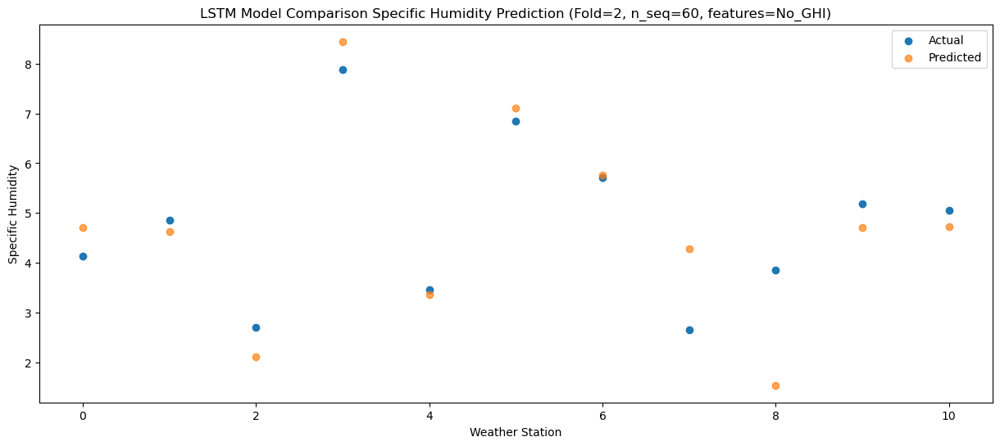

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   2.860397
1                 1    4.64   2.782590
2                 2   -0.25   0.270205
3                 3    6.01   6.593025
4                 4    0.73   1.508544
5                 5    4.79   5.256610
6                 6    4.12   3.911524
7                 7    2.70   2.424693
8                 8    1.61  -0.308988
9                 9    2.54   2.846989
10               10    1.93   2.869651


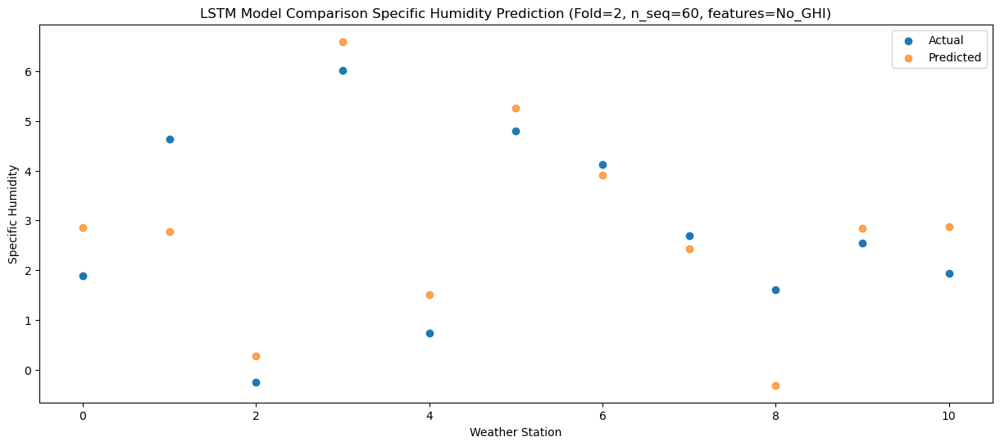

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16   0.727448
1                 1    2.91   0.648330
2                 2   -4.92  -1.869249
3                 3    4.09   4.461021
4                 4   -2.55  -0.625293
5                 5    2.47   3.123028
6                 6    1.41   1.778477
7                 7    1.44   0.290545
8                 8    0.04  -2.444406
9                 9   -0.68   0.711711
10               10    0.14   0.734236


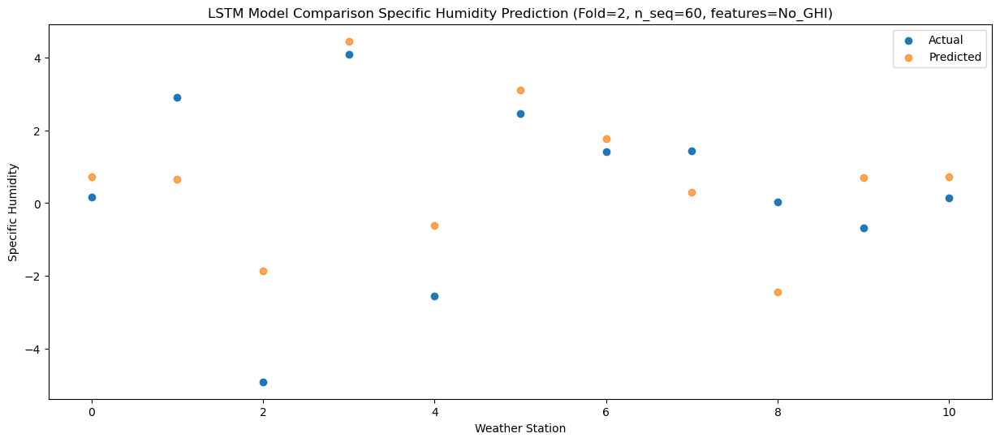

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07   0.416014
1                 1    2.86   0.336442
2                 2   -4.43  -2.182911
3                 3    3.01   4.148588
4                 4   -2.42  -0.938231
5                 5    2.34   2.806797
6                 6    1.31   1.461293
7                 7    1.72  -0.028856
8                 8    0.89  -2.766954
9                 9   -0.80   0.392575
10               10    0.15   0.418036


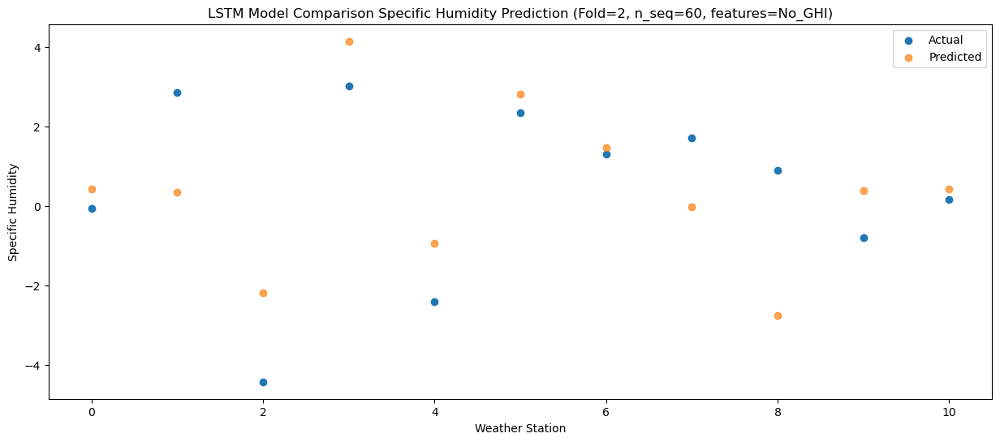

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79  -0.018722
1                 1    2.18  -0.100097
2                 2   -2.30  -2.614341
3                 3    3.18   3.715582
4                 4   -2.44  -1.369131
5                 5    2.29   2.373940
6                 6    0.98   1.027387
7                 7    1.59  -0.465285
8                 8    1.42  -3.203670
9                 9   -0.73  -0.040394
10               10    0.39  -0.012690


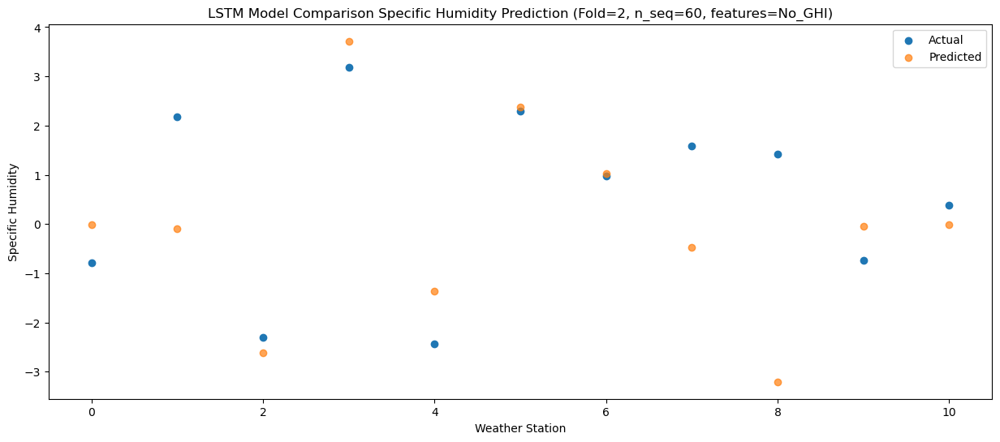

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49   2.105620
1                 1    4.03   2.022353
2                 2   -2.08  -0.487098
3                 3    3.82   5.839762
4                 4    0.85   0.759497
5                 5    5.28   4.502949
6                 6    3.84   3.155672
7                 7    1.68   1.659051
8                 8    1.53  -1.083464
9                 9    1.00   2.084208
10               10    1.42   2.114700


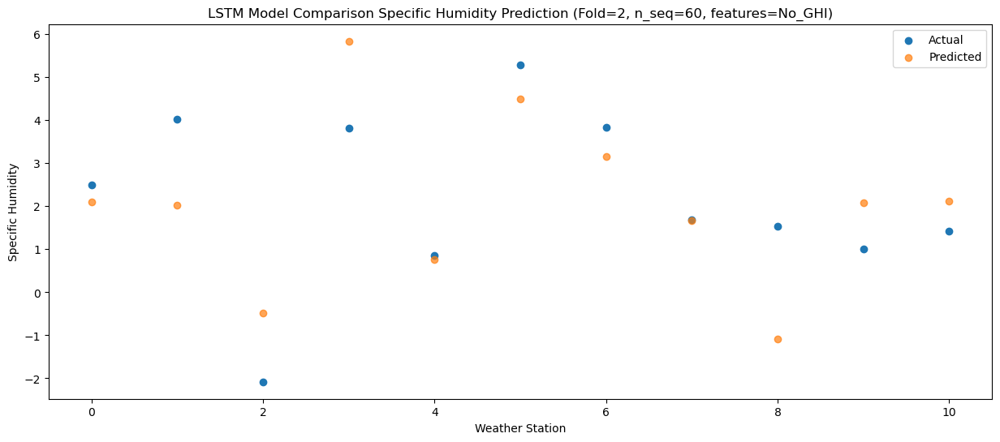

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   3.082199
1                 1    4.15   2.997689
2                 2   -1.11   0.489041
3                 3    5.17   6.812539
4                 4    0.87   1.733010
5                 5    6.85   5.477904
6                 6    5.16   4.130395
7                 7    1.98   2.629464
8                 8    2.85  -0.115133
9                 9    1.53   3.052516
10               10    2.03   3.085168


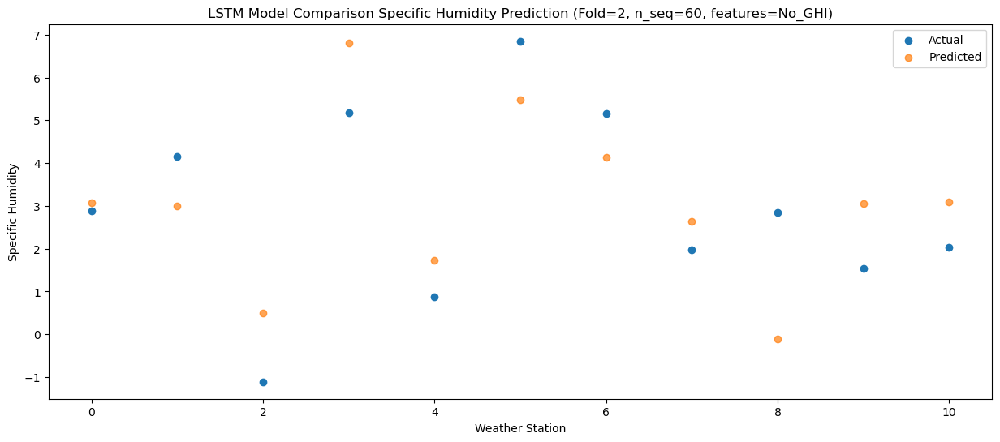

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   5.846622
1                 1    9.27   5.758913
2                 2    0.20   3.249873
3                 3    6.85   9.570499
4                 4    4.07   4.492401
5                 5   11.68   8.239699
6                 6    9.36   6.892642
7                 7    2.10   5.384415
8                 8    4.33   2.638266
9                 9    4.24   5.809088
10               10    4.70   5.843939


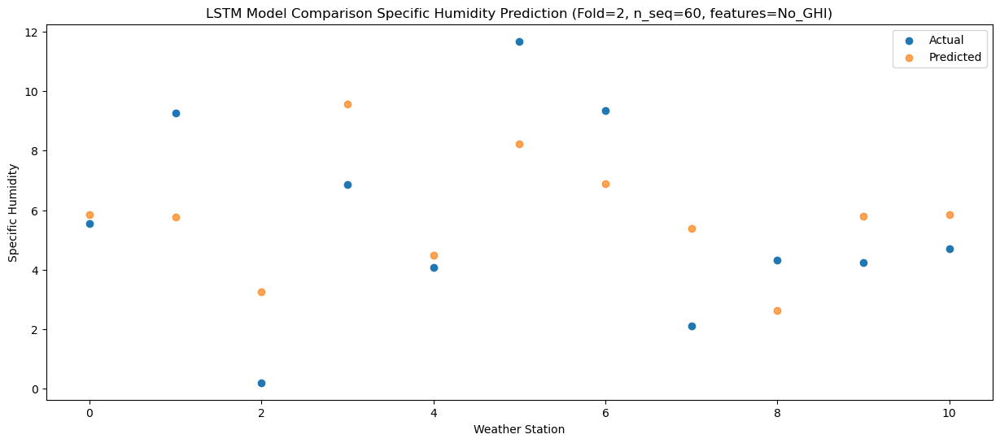

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20  10.260941
1                 1   12.18  10.170315
2                 2    3.98   7.665597
3                 3   11.45  13.987017
4                 4    7.96   8.910025
5                 5   14.32  12.653748
6                 6   13.11  11.305022
7                 7    4.76   9.794886
8                 8    5.58   7.047393
9                 9    8.74  10.223643
10               10    8.80  10.259151


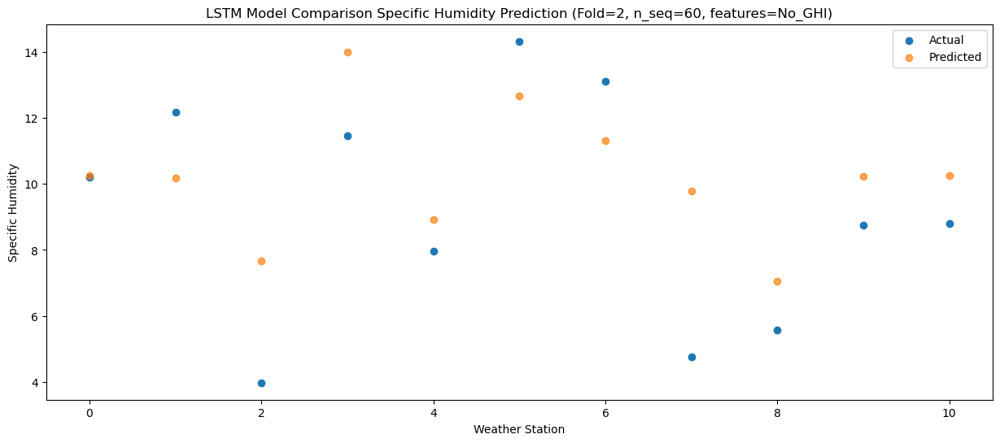

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30  11.307746
1                 1   13.79  11.221018
2                 2    4.38   8.714844
3                 3   14.05  15.035322
4                 4    8.99   9.958659
5                 5   13.28  13.702319
6                 6   13.93  12.353549
7                 7   10.00  10.844548
8                 8    6.73   8.095794
9                 9   10.26  11.269244
10               10   10.21  11.304126


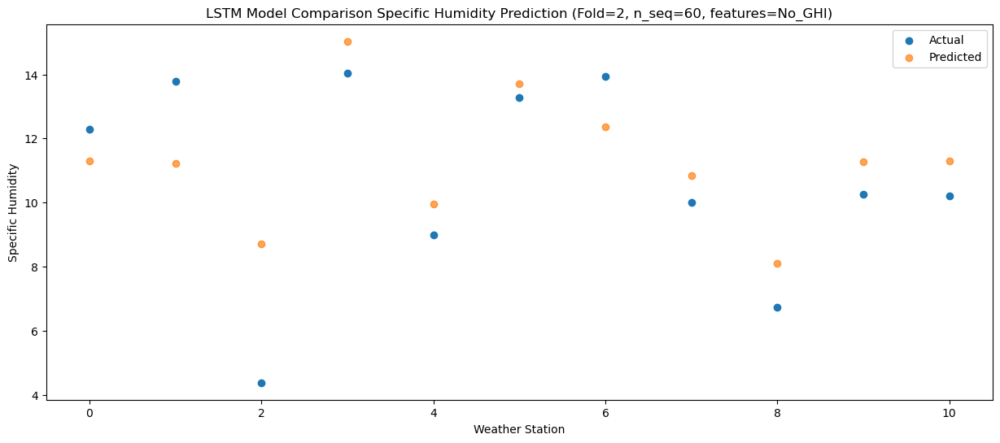

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00  11.715253
1                 1   12.17  11.628300
2                 2    5.00   9.120199
3                 3   14.79  15.442692
4                 4    8.59  10.364116
5                 5   13.41  14.106809
6                 6   14.31  12.758281
7                 7   10.29  11.245892
8                 8    6.13   8.494997
9                 9   10.84  11.671685
10               10   10.60  11.708093


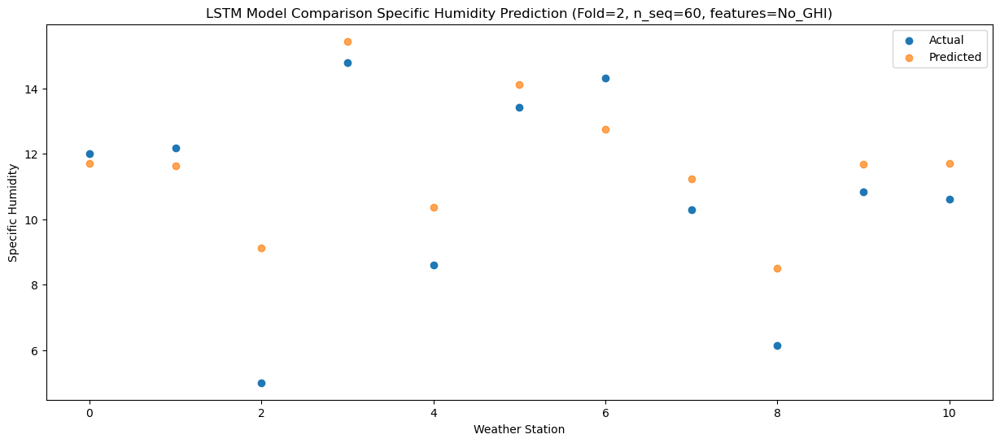

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   8.272437
1                 1    9.35   8.188987
2                 2    3.72   5.683638
3                 3   12.13  12.003000
4                 4    6.45   6.927292
5                 5    9.85  10.670382
6                 6    9.86   9.321360
7                 7    7.53   7.806238
8                 8    5.67   5.054333
9                 9    7.24   8.231364
10               10    7.39   8.268557


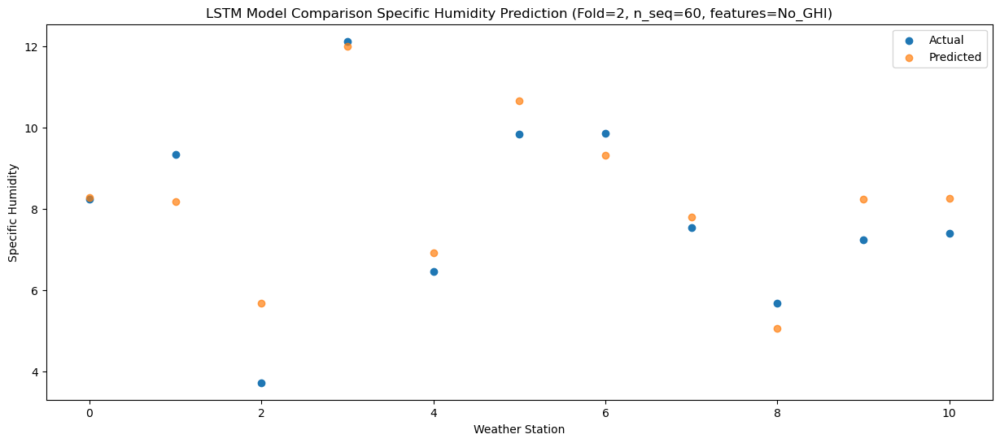

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78   6.246915
1                 1    5.96   6.161590
2                 2    1.06   3.657793
3                 3    9.17   9.976455
4                 4    3.92   4.900879
5                 5    8.26   8.644424
6                 6    7.25   7.295998
7                 7    3.82   5.777892
8                 8    2.87   3.028991
9                 9    5.08   6.206082
10               10    5.66   6.244363


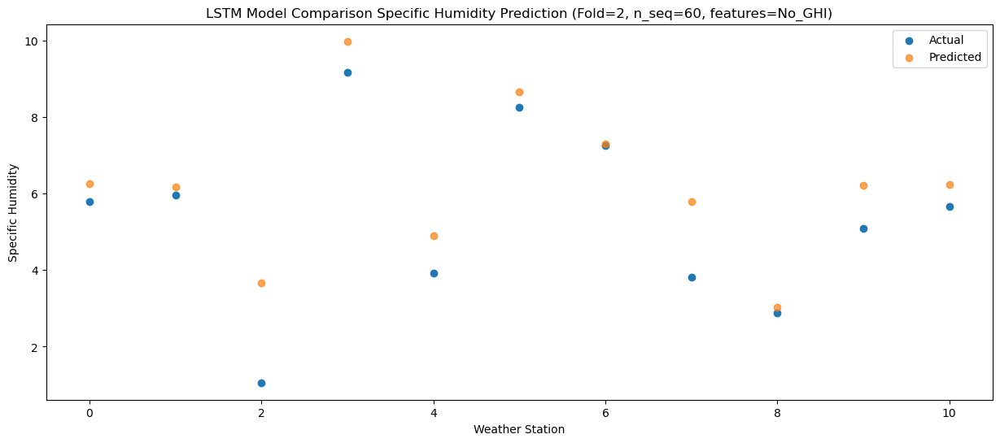

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59   1.390918
1                 1    3.53   1.308511
2                 2   -2.89  -1.195648
3                 3    4.72   5.117846
4                 4   -1.74   0.045751
5                 5    4.07   3.790644
6                 6    3.26   2.442713
7                 7    2.17   0.925995
8                 8    2.33  -1.823130
9                 9   -0.48   1.349622
10               10    0.30   1.385523


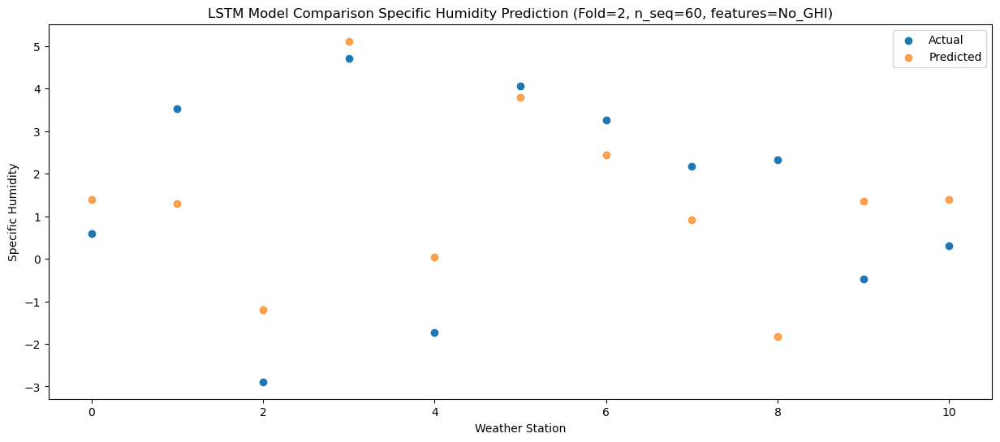

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99   2.443768
1                 1    2.47   2.354211
2                 2   -1.49  -0.149001
3                 3    4.36   6.163538
4                 4    1.54   1.094865
5                 5    6.94   4.840314
6                 6    5.76   3.493494
7                 7    2.30   1.969008
8                 8    2.15  -0.785785
9                 9    1.37   2.391543
10               10    1.86   2.431235


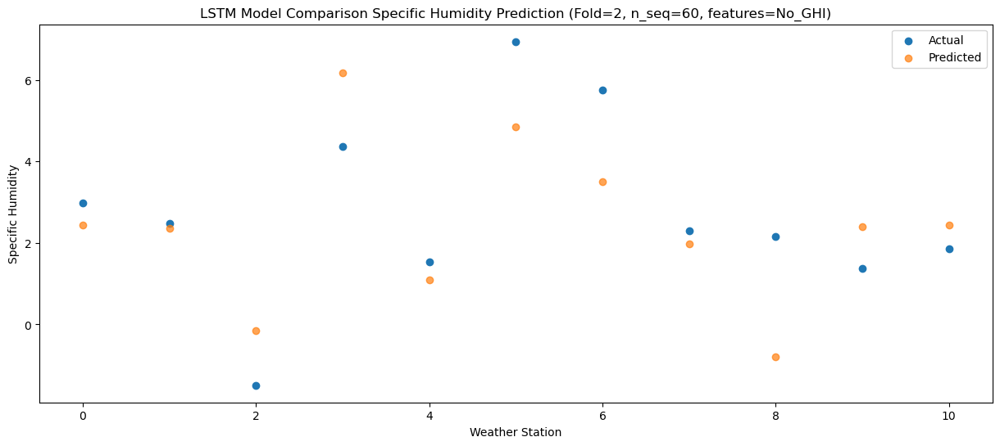

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -0.382172
1                 1    2.14  -0.472493
2                 2   -5.14  -2.976350
3                 3    3.03   3.339942
4                 4   -3.37  -1.731208
5                 5    1.31   2.013448
6                 6    0.47   0.666457
7                 7    2.02  -0.859319
8                 8    0.79  -3.613263
9                 9   -1.41  -0.435034
10               10   -0.56  -0.392881


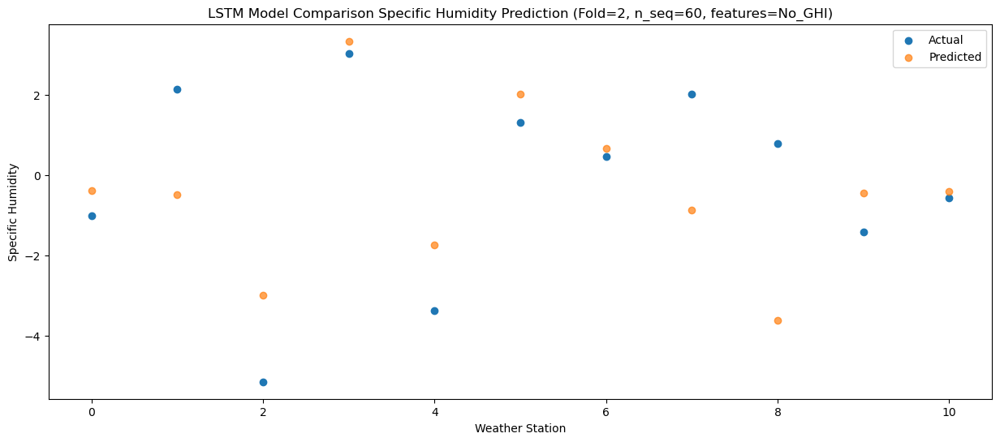

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34   0.260456
1                 1    2.05   0.172433
2                 2   -3.95  -2.330218
3                 3    3.60   3.984260
4                 4   -1.91  -1.085472
5                 5    1.53   2.659835
6                 6    0.94   1.313627
7                 7    1.03  -0.213436
8                 8    0.05  -2.966185
9                 9   -0.10   0.209065
10               10    0.34   0.249974


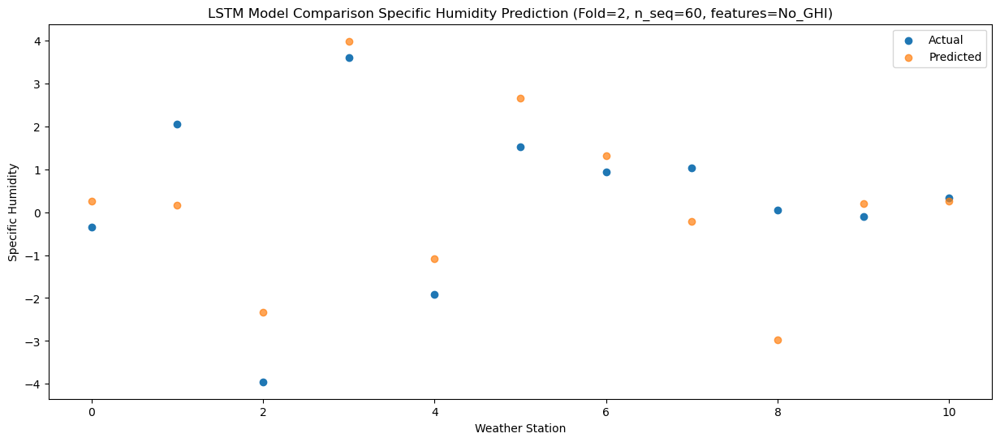

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09   1.616241
1                 1    2.93   1.528151
2                 2   -2.14  -0.972304
3                 3    4.36   5.341337
4                 4   -1.06   0.276197
5                 5    3.15   4.021464
6                 6    2.57   2.674110
7                 7    1.43   1.145974
8                 8    1.79  -1.608132
9                 9    0.86   1.566109
10               10    0.96   1.608489


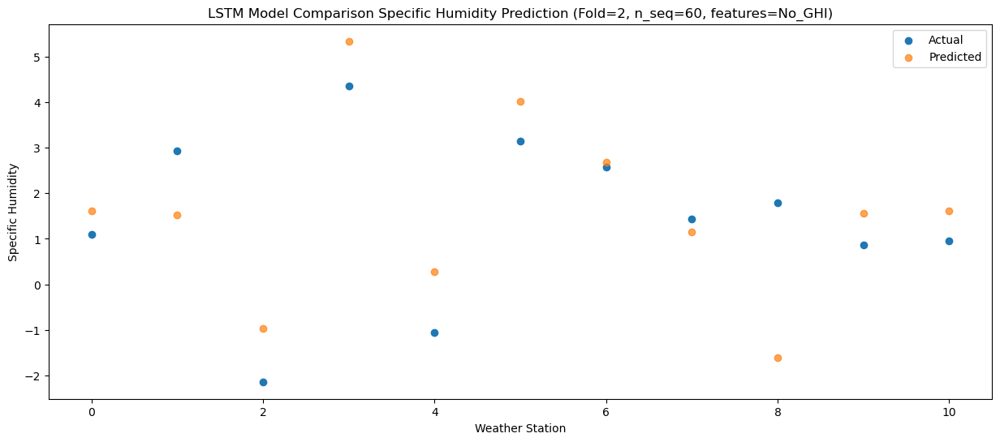

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   3.137579
1                 1    4.08   3.045133
2                 2   -0.78   0.546050
3                 3    5.06   6.859408
4                 4    1.37   1.796067
5                 5    7.11   5.539954
6                 6    6.47   4.190970
7                 7    1.44   2.658286
8                 8    2.63  -0.100047
9                 9    1.90   3.078758
10               10    2.23   3.124829


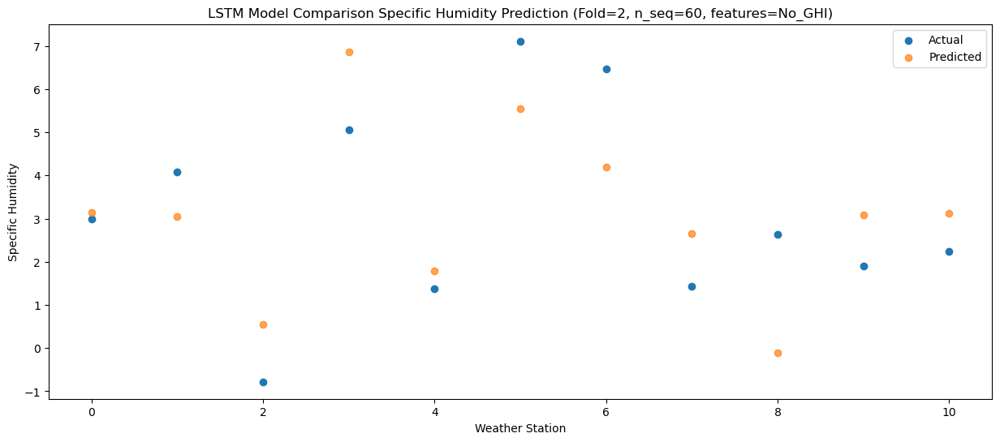

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   7.189577
1                 1    6.47   7.094589
2                 2    2.32   4.598105
3                 3    8.36  10.910811
4                 4    5.40   5.850453
5                 5   10.76   9.595510
6                 6   10.56   8.246091
7                 7    1.37   6.706649
8                 8    3.89   3.946879
9                 9    6.22   7.128664
10               10    6.39   7.176724


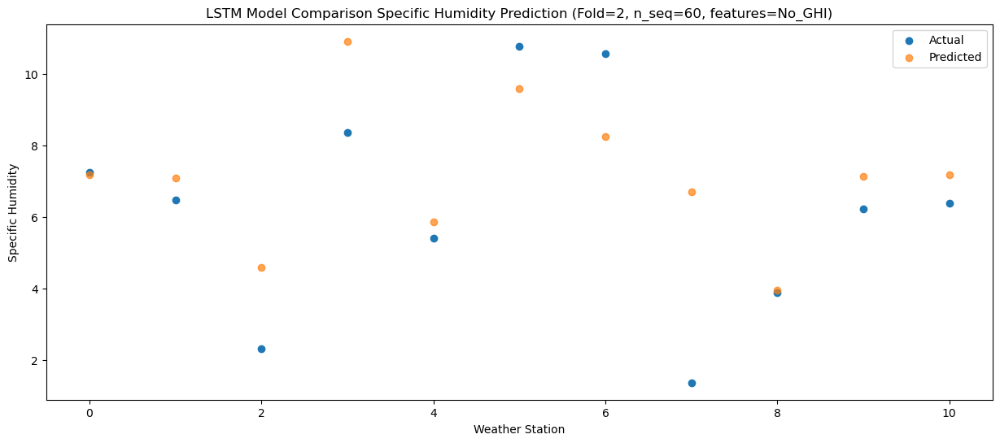

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30   9.039312
1                 1   10.83   8.948132
2                 2    4.25   6.453615
3                 3   10.62  12.765368
4                 4    7.70   7.704896
5                 5   11.79  11.450767
6                 6   11.36  10.099231
7                 7    6.87   8.560137
8                 8    5.66   5.802420
9                 9    8.02   8.982776
10               10    8.35   9.032462


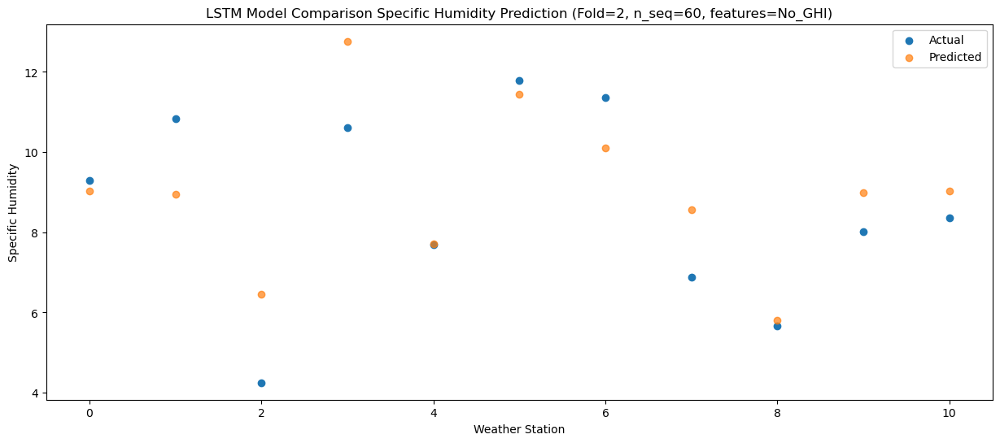

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52  11.489649
1                 1   12.17  11.397622
2                 2    5.08   8.904212
3                 3   13.98  15.213690
4                 4    8.99  10.156508
5                 5   12.89  13.901100
6                 6   10.68  12.549379
7                 7    9.43  11.009698
8                 8    6.55   8.250826
9                 9   11.60  11.431364
10               10   11.56  11.482309


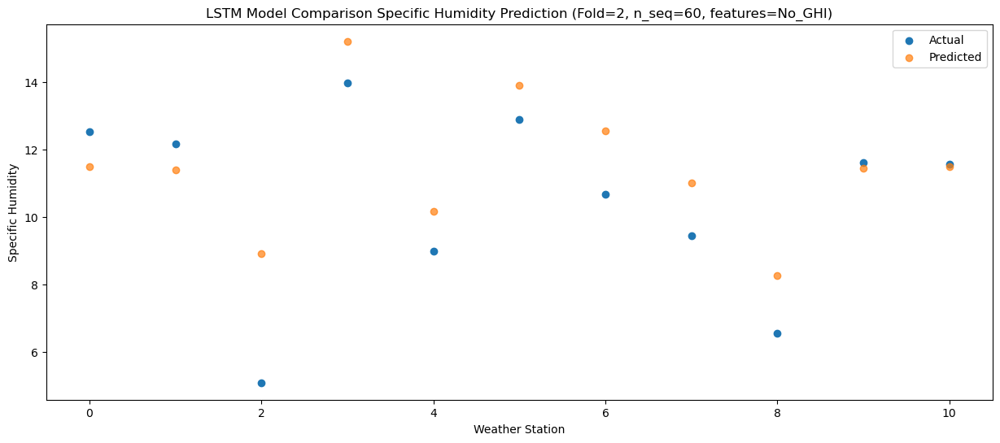

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04  10.948078
1                 1   11.67  10.861584
2                 2    4.97   8.368685
3                 3   14.66  14.677707
4                 4    9.39   9.618644
5                 5   13.35  13.363752
6                 6   11.74  12.011178
7                 7   11.40  10.474016
8                 8    6.65   7.717950
9                 9   10.03  10.896347
10               10   10.57  10.947318


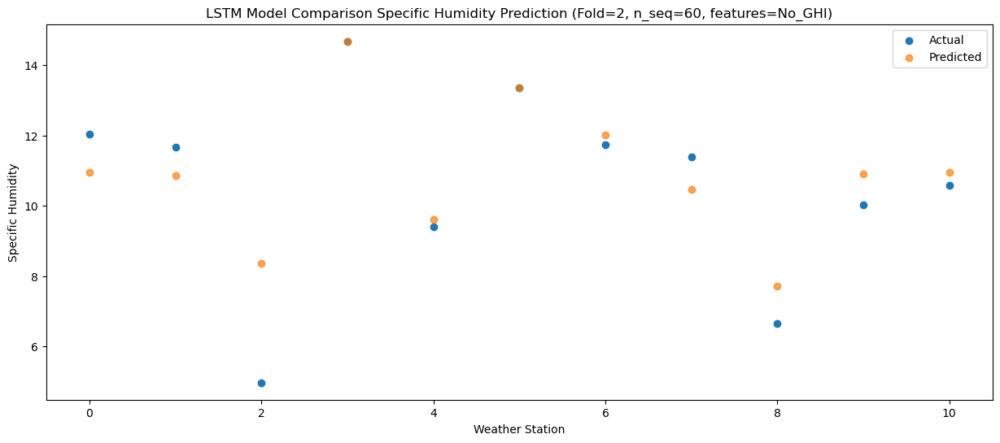

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29   7.732447
1                 1    9.10   7.643419
2                 2    4.82   5.150790
3                 3   10.86  11.464854
4                 4    5.88   6.404294
5                 5    9.99  10.148242
6                 6    9.07   8.794553
7                 7    8.36   7.258170
8                 8    7.50   4.500455
9                 9    6.60   7.680391
10               10    7.09   7.731890


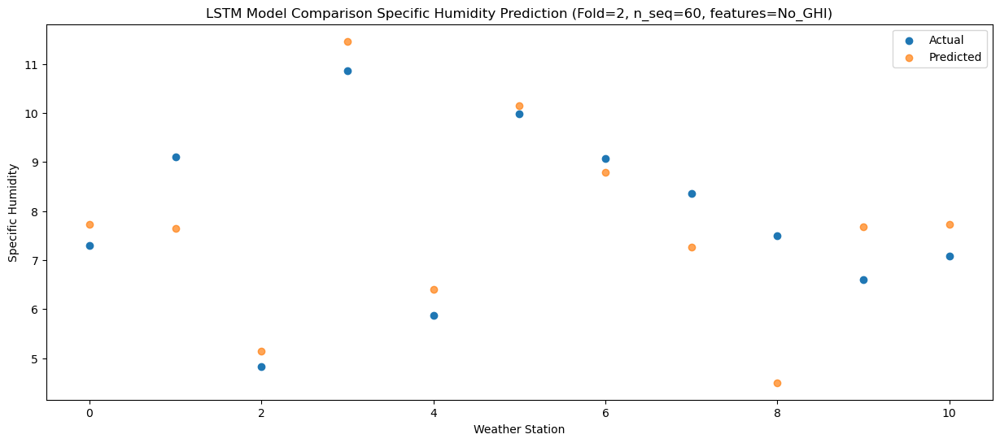

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57   3.194733
1                 1    5.42   3.110342
2                 2    0.43   0.621638
3                 3    7.99   6.934862
4                 4    0.70   1.874391
5                 5    5.17   5.618939
6                 6    4.29   4.266693
7                 7    6.28   2.733370
8                 8    5.73  -0.020926
9                 9    2.24   3.153885
10               10    2.43   3.202608


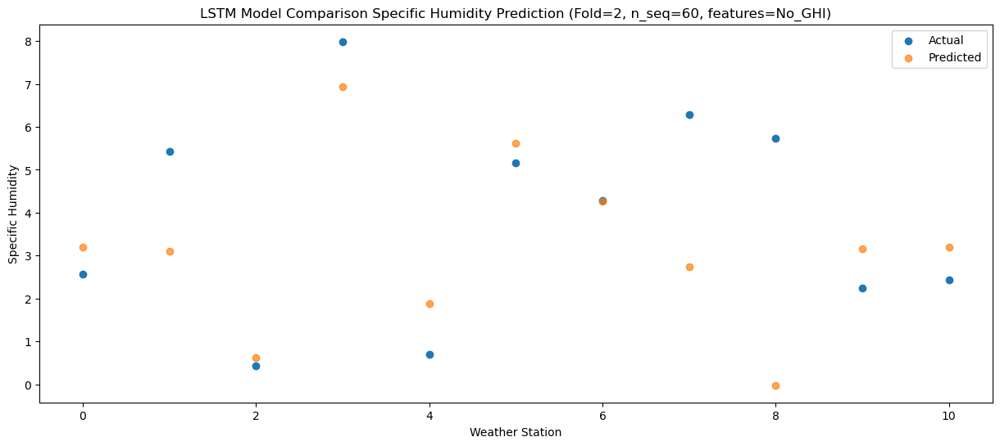

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63   2.236042
1                 1    3.92   2.151920
2                 2    0.32  -0.330077
3                 3    6.17   5.976937
4                 4    0.26   0.919309
5                 5    5.03   4.664308
6                 6    3.84   3.311500
7                 7    2.31   1.777736
8                 8    1.09  -0.975339
9                 9    1.77   2.198089
10               10    1.81   2.247069


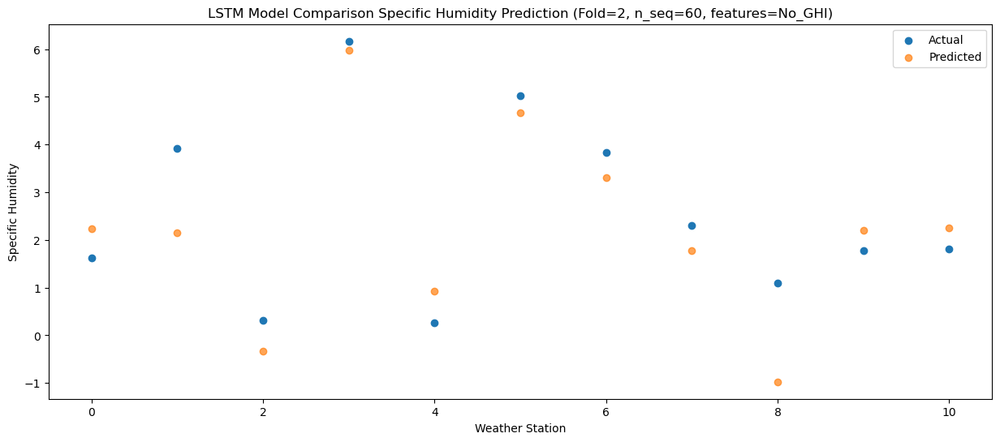

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00   0.752821
1                 1    2.73   0.673253
2                 2   -3.34  -1.809610
3                 3    4.08   4.498081
4                 4   -0.29  -0.559614
5                 5    4.12   3.189049
6                 6    2.67   1.837218
7                 7    3.13   0.304716
8                 8    1.94  -2.446441
9                 9   -0.47   0.721525
10               10    0.72   0.768076


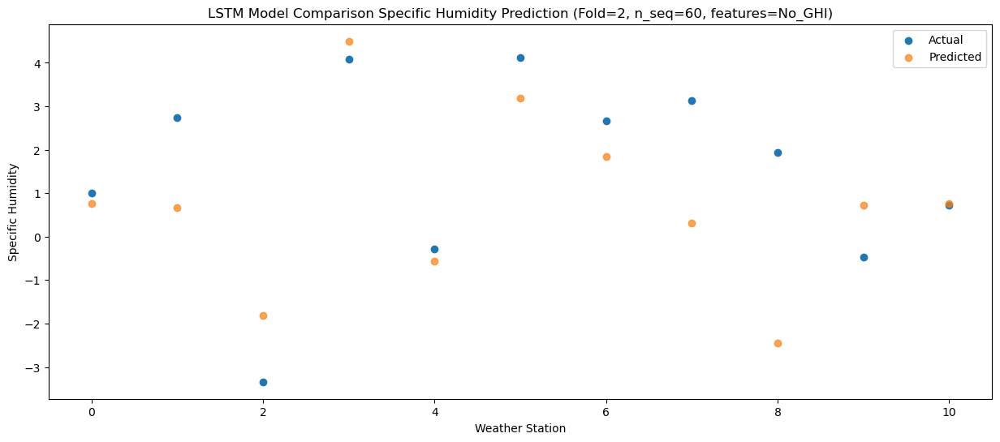

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41   1.158163
1                 1    2.72   1.082370
2                 2   -3.72  -1.405217
3                 3    4.59   4.908312
4                 4   -0.38  -0.153961
5                 5    3.74   3.595534
6                 6    1.89   2.245308
7                 7    2.24   0.715731
8                 8    2.03  -2.034405
9                 9    0.39   1.130952
10               10    0.99   1.175163


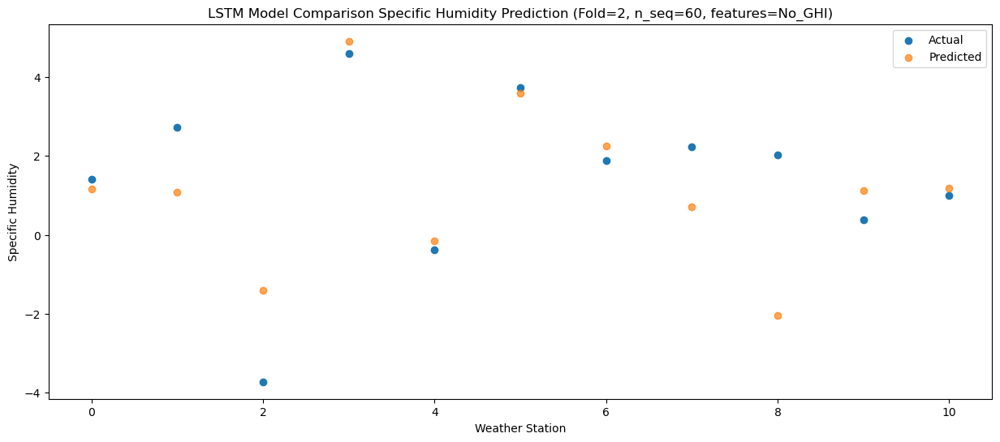

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63   1.227093
1                 1    2.64   1.154031
2                 2   -1.87  -1.331440
3                 3    3.83   4.981587
4                 4    0.92  -0.078687
5                 5    4.19   3.673623
6                 6    2.29   2.321065
7                 7    2.12   0.790668
8                 8    0.62  -1.956715
9                 9    1.15   1.206228
10               10    1.39   1.249836


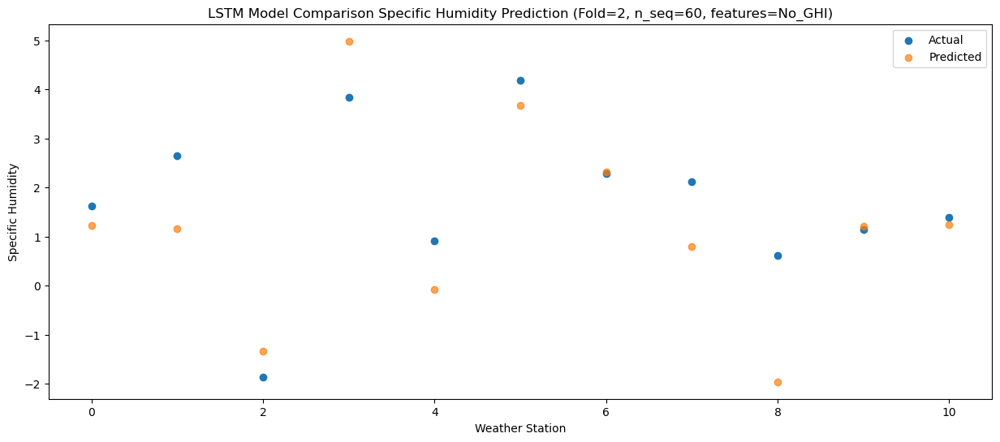

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98   1.684267
1                 1    3.33   1.611782
2                 2   -1.48  -0.872527
3                 3    4.08   5.441573
4                 4    1.80   0.380157
5                 5    5.97   4.133302
6                 6    4.20   2.781191
7                 7    2.46   1.245837
8                 8    2.54  -1.501344
9                 9    0.84   1.665129
10               10    0.99   1.710700


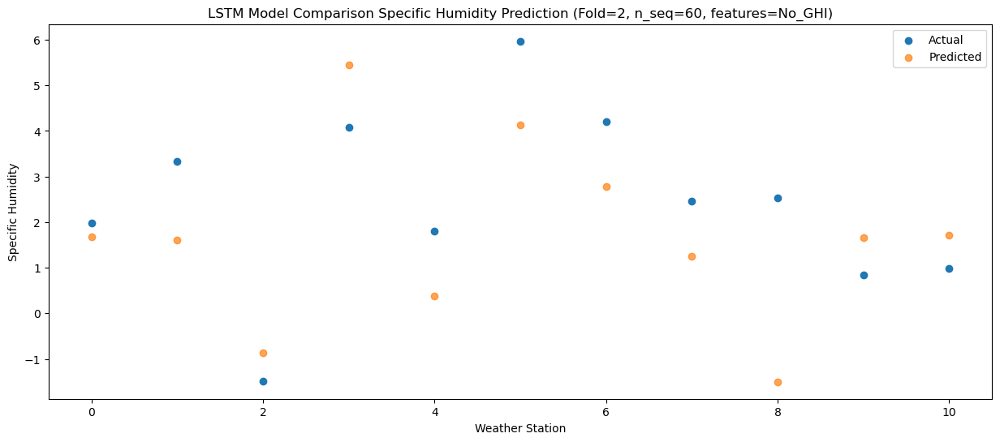

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92   3.104546
1                 1    3.95   3.029770
2                 2    0.03   0.544219
3                 3    6.16   6.863175
4                 4    2.35   1.799464
5                 5    6.52   5.554025
6                 6    4.87   4.202318
7                 7    1.62   2.664830
8                 8    3.24  -0.084291
9                 9    2.97   3.084130
10               10    2.63   3.129560


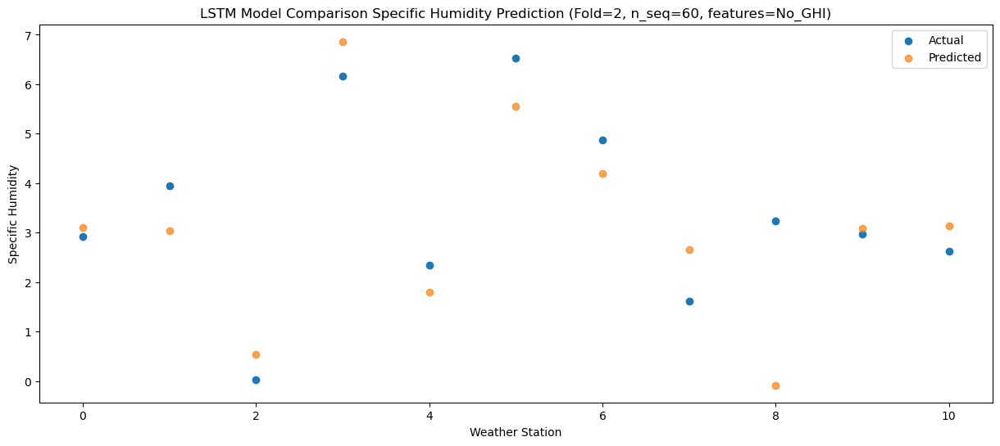

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   5.791607
1                 1    9.73   5.717932
2                 2    0.84   3.229453
3                 3    6.97   9.546603
4                 4    5.41   4.487170
5                 5   10.22   8.243889
6                 6    8.76   6.893384
7                 7    3.62   5.353086
8                 8    4.64   2.602289
9                 9    4.50   5.768076
10               10    5.22   5.812917


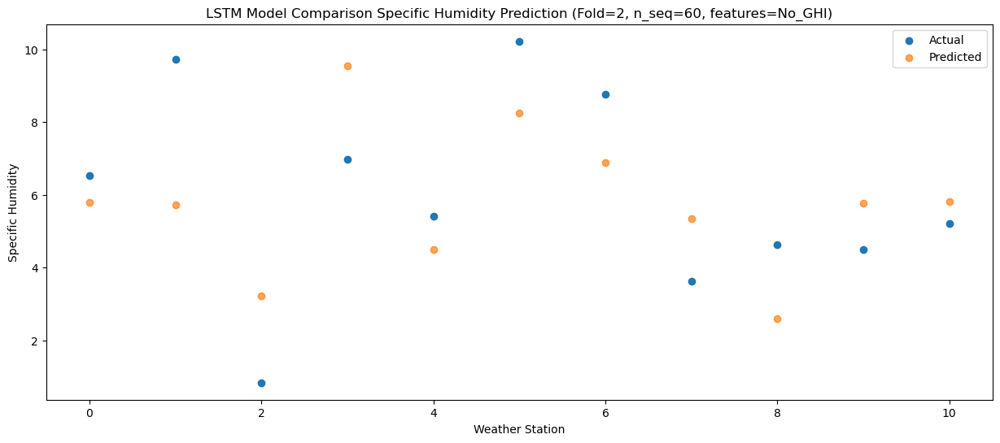

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50   8.457360
1                 1   12.38   8.384053
2                 2    4.00   5.898273
3                 3   10.87  12.216517
4                 4    8.72   7.156773
5                 5   13.68  10.912022
6                 6   12.66   9.560180
7                 7    3.42   8.016114
8                 8    5.02   5.266011
9                 9    7.36   8.434002
10               10    7.06   8.481057


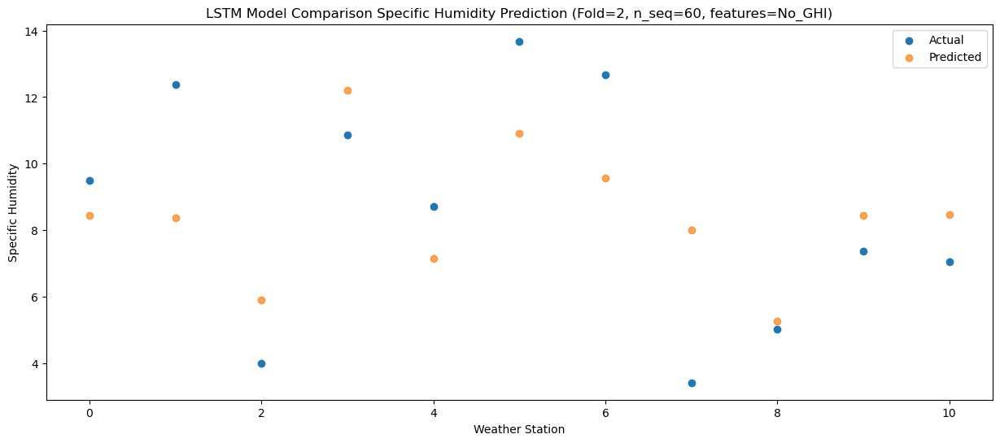

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68  11.347908
1                 1   14.44  11.267076
2                 2    4.97   8.784737
3                 3   15.13  15.105949
4                 4   10.06  10.045506
5                 5   13.39  13.800359
6                 6   11.95  12.448238
7                 7    6.77  10.901868
8                 8    6.36   8.150717
9                 9   11.20  11.324047
10               10   10.37  11.374549


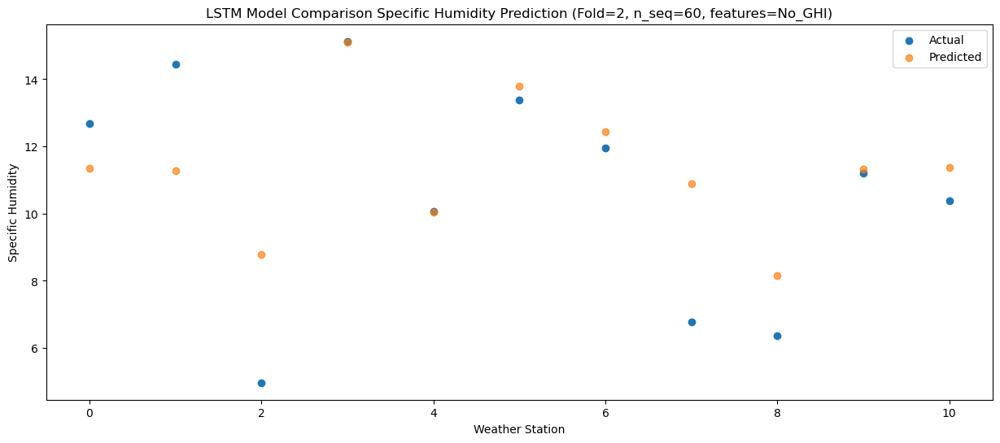

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03  10.716984
1                 1   12.55  10.633994
2                 2    5.69   8.154838
3                 3   12.79  14.474111
4                 4   10.09   9.415326
5                 5   11.96  13.169244
6                 6    9.90  11.816601
7                 7    8.96  10.269102
8                 8    6.97   7.519009
9                 9   10.71  10.693464
10               10   10.48  10.744516


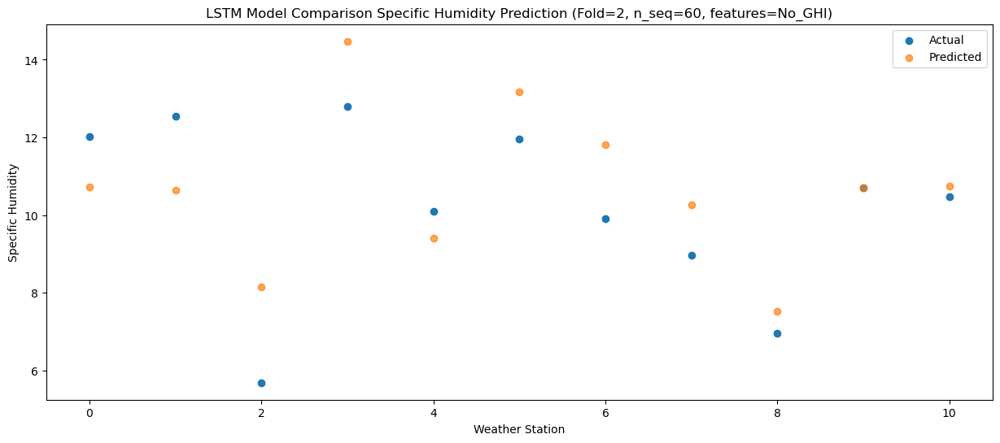

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00   8.226302
1                 1    9.96   8.141694
2                 2    3.30   5.662524
3                 3   11.78  11.983864
4                 4    7.74   6.924506
5                 5   11.41  10.680952
6                 6    9.27   9.328726
7                 7    7.15   7.780471
8                 8    6.72   5.030089
9                 9    7.57   8.203966
10               10    8.06   8.253173


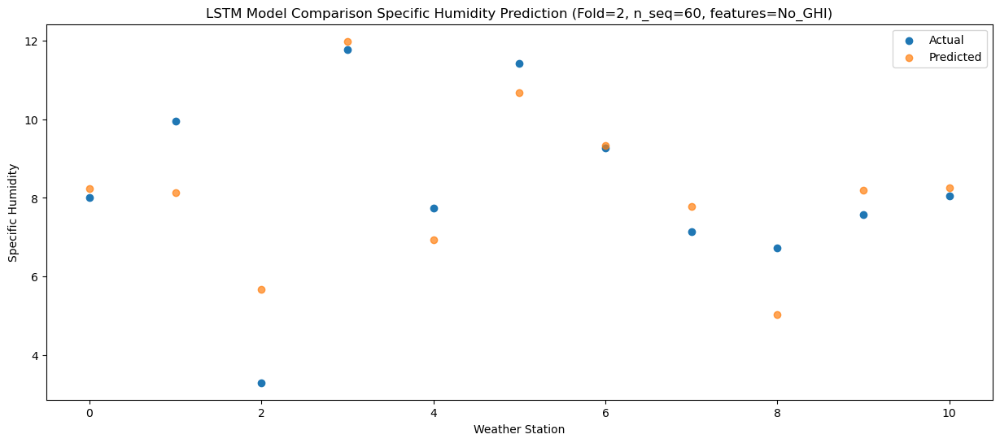

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   4.601473
1                 1    6.50   4.519031
2                 2    0.38   2.038412
3                 3    8.42   8.362559
4                 4    2.51   3.302854
5                 5    7.88   7.060601
6                 6    6.12   5.708671
7                 7    4.70   4.161942
8                 8    4.42   1.410939
9                 9    3.38   4.583209
10               10    3.95   4.632429


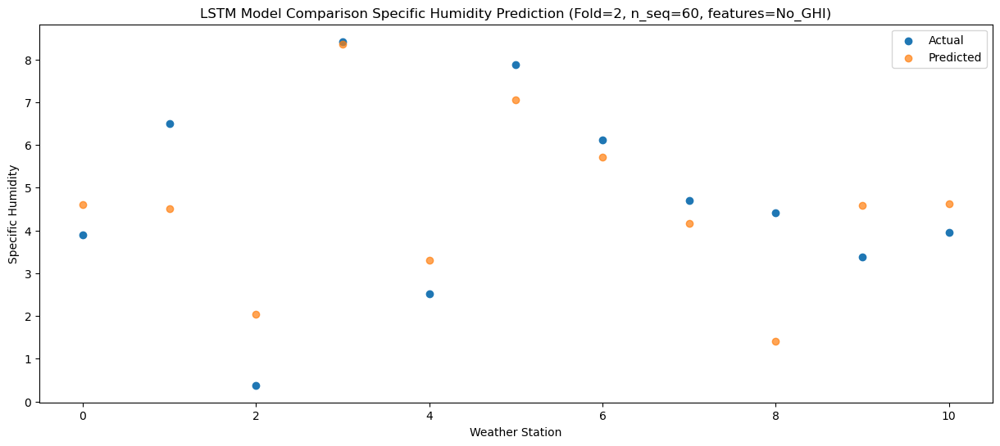

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26   1.728149
1                 1    3.94   1.641614
2                 2   -2.12  -0.839290
3                 3    4.59   5.483714
4                 4   -0.01   0.426186
5                 5    4.71   4.184336
6                 6    3.50   2.831707
7                 7    3.78   1.279645
8                 8    1.39  -1.473597
9                 9    0.27   1.698954
10               10    1.00   1.748520


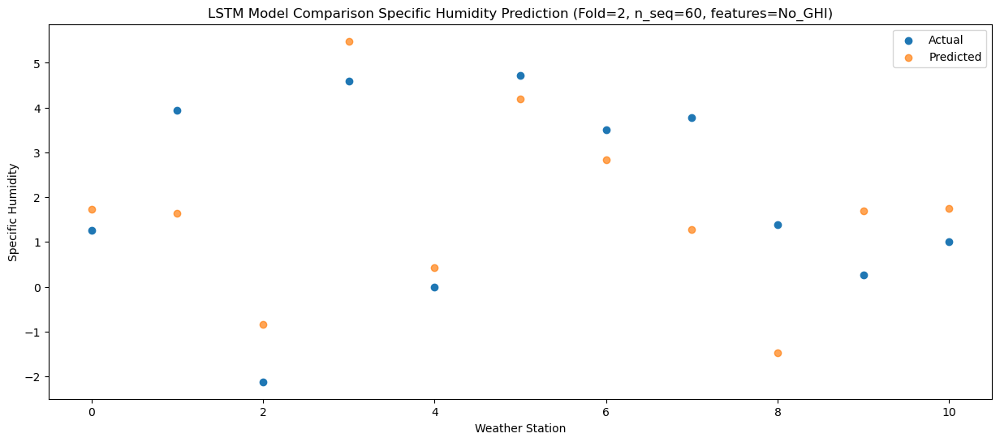

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34   1.324180
1                 1    3.55   1.233939
2                 2   -2.69  -1.248479
3                 3    4.88   5.076162
4                 4   -1.60   0.017961
5                 5    2.78   3.775611
6                 6    1.68   2.422718
7                 7    2.26   0.869002
8                 8    2.18  -1.886680
9                 9    0.18   1.289460
10               10    0.79   1.342667


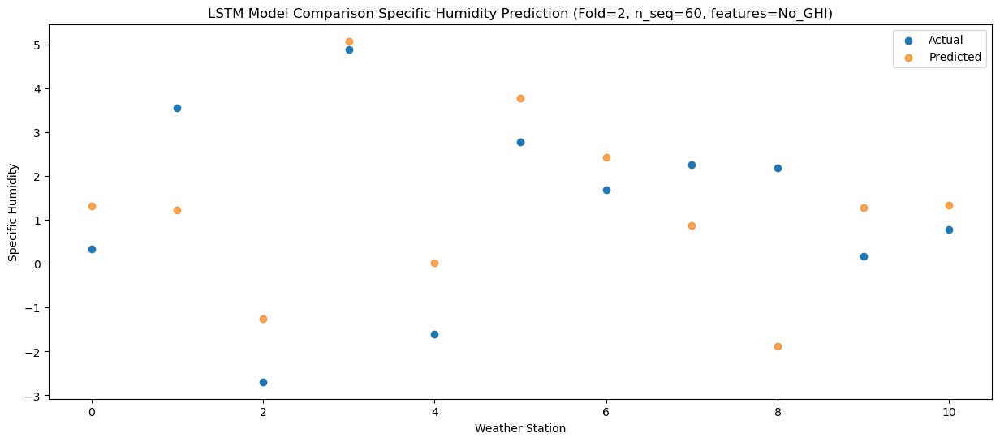

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55   0.232738
1                 1    2.96   0.140465
2                 2   -3.76  -2.339396
3                 3    3.55   3.985549
4                 4   -2.47  -1.073953
5                 5    1.77   2.681063
6                 6    0.56   1.326323
7                 7    2.68  -0.227428
8                 8    2.15  -2.983591
9                 9   -0.51   0.197443
10               10    0.17   0.251973


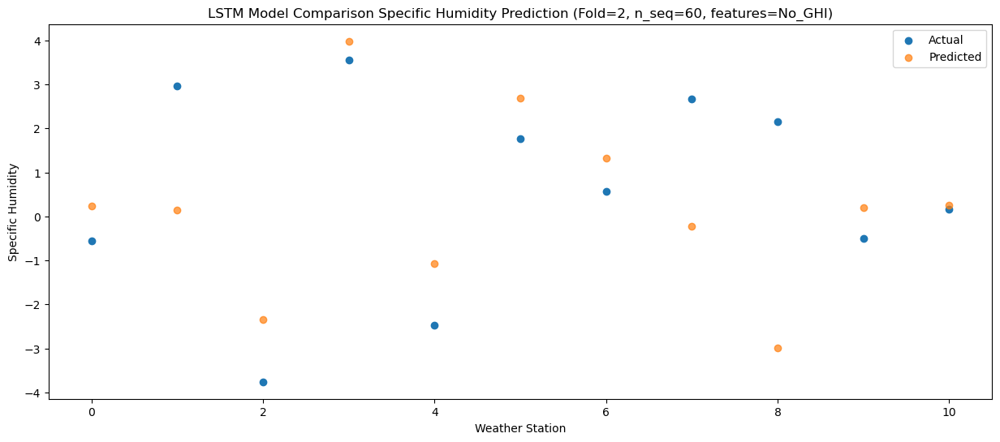

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32   1.181002
1                 1    3.78   1.087572
2                 2   -4.18  -1.392826
3                 3    3.50   4.932077
4                 4   -1.41  -0.129442
5                 5    4.17   3.623317
6                 6    3.03   2.268321
7                 7    2.70   0.715813
8                 8    3.12  -2.040636
9                 9   -0.37   1.142227
10               10    0.57   1.198394


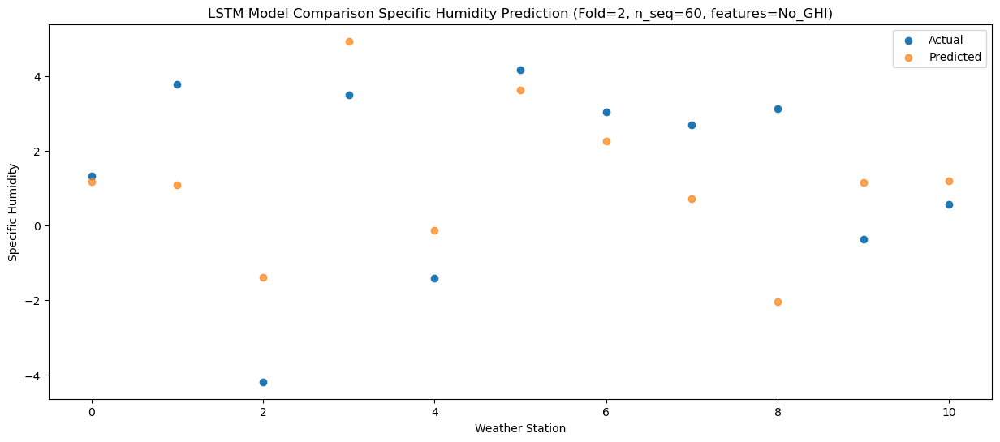

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14   2.300987
1                 1    4.03   2.202450
2                 2   -1.02  -0.275592
3                 3    4.55   6.048266
4                 4    0.19   0.990491
5                 5    5.81   4.745018
6                 6    4.65   3.388665
7                 7    2.92   1.828959
8                 8    1.56  -0.932362
9                 9    1.04   2.257265
10               10    1.67   2.316519


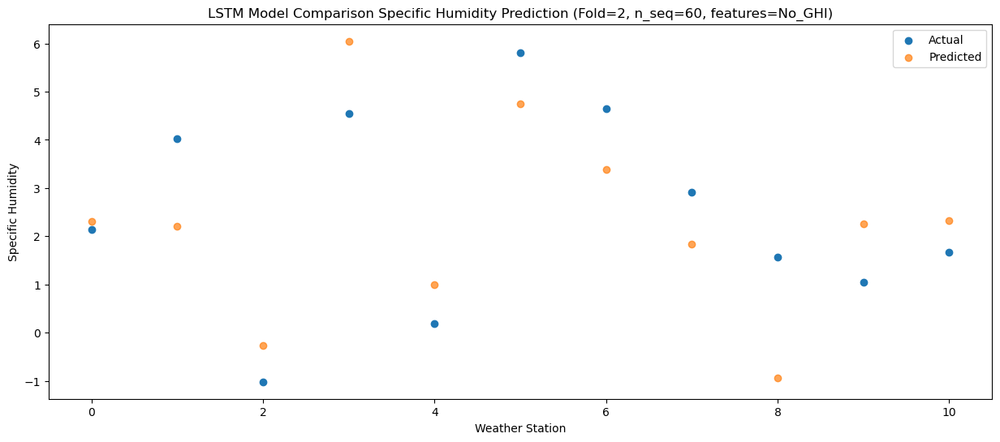

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35   4.179077
1                 1    4.99   4.078185
2                 2   -2.23   1.601588
3                 3    5.44   7.926375
4                 4    2.26   2.868842
5                 5    8.09   6.623917
6                 6    6.85   5.266032
7                 7    2.25   3.702844
8                 8    0.66   0.940698
9                 9    3.26   4.131137
10               10    3.78   4.191629


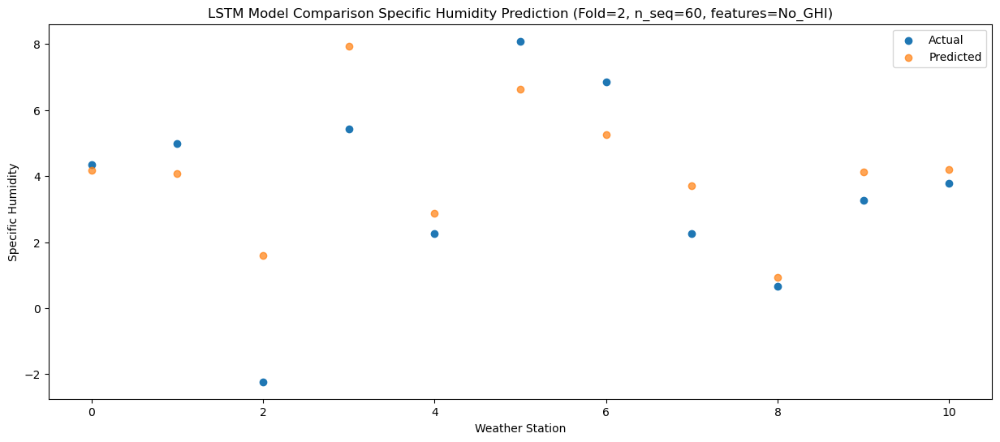

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61   7.730021
1                 1    8.02   7.626827
2                 2    2.63   5.146239
3                 3    8.62  11.471981
4                 4    6.69   6.415521
5                 5   12.19  10.169636
6                 6   10.63   8.810089
7                 7    1.94   7.243007
8                 8    4.76   4.478312
9                 9    7.14   7.672848
10               10    7.64   7.736096


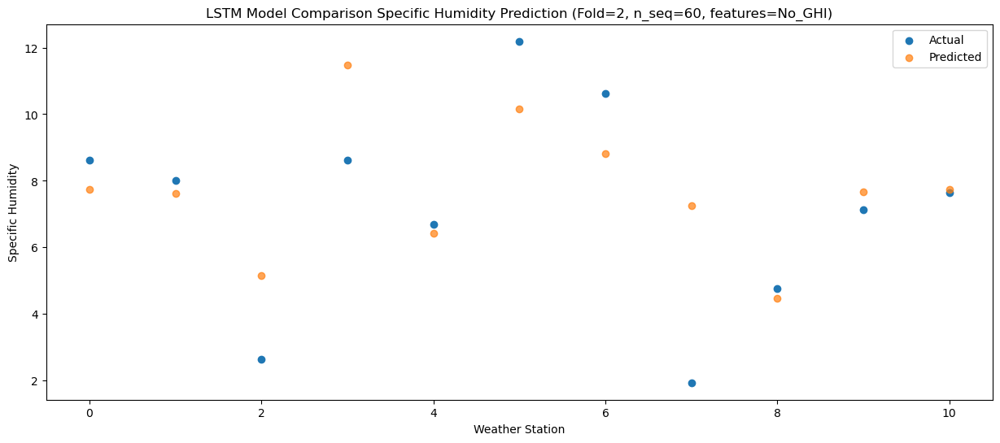

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58   9.870608
1                 1   14.03   9.767201
2                 2    4.69   7.284143
3                 3   11.54  13.611862
4                 4    8.66   8.554885
5                 5   13.85  12.310724
6                 6   12.22  10.950367
7                 7    5.99   9.383089
8                 8    6.36   6.616750
9                 9    9.01   9.811649
10               10    9.19   9.875947


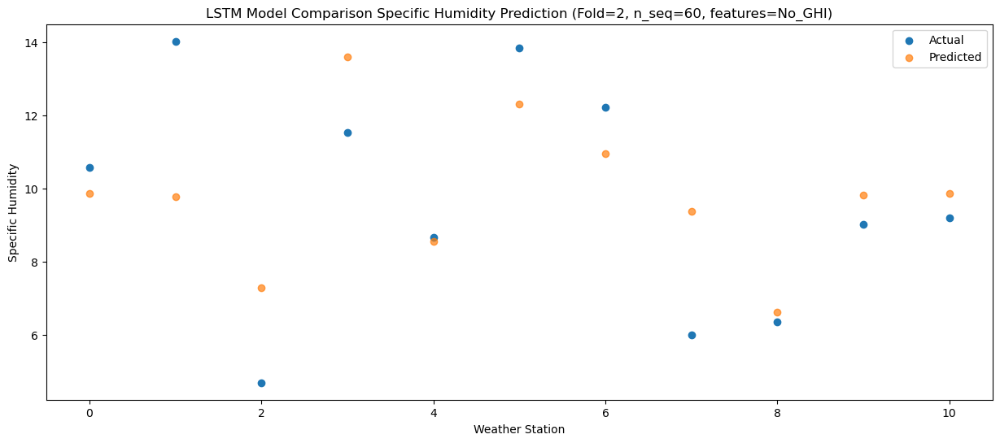

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05  11.231677
1                 1   12.58  11.126965
2                 2    5.74   8.644699
3                 3   14.71  14.974170
4                 4   10.30   9.916130
5                 5   14.15  13.670522
6                 6   12.45  12.307869
7                 7    9.59  10.742084
8                 8    7.59   7.975463
9                 9   11.62  11.170517
10               10   11.23  11.237186


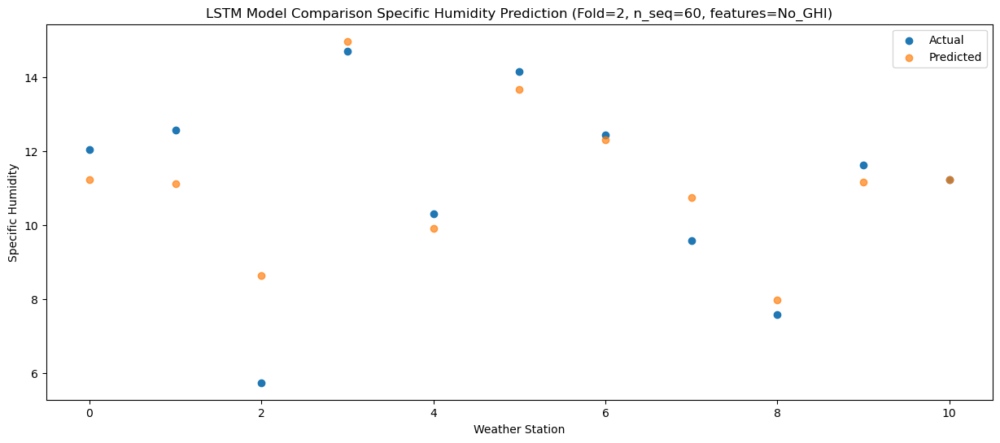

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05  10.514145
1                 1   13.56  10.410302
2                 2    6.34   7.929308
3                 3   13.21  14.256402
4                 4    9.13   9.201144
5                 5   14.19  12.953110
6                 6   12.27  11.590494
7                 7    9.27  10.023814
8                 8    6.77   7.254942
9                 9   10.36  10.454130
10               10   10.22  10.520351


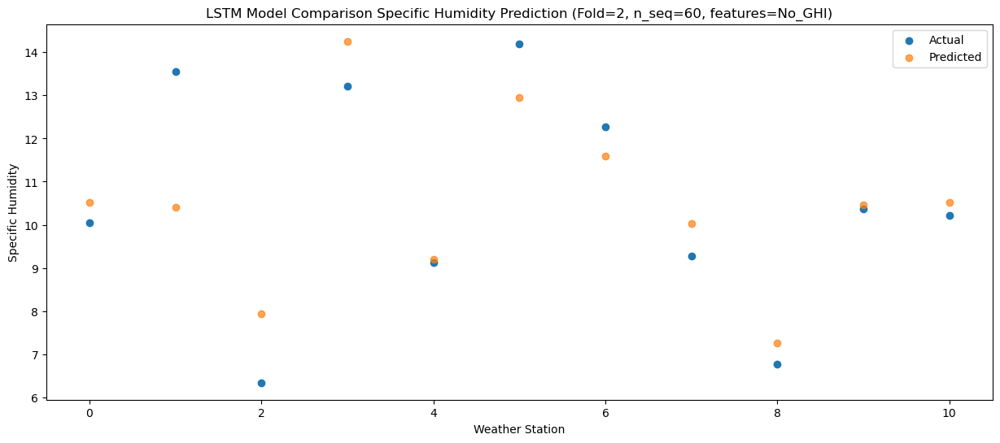

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   8.324358
1                 1    9.61   8.224294
2                 2    6.77   5.744470
3                 3   10.32  12.073131
4                 4    7.53   7.017103
5                 5   11.70  10.771285
6                 6    9.37   9.408327
7                 7    6.53   7.844493
8                 8    6.38   5.081443
9                 9    8.51   8.274094
10               10    8.12   8.339093


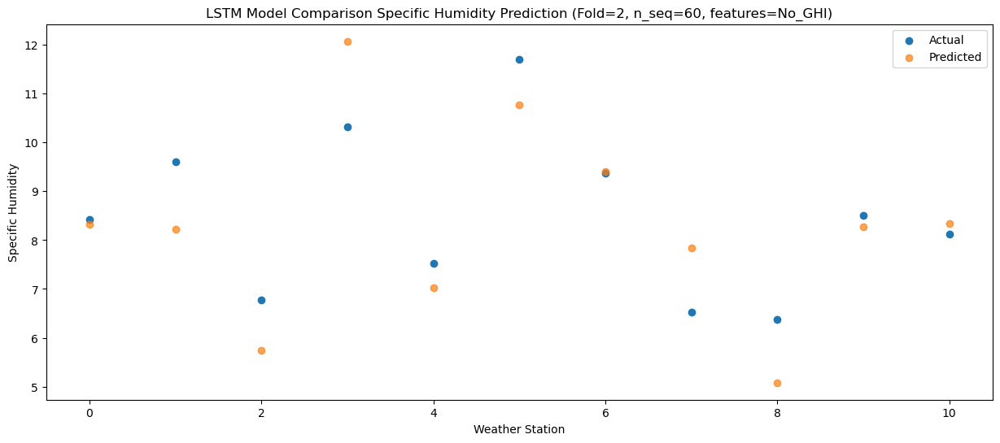

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05   4.261929
1                 1    6.75   4.164907
2                 2    1.79   1.679853
3                 3    7.08   8.010689
4                 4    2.67   2.950142
5                 5    7.38   6.702260
6                 6    5.95   5.342481
7                 7    3.64   3.782838
8                 8    4.48   1.022228
9                 9    3.89   4.212331
10               10    4.05   4.275802


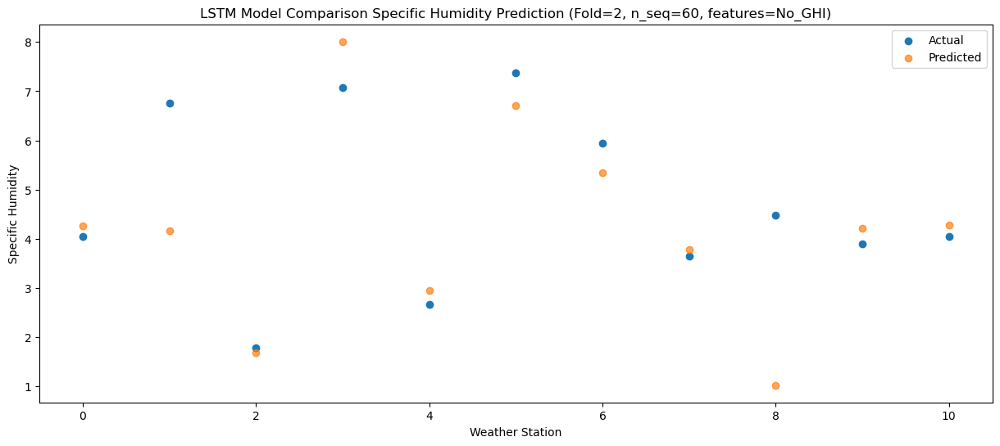

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

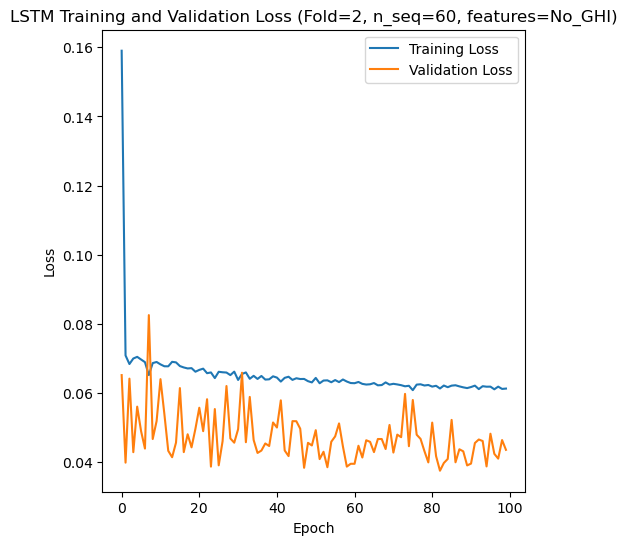

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 45s 251ms/step - loss: 0.1663 - accuracy: 0.3214 - mae: 0.1361 - rmse: 0.1663 - mape: 29.3845 - pearson: 0.6231 - val_loss: 0.0664 - val_accuracy: 0.3000 - val_mae: 0.0516 - val_rmse: 0.0664 - val_mape: 11.4243 - val_pearson: 0.7124
Epoch 2/100
84/84 [==============================] - 14s 170ms/step - loss: 0.0680 - accuracy: 0.3810 - mae: 0.0532 - rmse: 0.0680 - mape: 12.1396 - pearson: 0.7862 - val_loss: 0.0816 - val_accuracy: 0.0000e+00 - val_mae: 0.0647 - val_rmse: 0.0816 - val_mape: 14.0708 - val_pearson: 0.6035
Epoch 3/100
84/84 [==============================] - 15s 183ms/step - loss: 0.0679 - accuracy: 0.3929 - mae: 0.0533 - rmse: 0.0679 - mape: 12.2252 - pearson: 0.

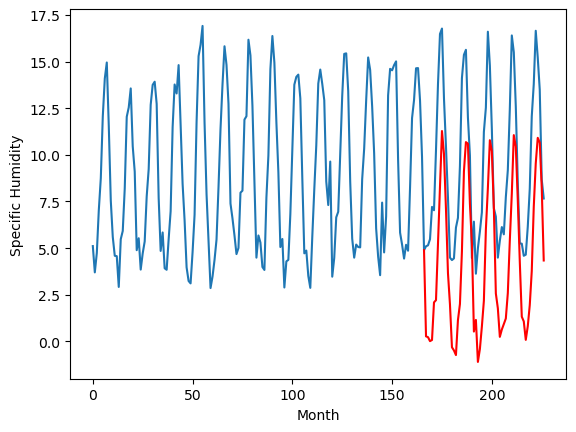

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		1.67		-0.57
1.83		1.63		-0.20
1.80		1.42		-0.38
1.44		1.48		0.04
4.04		3.50		-0.54
4.19		3.62		-0.57
7.16		6.64		-0.52
10.69		9.70		-0.99
13.43		12.69		-0.74
10.76		11.46		0.70
9.32		8.50		-0.82
4.75		5.06		0.31
3.25		3.39		0.14
1.21		1.09		-0.12
1.12		0.93		-0.19
0.56		0.68		0.12
3.07		2.56		-0.51
4.24		3.42		-0.82
7.76		6.26		-1.50
12.29		10.53		-1.76
13.17		12.10		-1.07
13.34		12.02		-1.32
9.37		8.81		-0.56
7.18		6.65		-0.53
2.75		1.95		-0.80
3.72		2.58		-1.14
0.53		0.33		-0.20
0.90		1.02		0.12
2.37		2.23		-0.14
4.67		3.61		-1.06
9.12		7.42		-1.70
11.74		9.63		-2.11
11.95		12.21		0.26
12.56		11.61		-0.95
8.71		8.57		-0.14
4.25		3.99		-0.26
3.22		3.20		-0.02
2.03		1.67		-0.36
1.95		2.06		0.11
2.11		2.36		0.25
3.05		2.66		-0.39
3.92		4.03		0.11
8.33		6.84		-1.49
10.97		9.36		-1.61
13.24		12.49		-0.75
13.48		11.88		-1.60
9.41		8.99		-0.42
5.97		5.71		-0.26
3.09		2.76		-0.33
2.27		2.50		

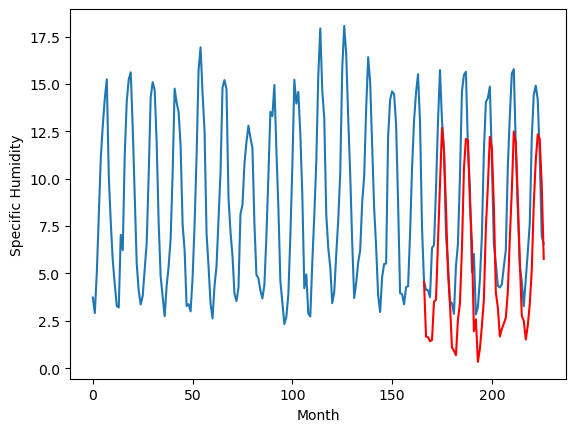

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		0.30		-3.49
4.33		0.26		-4.07
3.95		0.05		-3.90
3.26		0.11		-3.15
4.34		2.13		-2.21
5.71		2.24		-3.47
5.52		5.27		-0.25
7.06		8.32		1.26
7.28		11.30		4.02
8.80		10.07		1.27
8.32		7.12		-1.20
6.44		3.69		-2.75
3.75		2.02		-1.73
3.15		-0.28		-3.43
3.59		-0.45		-4.04
3.53		-0.70		-4.23
3.61		1.17		-2.44
4.23		2.04		-2.19
4.63		4.88		0.25
7.08		9.15		2.07
7.78		10.71		2.93
7.31		10.63		3.32
6.02		7.42		1.40
4.88		5.26		0.38
5.46		0.57		-4.89
3.96		1.19		-2.77
3.68		-1.06		-4.74
2.90		-0.37		-3.27
4.24		0.84		-3.40
3.91		2.22		-1.69
4.09		6.03		1.94
5.26		8.24		2.98
6.43		10.82		4.39
7.22		10.22		3.00
6.93		7.18		0.25
5.76		2.61		-3.15
3.04		1.81		-1.23
3.88		0.28		-3.60
4.03		0.67		-3.36
2.90		0.96		-1.94
4.42		1.26		-3.16
4.62		2.63		-1.99
5.56		5.44		-0.12
6.33		7.96		1.63
7.43		11.09		3.66
8.50		10.48		1.98
6.96		7.59		0.63
5.80		4.30		-1.50
3.69		1.36		-2.33
3.92		1.10		-2.82
4.46		0.11

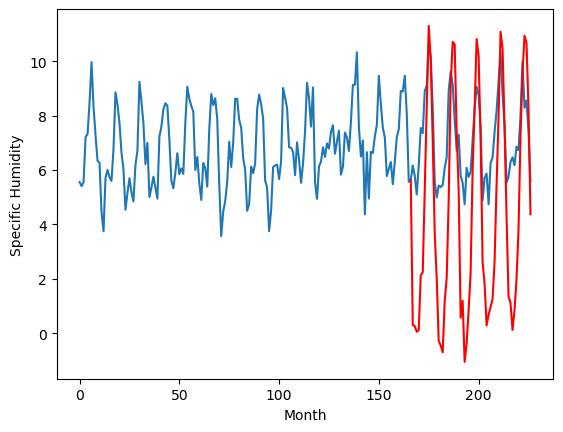

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		2.12		1.10
1.55		2.08		0.53
1.15		1.87		0.72
0.97		1.93		0.96
2.83		3.95		1.12
2.75		4.07		1.32
6.18		7.09		0.91
9.42		10.14		0.72
12.52		13.13		0.61
11.44		11.91		0.47
8.87		8.95		0.08
5.18		5.52		0.34
2.29		3.85		1.56
0.68		1.55		0.87
0.41		1.38		0.97
0.34		1.13		0.79
1.64		3.01		1.37
2.83		3.87		1.04
5.36		6.71		1.35
10.78		10.99		0.21
11.41		12.56		1.15
12.29		12.48		0.19
8.82		9.26		0.44
6.76		7.11		0.35
1.07		2.41		1.34
2.21		3.03		0.82
-0.11		0.78		0.89
0.41		1.47		1.06
1.39		2.68		1.29
2.66		4.06		1.40
7.08		7.87		0.79
9.34		10.08		0.74
12.38		12.66		0.28
11.25		12.06		0.81
8.00		9.02		1.02
2.85		4.45		1.60
2.04		3.65		1.61
1.01		2.12		1.11
1.55		2.51		0.96
1.37		2.81		1.44
1.24		3.11		1.87
2.78		4.47		1.69
5.69		7.29		1.60
7.71		9.81		2.10
11.36		12.94		1.58
10.81		12.33		1.52
8.34		9.44		1.10
4.81		6.16		1.35
1.42		3.21		1.79
1.44		2.95		1.51
0.70		1.96		1.26
1.02		2.69		1.67


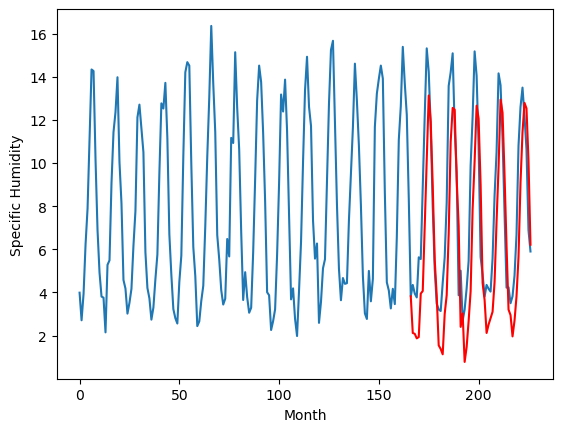

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		0.55		-1.94
0.99		0.51		-0.48
-1.30		0.30		1.60
-2.06		0.36		2.42
0.01		2.38		2.37
0.33		2.50		2.17
4.03		5.53		1.50
7.12		8.58		1.46
11.07		11.57		0.50
8.69		10.35		1.66
5.73		7.39		1.66
1.01		3.95		2.94
-0.09		2.28		2.37
-2.02		-0.02		2.00
-2.22		-0.19		2.03
-3.05		-0.43		2.62
-0.57		1.45		2.02
0.49		2.31		1.82
2.91		5.15		2.24
7.37		9.43		2.06
9.32		11.00		1.68
9.41		10.92		1.51
5.64		7.70		2.06
3.69		5.55		1.86
-1.43		0.85		2.28
-0.73		1.47		2.20
-3.19		-0.78		2.41
-2.57		-0.09		2.48
-1.00		1.12		2.12
0.56		2.50		1.94
4.65		6.31		1.66
6.75		8.52		1.77
9.34		11.10		1.76
8.84		10.51		1.67
5.74		7.46		1.72
0.74		2.89		2.15
-0.65		2.09		2.74
-1.77		0.57		2.34
-1.39		0.96		2.35
-0.51		1.25		1.76
-0.84		1.55		2.39
0.39		2.92		2.53
3.57		5.73		2.16
5.70		8.25		2.55
9.47		11.39		1.92
9.86		10.78		0.92
5.75		7.89		2.14
2.13		4.60		2.47
-1.04		1.65		2.69
-1.45		1.39		2.84
-2.32		0.40		2.72
-1

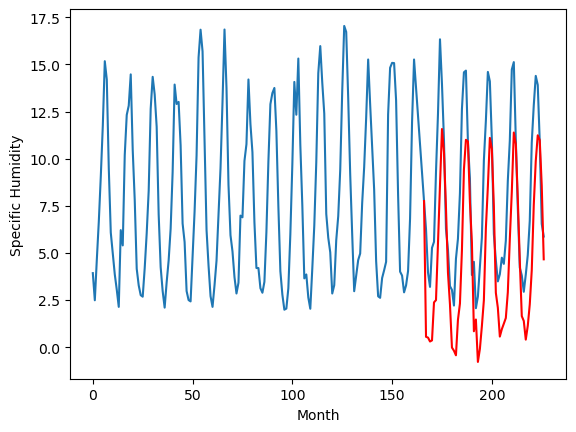

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		0.49		0.05
0.73		0.45		-0.28
0.23		0.24		0.01
-0.02		0.30		0.32
1.97		2.31		0.34
2.09		2.43		0.34
5.30		5.46		0.16
8.03		8.52		0.49
11.19		11.51		0.32
9.97		10.29		0.32
6.79		7.33		0.54
3.37		3.89		0.52
1.60		2.21		0.61
-0.06		-0.08		-0.02
-0.37		-0.25		0.12
-0.89		-0.49		0.40
1.14		1.39		0.25
2.44		2.25		-0.19
4.68		5.09		0.41
9.90		9.37		-0.53
11.15		10.94		-0.21
11.32		10.86		-0.46
8.02		7.64		-0.38
6.40		5.49		-0.91
0.53		0.79		0.26
1.58		1.41		-0.17
-0.93		-0.84		0.09
-0.40		-0.15		0.25
0.91		1.06		0.15
2.44		2.43		-0.01
6.67		6.25		-0.42
8.74		8.46		-0.28
11.52		11.04		-0.48
10.32		10.45		0.13
7.55		7.40		-0.15
2.25		2.83		0.58
1.03		2.03		1.00
0.27		0.50		0.23
0.85		0.90		0.05
0.52		1.19		0.67
0.95		1.49		0.54
2.26		2.85		0.59
4.86		5.67		0.81
7.02		8.20		1.18
11.53		11.33		-0.20
10.65		10.72		0.07
7.42		7.83		0.41
4.04		4.55		0.51
0.85		1.59		0.74
0.81		1.34		0.53
-0.07		0.35		0

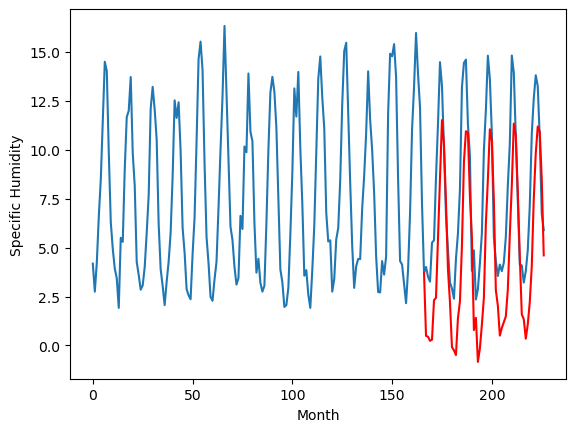

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		0.74		-4.04
4.41		0.70		-3.71
4.37		0.49		-3.88
4.33		0.55		-3.78
4.96		2.57		-2.39
5.31		2.69		-2.62
6.44		5.71		-0.73
7.50		8.76		1.26
9.02		11.76		2.74
7.81		10.53		2.72
6.67		7.57		0.90
5.02		4.13		-0.89
4.96		2.46		-2.50
4.15		0.16		-3.99
4.32		-0.01		-4.33
4.38		-0.25		-4.63
4.69		1.62		-3.07
5.16		2.49		-2.67
6.56		5.32		-1.24
7.89		9.59		1.70
10.34		11.17		0.83
8.91		11.08		2.17
7.21		7.86		0.65
6.12		5.71		-0.41
5.41		1.01		-4.40
4.70		1.63		-3.07
4.22		-0.62		-4.84
4.01		0.07		-3.94
4.69		1.28		-3.41
5.19		2.66		-2.53
6.00		6.47		0.47
7.94		8.68		0.74
10.93		11.26		0.33
10.77		10.67		-0.10
7.82		7.62		-0.20
6.21		3.05		-3.16
4.55		2.25		-2.30
4.58		0.73		-3.85
4.55		1.12		-3.43
4.17		1.41		-2.76
4.47		1.71		-2.76
5.10		3.08		-2.02
7.26		5.89		-1.37
7.49		8.41		0.92
8.33		11.54		3.21
9.98		10.93		0.95
7.36		8.04		0.68
6.11		4.76		-1.35
4.78		1.80		-2.98
4.65		1.55		-3.10
4.59		

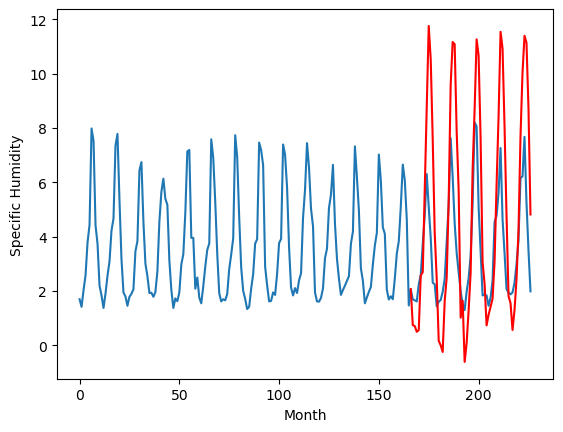

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		-1.74		-4.43
3.68		-1.78		-5.46
2.56		-1.99		-4.55
2.14		-1.93		-4.07
3.88		0.08		-3.80
3.69		0.20		-3.49
2.99		3.23		0.24
3.32		6.28		2.96
3.80		9.27		5.47
4.67		8.04		3.37
3.41		5.08		1.67
2.40		1.65		-0.75
2.38		-0.03		-2.41
1.55		-2.33		-3.88
2.36		-2.50		-4.86
1.88		-2.74		-4.62
2.18		-0.87		-3.05
1.87		-0.01		-1.88
2.43		2.83		0.40
3.85		7.10		3.25
9.21		8.67		-0.54
6.78		8.58		1.80
5.06		5.37		0.31
3.96		3.22		-0.74
2.69		-1.48		-4.17
2.83		-0.86		-3.69
1.84		-3.11		-4.95
1.41		-2.42		-3.83
2.03		-1.21		-3.24
2.03		0.17		-1.86
2.29		3.98		1.69
4.05		6.19		2.14
7.48		8.77		1.29
10.55		8.17		-2.38
6.64		5.13		-1.51
3.91		0.56		-3.35
2.14		-0.23		-2.37
2.89		-1.76		-4.65
3.28		-1.37		-4.65
2.03		-1.08		-3.11
3.07		-0.78		-3.85
2.22		0.58		-1.64
3.76		3.40		-0.36
4.26		5.91		1.65
5.23		9.04		3.81
7.81		8.43		0.62
6.87		5.54		-1.33
3.81		2.26		-1.55
2.80		-0.70		-3.50
2.72		-0.95		-3.

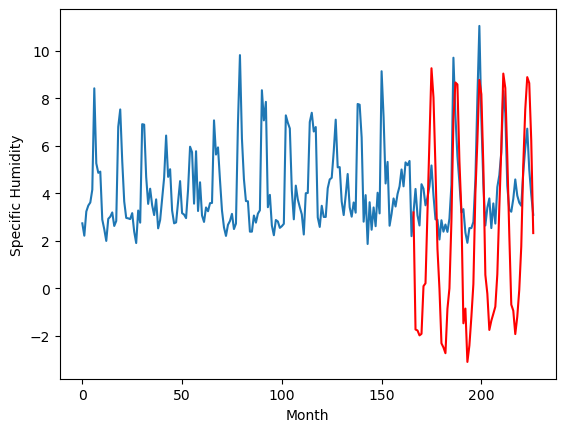

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		-0.70		-4.03
4.56		-0.74		-5.30
3.88		-0.95		-4.83
2.99		-0.88		-3.87
3.47		1.13		-2.34
4.53		1.24		-3.29
5.39		4.26		-1.13
5.61		7.32		1.71
6.08		10.30		4.22
6.88		9.06		2.18
6.49		6.11		-0.38
4.29		2.68		-1.61
3.13		1.01		-2.12
2.79		-1.29		-4.08
3.46		-1.47		-4.93
3.11		-1.72		-4.83
2.76		0.15		-2.61
3.69		1.01		-2.68
4.13		3.86		-0.27
5.56		8.12		2.56
6.04		9.68		3.64
6.43		9.60		3.17
5.79		6.39		0.60
4.76		4.23		-0.53
4.98		-0.46		-5.44
3.73		0.16		-3.57
3.40		-2.09		-5.49
2.56		-1.39		-3.95
3.56		-0.18		-3.74
3.66		1.20		-2.46
4.03		5.01		0.98
5.52		7.22		1.70
6.35		9.80		3.45
6.81		9.20		2.39
6.21		6.15		-0.06
4.90		1.59		-3.31
2.65		0.79		-1.86
3.44		-0.73		-4.17
3.27		-0.35		-3.62
2.41		-0.06		-2.47
3.21		0.24		-2.97
3.59		1.61		-1.98
5.18		4.42		-0.76
5.24		6.93		1.69
6.08		10.06		3.98
7.35		9.45		2.10
6.80		6.56		-0.24
5.37		3.28		-2.09
4.28		0.33		-3.95
4.66		0.07		-4.59
4.6

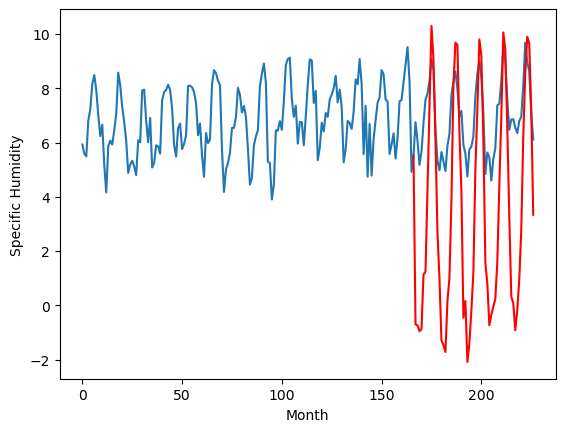

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.49		0.24
1.89		2.45		0.56
1.61		2.24		0.63
1.69		2.30		0.61
2.18		4.31		2.13
2.68		4.43		1.75
4.91		7.45		2.54
9.02		10.51		1.49
13.00		13.50		0.50
11.93		12.27		0.34
8.56		9.32		0.76
6.03		5.88		-0.15
3.87		4.20		0.33
1.91		1.91		-0.00
0.82		1.74		0.92
0.97		1.49		0.52
1.75		3.36		1.61
3.13		4.22		1.09
4.70		7.06		2.36
9.60		11.33		1.73
11.81		12.90		1.09
12.19		12.82		0.63
9.59		9.60		0.01
7.05		7.45		0.40
2.52		2.75		0.23
2.22		3.37		1.15
0.74		1.12		0.38
1.33		1.81		0.48
2.17		3.02		0.85
2.82		4.40		1.58
6.21		8.21		2.00
8.55		10.42		1.87
11.71		13.00		1.29
11.85		12.40		0.55
8.18		9.36		1.18
5.55		4.78		-0.77
3.70		3.99		0.29
1.73		2.46		0.73
2.30		2.85		0.55
1.59		3.14		1.55
1.80		3.44		1.64
4.04		4.80		0.76
4.56		7.62		3.06
8.26		10.13		1.87
13.11		13.26		0.15
10.54		12.65		2.11
9.57		9.76		0.19
6.18		6.48		0.30
2.38		3.52		1.14
2.71		3.27		0.56
1.41		2.28		0.87
1.31		3.02		1.

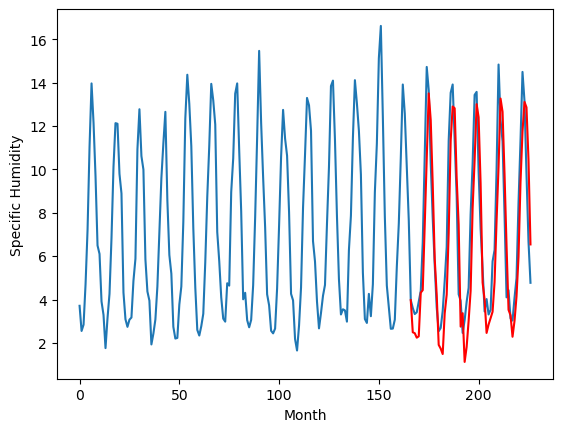

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.27		0.81
-0.66		0.22		0.88
-0.74		0.01		0.75
-0.75		0.08		0.83
0.21		2.09		1.88
0.64		2.21		1.57
3.17		5.23		2.06
6.74		8.28		1.54
10.09		11.28		1.19
9.45		10.05		0.60
6.16		7.10		0.94
3.39		3.65		0.26
1.06		1.98		0.92
-0.79		-0.32		0.47
-1.48		-0.49		0.99
-1.62		-0.73		0.89
-0.34		1.14		1.48
1.07		2.00		0.93
2.66		4.84		2.18
7.53		9.11		1.58
9.22		10.68		1.46
9.54		10.60		1.06
6.62		7.38		0.76
4.72		5.24		0.52
-0.20		0.54		0.74
-0.30		1.15		1.45
-1.81		-1.09		0.72
-1.11		-0.40		0.71
-0.17		0.81		0.98
0.47		2.18		1.71
4.65		6.00		1.35
6.05		8.21		2.16
9.03		10.79		1.76
8.66		10.19		1.53
5.64		7.15		1.51
2.22		2.57		0.35
1.00		1.78		0.78
-0.92		0.25		1.17
-0.14		0.64		0.78
-0.89		0.93		1.82
-0.76		1.22		1.98
1.67		2.59		0.92
2.14		5.41		3.27
5.83		7.92		2.09
9.81		11.06		1.25
8.57		10.45		1.88
6.88		7.56		0.68
3.61		4.28		0.67
-0.07		1.32		1.39
0.31		1.07		0.76
-0.82		0.08		0.90
-0.9

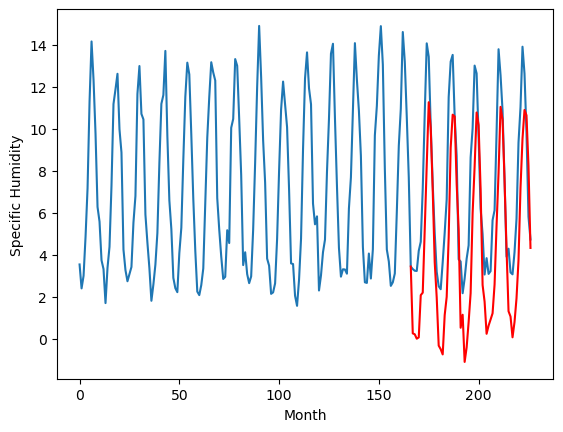

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29   0.270963
1                 1    2.24   1.672167
2                 2    3.79   0.298316
3                 3    1.02   2.121949
4                 4    2.49   0.552118
5                 5    0.44   0.489639
6                 6    4.78   0.741047
7                 7    2.69  -1.743912
8                 8    3.33  -0.704469
9                 9    2.25   2.490545
10               10   -0.54   0.268091


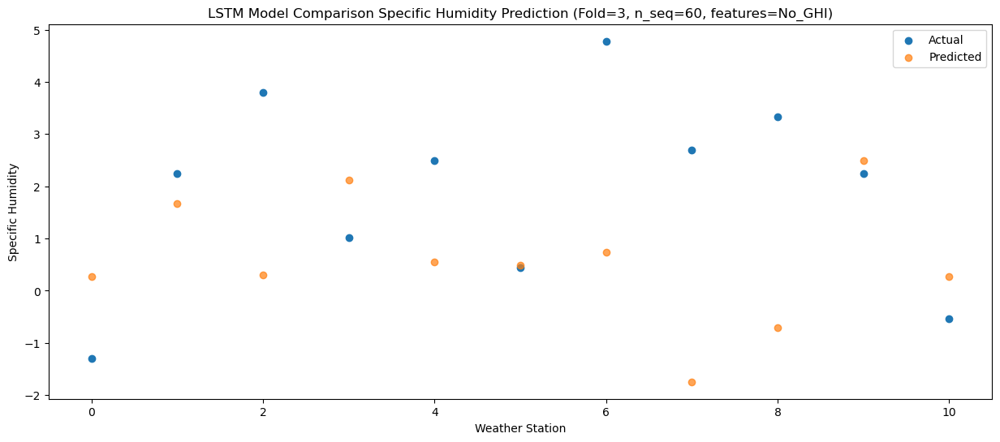

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08   0.227660
1                 1    1.83   1.631707
2                 2    4.33   0.258815
3                 3    1.55   2.081752
4                 4    0.99   0.511981
5                 5    0.73   0.447822
6                 6    4.41   0.699687
7                 7    3.68  -1.784217
8                 8    4.56  -0.742969
9                 9    1.89   2.447712
10               10   -0.66   0.224016


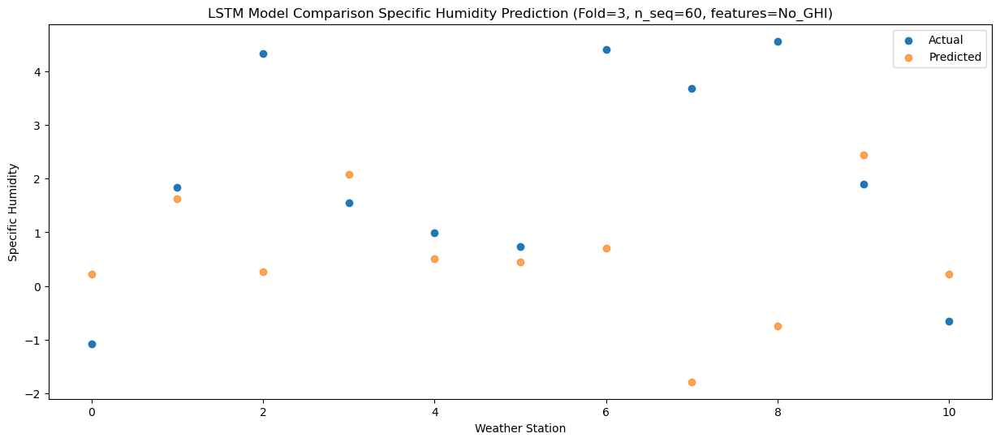

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03   0.014186
1                 1    1.80   1.421976
2                 2    3.95   0.050177
3                 3    1.15   1.871412
4                 4   -1.30   0.302896
5                 5    0.23   0.237591
6                 6    4.37   0.490799
7                 7    2.56  -1.992076
8                 8    3.88  -0.951467
9                 9    1.61   2.240032
10               10   -0.74   0.014096


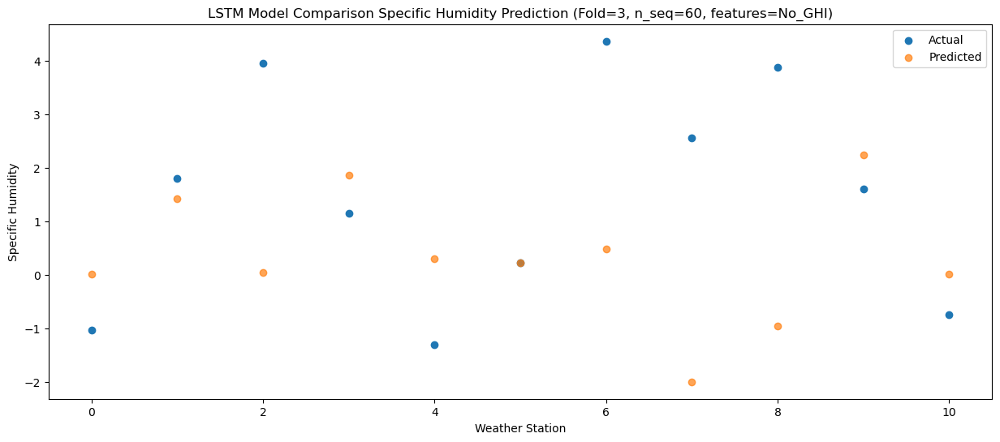

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70   0.077114
1                 1    1.44   1.484344
2                 2    3.26   0.114912
3                 3    0.97   1.932455
4                 4   -2.06   0.362456
5                 5   -0.02   0.296362
6                 6    4.33   0.553273
7                 7    2.14  -1.926126
8                 8    2.99  -0.883902
9                 9    1.69   2.303206
10               10   -0.75   0.076295


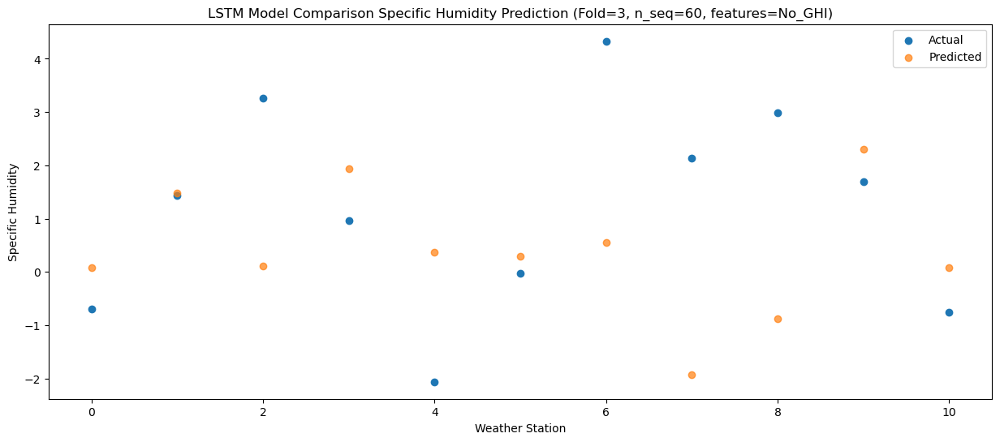

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   2.092249
1                 1    4.04   3.499286
2                 2    4.34   2.126754
3                 3    2.83   3.946877
4                 4    0.01   2.377495
5                 5    1.97   2.311462
6                 6    4.96   2.565219
7                 7    3.88   0.084208
8                 8    3.47   1.127498
9                 9    2.18   4.313468
10               10    0.21   2.087793


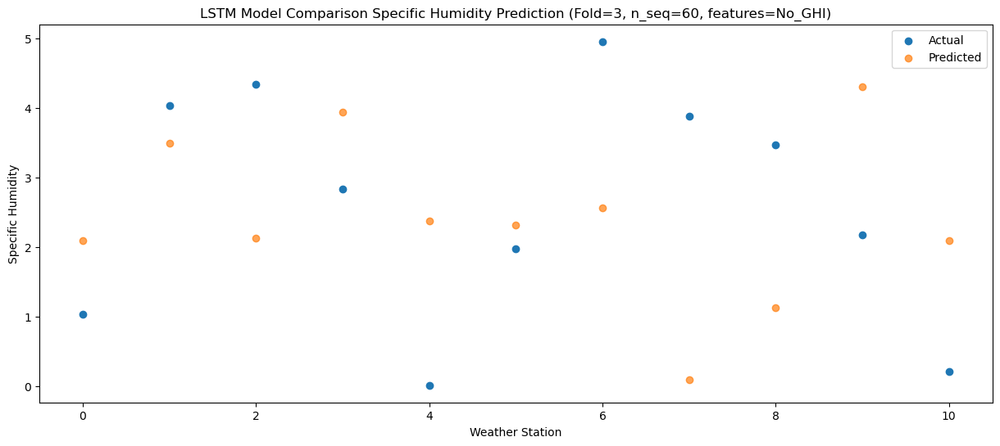

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   2.211503
1                 1    4.19   3.620054
2                 2    5.71   2.244536
3                 3    2.75   4.067190
4                 4    0.33   2.498689
5                 5    2.09   2.433824
6                 6    5.31   2.685522
7                 7    3.69   0.203535
8                 8    4.53   1.244299
9                 9    2.68   4.432648
10               10    0.64   2.206981


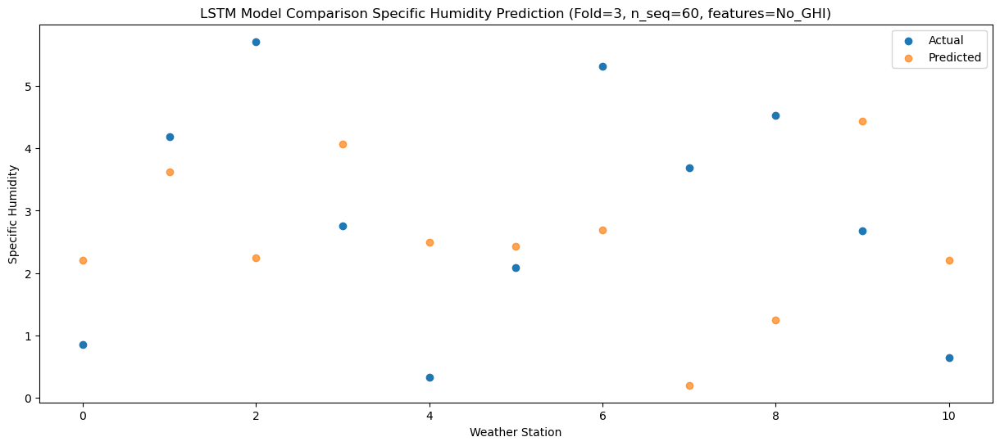

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   5.235304
1                 1    7.16   6.644749
2                 2    5.52   5.265593
3                 3    6.18   7.091958
4                 4    4.03   5.525276
5                 5    5.30   5.462494
6                 6    6.44   5.710783
7                 7    2.99   3.225815
8                 8    5.39   4.263571
9                 9    4.91   7.454484
10               10    3.17   5.229659


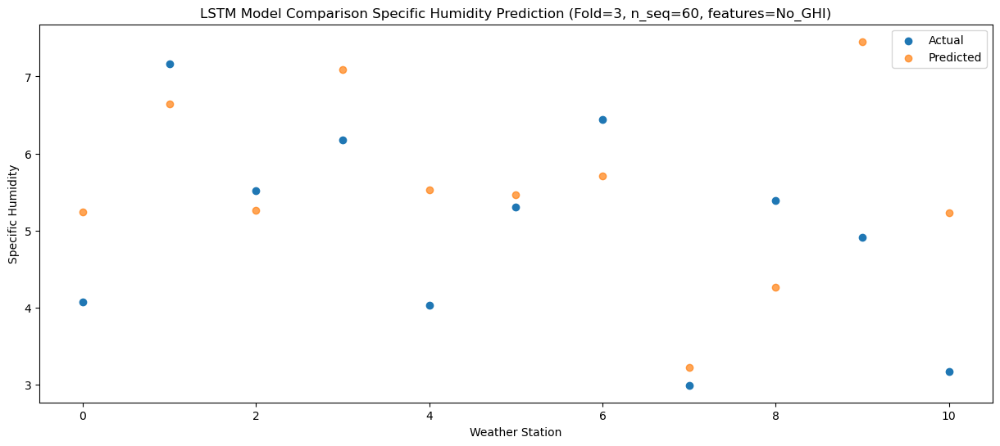

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   8.288315
1                 1   10.69   9.697190
2                 2    7.06   8.318848
3                 3    9.42  10.144997
4                 4    7.12   8.581090
5                 5    8.03   8.518223
6                 6    7.50   8.764353
7                 7    3.32   6.277918
8                 8    5.61   7.315812
9                 9    9.02  10.509145
10               10    6.74   8.284560


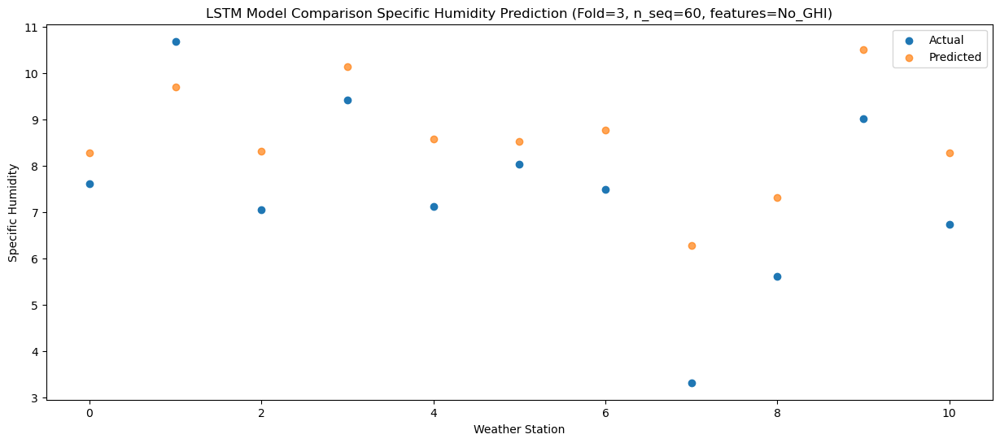

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30  11.276878
1                 1   13.43  12.688090
2                 2    7.28  11.302722
3                 3   12.52  13.133975
4                 4   11.07  11.573432
5                 5   11.19  11.511874
6                 6    9.02  11.755944
7                 7    3.80   9.266150
8                 8    6.08  10.298880
9                 9   13.00  13.498453
10               10   10.09  11.276021


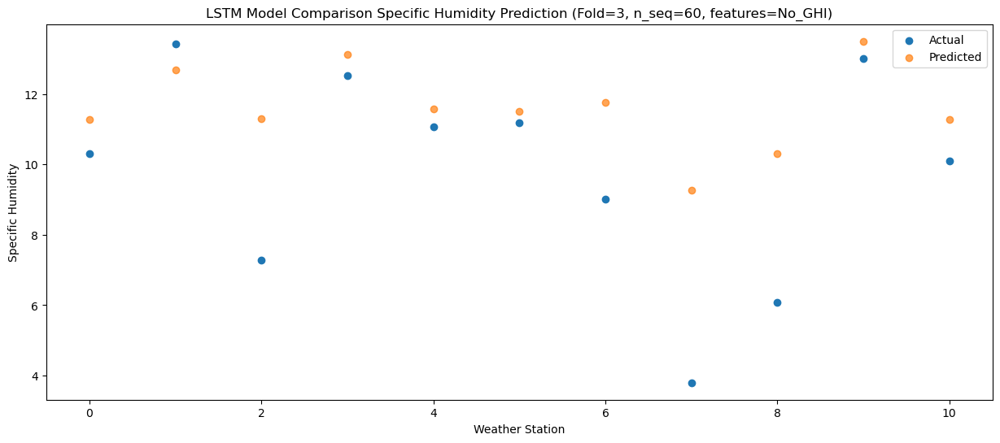

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59  10.048033
1                 1   10.76  11.457372
2                 2    8.80  10.069641
3                 3   11.44  11.905928
4                 4    8.69  10.345245
5                 5    9.97  10.285113
6                 6    7.81  10.526084
7                 7    4.67   8.035623
8                 8    6.88   9.063702
9                 9   11.93  12.269259
10               10    9.45  10.049463


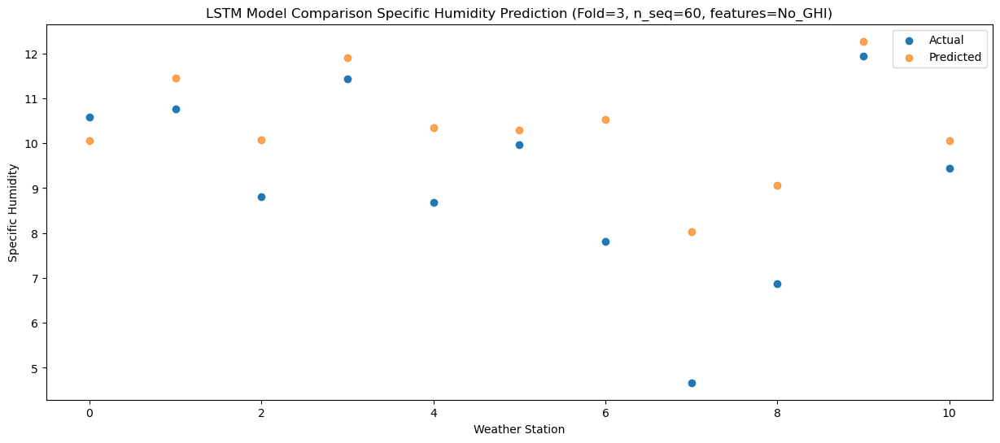

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   7.094055
1                 1    9.32   8.500756
2                 2    8.32   7.117343
3                 3    8.87   8.952124
4                 4    5.73   7.388882
5                 5    6.79   7.327863
6                 6    6.67   7.571940
7                 7    3.41   5.082176
8                 8    6.49   6.111651
9                 9    8.56   9.317368
10               10    6.16   7.096694


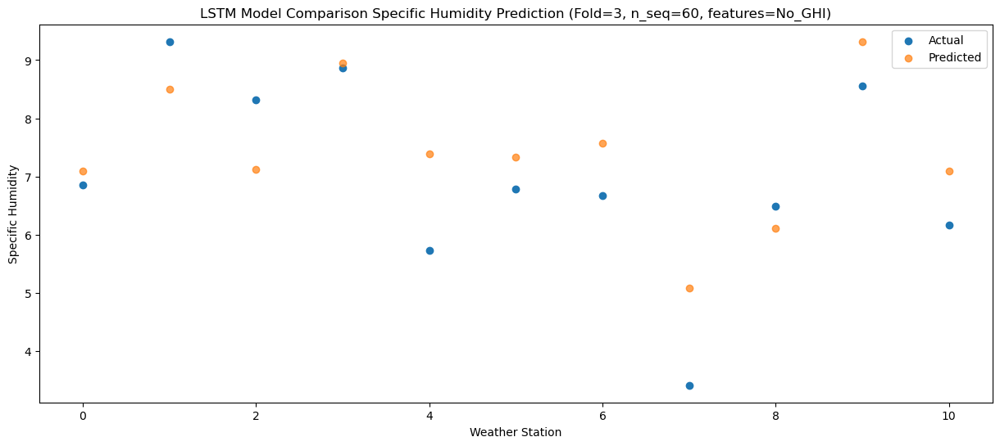

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   3.660891
1                 1    4.75   5.064731
2                 2    6.44   3.689193
3                 3    5.18   5.517475
4                 4    1.01   3.950227
5                 5    3.37   3.885170
6                 6    5.02   4.131969
7                 7    2.40   1.649295
8                 8    4.29   2.684835
9                 9    6.03   5.879903
10               10    3.39   3.654818


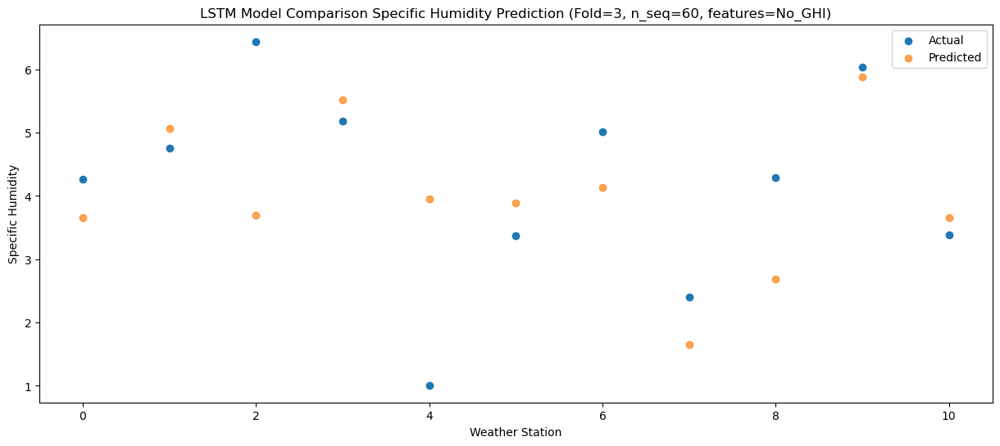

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53   1.987020
1                 1    3.25   3.392431
2                 2    3.75   2.015265
3                 3    2.29   3.845048
4                 4   -0.09   2.279498
5                 5    1.60   2.214660
6                 6    4.96   2.457654
7                 7    2.38  -0.026733
8                 8    3.13   1.006468
9                 9    3.87   4.203896
10               10    1.06   1.978565


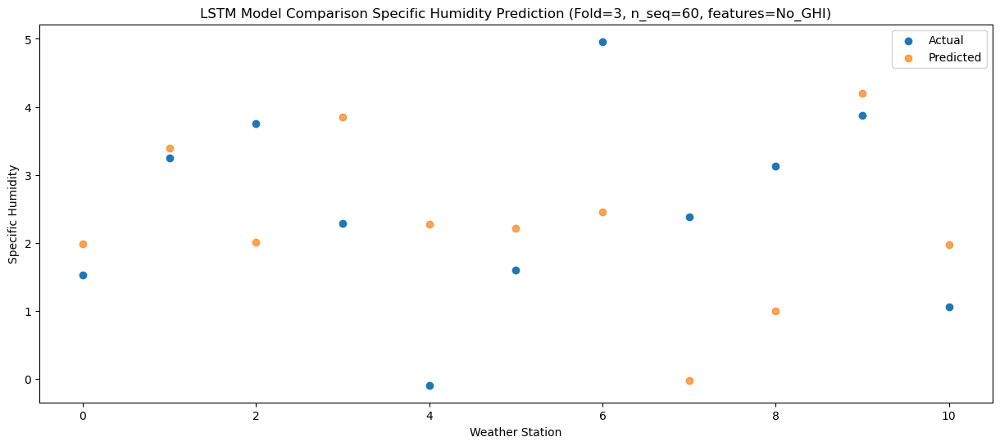

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.312753
1                 1    1.21   1.093150
2                 2    3.15  -0.284043
3                 3    0.68   1.546639
4                 4   -2.02  -0.017710
5                 5   -0.06  -0.081925
6                 6    4.15   0.160804
7                 7    1.55  -2.325914
8                 8    2.79  -1.293612
9                 9    1.91   1.908836
10               10   -0.79  -0.316300


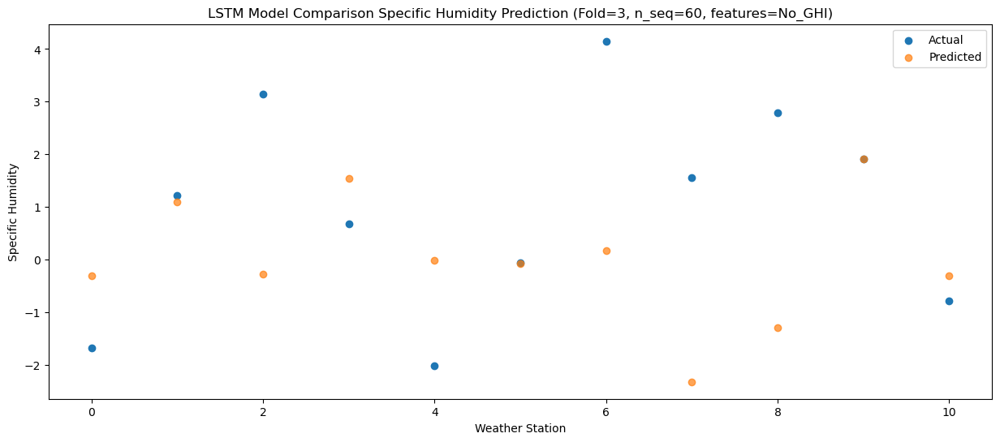

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -0.484646
1                 1    1.12   0.925180
2                 2    3.59  -0.454800
3                 3    0.41   1.378021
4                 4   -2.22  -0.185572
5                 5   -0.37  -0.248349
6                 6    4.32  -0.008310
7                 7    2.36  -2.498773
8                 8    3.46  -1.468480
9                 9    0.82   1.735224
10               10   -1.48  -0.488096


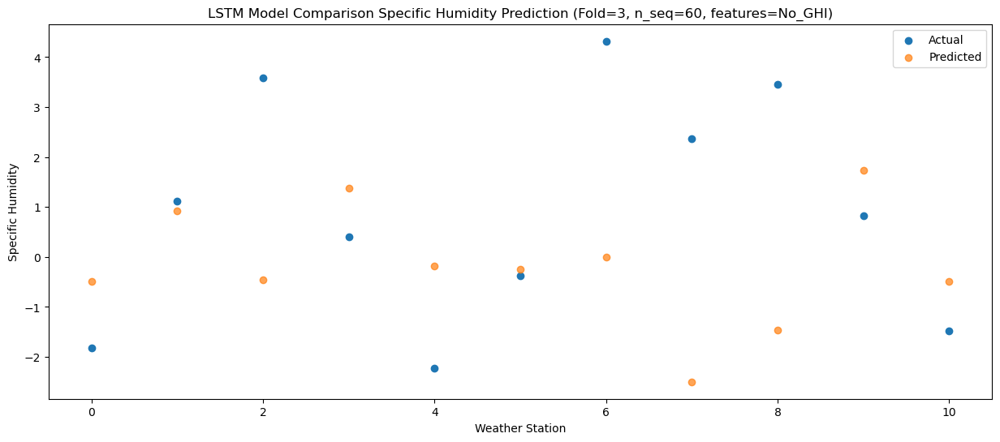

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73  -0.731741
1                 1    0.56   0.681616
2                 2    3.53  -0.703524
3                 3    0.34   1.131983
4                 4   -3.05  -0.428533
5                 5   -0.89  -0.489467
6                 6    4.38  -0.250679
7                 7    1.88  -2.742856
8                 8    3.11  -1.720456
9                 9    0.97   1.486734
10               10   -1.62  -0.734752


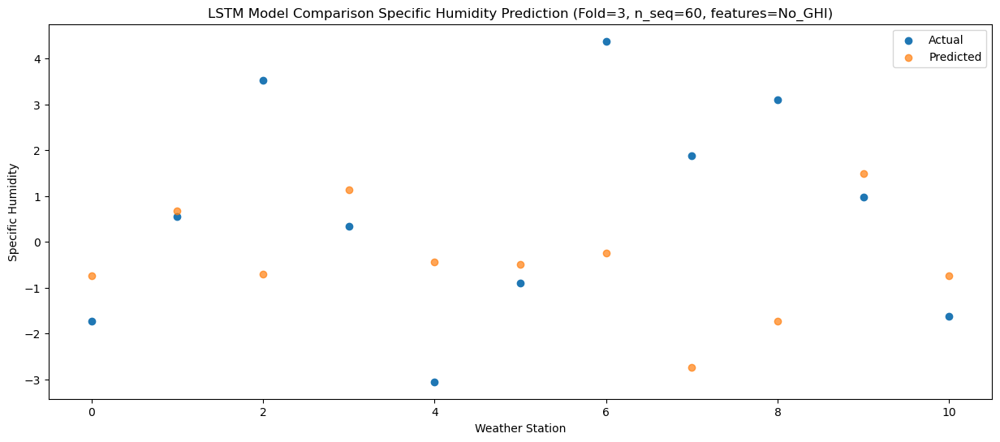

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08   1.141051
1                 1    3.07   2.557233
2                 2    3.61   1.172432
3                 3    1.64   3.007100
4                 4   -0.57   1.448090
5                 5    1.14   1.387648
6                 6    4.69   1.622928
7                 7    2.18  -0.871143
8                 8    2.76   0.150373
9                 9    1.75   3.359063
10               10   -0.34   1.139632


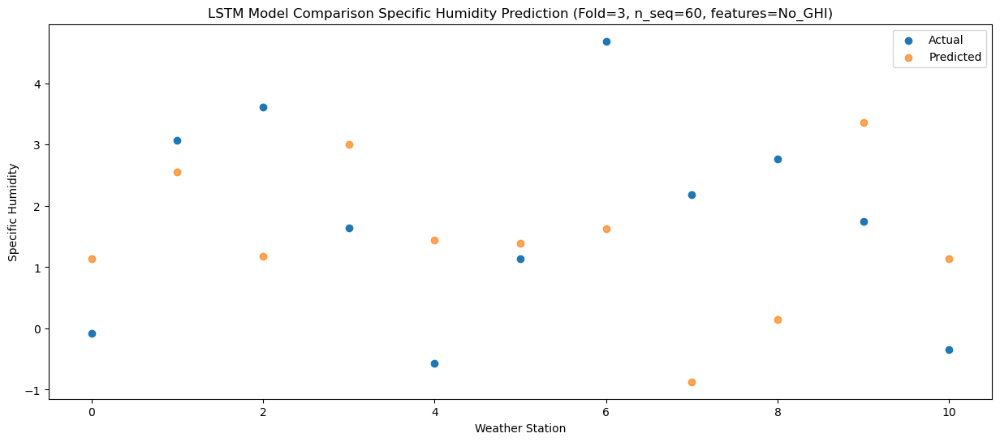

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44   2.003838
1                 1    4.24   3.422056
2                 2    4.23   2.038070
3                 3    2.83   3.872140
4                 4    0.49   2.313340
5                 5    2.44   2.252763
6                 6    5.16   2.487232
7                 7    1.87  -0.007032
8                 8    3.69   1.014568
9                 9    3.13   4.222289
10               10    1.07   2.003997


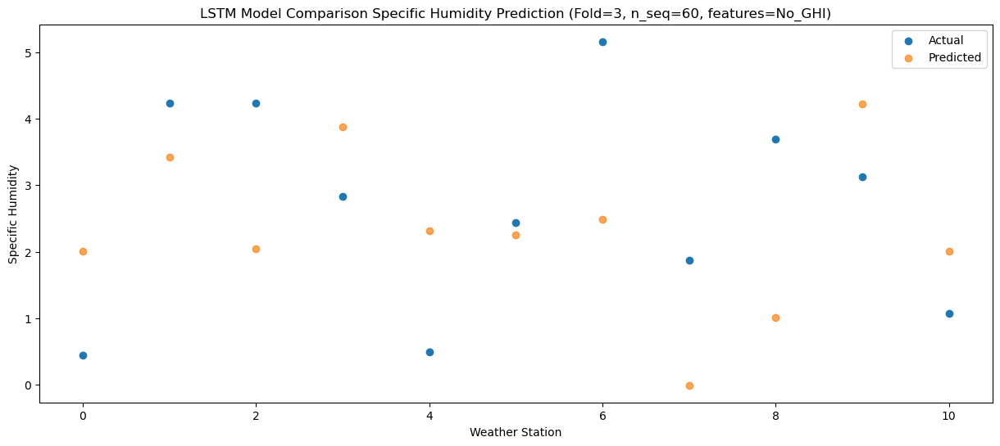

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   4.840129
1                 1    7.76   6.259466
2                 2    4.63   4.879107
3                 3    5.36   6.711144
4                 4    2.91   5.149755
5                 5    4.68   5.087206
6                 6    6.56   5.321740
7                 7    2.43   2.830672
8                 8    4.13   3.856898
9                 9    4.70   7.056516
10               10    2.66   4.836561


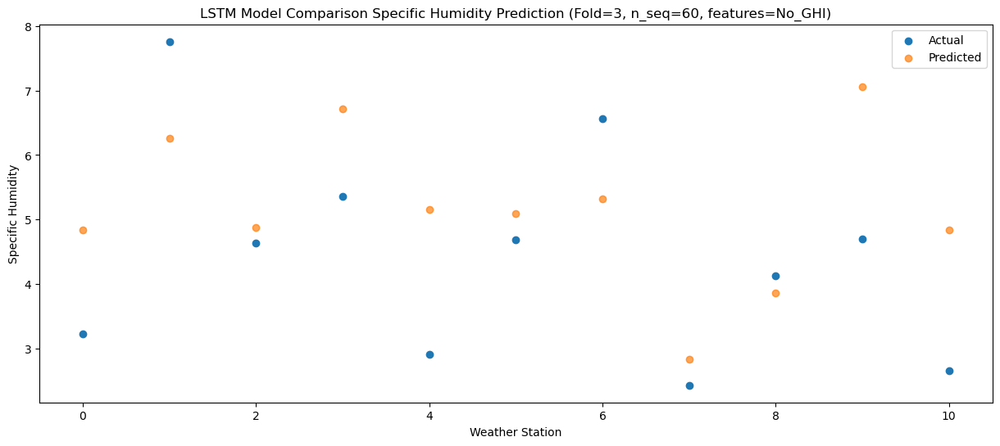

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94   9.110490
1                 1   12.29  10.532047
2                 2    7.08   9.146859
3                 3   10.78  10.986618
4                 4    7.37   9.426467
5                 5    9.90   9.366183
6                 6    7.89   9.594365
7                 7    3.85   7.098806
8                 8    5.56   8.120679
9                 9    9.60  11.325781
10               10    7.53   9.107831


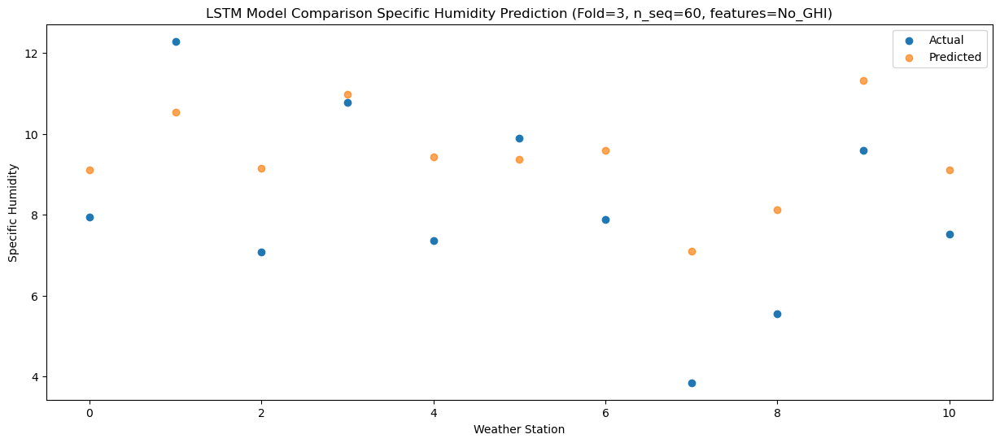

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18  10.682400
1                 1   13.17  12.104331
2                 2    7.78  10.712775
3                 3   11.41  12.558282
4                 4    9.32  10.999890
5                 5   11.15  10.942598
6                 6   10.34  11.165900
7                 7    9.21   8.667358
8                 8    6.04   9.683766
9                 9   11.81  12.896611
10               10    9.22  10.682309


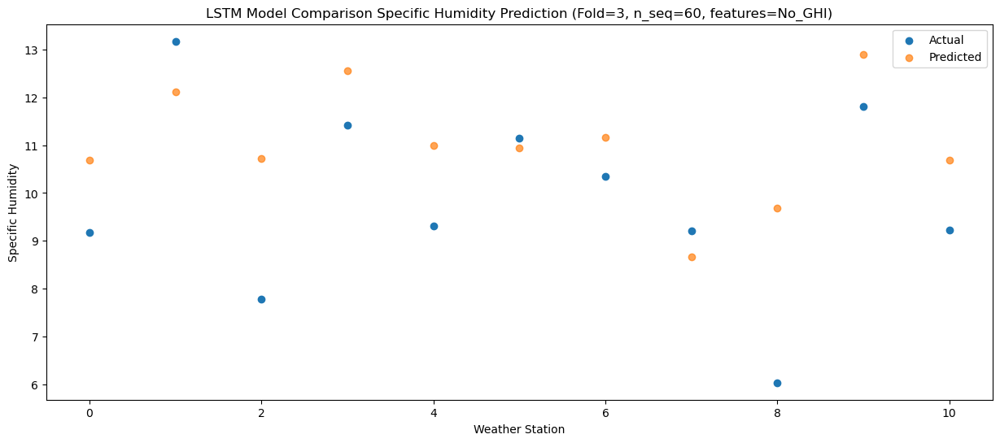

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45  10.599682
1                 1   13.34  12.019477
2                 2    7.31  10.630410
3                 3   12.29  12.477005
4                 4    9.41  10.916569
5                 5   11.32  10.859288
6                 6    8.91  11.081433
7                 7    6.78   8.584488
8                 8    6.43   9.602672
9                 9   12.19  12.816657
10               10    9.54  10.602989


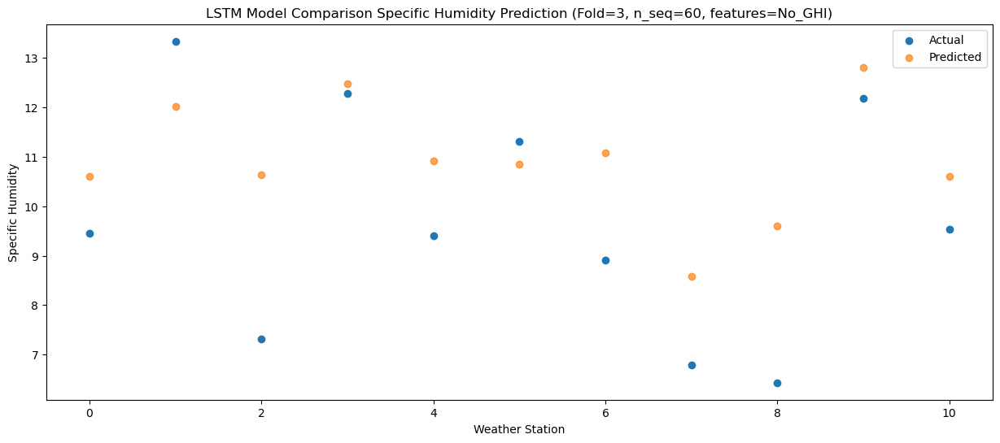

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   7.383325
1                 1    9.37   8.805540
2                 2    6.02   7.417199
3                 3    8.82   9.259444
4                 4    5.64   7.700043
5                 5    8.02   7.641439
6                 6    7.21   7.863141
7                 7    5.06   5.366769
8                 8    5.79   6.386338
9                 9    9.59   9.597234
10               10    6.62   7.383913


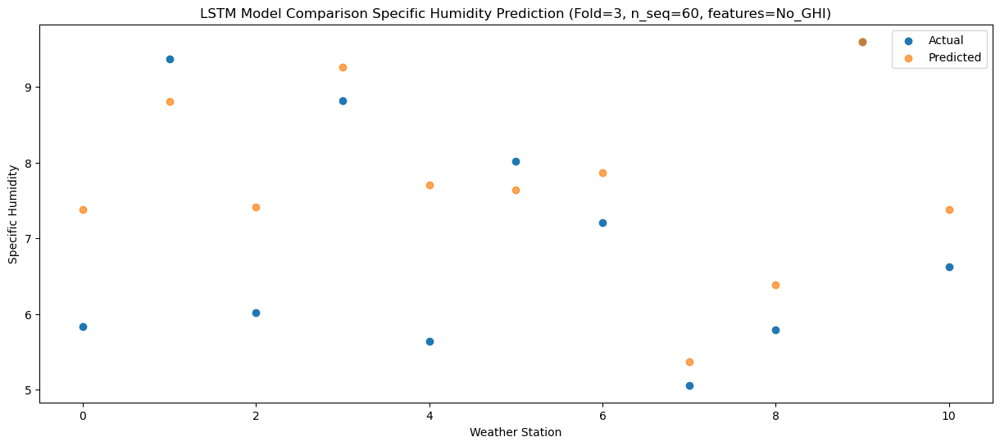

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   5.229828
1                 1    7.18   6.652858
2                 2    4.88   5.264456
3                 3    6.76   7.105393
4                 4    3.69   5.548653
5                 5    6.40   5.491336
6                 6    6.12   5.712147
7                 7    3.96   3.216040
8                 8    4.76   4.234185
9                 9    7.05   7.446740
10               10    4.72   5.236116


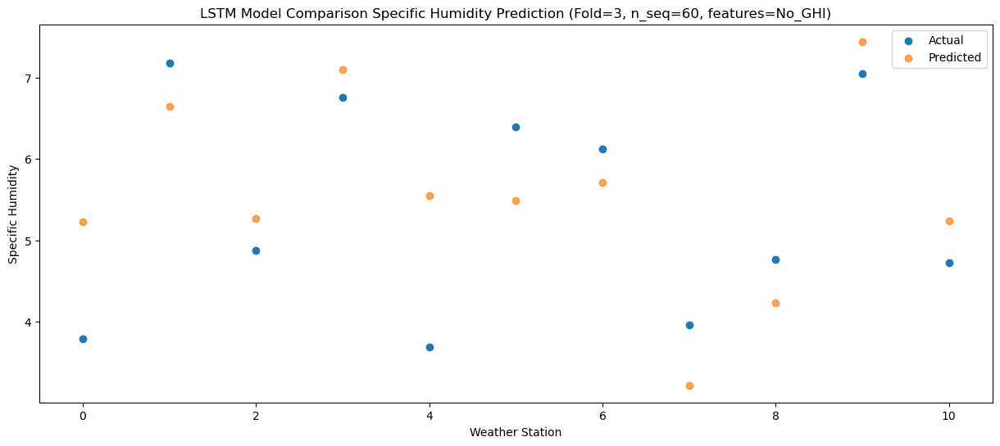

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71   0.528499
1                 1    2.75   1.951742
2                 2    5.46   0.566420
3                 3    1.07   2.405013
4                 4   -1.43   0.845979
5                 5    0.53   0.785701
6                 6    5.41   1.009238
7                 7    2.69  -1.481905
8                 8    4.98  -0.461121
9                 9    2.52   2.749738
10               10   -0.20   0.535676


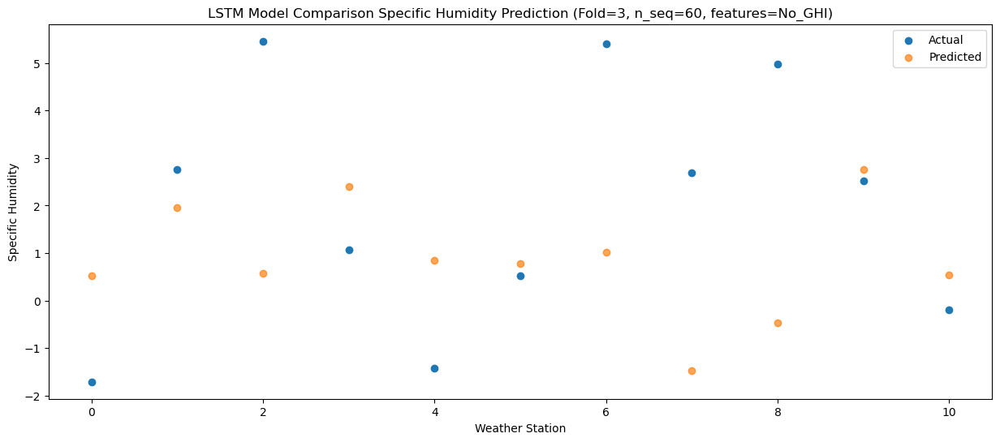

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24   1.151696
1                 1    3.72   2.577653
2                 2    3.96   1.190434
3                 3    2.21   3.028010
4                 4   -0.73   1.469609
5                 5    1.58   1.409284
6                 6    4.70   1.631783
7                 7    2.83  -0.861249
8                 8    3.73   0.160492
9                 9    2.22   3.368624
10               10   -0.30   1.154542


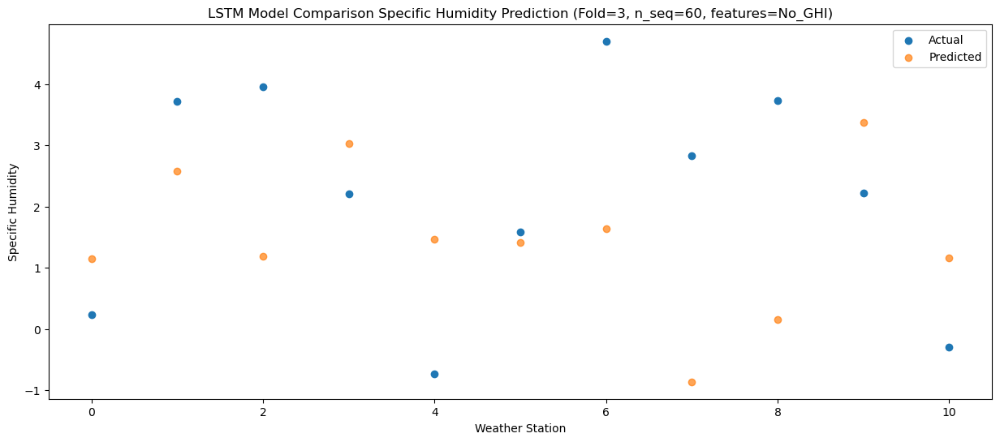

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -1.098971
1                 1    0.53   0.327928
2                 2    3.68  -1.058080
3                 3   -0.11   0.779181
4                 4   -3.19  -0.779431
5                 5   -0.93  -0.840349
6                 6    4.22  -0.618463
7                 7    1.84  -3.109867
8                 8    3.40  -2.086128
9                 9    0.74   1.123437
10               10   -1.81  -1.091745


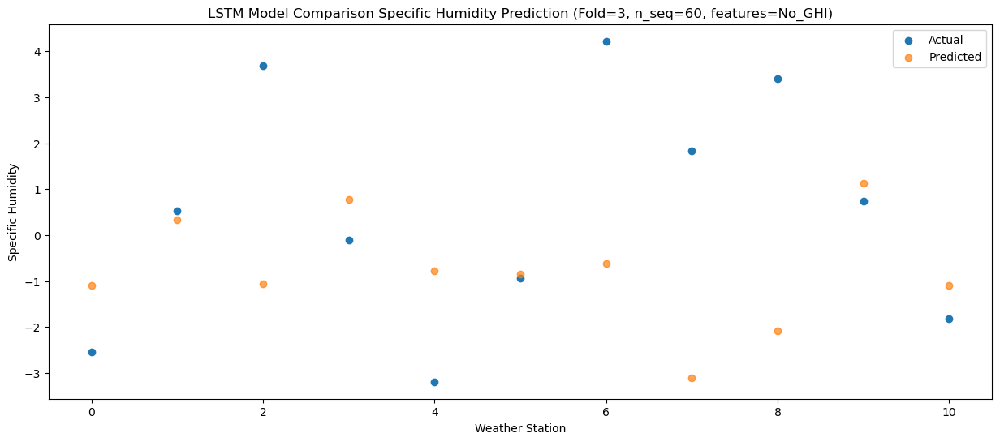

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19  -0.409095
1                 1    0.90   1.017480
2                 2    2.90  -0.369649
3                 3    0.41   1.468559
4                 4   -2.57  -0.090317
5                 5   -0.40  -0.151411
6                 6    4.01   0.073070
7                 7    1.41  -2.419102
8                 8    2.56  -1.393285
9                 9    1.33   1.813033
10               10   -1.11  -0.402005


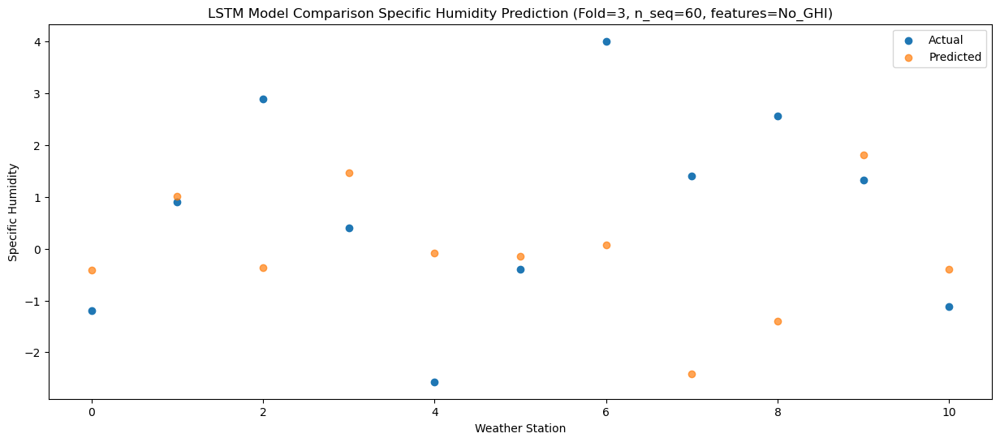

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29   0.802224
1                 1    2.37   2.230939
2                 2    4.24   0.843022
3                 3    1.39   2.679529
4                 4   -1.00   1.121571
5                 5    0.91   1.060986
6                 6    4.69   1.284240
7                 7    2.03  -1.207578
8                 8    3.56  -0.181832
9                 9    2.17   3.021456
10               10   -0.17   0.807493


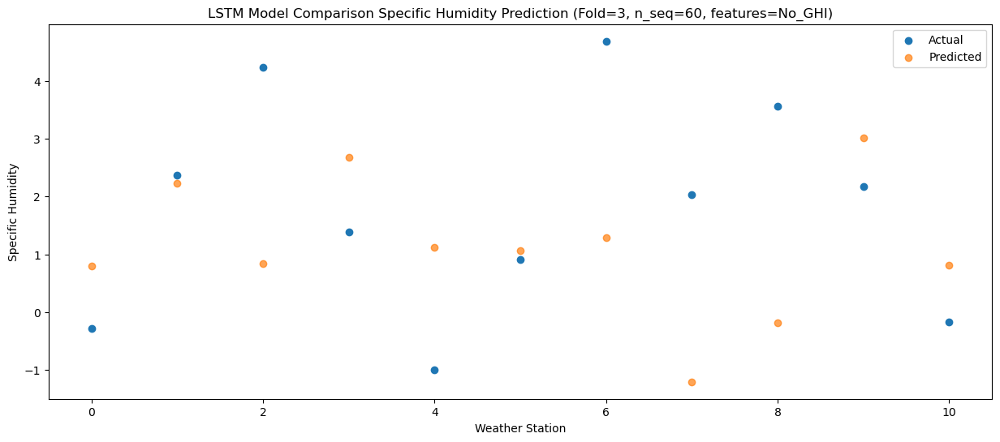

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74   2.181090
1                 1    4.67   3.606865
2                 2    3.91   2.222625
3                 3    2.66   4.056276
4                 4    0.56   2.496732
5                 5    2.44   2.432950
6                 6    5.19   2.656693
7                 7    2.03   0.171047
8                 8    3.66   1.201429
9                 9    2.82   4.400334
10               10    0.47   2.184494


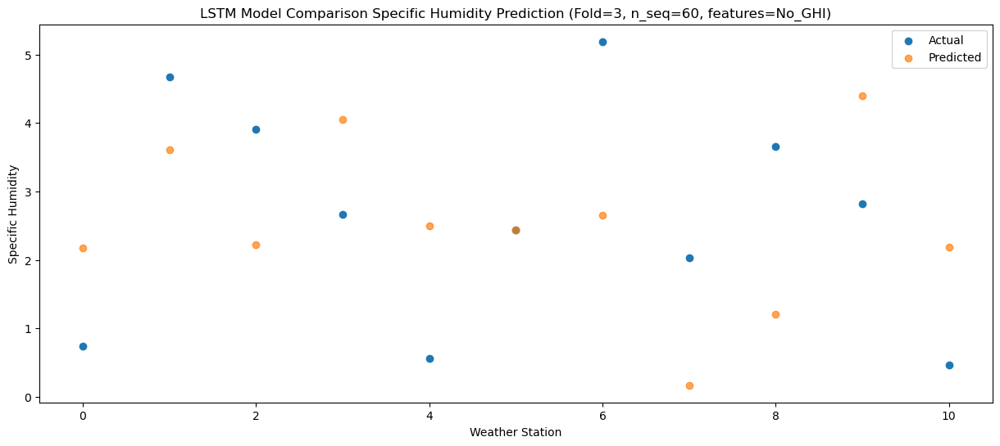

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   5.995416
1                 1    9.12   7.421042
2                 2    4.09   6.032451
3                 3    7.08   7.870819
4                 4    4.65   6.310636
5                 5    6.67   6.249059
6                 6    6.00   6.468692
7                 7    2.29   3.981514
8                 8    4.03   5.010694
9                 9    6.21   8.212353
10               10    4.65   5.997057


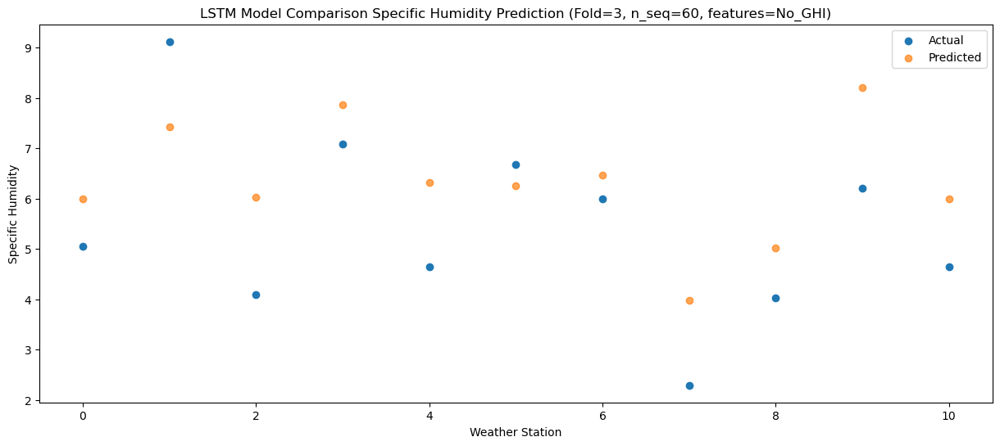

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   8.203685
1                 1   11.74   9.631010
2                 2    5.26   8.238780
3                 3    9.34  10.080787
4                 4    6.75   8.521741
5                 5    8.74   8.462308
6                 6    7.94   8.681237
7                 7    4.05   6.191962
8                 8    5.52   7.218375
9                 9    8.55  10.421295
10               10    6.05   8.206200


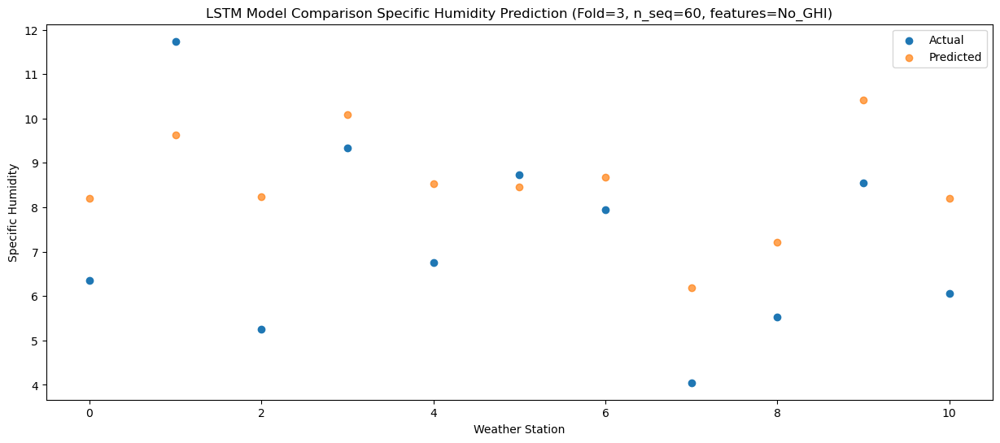

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42  10.785018
1                 1   11.95  12.210812
2                 2    6.43  10.820695
3                 3   12.38  12.661808
4                 4    9.34  11.101965
5                 5   11.52  11.041320
6                 6   10.93  11.261340
7                 7    7.48   8.773040
8                 8    6.35   9.800527
9                 9   11.71  13.002753
10               10    9.03  10.786913


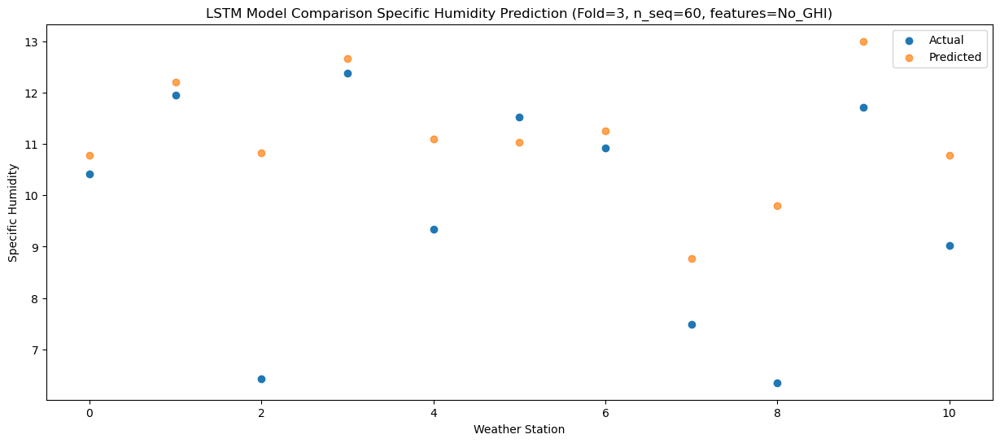

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61  10.185991
1                 1   12.56  11.614286
2                 2    7.22  10.218558
3                 3   11.25  12.064899
4                 4    8.84  10.508184
5                 5   10.32  10.449585
6                 6   10.77  10.666075
7                 7   10.55   8.172049
8                 8    6.81   9.197078
9                 9   11.85  12.402953
10               10    8.66  10.189357


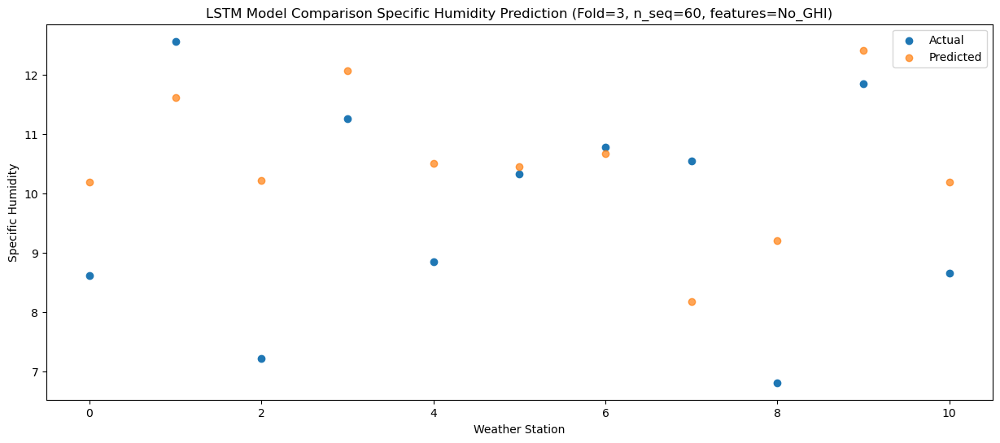

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   7.143100
1                 1    8.71   8.568182
2                 2    6.93   7.176331
3                 3    8.00   9.020062
4                 4    5.74   7.461493
5                 5    7.55   7.401916
6                 6    7.82   7.620366
7                 7    6.64   5.129088
8                 8    6.21   6.153548
9                 9    8.18   9.357266
10               10    5.64   7.145159


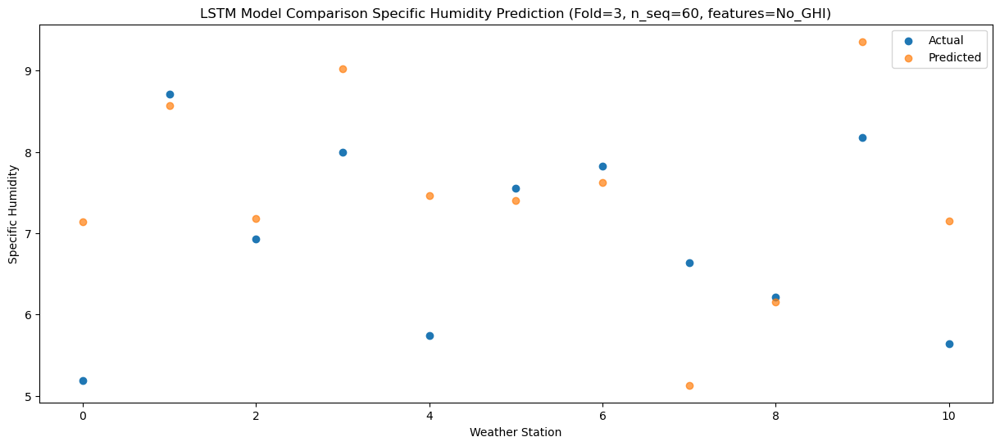

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96   2.569596
1                 1    4.25   3.993548
2                 2    5.76   2.605413
3                 3    2.85   4.445183
4                 4    0.74   2.885080
5                 5    2.25   2.825057
6                 6    6.21   3.047070
7                 7    3.91   0.558737
8                 8    4.90   1.585262
9                 9    5.55   4.784287
10               10    2.22   2.570876


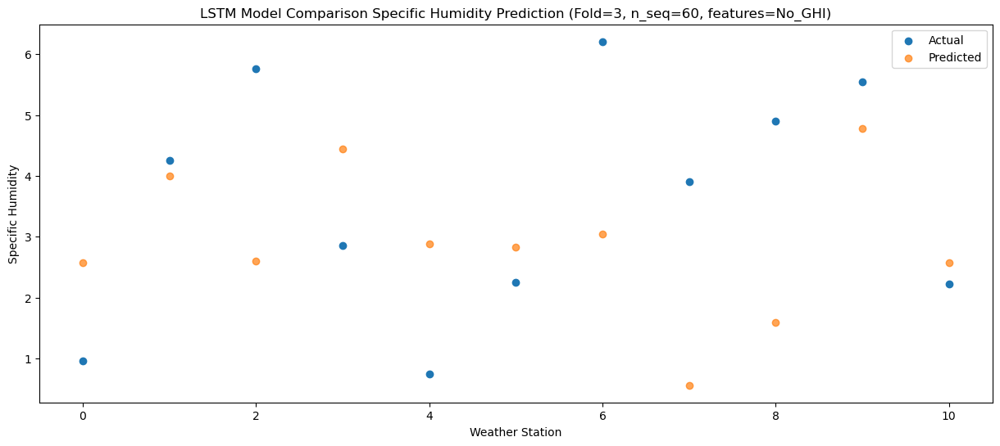

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51   1.778362
1                 1    3.22   3.202768
2                 2    3.04   1.813997
3                 3    2.04   3.653452
4                 4   -0.65   2.094256
5                 5    1.03   2.033000
6                 6    4.55   2.253244
7                 7    2.14  -0.234590
8                 8    2.65   0.793057
9                 9    3.70   3.990454
10               10    1.00   1.777515


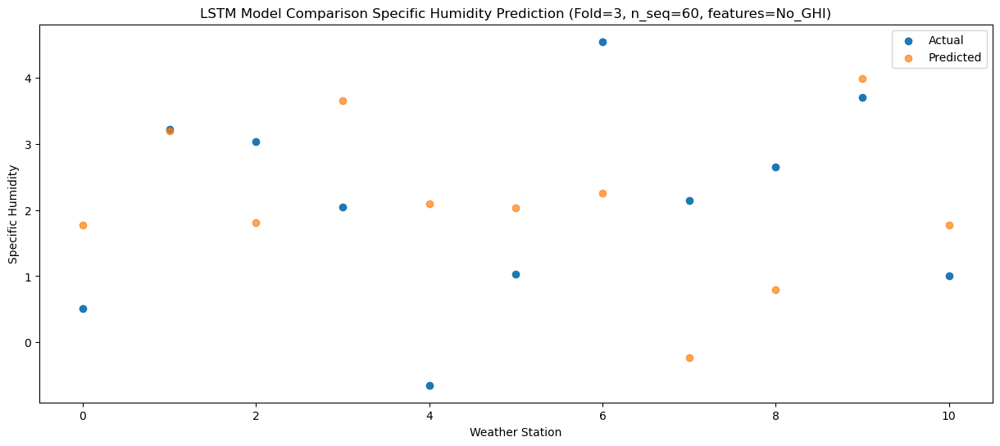

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69   0.245712
1                 1    2.03   1.673074
2                 2    3.88   0.284785
3                 3    1.01   2.122746
4                 4   -1.77   0.565503
5                 5    0.27   0.504810
6                 6    4.58   0.726607
7                 7    2.89  -1.761309
8                 8    3.44  -0.734071
9                 9    1.73   2.460710
10               10   -0.92   0.248575


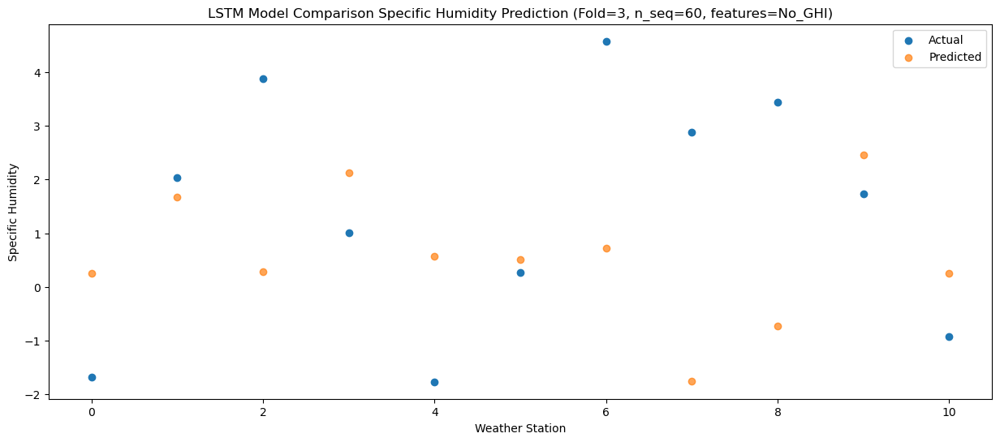

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78   0.637373
1                 1    1.95   2.064443
2                 2    4.03   0.671714
3                 3    1.55   2.512770
4                 4   -1.39   0.957260
5                 5    0.85   0.896520
6                 6    4.55   1.118749
7                 7    3.28  -1.372010
8                 8    3.27  -0.346601
9                 9    2.30   2.847622
10               10   -0.14   0.636488


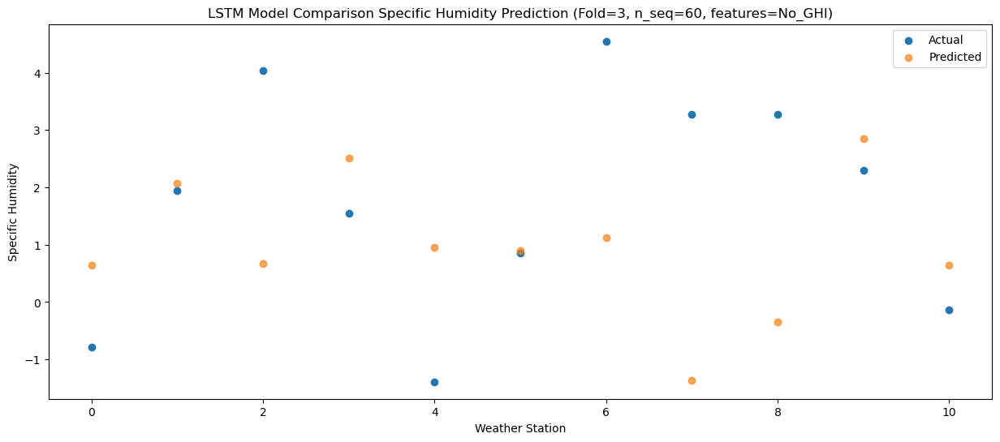

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05   0.929741
1                 1    2.11   2.356599
2                 2    2.90   0.963825
3                 3    1.37   2.806601
4                 4   -0.51   1.249524
5                 5    0.52   1.188591
6                 6    4.17   1.410517
7                 7    2.03  -1.082473
8                 8    2.41  -0.057374
9                 9    1.59   3.139066
10               10   -0.89   0.926752


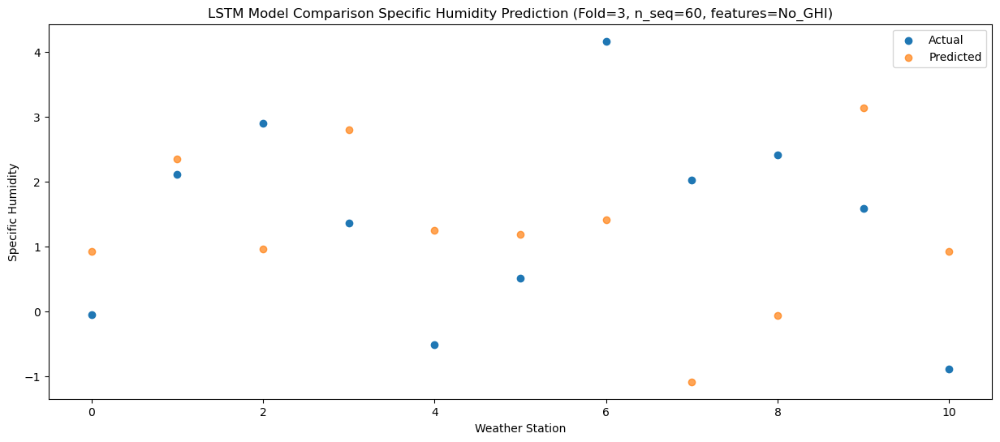

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44   1.228066
1                 1    3.05   2.657532
2                 2    4.42   1.264300
3                 3    1.24   3.105881
4                 4   -0.84   1.549417
5                 5    0.95   1.486322
6                 6    4.47   1.708425
7                 7    3.07  -0.781830
8                 8    3.21   0.244370
9                 9    1.80   3.436020
10               10   -0.76   1.223973


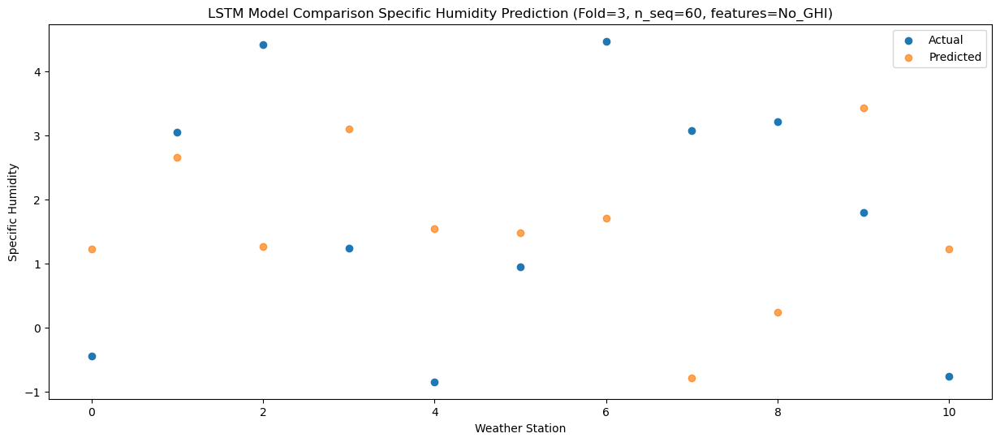

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55   2.594999
1                 1    3.92   4.025069
2                 2    4.62   2.629669
3                 3    2.78   4.473650
4                 4    0.39   2.916234
5                 5    2.26   2.854606
6                 6    5.10   3.075729
7                 7    2.22   0.582924
8                 8    3.59   1.606223
9                 9    4.04   4.801267
10               10    1.67   2.591164


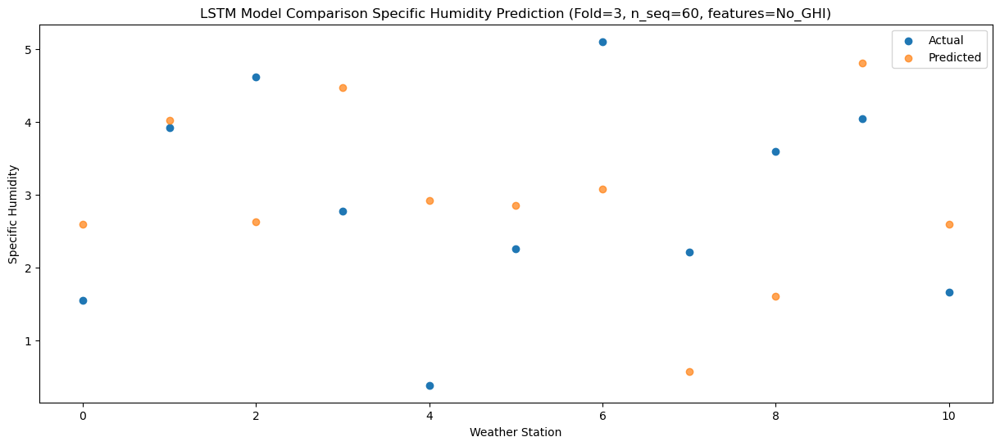

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00   5.408740
1                 1    8.33   6.839077
2                 2    5.56   5.442339
3                 3    5.69   7.288576
4                 4    3.57   5.731546
5                 5    4.86   5.670731
6                 6    7.26   5.889214
7                 7    3.76   3.396179
8                 8    5.18   4.417942
9                 9    4.56   7.615860
10               10    2.14   5.405414


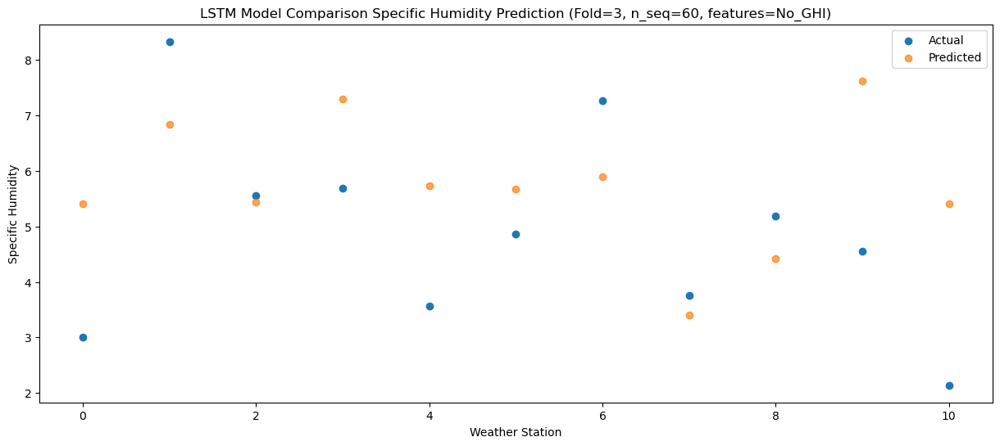

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27   7.925712
1                 1   10.97   9.358203
2                 2    6.33   7.957914
3                 3    7.71   9.809547
4                 4    5.70   8.253786
5                 5    7.02   8.195796
6                 6    7.49   8.407847
7                 7    4.26   5.911212
8                 8    5.24   6.930815
9                 9    8.26  10.131473
10               10    5.83   7.922268


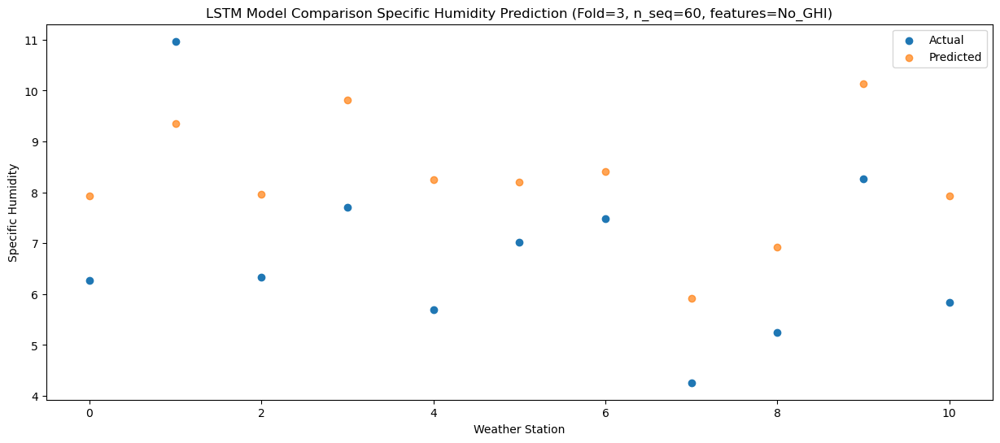

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22  11.057155
1                 1   13.24  12.490201
2                 2    7.43  11.086589
3                 3   11.36  12.940993
4                 4    9.47  11.386922
5                 5   11.53  11.330841
6                 6    8.33  11.539774
7                 7    5.23   9.041507
8                 8    6.08  10.058107
9                 9   13.11  13.262337
10               10    9.81  11.055430


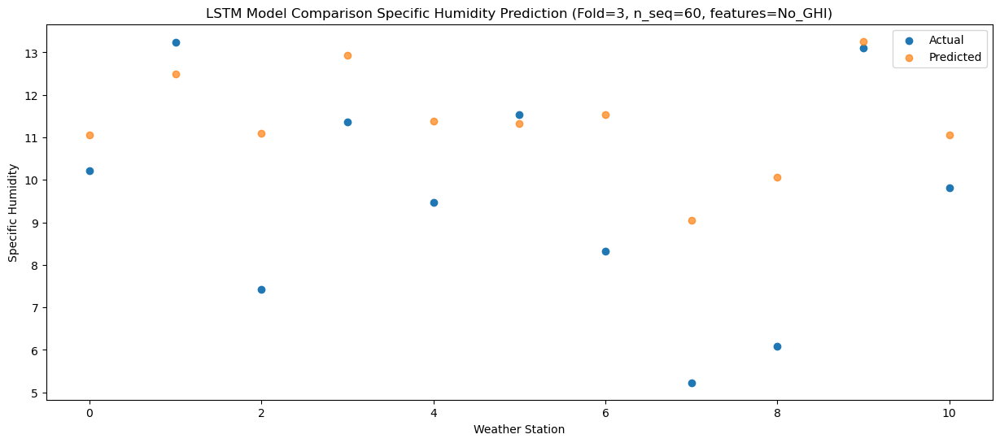

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32  10.446677
1                 1   13.48  11.880330
2                 2    8.50  10.477646
3                 3   10.81  12.330858
4                 4    9.86  10.776948
5                 5   10.65  10.720914
6                 6    9.98  10.930325
7                 7    7.81   8.431612
8                 8    7.35   9.448420
9                 9   10.54  12.651937
10               10    8.57  10.446472


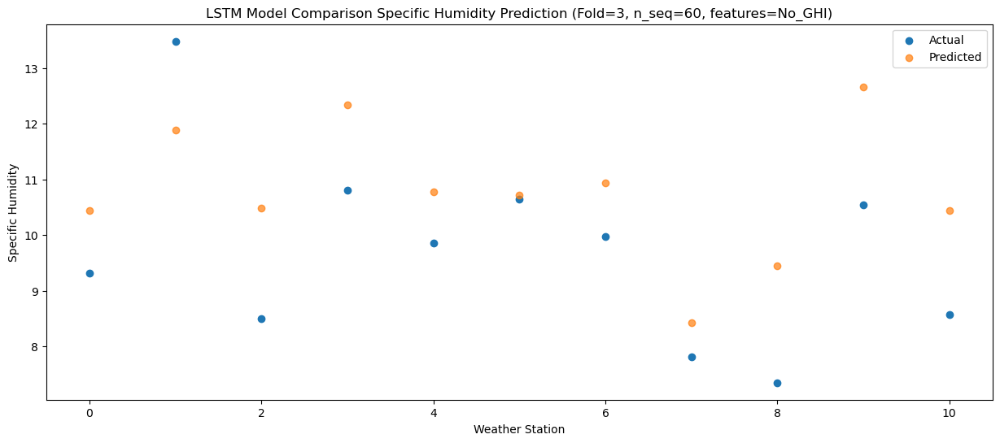

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   7.558925
1                 1    9.41   8.992854
2                 2    6.96   7.588812
3                 3    8.34   9.443068
4                 4    5.75   7.889448
5                 5    7.42   7.833760
6                 6    7.36   8.041201
7                 7    6.87   5.540175
8                 8    6.80   6.559091
9                 9    9.57   9.761985
10               10    6.88   7.559184


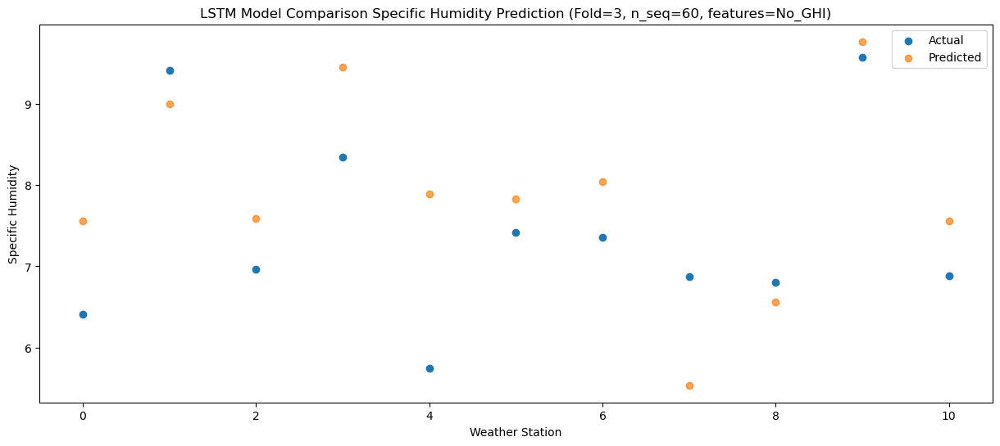

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30   4.274546
1                 1    5.97   5.706738
2                 2    5.80   4.304602
3                 3    4.81   6.157775
4                 4    2.13   4.603564
5                 5    4.04   4.548145
6                 6    6.11   4.757159
7                 7    3.81   2.256533
8                 8    5.37   3.275396
9                 9    6.18   6.479781
10               10    3.61   4.276707


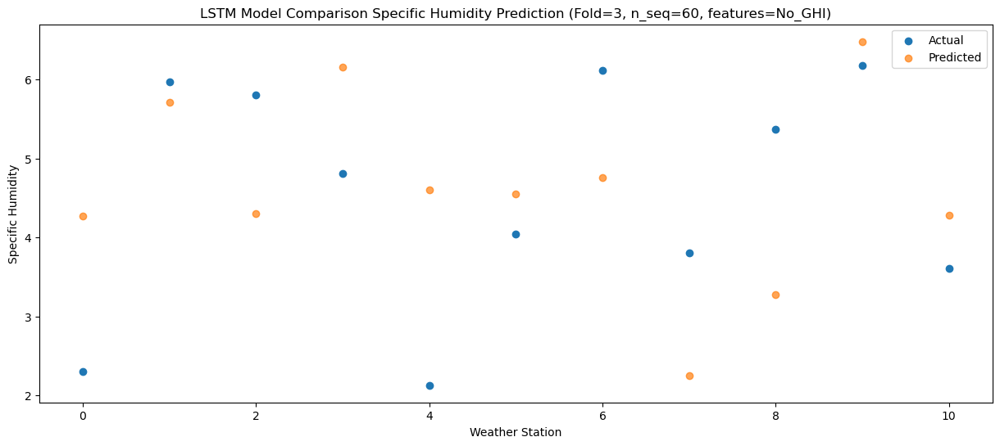

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93   1.325414
1                 1    3.09   2.755428
2                 2    3.69   1.356548
3                 3    1.42   3.205581
4                 4   -1.04   1.648540
5                 5    0.85   1.591942
6                 6    4.78   1.801057
7                 7    2.80  -0.695071
8                 8    4.28   0.325563
9                 9    2.38   3.524985
10               10   -0.07   1.321138


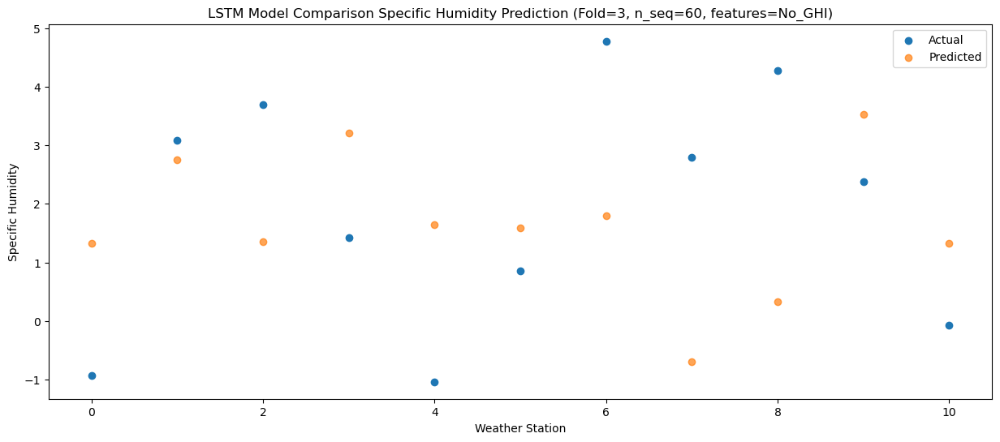

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94   1.072655
1                 1    2.27   2.500619
2                 2    3.92   1.101640
3                 3    1.44   2.952369
4                 4   -1.45   1.393648
5                 5    0.81   1.339189
6                 6    4.65   1.547723
7                 7    2.72  -0.949238
8                 8    4.66   0.070856
9                 9    2.71   3.271608
10               10    0.31   1.069047


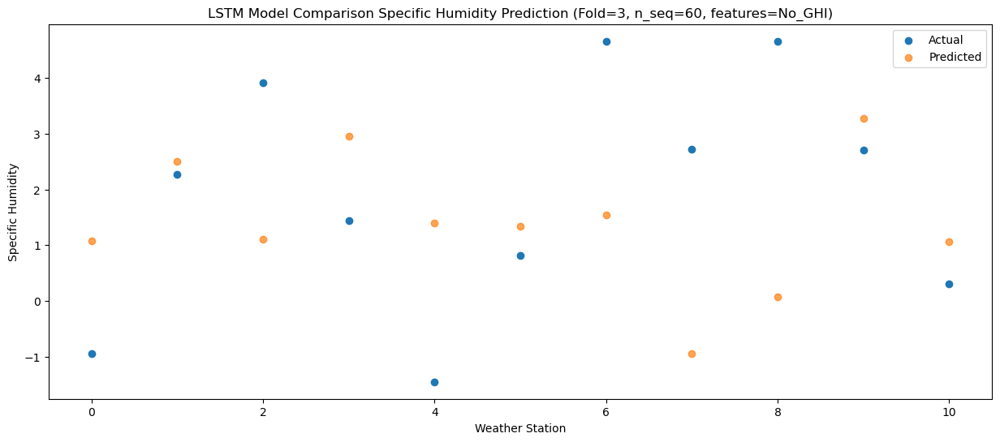

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59   0.083717
1                 1    0.96   1.508689
2                 2    4.46   0.114517
3                 3    0.70   1.962813
4                 4   -2.32   0.403225
5                 5   -0.07   0.348056
6                 6    4.59   0.558804
7                 7    3.26  -1.936288
8                 8    4.67  -0.915546
9                 9    1.41   2.283430
10               10   -0.82   0.080323


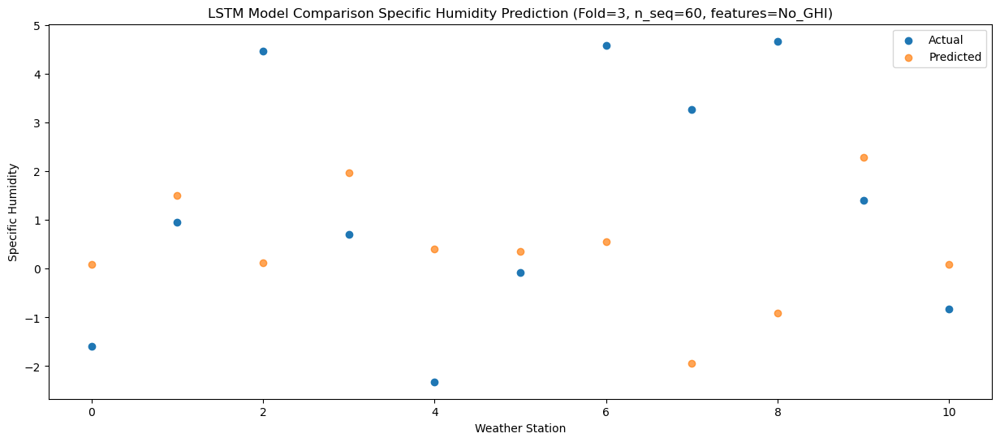

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53   0.813718
1                 1    2.38   2.239324
2                 2    4.63   0.848842
3                 3    1.02   2.693858
4                 4   -1.41   1.135211
5                 5    0.51   1.077729
6                 6    4.66   1.289639
7                 7    4.08  -1.202975
8                 8    4.36  -0.180098
9                 9    1.31   3.015020
10               10   -0.91   0.808440


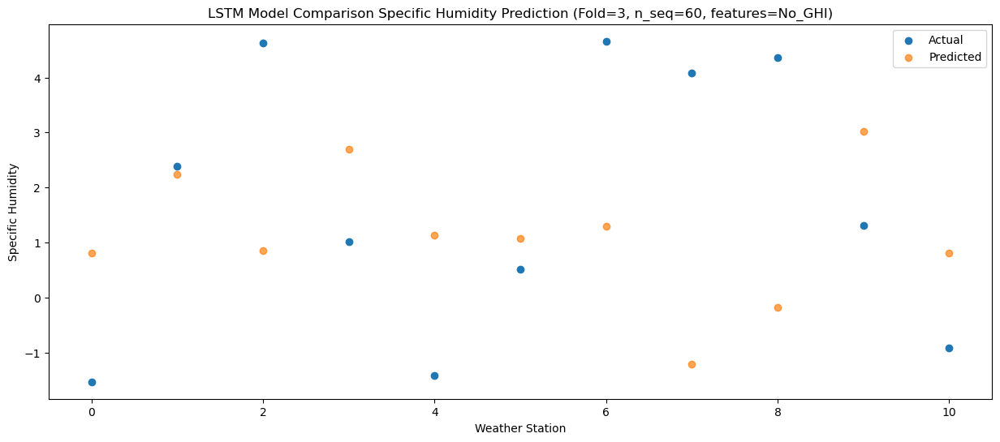

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03   1.949096
1                 1    3.80   3.374827
2                 2    4.34   1.981620
3                 3    1.98   3.825673
4                 4   -0.37   2.269189
5                 5    1.59   2.212130
6                 6    5.02   2.425107
7                 7    3.40  -0.067897
8                 8    4.16   0.952964
9                 9    2.36   4.145123
10               10    0.14   1.941192


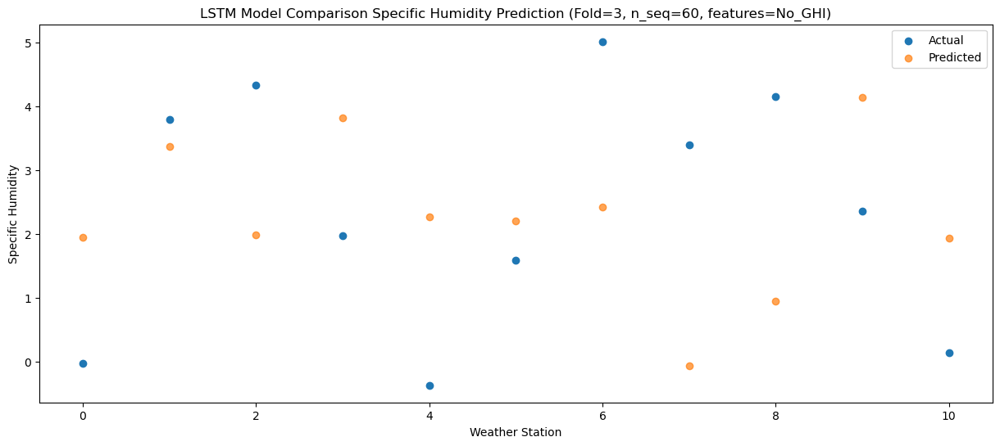

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01   3.769777
1                 1    5.34   5.194490
2                 2    5.02   3.802293
3                 3    3.89   5.647693
4                 4    1.45   4.089669
5                 5    3.84   4.032512
6                 6    5.70   4.246179
7                 7    3.10   1.751108
8                 8    4.60   2.771175
9                 9    3.27   5.964498
10               10    1.74   3.759714


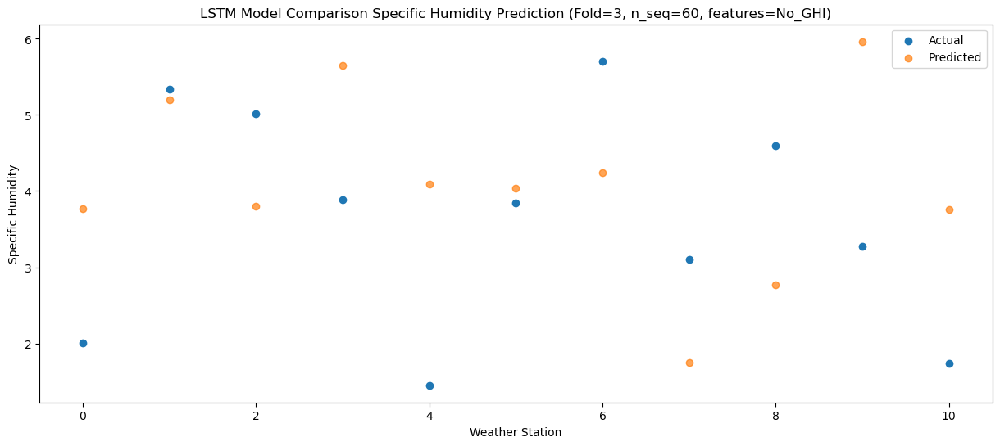

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88   7.204739
1                 1    9.84   8.632370
2                 2    4.89   7.234665
3                 3    8.00   9.084333
4                 4    5.59   7.529956
5                 5    7.51   7.475561
6                 6    6.59   7.684679
7                 7    2.97   5.185125
8                 8    4.76   6.200872
9                 9    6.73   9.400016
10               10    5.37   7.199112


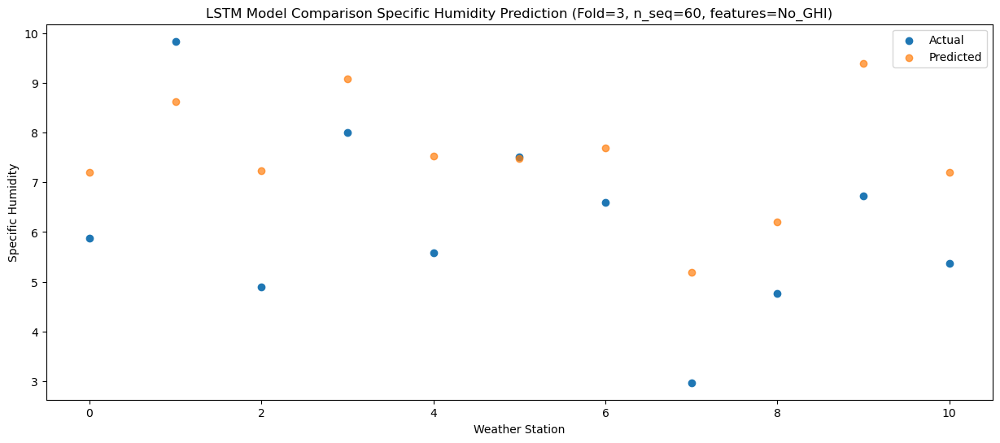

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61   9.543240
1                 1   12.12  10.971190
2                 2    6.16   9.574326
3                 3    9.80  11.420400
4                 4    7.56   9.867165
5                 5    9.33   9.811898
6                 6    8.88  10.022778
7                 7    4.37   7.524595
8                 8    5.91   8.539292
9                 9    9.60  11.735286
10               10    7.05   9.533997


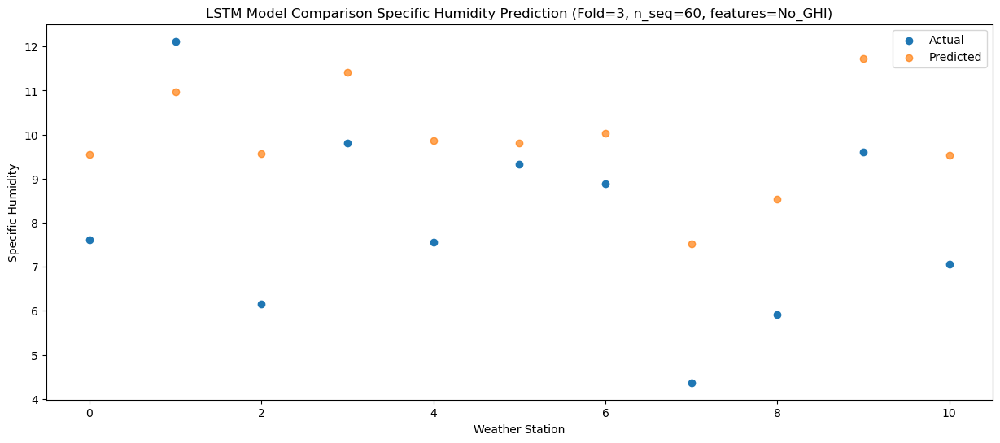

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47  10.912186
1                 1   12.61  12.341398
2                 2    8.14  10.940970
3                 3   10.70  12.790741
4                 4    9.13  11.239551
5                 5   10.52  11.184335
6                 6    8.93  11.393040
7                 7    5.40   8.892575
8                 8    7.49   9.903776
9                 9   12.77  13.107620
10               10    9.93  10.908512


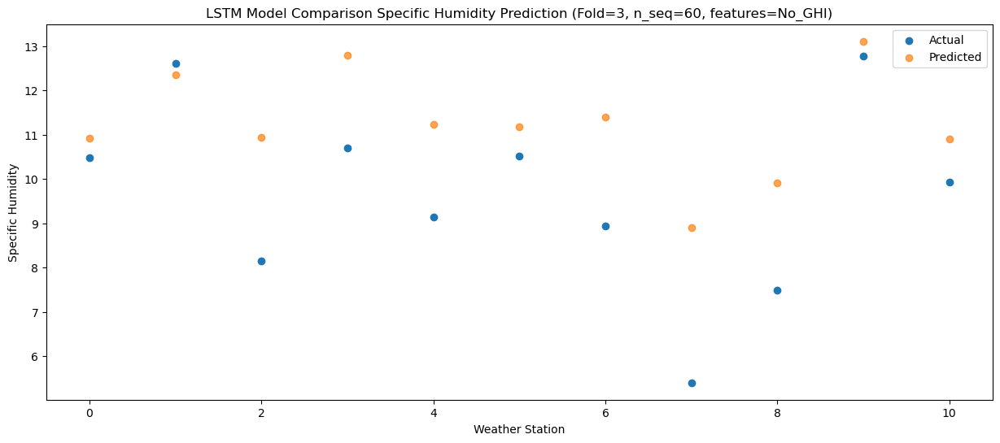

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03  10.656314
1                 1   11.87  12.087944
2                 2    6.45  10.689314
3                 3    9.38  12.535133
4                 4    8.65  10.985784
5                 5    9.96  10.927631
6                 6   10.39  11.139120
7                 7    6.22   8.641065
8                 8    6.76   9.655241
9                 9   11.42  12.855809
10               10    8.65  10.651641


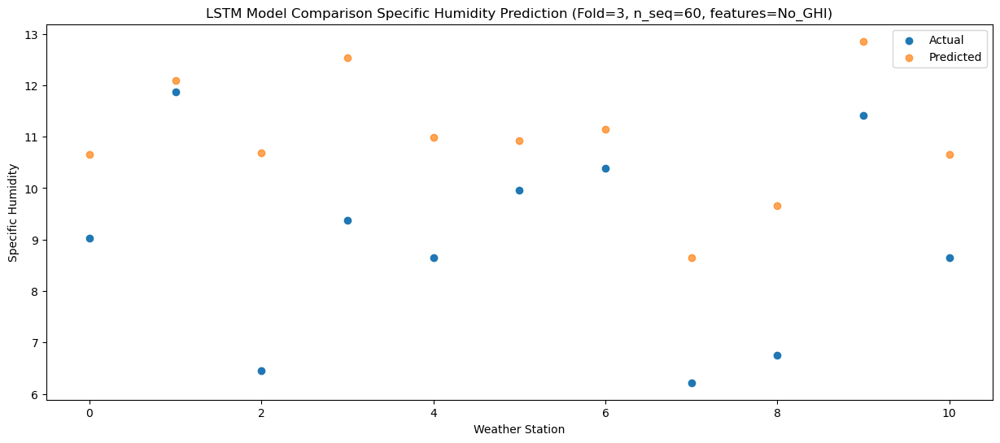

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32   8.249364
1                 1    8.88   9.678962
2                 2    6.72   8.278813
3                 3    7.84  10.126544
4                 4    5.64   8.577519
5                 5    7.34   8.521492
6                 6    7.97   8.729685
7                 7    4.50   6.229836
8                 8    6.44   7.244113
9                 9    8.06  10.450270
10               10    5.83   8.248830


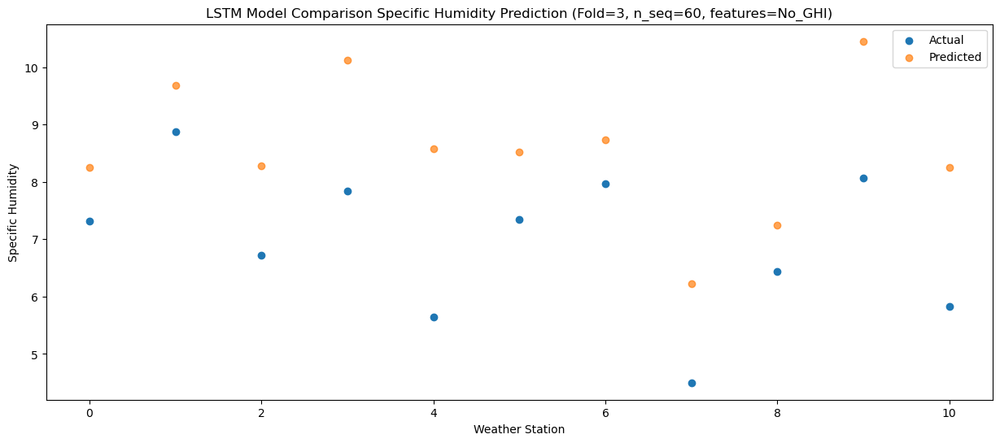

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50   4.337038
1                 1    4.65   5.764278
2                 2    5.61   4.372475
3                 3    4.09   6.212967
4                 4    1.28   4.661278
5                 5    3.47   4.601072
6                 6    6.21   4.812251
7                 7    3.45   2.319259
8                 8    4.85   3.337399
9                 9    4.96   6.539440
10               10    1.83   4.337120


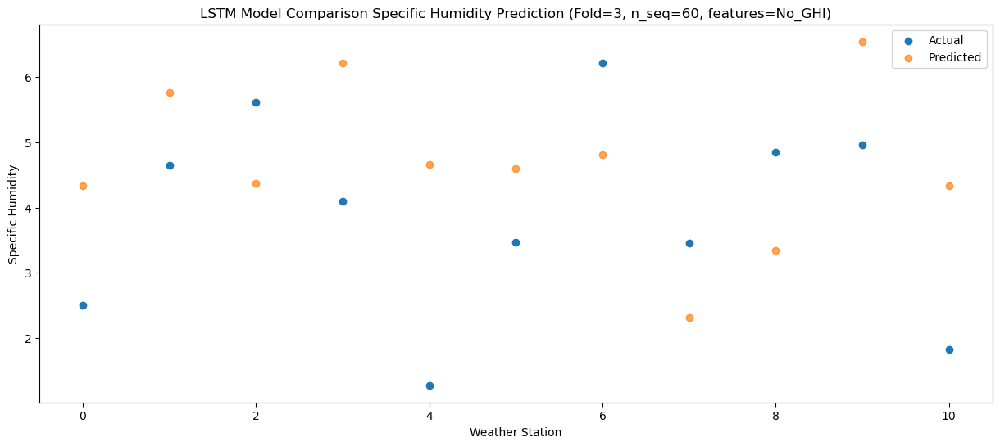

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

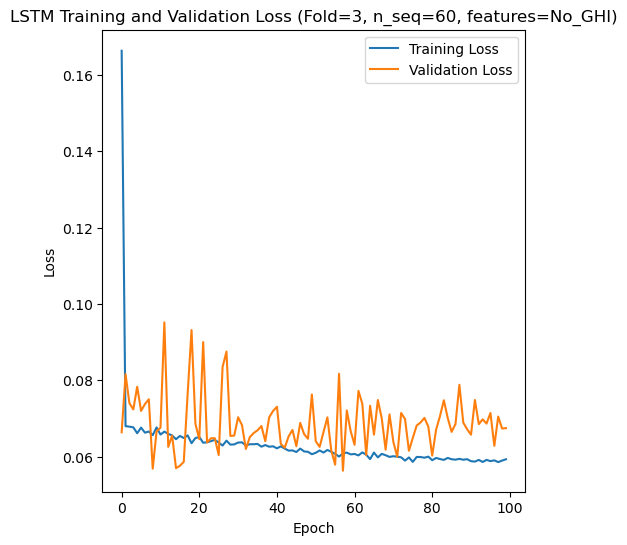

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 42s 201ms/step - loss: 0.1412 - accuracy: 0.3452 - mae: 0.1110 - rmse: 0.1412 - mape: 24.2100 - pearson: 0.6266 - val_loss: 0.0621 - val_accuracy: 0.7000 - val_mae: 0.0483 - val_rmse: 0.0621 - val_mape: 10.7878 - val_pearson: 0.7761
Epoch 2/100
84/84 [==============================] - 9s 113ms/step - loss: 0.0701 - accuracy: 0.4762 - mae: 0.0551 - rmse: 0.0701 - mape: 12.5236 - pearson: 0.7554 - val_loss: 0.0609 - val_accuracy: 0.7000 - val_mae: 0.0483 - val_rmse: 0.0609 - val_mape: 10.6514 - val_pearson: 0.7915
Epoch 3/100
84/84 [==============================] - 10s 114ms/step - loss: 0.0694 - accuracy: 0.4286 - mae: 0.0542 - rmse: 0.0694 - mape: 12.2928 - pearson: 0.7613 

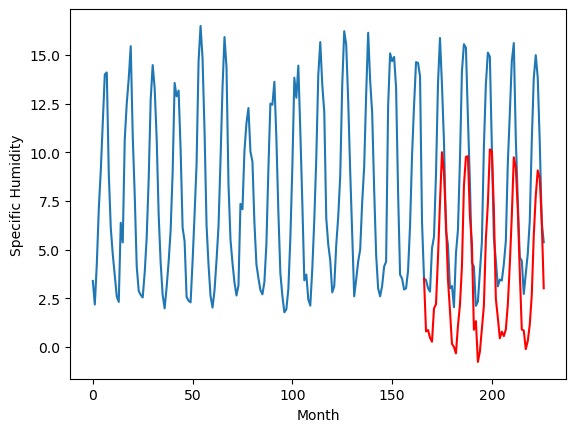

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		0.36		2.24
-1.74		0.44		2.18
-3.30		0.04		3.34
-2.46		-0.16		2.30
-1.08		1.55		2.63
0.13		1.77		1.64
0.78		4.18		3.40
4.11		6.98		2.87
5.85		9.57		3.72
6.09		8.52		2.43
5.51		5.99		0.48
3.47		3.03		-0.44
0.41		1.45		1.04
-4.33		-0.27		4.06
-3.98		-0.44		3.54
-1.99		-0.77		1.22
-2.02		0.64		2.66
-1.27		1.71		2.98
0.06		3.69		3.63
4.35		7.84		3.49
5.56		9.31		3.75
5.95		9.35		3.40
5.15		6.28		1.13
2.23		4.84		2.61
-2.43		0.43		2.86
-0.69		0.88		1.57
-4.55		-1.22		3.33
-2.97		-0.68		2.29
-1.44		0.48		1.92
-0.15		1.66		1.81
2.24		5.10		2.86
5.14		6.90		1.76
6.17		9.69		3.52
6.25		9.60		3.35
5.38		6.62		1.24
0.60		2.02		1.42
0.77		1.04		0.27
-2.75		-0.01		2.74
-3.26		0.33		3.59
-1.32		0.10		1.42
-0.94		0.44		1.38
0.55		1.72		1.17
1.35		3.80		2.45
4.86		6.28		1.42
6.77		9.27		2.50
7.07		8.76		1.69
4.62		6.60		1.98
1.00		3.37		2.37
-1.30		0.43		1.73
-2.39		0.37		2.76
-3.43		-0.58		2.85
-4.12	

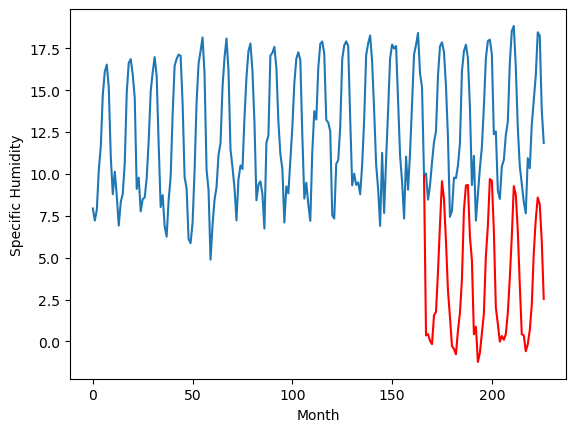

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		4.90		2.00
3.74		4.97		1.23
3.60		4.58		0.98
3.41		4.37		0.96
6.96		6.09		-0.87
5.84		6.30		0.46
8.08		8.71		0.63
11.38		11.51		0.13
14.31		14.11		-0.20
12.80		13.06		0.26
10.75		10.53		-0.22
7.40		7.57		0.17
4.73		5.99		1.26
2.35		4.27		1.92
2.24		4.10		1.86
2.12		3.77		1.65
5.18		5.18		0.00
5.43		6.25		0.82
8.87		8.22		-0.65
13.11		12.38		-0.73
14.76		13.85		-0.91
14.77		13.89		-0.88
11.83		10.82		-1.01
9.05		9.39		0.34
3.61		4.97		1.36
6.56		5.42		-1.14
1.83		3.32		1.49
2.68		3.86		1.18
3.73		5.02		1.29
6.18		6.20		0.02
10.78		9.65		-1.13
13.16		11.44		-1.72
15.00		14.24		-0.76
14.82		14.14		-0.68
10.58		11.16		0.58
5.62		6.56		0.94
4.87		5.58		0.71
4.33		4.53		0.20
4.23		4.87		0.64
4.90		4.64		-0.26
5.23		4.98		-0.25
6.07		6.26		0.19
9.45		8.35		-1.10
13.02		10.83		-2.19
14.61		13.82		-0.79
13.03		13.30		0.27
10.01		11.14		1.13
6.08		7.91		1.83
4.10		4.97		0.87
2.79		4.91		2.12
2.07

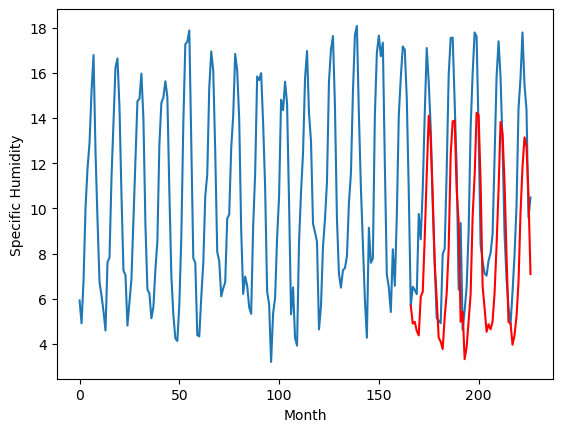

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		2.88		-0.32
2.20		2.96		0.76
2.84		2.56		-0.28
2.22		2.36		0.14
6.17		4.08		-2.09
5.77		4.29		-1.48
8.93		6.70		-2.23
11.09		9.50		-1.59
14.32		12.09		-2.23
11.73		11.05		-0.68
10.52		8.51		-2.01
5.95		5.56		-0.39
4.31		3.97		-0.34
1.71		2.26		0.55
1.60		2.09		0.49
1.28		1.76		0.48
3.94		3.17		-0.77
5.23		4.24		-0.99
9.23		6.22		-3.01
12.92		10.38		-2.54
13.49		11.85		-1.64
13.88		11.89		-1.99
9.87		8.81		-1.06
7.02		7.38		0.36
3.40		2.97		-0.43
5.26		3.42		-1.84
0.60		1.31		0.71
1.13		1.86		0.73
2.72		3.02		0.30
6.23		4.20		-2.03
10.22		7.64		-2.58
11.99		9.44		-2.55
11.41		12.24		0.83
12.42		12.14		-0.28
9.14		9.16		0.02
4.68		4.56		-0.12
4.50		3.58		-0.92
2.92		2.53		-0.39
2.23		2.87		0.64
2.59		2.64		0.05
4.65		2.98		-1.67
5.33		4.26		-1.07
9.59		6.35		-3.24
13.53		8.83		-4.70
13.38		11.82		-1.56
11.28		11.30		0.02
10.38		9.15		-1.23
6.66		5.92		-0.74
4.13		2.98		-1.15
2.38		2.92		0

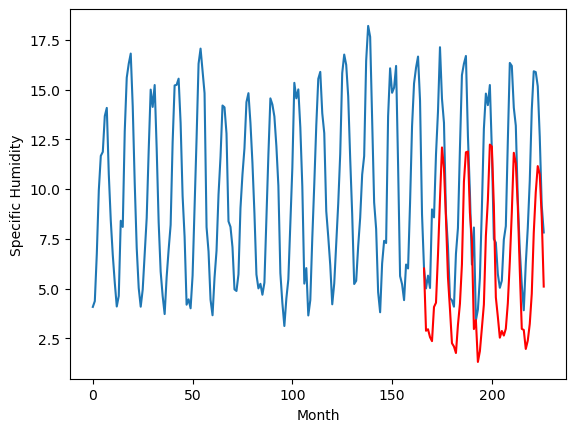

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		1.04		-0.25
0.32		1.12		0.80
1.01		0.72		-0.29
0.35		0.52		0.17
4.25		2.24		-2.01
3.74		2.45		-1.29
6.98		4.86		-2.12
8.96		7.66		-1.30
12.11		10.26		-1.85
9.46		9.21		-0.25
8.57		6.68		-1.89
3.80		3.72		-0.08
2.44		2.14		-0.30
-0.13		0.42		0.55
-0.17		0.25		0.42
-0.62		-0.08		0.54
1.96		1.34		-0.62
3.32		2.41		-0.91
7.61		4.39		-3.22
11.49		8.54		-2.95
11.87		10.01		-1.86
11.98		10.05		-1.93
8.08		6.98		-1.10
5.35		5.55		0.20
1.74		1.13		-0.61
3.15		1.58		-1.57
-1.18		-0.52		0.66
-0.74		0.02		0.76
0.78		1.18		0.40
4.46		2.36		-2.10
8.34		5.80		-2.54
10.02		7.60		-2.42
9.52		10.40		0.88
10.69		10.30		-0.39
7.54		7.32		-0.22
3.08		2.72		-0.36
2.66		1.74		-0.92
1.07		0.69		-0.38
0.32		1.03		0.71
0.72		0.80		0.08
2.69		1.14		-1.55
3.54		2.42		-1.12
7.81		4.51		-3.30
11.29		6.99		-4.30
10.39		9.98		-0.41
9.01		9.46		0.45
8.68		7.31		-1.37
5.02		4.08		-0.94
2.60		1.14		-1.46
0.84		1.08		0.24

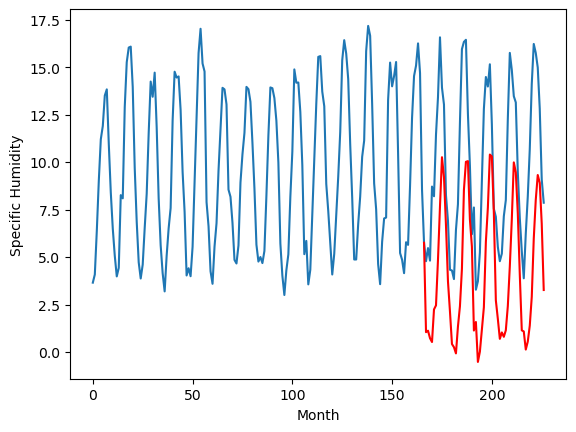

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		0.62		-2.01
1.39		0.69		-0.70
1.27		0.30		-0.97
1.15		0.09		-1.06
3.95		1.81		-2.14
3.20		2.02		-1.18
5.47		4.43		-1.04
7.18		7.23		0.05
8.41		9.82		1.41
7.10		8.77		1.67
6.91		6.24		-0.67
3.26		3.29		0.03
2.80		1.70		-1.10
0.24		-0.02		-0.26
0.94		-0.18		-1.12
0.30		-0.51		-0.81
1.79		0.91		-0.88
2.75		1.97		-0.78
7.30		3.95		-3.35
9.60		8.10		-1.50
10.63		9.58		-1.05
10.35		9.61		-0.74
7.10		6.54		-0.56
4.05		5.11		1.06
2.33		0.69		-1.64
1.48		1.14		-0.34
0.02		-0.96		-0.98
0.01		-0.42		-0.43
0.60		0.74		0.14
2.63		1.92		-0.71
4.89		5.37		0.48
7.74		7.16		-0.58
8.43		9.96		1.53
10.42		9.86		-0.56
9.17		6.88		-2.29
5.66		2.28		-3.38
2.96		1.30		-1.66
2.32		0.25		-2.07
0.77		0.59		-0.18
0.89		0.36		-0.53
2.18		0.70		-1.48
2.15		1.98		-0.17
6.99		4.07		-2.92
10.85		6.55		-4.30
8.52		9.54		1.02
7.66		9.02		1.36
8.17		6.87		-1.30
6.04		3.64		-2.40
3.74		0.70		-3.04
2.16		0.64		-1.52
0.89		

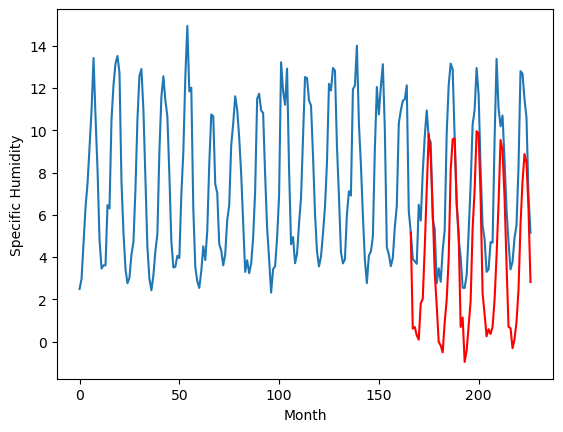

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-0.55		2.42
-2.90		-0.47		2.43
-3.06		-0.87		2.19
-2.48		-1.07		1.41
-0.29		0.65		0.94
-0.96		0.86		1.82
2.16		3.27		1.11
5.99		6.07		0.08
8.58		8.66		0.08
8.79		7.61		-1.18
4.95		5.08		0.13
2.30		2.13		-0.17
-0.53		0.54		1.07
-3.87		-1.18		2.69
-3.99		-1.35		2.64
-3.74		-1.67		2.07
-2.03		-0.26		1.77
-1.62		0.80		2.42
1.36		2.78		1.42
6.05		6.94		0.89
7.65		8.41		0.76
8.03		8.45		0.42
4.45		5.37		0.92
2.24		3.94		1.70
-3.48		-0.48		3.00
-1.62		-0.03		1.59
-4.60		-2.13		2.47
-3.28		-1.59		1.69
-2.44		-0.43		2.01
-1.38		0.75		2.13
2.63		4.20		1.57
4.91		5.99		1.08
8.07		8.79		0.72
6.88		8.69		1.81
3.33		5.70		2.37
-1.35		1.11		2.46
-1.53		0.13		1.66
-3.52		-0.92		2.60
-2.89		-0.59		2.30
-1.85		-0.82		1.03
-2.36		-0.47		1.89
-0.76		0.80		1.56
1.46		2.89		1.43
4.51		5.37		0.86
7.90		8.37		0.47
7.44		7.85		0.41
3.99		5.69		1.70
0.08		2.46		2.38
-2.87		-0.48		2.39
-3.15		-0.54		2.61
-3.93		

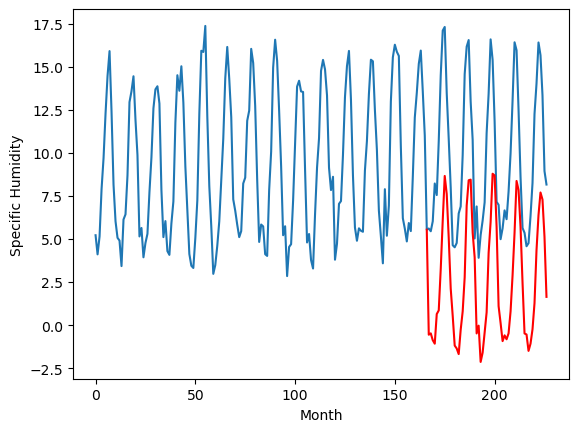

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		2.18		0.37
1.54		2.26		0.72
1.30		1.86		0.56
1.07		1.66		0.59
3.62		3.38		-0.24
3.94		3.59		-0.35
7.32		6.00		-1.32
10.93		8.80		-2.13
12.98		11.39		-1.59
10.33		10.35		0.02
8.73		7.81		-0.92
4.18		4.86		0.68
2.51		3.27		0.76
0.58		1.55		0.97
0.43		1.39		0.96
-0.20		1.06		1.26
2.17		2.47		0.30
3.09		3.54		0.45
6.25		5.52		-0.73
10.85		9.68		-1.17
11.80		11.15		-0.65
11.54		11.18		-0.36
8.28		8.11		-0.17
6.19		6.68		0.49
1.50		2.26		0.76
2.97		2.71		-0.26
-0.23		0.61		0.84
0.28		1.15		0.87
1.79		2.31		0.52
3.58		3.49		-0.09
8.29		6.93		-1.36
10.65		8.73		-1.92
11.45		11.53		0.08
11.92		11.43		-0.49
8.11		8.44		0.33
3.45		3.84		0.39
2.09		2.86		0.77
1.22		1.82		0.60
1.50		2.15		0.65
1.31		1.92		0.61
2.07		2.27		0.20
2.97		3.54		0.57
7.36		5.63		-1.73
9.92		8.12		-1.80
12.71		11.11		-1.60
12.99		10.59		-2.40
8.79		8.44		-0.35
5.18		5.21		0.03
2.15		2.27		0.12
1.34		2.21		0.87
0.19		1.25		1

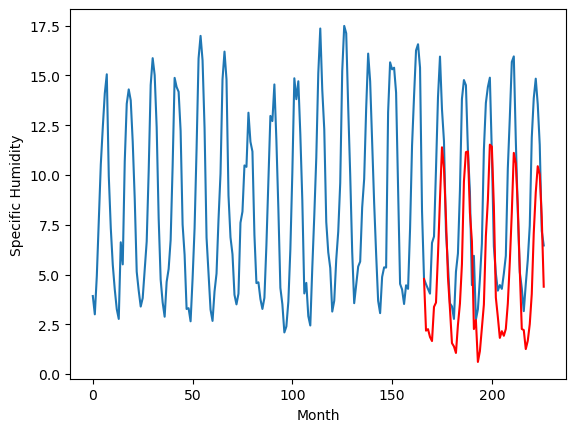

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		0.88		0.48
0.57		0.95		0.38
0.20		0.56		0.36
-0.20		0.35		0.55
1.72		2.07		0.35
2.00		2.29		0.29
5.15		4.70		-0.45
7.89		7.51		-0.38
11.11		10.10		-1.01
9.44		9.05		-0.39
6.52		6.52		-0.00
3.14		3.56		0.42
1.46		1.98		0.52
-0.14		0.26		0.40
-0.49		0.09		0.58
-1.06		-0.24		0.82
0.88		1.17		0.29
2.21		2.24		0.03
4.50		4.22		-0.28
9.56		8.38		-1.18
10.82		9.85		-0.97
10.96		9.89		-1.07
7.48		6.81		-0.67
6.33		5.38		-0.95
0.56		0.97		0.41
1.27		1.42		0.15
-1.11		-0.69		0.42
-0.53		-0.15		0.38
0.78		1.02		0.24
2.27		2.19		-0.08
6.29		5.64		-0.65
7.73		7.43		-0.30
10.47		10.23		-0.24
10.11		10.13		0.02
7.45		7.15		-0.30
2.12		2.55		0.43
1.08		1.57		0.49
0.12		0.53		0.41
0.74		0.86		0.12
0.34		0.63		0.29
0.69		0.98		0.29
2.14		2.25		0.11
4.39		4.34		-0.05
6.35		6.82		0.47
10.65		9.82		-0.83
10.11		9.30		-0.81
7.31		7.15		-0.16
3.98		3.91		-0.07
0.91		0.97		0.06
0.88		0.92		0.04
-0.20		-0.04		0

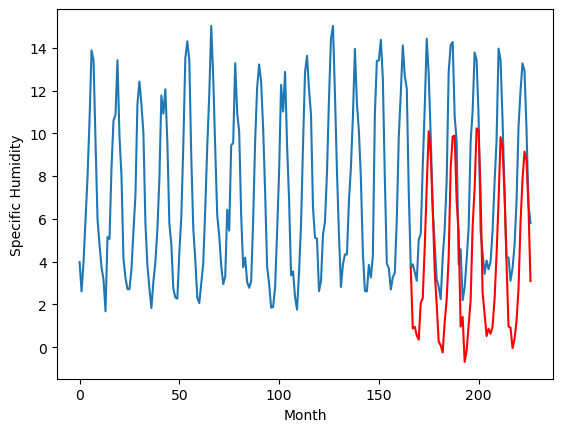

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		0.94		-0.01
1.12		1.01		-0.11
0.64		0.62		-0.02
0.37		0.41		0.04
2.42		2.13		-0.29
3.01		2.35		-0.66
6.73		4.75		-1.98
9.21		7.57		-1.64
12.77		10.16		-2.61
10.58		9.11		-1.47
7.80		6.58		-1.22
3.64		3.63		-0.01
2.55		2.04		-0.51
0.64		0.32		-0.32
0.32		0.15		-0.17
-0.32		-0.18		0.14
2.05		1.23		-0.82
3.36		2.30		-1.06
5.98		4.28		-1.70
10.73		8.44		-2.29
12.13		9.91		-2.22
12.38		9.95		-2.43
8.35		6.88		-1.47
6.48		5.45		-1.03
1.19		1.03		-0.16
1.73		1.48		-0.25
-0.51		-0.62		-0.11
0.19		-0.08		-0.27
1.71		1.08		-0.63
3.01		2.26		-0.75
7.08		5.71		-1.37
9.32		7.50		-1.82
11.96		10.30		-1.66
11.19		10.20		-0.99
7.82		7.22		-0.60
3.06		2.62		-0.44
1.69		1.64		-0.05
0.58		0.59		0.01
1.10		0.94		-0.16
0.87		0.70		-0.17
1.48		1.04		-0.44
2.99		2.32		-0.67
5.77		4.41		-1.36
7.41		6.89		-0.52
12.11		9.89		-2.22
11.98		9.38		-2.60
8.20		7.22		-0.98
4.76		3.99		-0.77
1.37		1.05		-0.32
1.86		0.

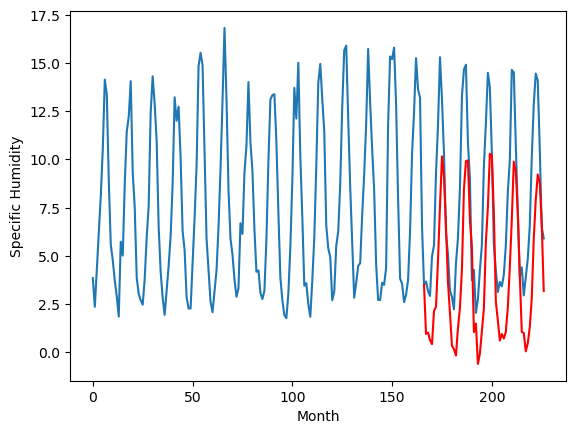

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		0.80		0.65
0.30		0.87		0.57
-0.04		0.47		0.51
-0.39		0.27		0.66
1.18		1.99		0.81
1.02		2.20		1.18
3.64		4.61		0.97
6.83		7.42		0.59
9.75		10.02		0.27
8.33		8.98		0.65
6.19		6.44		0.25
3.15		3.49		0.34
1.22		1.90		0.68
-0.11		0.18		0.29
-0.49		0.01		0.50
-1.06		-0.32		0.74
0.23		1.09		0.86
1.90		2.15		0.25
3.50		4.13		0.63
8.51		8.30		-0.21
9.78		9.76		-0.02
10.65		9.81		-0.84
6.89		6.73		-0.16
5.88		5.30		-0.58
0.64		0.89		0.25
0.60		1.34		0.74
-1.14		-0.76		0.38
-0.69		-0.22		0.47
0.46		0.94		0.48
1.45		2.12		0.67
4.91		5.56		0.65
6.82		7.36		0.54
8.55		10.16		1.61
9.01		10.06		1.05
7.02		7.08		0.06
2.20		2.48		0.28
1.48		1.51		0.03
0.03		0.46		0.43
0.65		0.80		0.15
-0.10		0.57		0.67
0.11		0.91		0.80
1.81		2.18		0.37
2.71		4.27		1.56
5.95		6.75		0.80
9.57		9.75		0.18
8.77		9.23		0.46
7.06		7.08		0.02
4.00		3.85		-0.15
0.56		0.90		0.34
1.08		0.85		-0.23
0.01		-0.10		-0.11
0.03		0.32		0

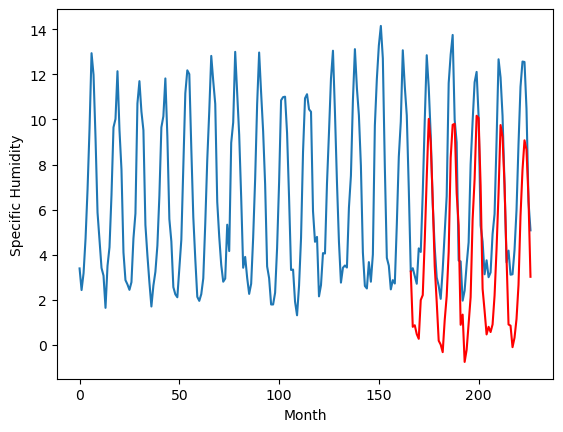

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95   0.806578
1                 1   -1.88   0.358921
2                 2    2.90   4.896664
3                 3    3.20   2.881155
4                 4    1.29   1.042689
5                 5    2.63   0.616511
6                 6   -2.97  -0.549969
7                 7    1.81   2.180842
8                 8    0.40   0.880560
9                 9    0.95   0.940924
10               10    0.15   0.798434


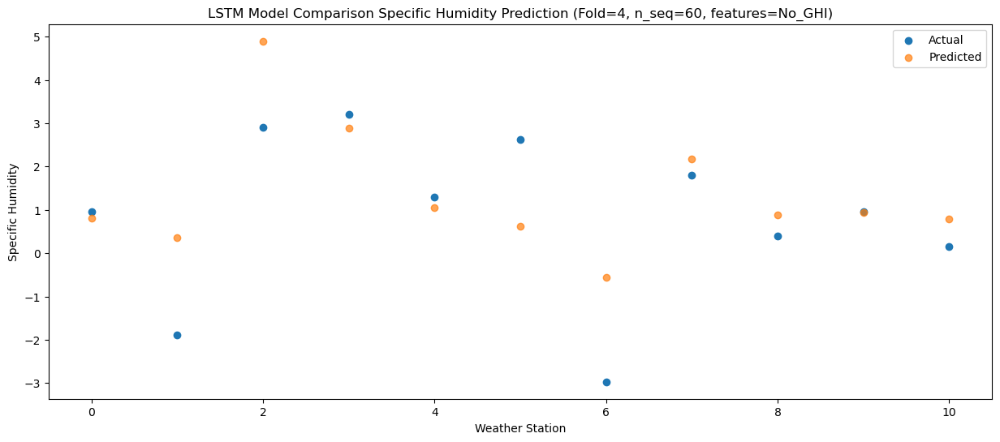

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.877153
1                 1   -1.74   0.436106
2                 2    3.74   4.972360
3                 3    2.20   2.956450
4                 4    0.32   1.118963
5                 5    1.39   0.692104
6                 6   -2.90  -0.473403
7                 7    1.54   2.255485
8                 8    0.57   0.952257
9                 9    1.12   1.010806
10               10    0.30   0.867545


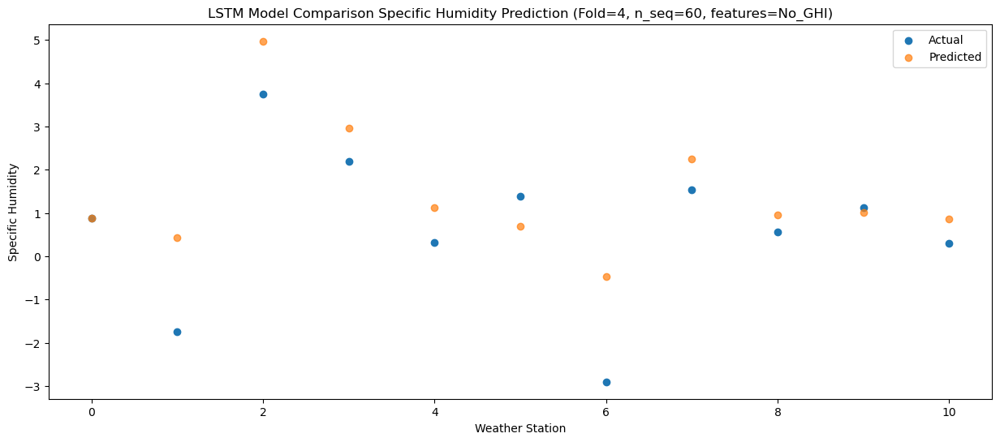

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46   0.483989
1                 1   -3.30   0.043370
2                 2    3.60   4.577578
3                 3    2.84   2.560782
4                 4    1.01   0.724303
5                 5    1.27   0.296113
6                 6   -3.06  -0.869584
7                 7    1.30   1.860572
8                 8    0.20   0.557857
9                 9    0.64   0.617669
10               10   -0.04   0.473957


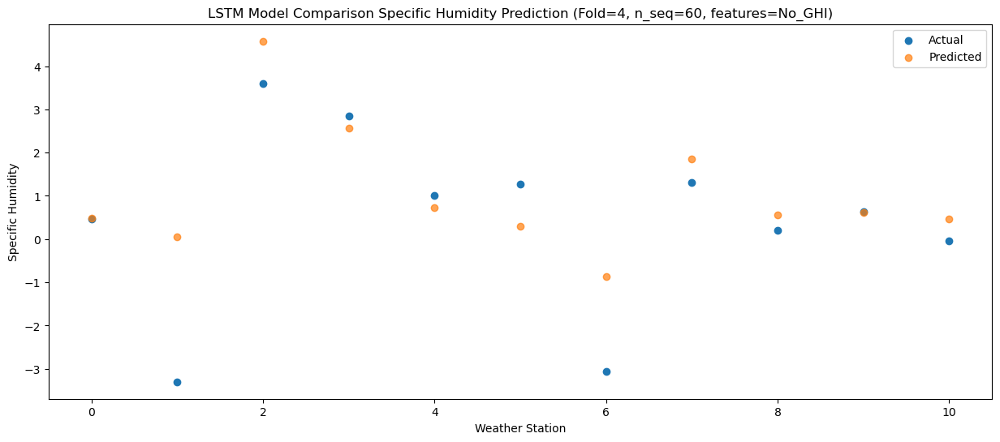

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28   0.277596
1                 1   -2.46  -0.160984
2                 2    3.41   4.374163
3                 3    2.22   2.359904
4                 4    0.35   0.524012
5                 5    1.15   0.094162
6                 6   -2.48  -1.071046
7                 7    1.07   1.658728
8                 8   -0.20   0.353888
9                 9    0.37   0.411381
10               10   -0.39   0.266060


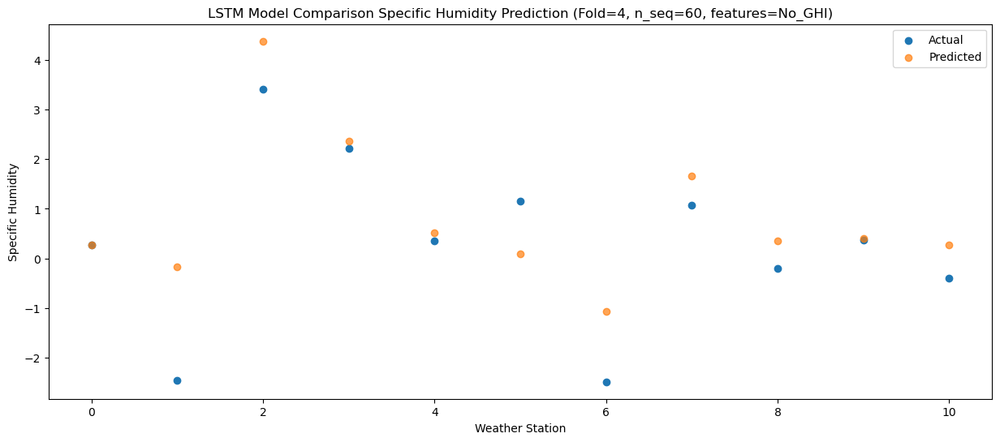

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   1.989572
1                 1   -1.08   1.553792
2                 2    6.96   6.090941
3                 3    6.17   4.076554
4                 4    4.25   2.240779
5                 5    3.95   1.810261
6                 6   -0.29   0.647479
7                 7    3.62   3.376497
8                 8    1.72   2.073742
9                 9    2.42   2.130206
10               10    1.18   1.987662


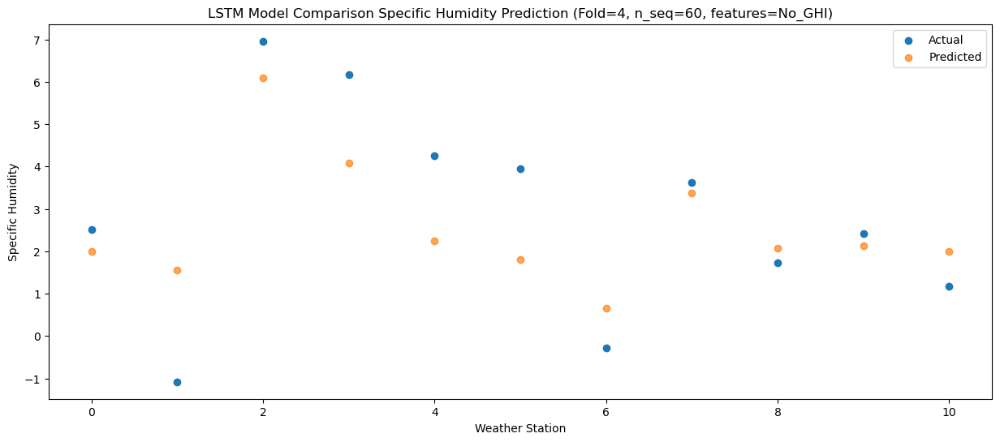

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   2.205087
1                 1    0.13   1.768030
2                 2    5.84   6.304307
3                 3    5.77   4.289653
4                 4    3.74   2.453133
5                 5    3.20   2.019911
6                 6   -0.96   0.858953
7                 7    3.94   3.590550
8                 8    2.00   2.288909
9                 9    3.01   2.346594
10               10    1.02   2.204849


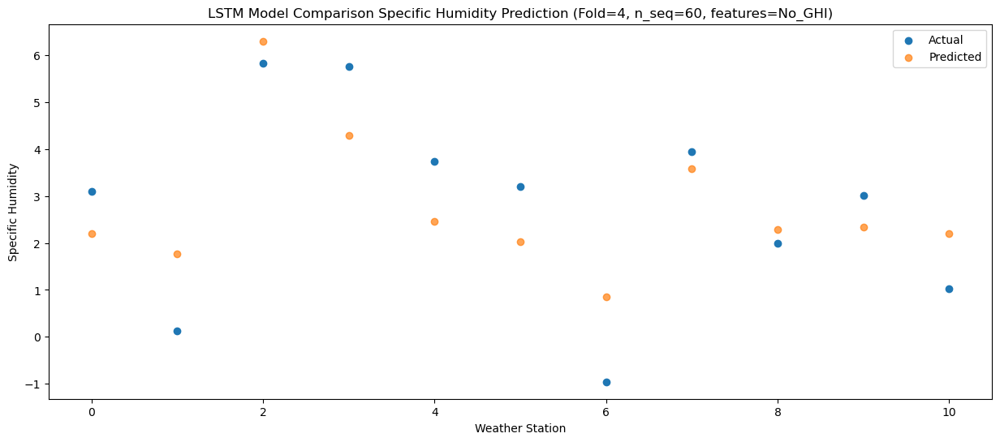

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   4.613570
1                 1    0.78   4.176030
2                 2    8.08   8.710205
3                 3    8.93   6.697228
4                 4    6.98   4.861121
5                 5    5.47   4.431033
6                 6    2.16   3.266301
7                 7    7.32   5.997571
8                 8    5.15   4.695899
9                 9    6.73   4.753502
10               10    3.64   4.610898


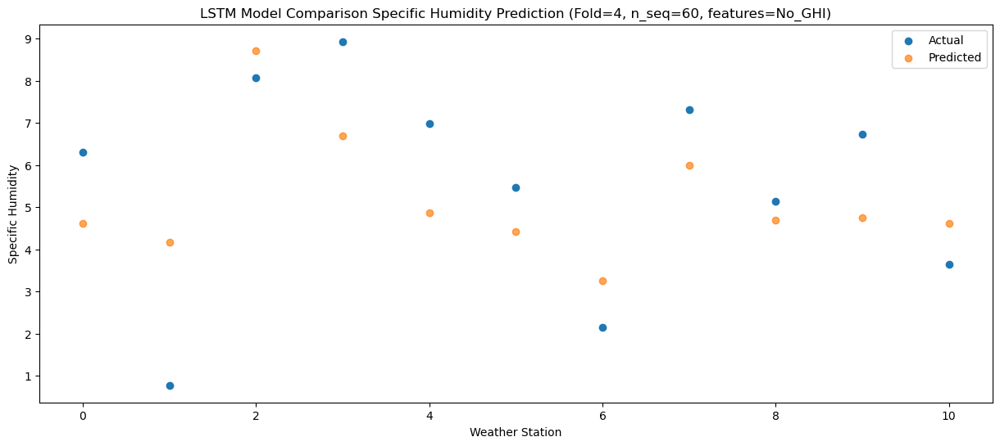

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   7.421616
1                 1    4.11   6.979129
2                 2   11.38  11.514671
3                 3   11.09   9.501510
4                 4    8.96   7.664952
5                 5    7.18   7.232347
6                 6    5.99   6.070212
7                 7   10.93   8.802858
8                 8    7.89   7.505222
9                 9    9.21   7.565097
10               10    6.83   7.424898


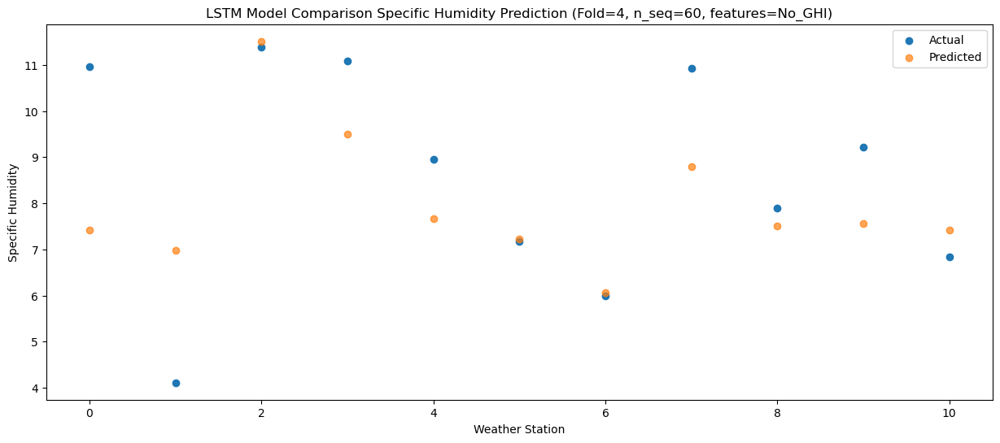

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31  10.012226
1                 1    5.85   9.566132
2                 2   14.31  14.105769
3                 3   14.32  12.092831
4                 4   12.11  10.256302
5                 5    8.41   9.821116
6                 6    8.58   8.658121
7                 7   12.98  11.392514
8                 8   11.11  10.098808
9                 9   12.77  10.163039
10               10    9.75  10.024570


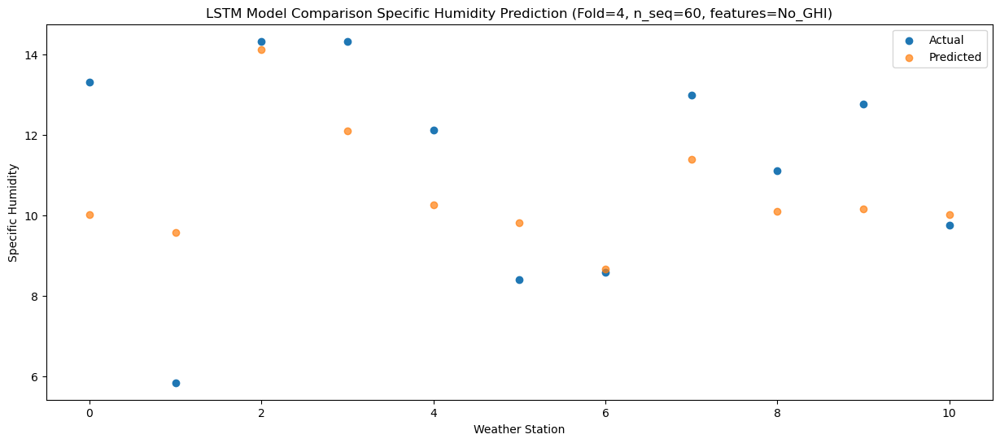

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88   8.966382
1                 1    6.09   8.523209
2                 2   12.80  13.061114
3                 3   11.73  11.045835
4                 4    9.46   9.208105
5                 5    7.10   8.773933
6                 6    8.79   7.610642
7                 7   10.33  10.345993
8                 8    9.44   9.051898
9                 9   10.58   9.114160
10               10    8.33   8.975236


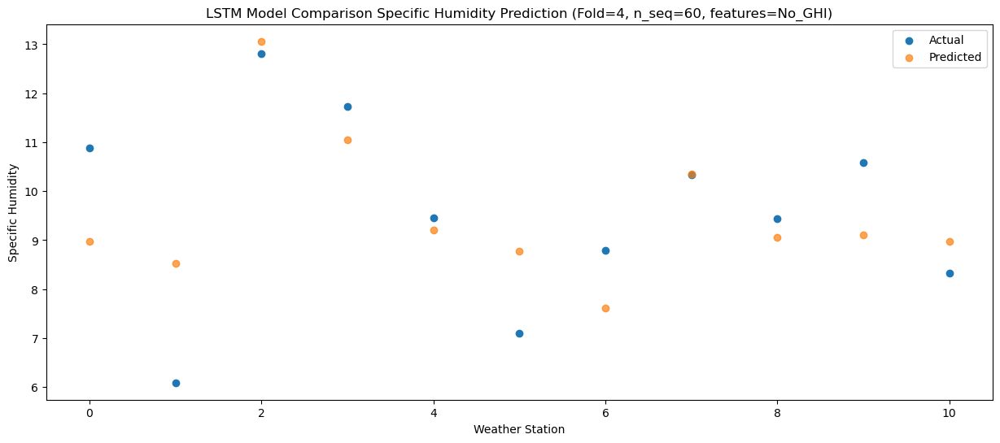

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   6.429505
1                 1    5.51   5.988429
2                 2   10.75  10.526824
3                 3   10.52   8.512619
4                 4    8.57   6.676033
5                 5    6.91   6.240543
6                 6    4.95   5.077584
7                 7    8.73   7.813015
8                 8    6.52   6.517119
9                 9    7.80   6.578868
10               10    6.19   6.437889


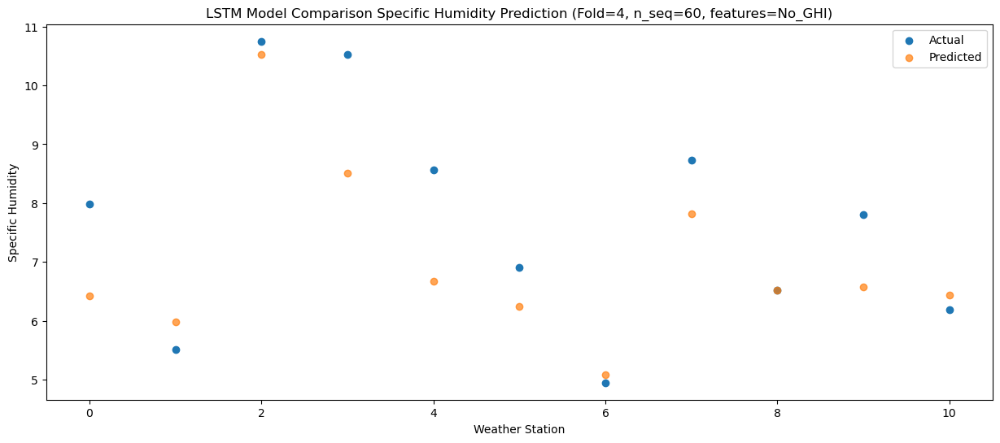

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   3.474030
1                 1    3.47   3.032891
2                 2    7.40   7.572830
3                 3    5.95   5.558635
4                 4    3.80   3.721877
5                 5    3.26   3.286001
6                 6    2.30   2.125648
7                 7    4.18   4.860437
8                 8    3.14   3.564533
9                 9    3.64   3.625987
10               10    3.15   3.489780


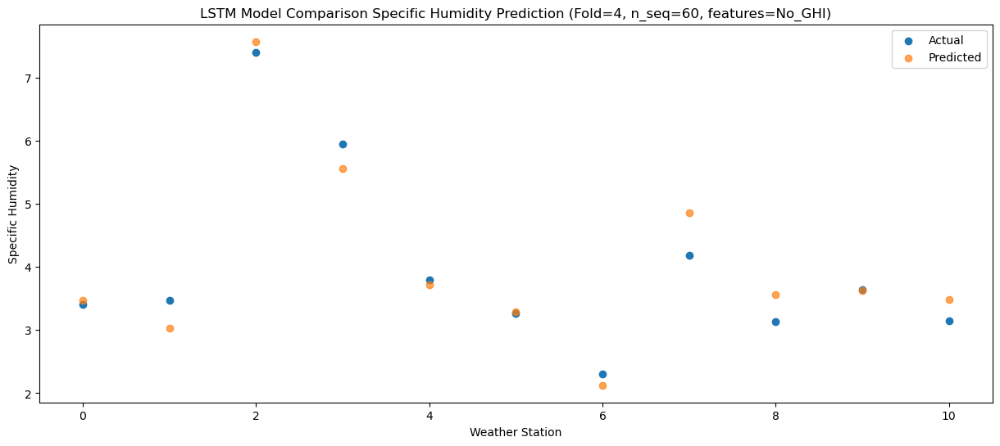

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   1.886725
1                 1    0.41   1.446536
2                 2    4.73   5.985541
3                 3    4.31   3.972079
4                 4    2.44   2.135138
5                 5    2.80   1.699393
6                 6   -0.53   0.538204
7                 7    2.51   3.273323
8                 8    1.46   1.976918
9                 9    2.55   2.038833
10               10    1.22   1.902168


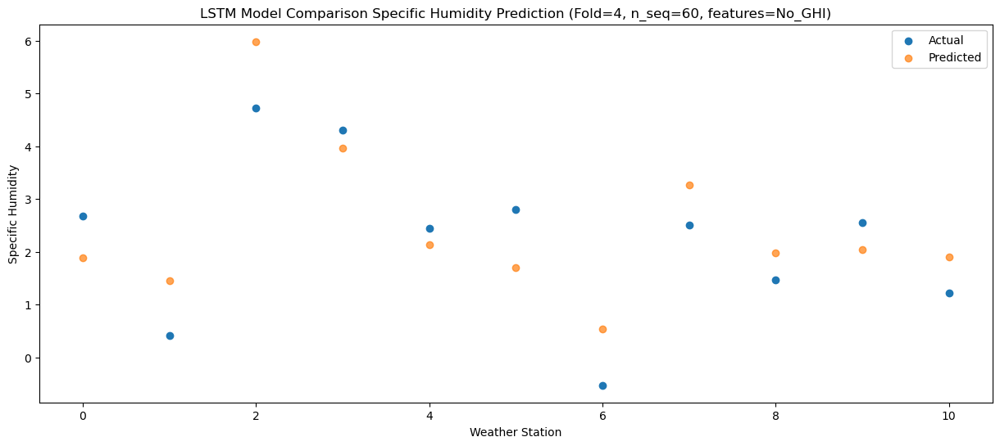

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45   0.170900
1                 1   -4.33  -0.274002
2                 2    2.35   4.266311
3                 3    1.71   2.255564
4                 4   -0.13   0.418766
5                 5    0.24  -0.017220
6                 6   -3.87  -1.180383
7                 7    0.58   1.554431
8                 8   -0.14   0.258961
9                 9    0.64   0.321061
10               10   -0.11   0.182577


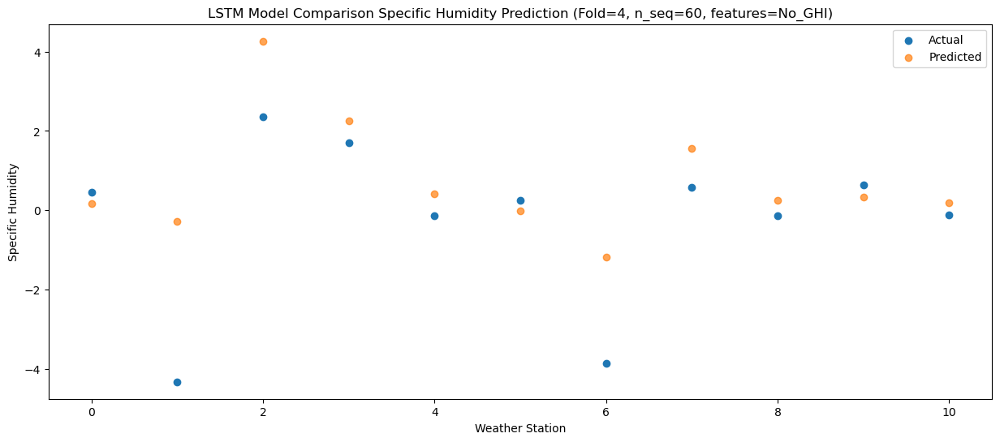

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57   0.006768
1                 1   -3.98  -0.440110
2                 2    2.24   4.097892
3                 3    1.60   2.088524
4                 4   -0.17   0.252221
5                 5    0.94  -0.182214
6                 6   -3.99  -1.349100
7                 7    0.43   1.386117
8                 8   -0.49   0.087847
9                 9    0.32   0.149016
10               10   -0.49   0.007781


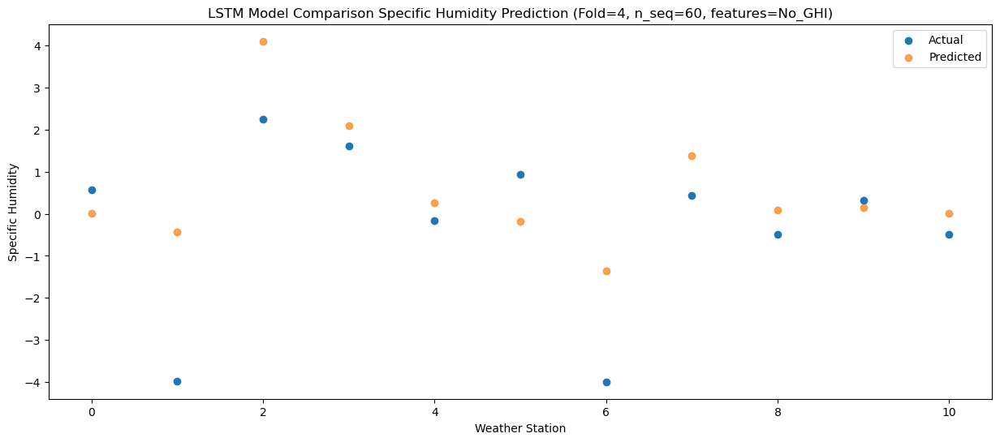

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52  -0.324229
1                 1   -1.99  -0.766598
2                 2    2.12   3.770294
3                 3    1.28   1.761502
4                 4   -0.62  -0.075722
5                 5    0.30  -0.508717
6                 6   -3.74  -1.674723
7                 7   -0.20   1.059158
8                 8   -1.06  -0.241730
9                 9   -0.32  -0.183591
10               10   -1.06  -0.324858


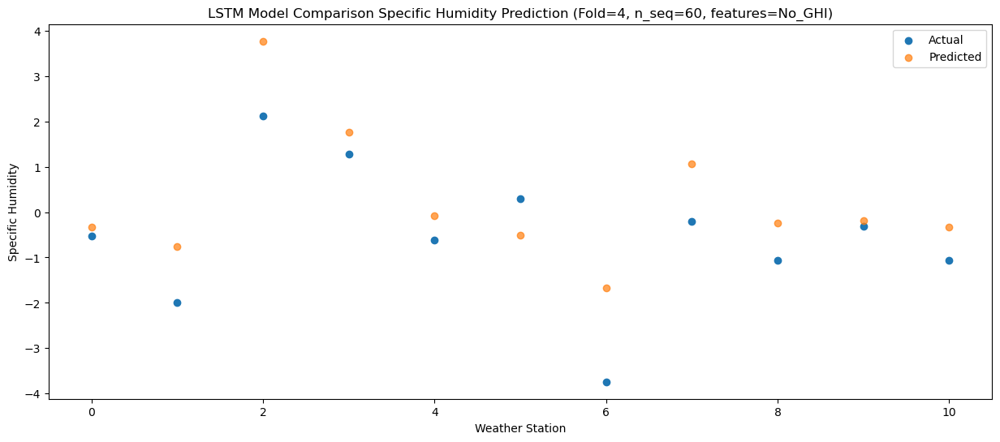

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24   1.090466
1                 1   -2.02   0.643325
2                 2    5.18   5.180001
3                 3    3.94   3.173451
4                 4    1.96   1.336879
5                 5    1.79   0.905888
6                 6   -2.03  -0.263038
7                 7    2.17   2.471918
8                 8    0.88   1.170723
9                 9    2.05   1.230511
10               10    0.23   1.087409


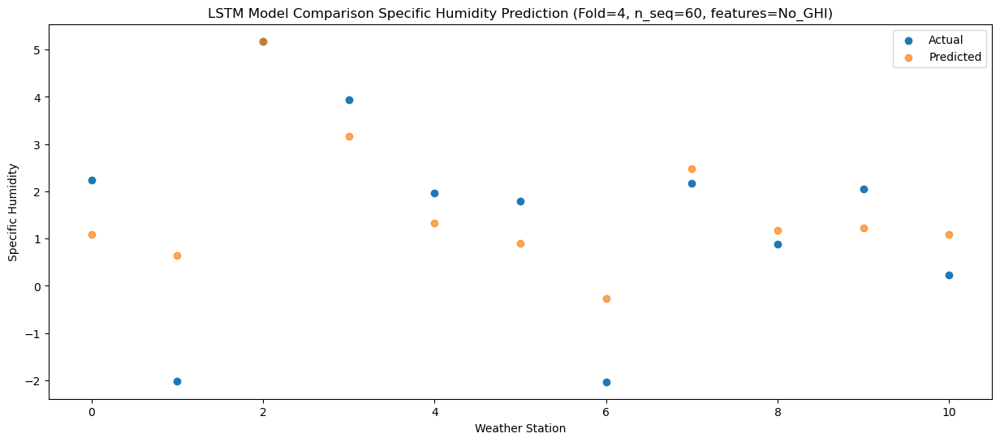

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45   2.157246
1                 1   -1.27   1.710530
2                 2    5.43   6.245429
3                 3    5.23   4.241137
4                 4    3.32   2.406528
5                 5    2.75   1.973524
6                 6   -1.62   0.803581
7                 7    3.09   3.539455
8                 8    2.21   2.238881
9                 9    3.36   2.299269
10               10    1.90   2.154571


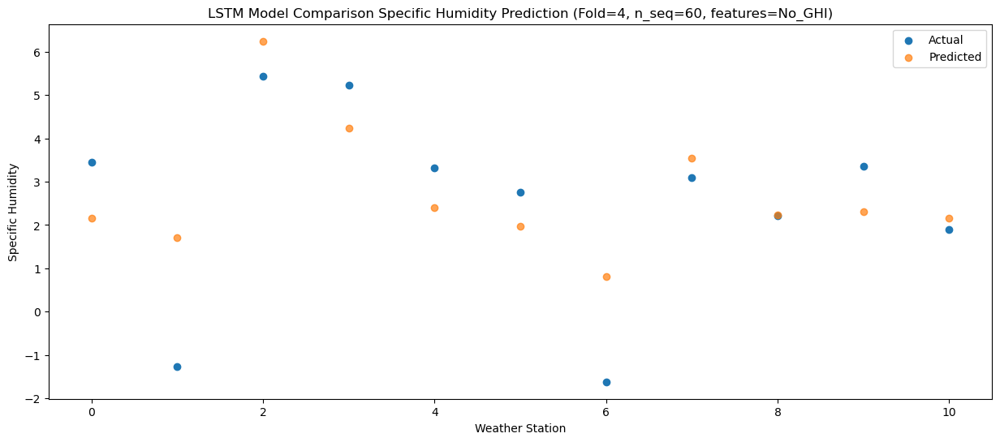

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01   4.141383
1                 1    0.06   3.687010
2                 2    8.87   8.223566
3                 3    9.23   6.220396
4                 4    7.61   4.385451
5                 5    7.30   3.951814
6                 6    1.36   2.780960
7                 7    6.25   5.519907
8                 8    4.50   4.218571
9                 9    5.98   4.282275
10               10    3.50   4.134762


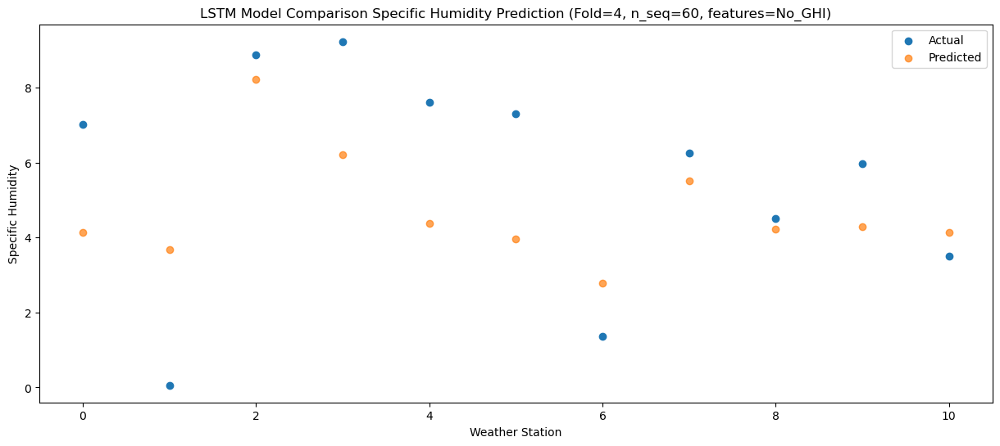

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60   8.294491
1                 1    4.35   7.839386
2                 2   13.11  12.378184
3                 3   12.92  10.375694
4                 4   11.49   8.540373
5                 5    9.60   8.104944
6                 6    6.05   6.935556
7                 7   10.85   9.675215
8                 8    9.56   8.377299
9                 9   10.73   8.441905
10               10    8.51   8.296972


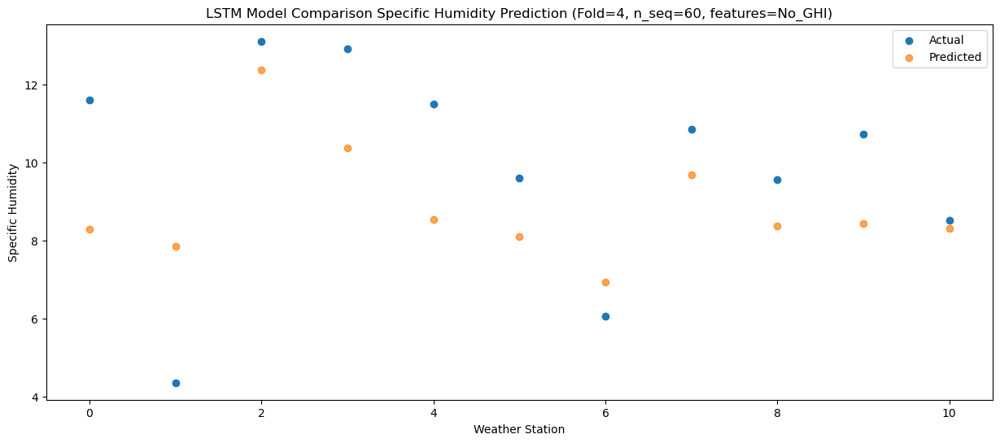

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99   9.773008
1                 1    5.56   9.314853
2                 2   14.76  13.853038
3                 3   13.49  11.849665
4                 4   11.87  10.014143
5                 5   10.63   9.579296
6                 6    7.65   8.407899
7                 7   11.80  11.147994
8                 8   10.82   9.848325
9                 9   12.13   9.912267
10               10    9.78   9.764029


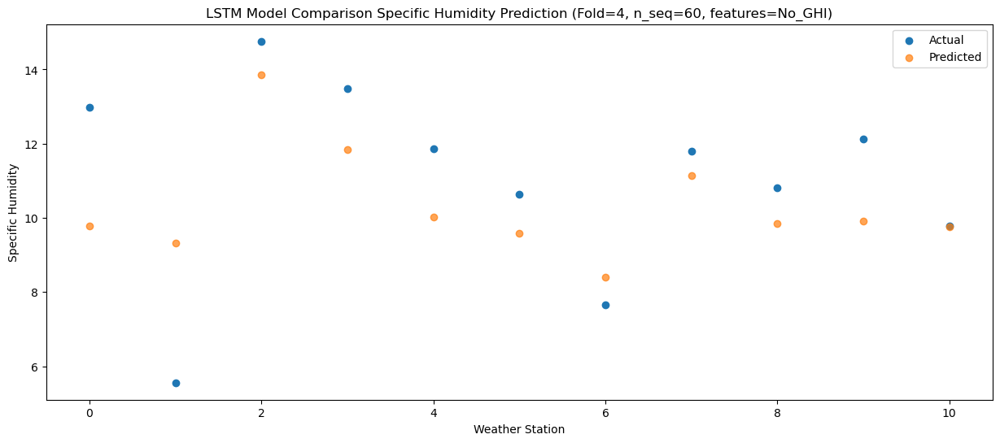

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81   9.808207
1                 1    5.95   9.348622
2                 2   14.77  13.889278
3                 3   13.88  11.887219
4                 4   11.98  10.050849
5                 5   10.35   9.613904
6                 6    8.03   8.445122
7                 7   11.54  11.182791
8                 8   10.96   9.886555
9                 9   12.38   9.951621
10               10   10.65   9.805318


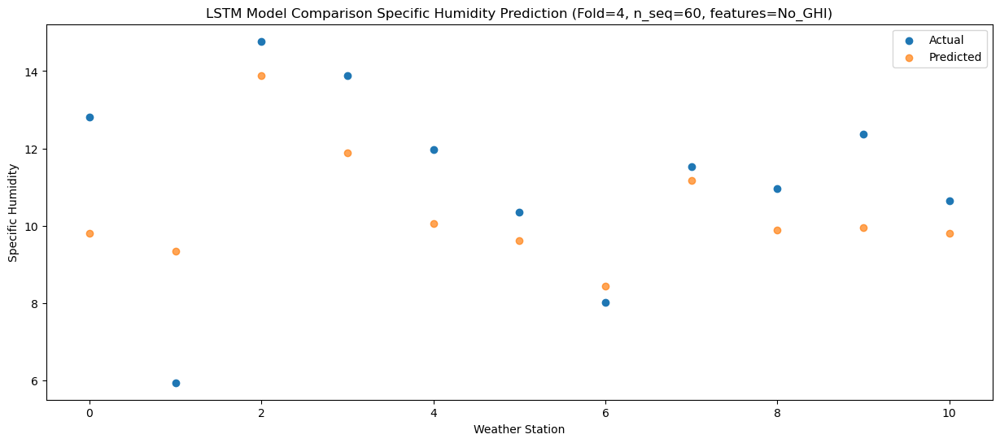

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23   6.732666
1                 1    5.15   6.275765
2                 2   11.83  10.817138
3                 3    9.87   8.812728
4                 4    8.08   6.975203
5                 5    7.10   6.538405
6                 6    4.45   5.368494
7                 7    8.28   8.107538
8                 8    7.48   6.811684
9                 9    8.35   6.877917
10               10    6.89   6.732834


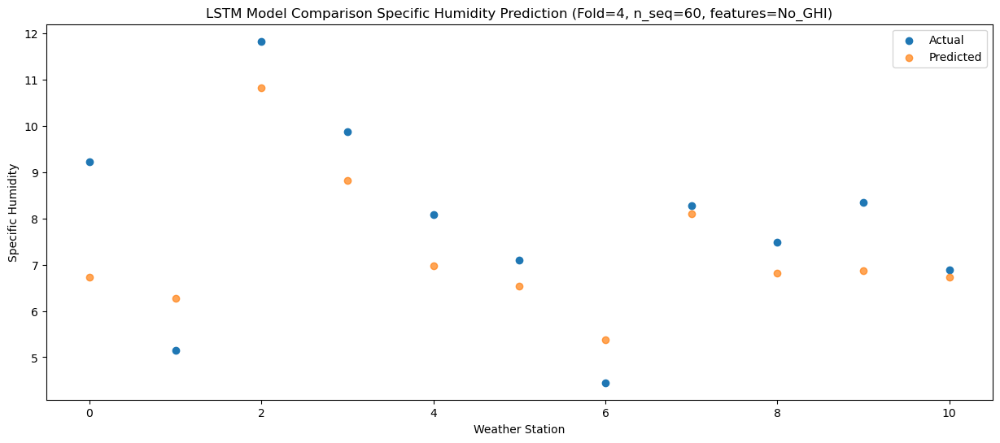

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86   5.302554
1                 1    2.23   4.844032
2                 2    9.05   9.387388
3                 3    7.02   7.383417
4                 4    5.35   5.546539
5                 5    4.05   5.108720
6                 6    2.24   3.939745
7                 7    6.19   6.679602
8                 8    6.33   5.382181
9                 9    6.48   5.448412
10               10    5.88   5.302710


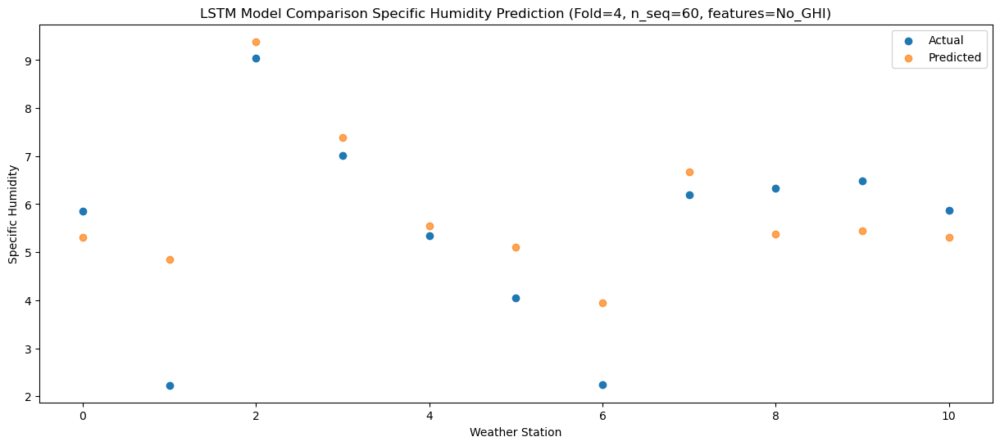

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77   0.889913
1                 1   -2.43   0.429558
2                 2    3.61   4.971948
3                 3    3.40   2.967289
4                 4    1.74   1.129439
5                 5    2.33   0.693707
6                 6   -3.48  -0.476216
7                 7    1.50   2.261526
8                 8    0.56   0.965270
9                 9    1.19   1.032111
10               10    0.64   0.887991


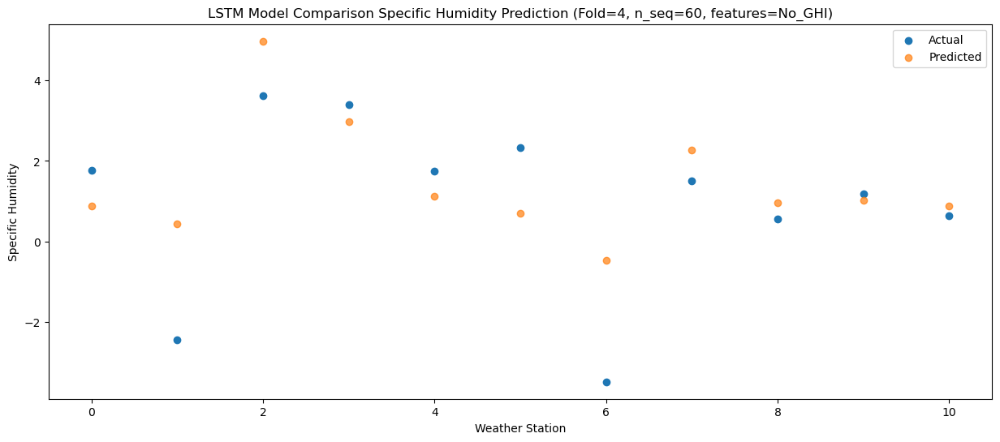

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56   1.334809
1                 1   -0.69   0.878890
2                 2    6.56   5.422406
3                 3    5.26   3.416355
4                 4    3.15   1.578300
5                 5    1.48   1.142056
6                 6   -1.62  -0.026120
7                 7    2.97   2.711134
8                 8    1.27   1.415449
9                 9    1.73   1.481126
10               10    0.60   1.339560


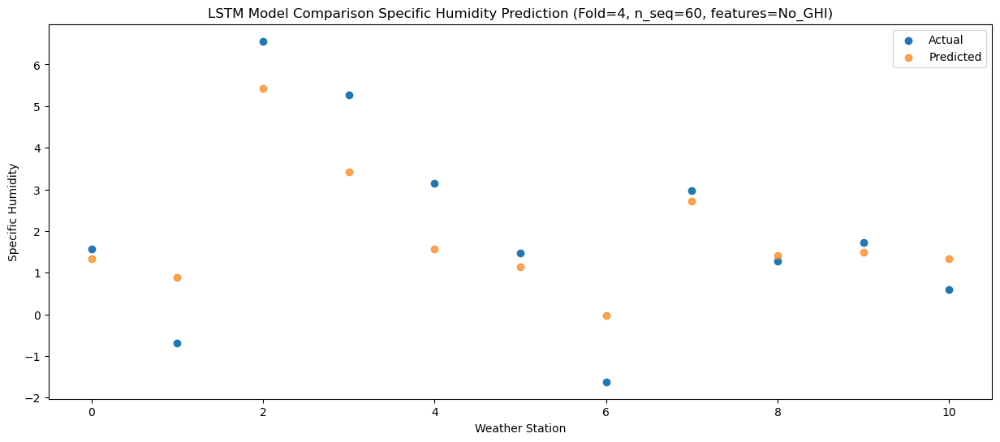

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -0.760726
1                 1   -4.55  -1.220813
2                 2    1.83   3.321144
3                 3    0.60   1.314760
4                 4   -1.18  -0.523827
5                 5    0.02  -0.960727
6                 6   -4.60  -2.128934
7                 7   -0.23   0.609319
8                 8   -1.11  -0.685349
9                 9   -0.51  -0.616567
10               10   -1.14  -0.758942


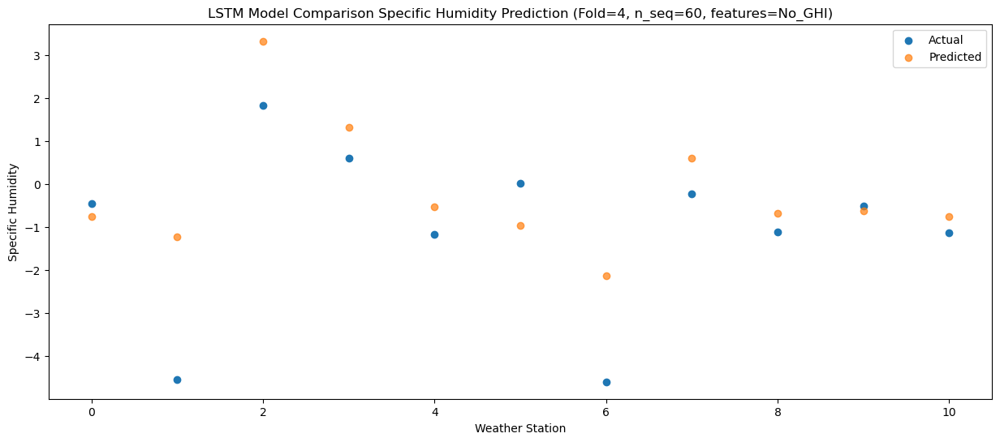

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23  -0.225039
1                 1   -2.97  -0.680439
2                 2    2.68   3.862174
3                 3    1.13   1.855927
4                 4   -0.74   0.016504
5                 5    0.01  -0.421781
6                 6   -3.28  -1.587783
7                 7    0.28   1.149483
8                 8   -0.53  -0.147169
9                 9    0.19  -0.080362
10               10   -0.69  -0.221017


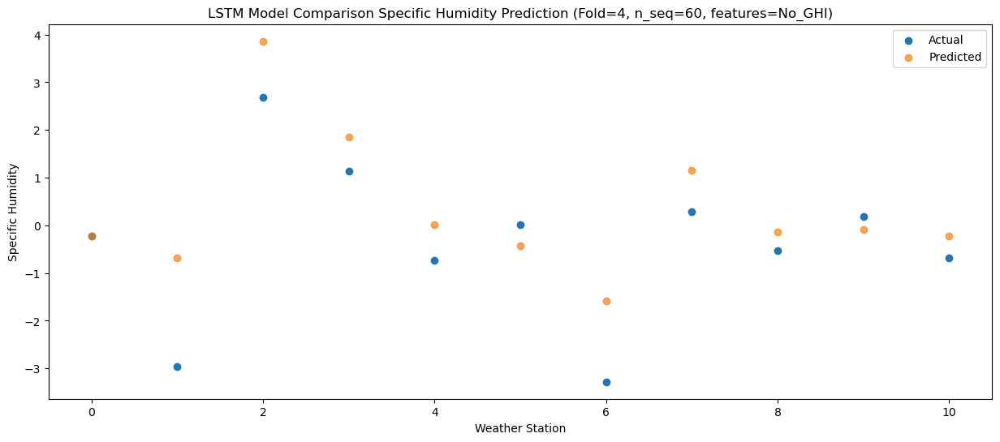

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33   0.934732
1                 1   -1.44   0.476640
2                 2    3.73   5.020753
3                 3    2.72   3.016309
4                 4    0.78   1.178021
5                 5    0.60   0.739766
6                 6   -2.44  -0.426966
7                 7    1.79   2.311457
8                 8    0.78   1.015047
9                 9    1.71   1.081620
10               10    0.46   0.940796


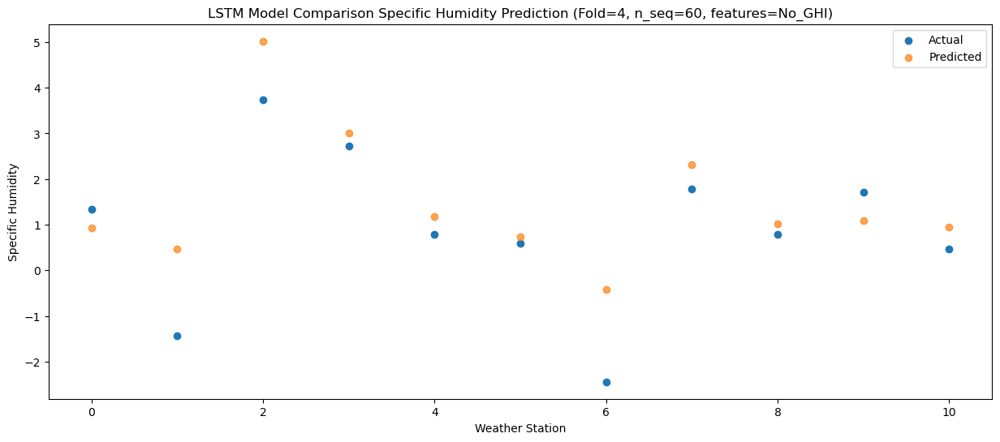

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82   2.119037
1                 1   -0.15   1.659797
2                 2    6.18   6.201412
3                 3    6.23   4.196641
4                 4    4.46   2.357445
5                 5    2.63   1.918338
6                 6   -1.38   0.749340
7                 7    3.58   3.488413
8                 8    2.27   2.189923
9                 9    3.01   2.258376
10               10    1.45   2.116213


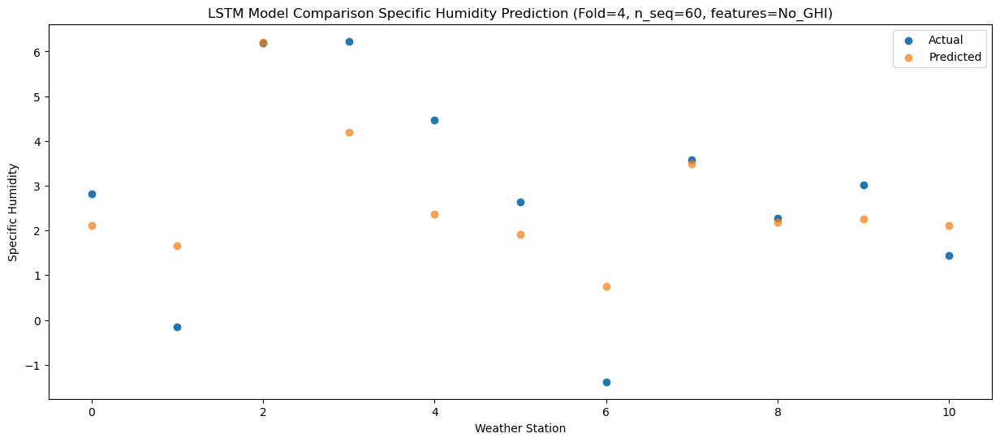

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70   5.568451
1                 1    2.24   5.102880
2                 2   10.78   9.645044
3                 3   10.22   7.642586
4                 4    8.34   5.803526
5                 5    4.89   5.365921
6                 6    2.63   4.195134
7                 7    8.29   6.933882
8                 8    6.29   5.636353
9                 9    7.08   5.705399
10               10    4.91   5.564478


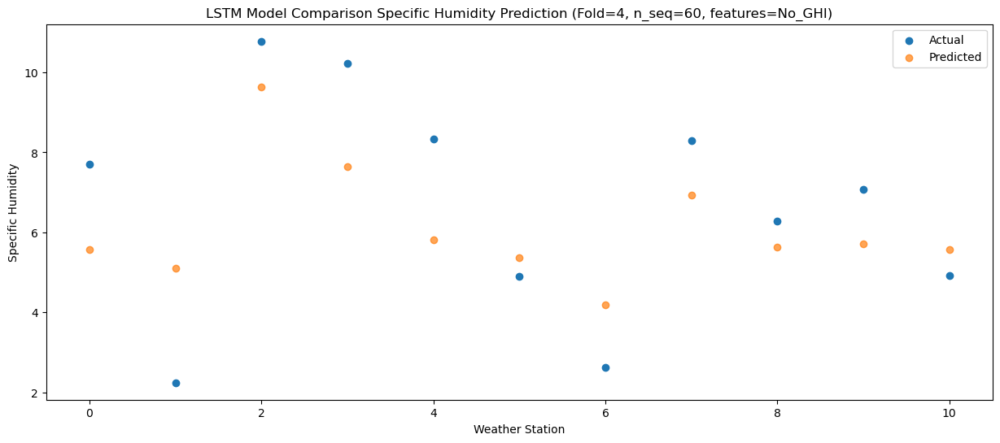

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93   7.365377
1                 1    5.14   6.898626
2                 2   13.16  11.440675
3                 3   11.99   9.439528
4                 4   10.02   7.600562
5                 5    7.74   7.164133
6                 6    4.91   5.990144
7                 7   10.65   8.729300
8                 8    7.73   7.432977
9                 9    9.32   7.503120
10               10    6.82   7.364577


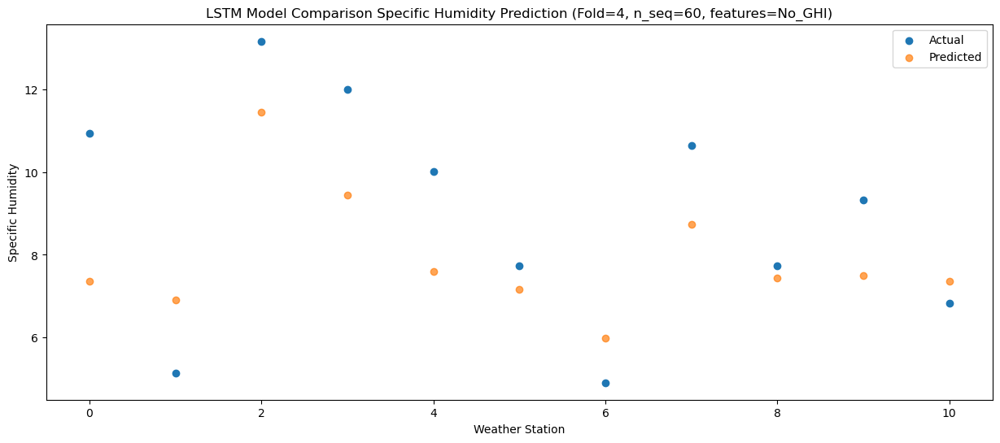

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56  10.159107
1                 1    6.17   9.694384
2                 2   15.00  14.237347
3                 3   11.41  12.236264
4                 4    9.52  10.395989
5                 5    8.43   9.957090
6                 6    8.07   8.786073
7                 7   11.45  11.525126
8                 8   10.47  10.230770
9                 9   11.96  10.300947
10               10    8.55  10.163574


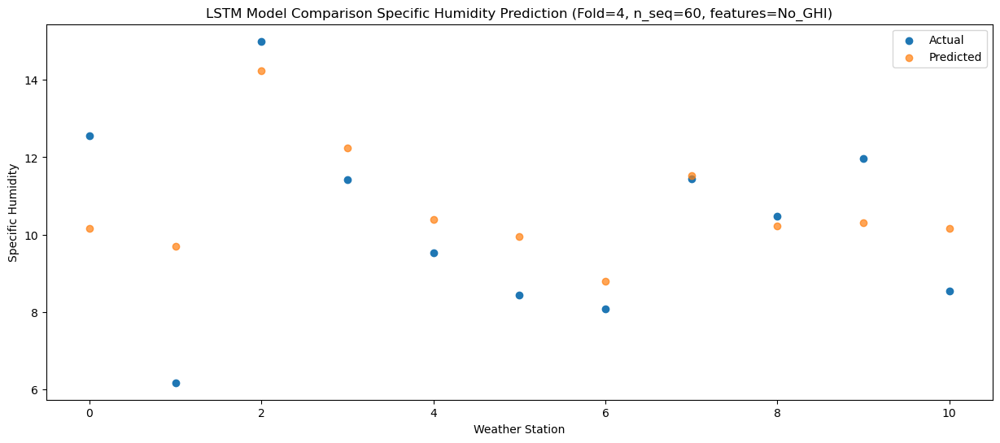

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35  10.062300
1                 1    6.25   9.596136
2                 2   14.82  14.139730
3                 3   12.42  12.137915
4                 4   10.69  10.296729
5                 5   10.42   9.859028
6                 6    6.88   8.685590
7                 7   11.92  11.426351
8                 8   10.11  10.132774
9                 9   11.19  10.201988
10               10    9.01  10.064795


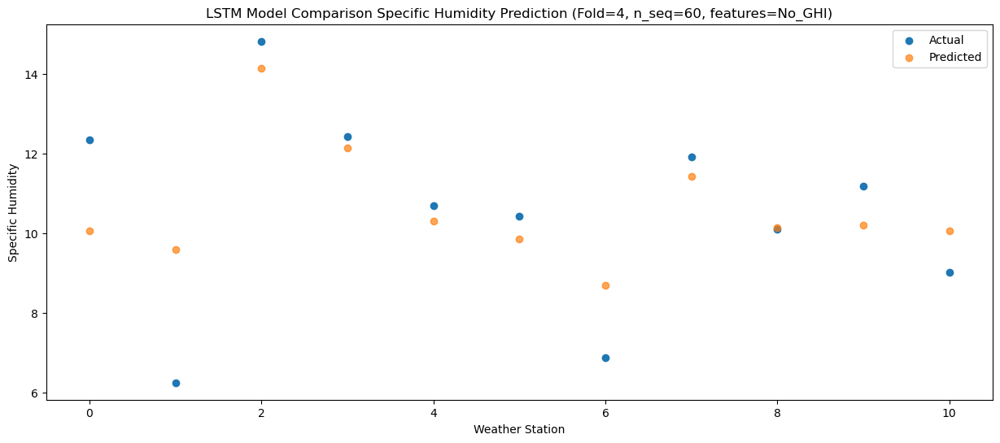

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65   7.083753
1                 1    5.38   6.615612
2                 2   10.58  11.157806
3                 3    9.14   9.156182
4                 4    7.54   7.315070
5                 5    9.17   6.875839
6                 6    3.33   5.702831
7                 7    8.11   8.443297
8                 8    7.45   7.151737
9                 9    7.82   7.221282
10               10    7.02   7.083774


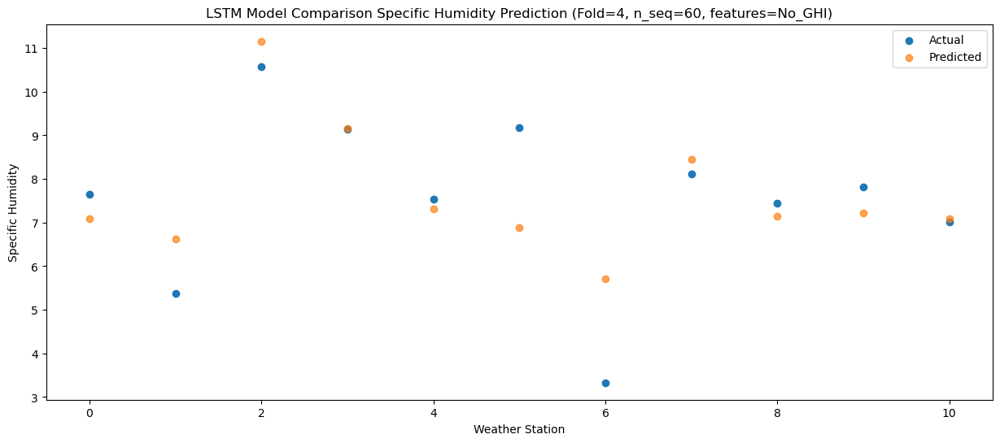

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   2.485115
1                 1    0.60   2.017775
2                 2    5.62   6.561109
3                 3    4.68   4.560478
4                 4    3.08   2.719580
5                 5    5.66   2.280775
6                 6   -1.35   1.106511
7                 7    3.45   3.843814
8                 8    2.12   2.550016
9                 9    3.06   2.618436
10               10    2.20   2.481371


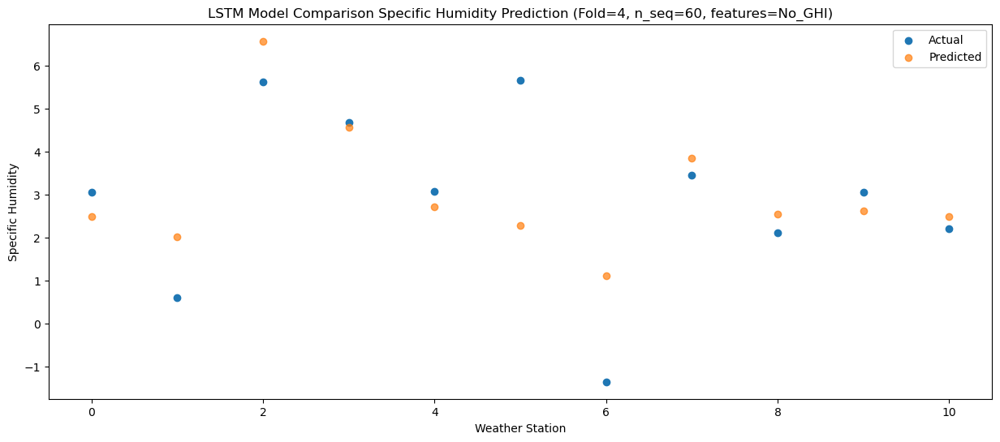

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   1.500268
1                 1    0.77   1.037675
2                 2    4.87   5.582426
3                 3    4.50   3.580234
4                 4    2.66   1.738934
5                 5    2.96   1.299383
6                 6   -1.53   0.125940
7                 7    2.09   2.864720
8                 8    1.08   1.572994
9                 9    1.69   1.641076
10               10    1.48   1.505167


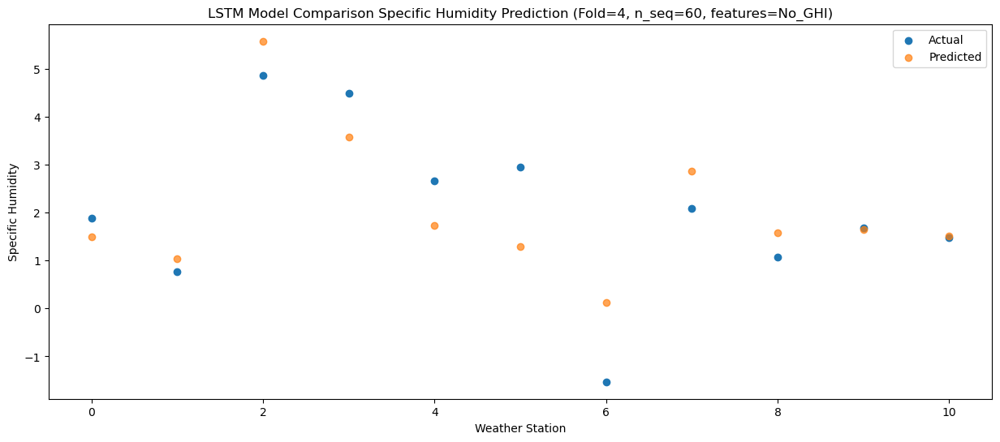

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55   0.453254
1                 1   -2.75  -0.010446
2                 2    4.33   4.533937
3                 3    2.92   2.531981
4                 4    1.07   0.690920
5                 5    2.32   0.251437
6                 6   -3.52  -0.922070
7                 7    1.22   1.816055
8                 8    0.12   0.526405
9                 9    0.58   0.594779
10               10    0.03   0.459879


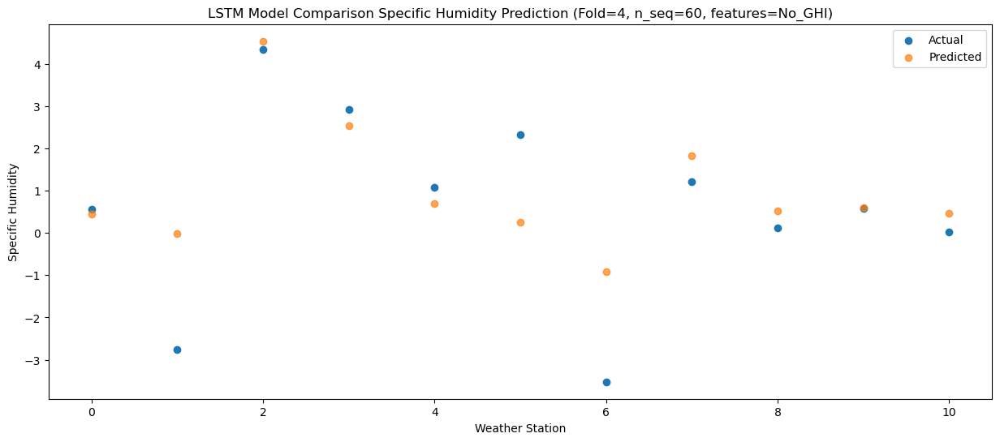

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90   0.794506
1                 1   -3.26   0.325793
2                 2    4.23   4.870662
3                 3    2.23   2.869739
4                 4    0.32   1.028707
5                 5    0.77   0.589325
6                 6   -2.89  -0.586860
7                 7    1.50   2.152734
8                 8    0.74   0.864377
9                 9    1.10   0.936460
10               10    0.65   0.798963


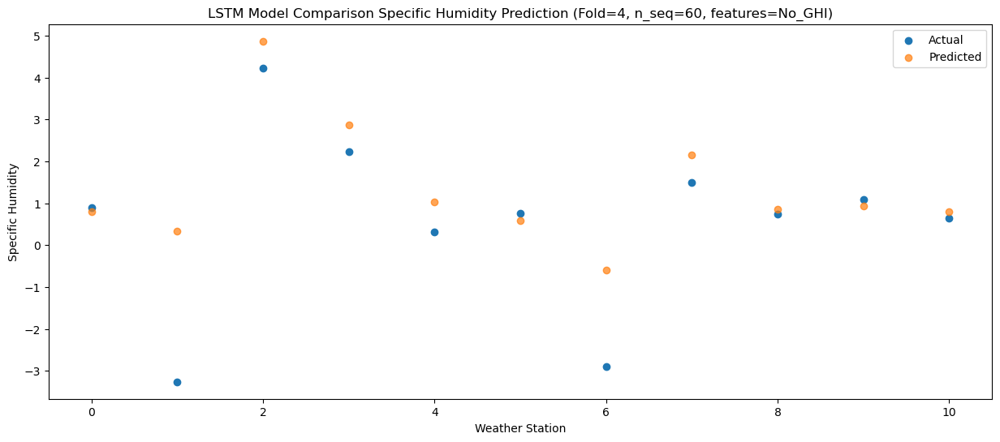

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85   0.564669
1                 1   -1.32   0.100880
2                 2    4.90   4.643555
3                 3    2.59   2.640783
4                 4    0.72   0.798660
5                 5    0.89   0.360089
6                 6   -1.85  -0.815431
7                 7    1.31   1.923264
8                 8    0.34   0.633595
9                 9    0.87   0.703392
10               10   -0.10   0.566714


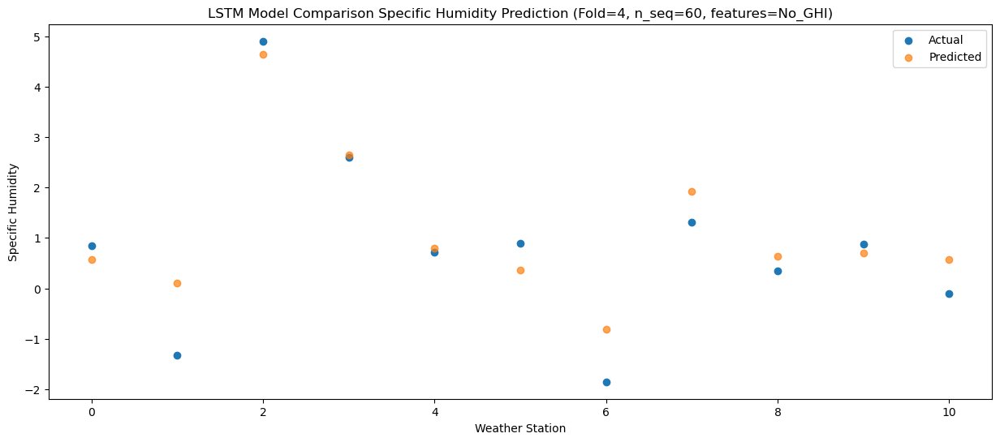

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69   0.904859
1                 1   -0.94   0.441339
2                 2    5.23   4.984182
3                 3    4.65   2.984024
4                 4    2.69   1.143303
5                 5    2.18   0.703425
6                 6   -2.36  -0.472411
7                 7    2.07   2.267944
8                 8    0.69   0.975740
9                 9    1.48   1.043663
10               10    0.11   0.905327


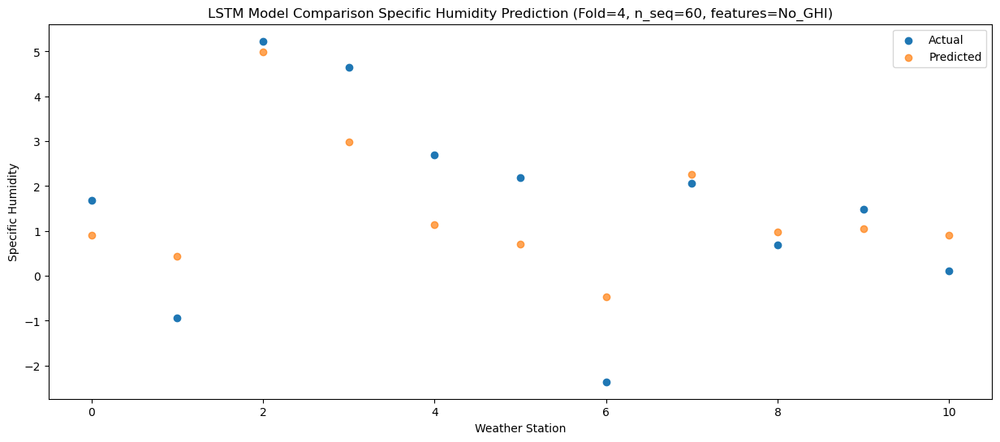

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   2.181075
1                 1    0.55   1.715170
2                 2    6.07   6.259179
3                 3    5.33   4.259541
4                 4    3.54   2.418532
5                 5    2.15   1.977886
6                 6   -0.76   0.803749
7                 7    2.97   3.544704
8                 8    2.14   2.253631
9                 9    2.99   2.323638
10               10    1.81   2.184722


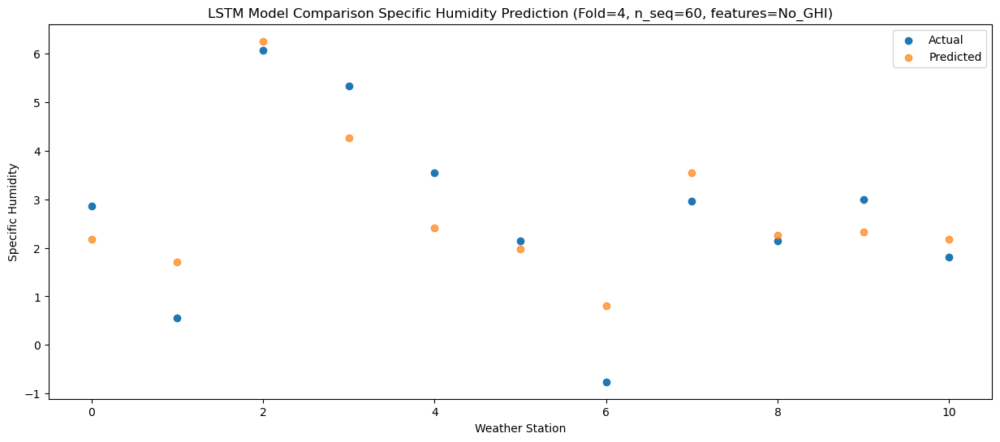

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   4.267452
1                 1    1.35   3.799780
2                 2    9.45   8.346612
3                 3    9.59   6.347314
4                 4    7.81   4.507238
5                 5    6.99   4.066081
6                 6    1.46   2.889720
7                 7    7.36   5.633805
8                 8    4.39   4.338557
9                 9    5.77   4.408941
10               10    2.71   4.266153


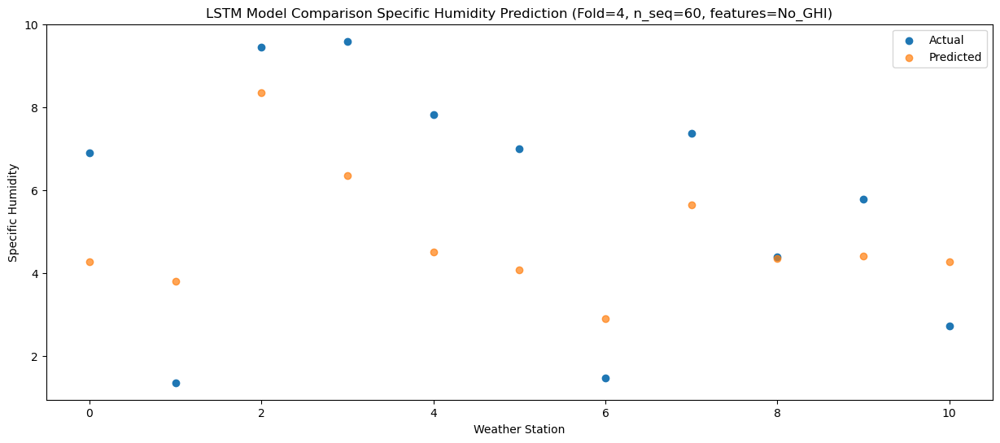

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43   6.755493
1                 1    4.86   6.282907
2                 2   13.02  10.829838
3                 3   13.53   8.831623
4                 4   11.29   6.991882
5                 5   10.85   6.552078
6                 6    4.51   5.374379
7                 7    9.92   8.119731
8                 8    6.35   6.824096
9                 9    7.41   6.893990
10               10    5.95   6.750141


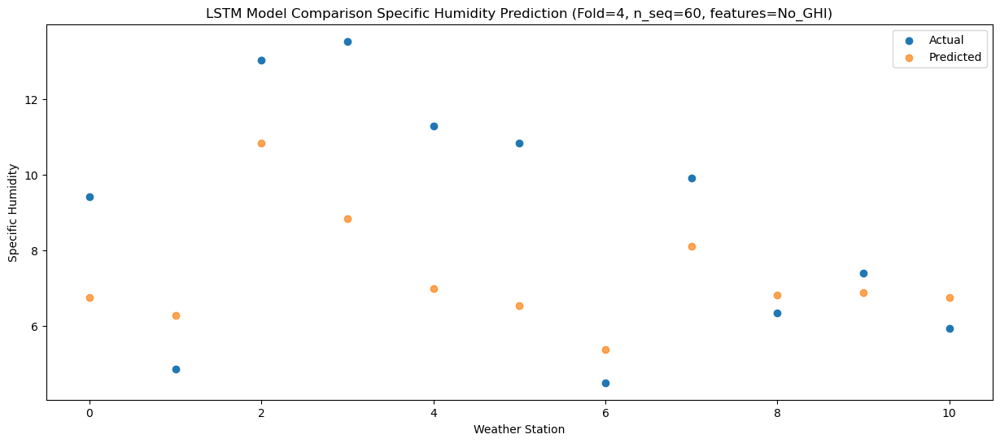

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12   9.749613
1                 1    6.77   9.274905
2                 2   14.61  13.822545
3                 3   13.38  11.824468
4                 4   10.39   9.983484
5                 5    8.52   9.542478
6                 6    7.90   8.366959
7                 7   12.71  11.111923
8                 8   10.65   9.820637
9                 9   12.11   9.891506
10               10    9.57   9.751090


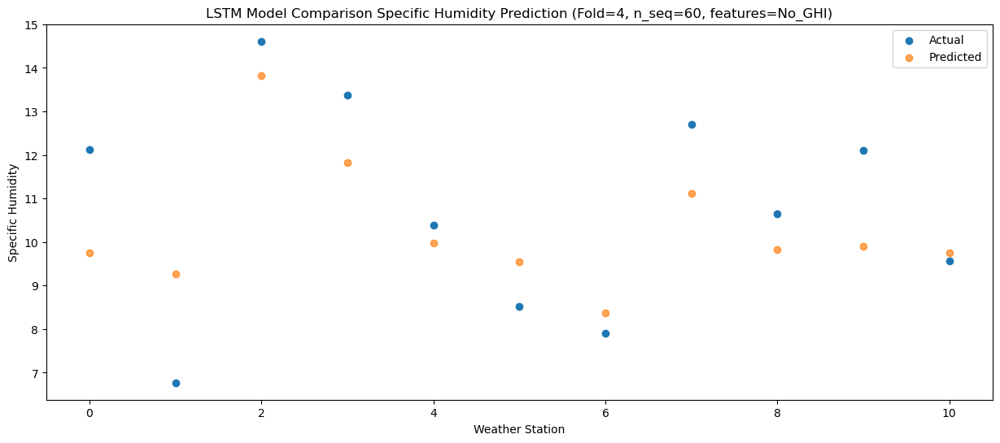

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05   9.235371
1                 1    7.07   8.758237
2                 2   13.03  13.302488
3                 3   11.28  11.304946
4                 4    9.01   9.464915
5                 5    7.66   9.023850
6                 6    7.44   7.846273
7                 7   12.99  10.593263
8                 8   10.11   9.302469
9                 9   11.98   9.375280
10               10    8.77   9.234138


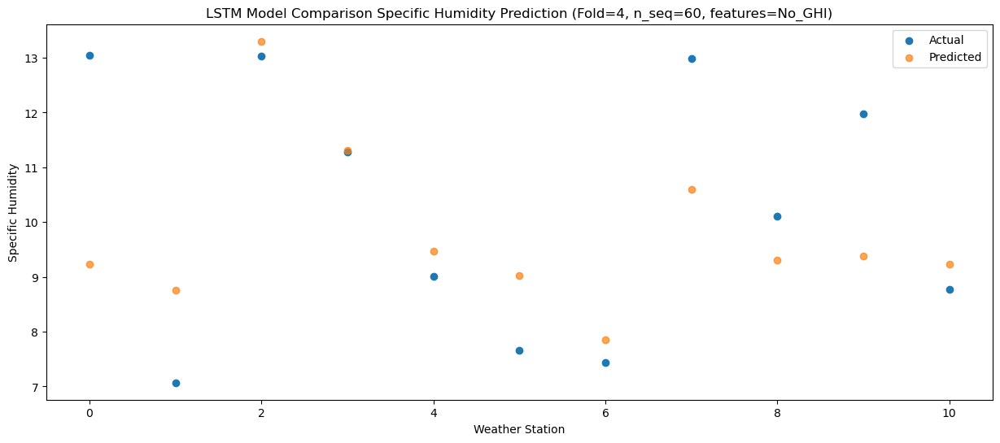

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13   7.079401
1                 1    4.62   6.598304
2                 2   10.01  11.143449
3                 3   10.38   9.148217
4                 4    8.68   7.309065
5                 5    8.17   6.866485
6                 6    3.99   5.689430
7                 7    8.79   8.436556
8                 8    7.31   7.145407
9                 9    8.20   7.217702
10               10    7.06   7.075217


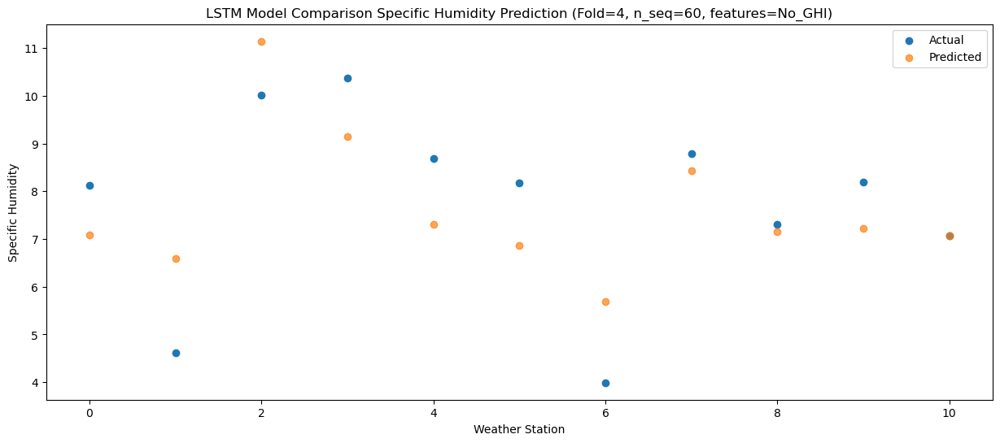

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   3.854607
1                 1    1.00   3.370271
2                 2    6.08   7.914331
3                 3    6.66   5.919956
4                 4    5.02   4.080960
5                 5    6.04   3.639880
6                 6    0.08   2.460872
7                 7    5.18   5.206227
8                 8    3.98   3.914629
9                 9    4.76   3.988432
10               10    4.00   3.845724


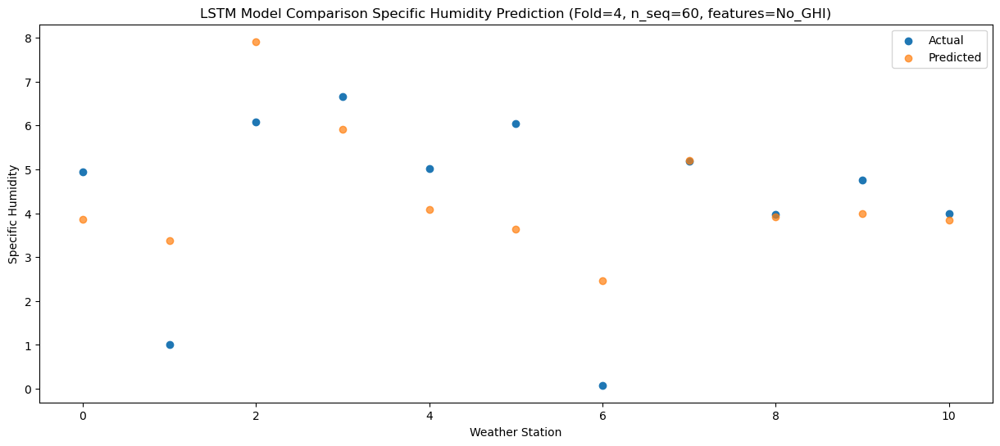

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04   0.906947
1                 1   -1.30   0.426490
2                 2    4.10   4.971183
3                 3    4.13   2.978037
4                 4    2.60   1.139299
5                 5    3.74   0.699195
6                 6   -2.87  -0.478895
7                 7    2.15   2.265911
8                 8    0.91   0.972043
9                 9    1.37   1.045545
10               10    0.56   0.902438


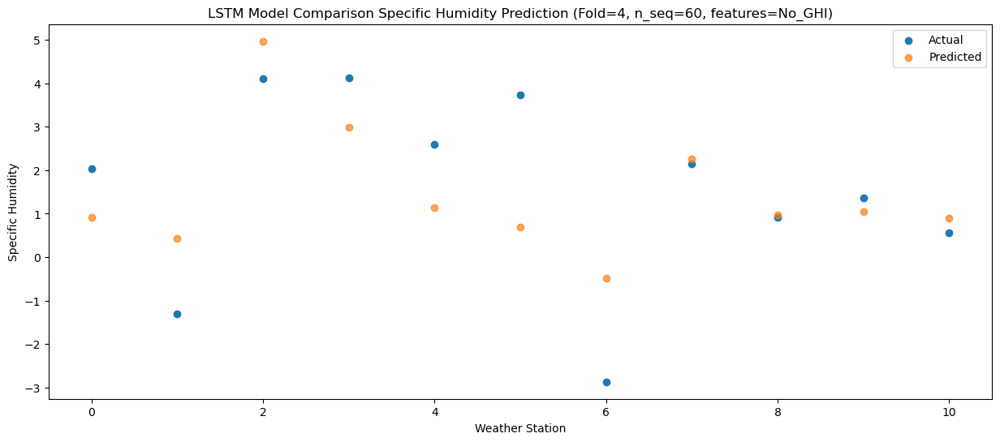

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86   0.850439
1                 1   -2.39   0.369157
2                 2    2.79   4.914937
3                 3    2.38   2.919839
4                 4    0.84   1.079386
5                 5    2.16   0.639471
6                 6   -3.15  -0.537722
7                 7    1.34   2.207752
8                 8    0.88   0.916984
9                 9    1.86   0.991038
10               10    1.08   0.851338


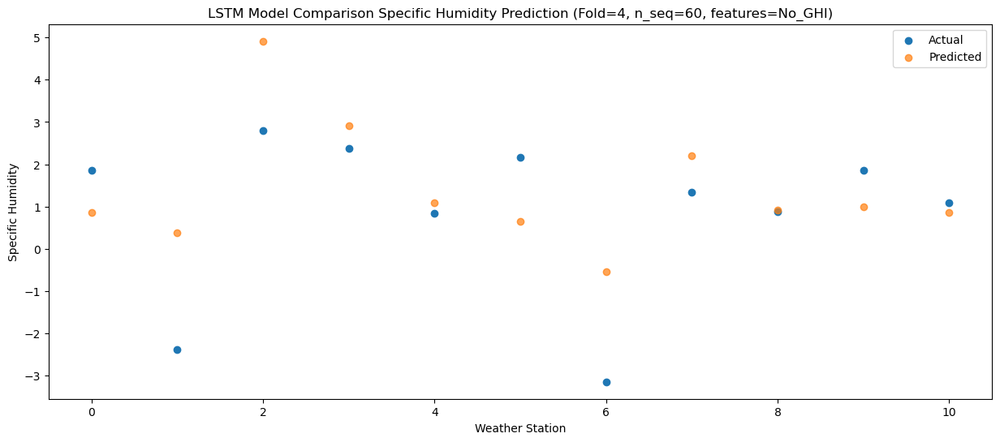

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16  -0.105832
1                 1   -3.43  -0.584486
2                 2    2.07   3.960967
3                 3    1.10   1.965912
4                 4   -0.58   0.125791
5                 5    0.89  -0.312915
6                 6   -3.93  -1.489311
7                 7    0.19   1.254378
8                 8   -0.20  -0.036857
9                 9    0.40   0.034805
10               10    0.01  -0.104026


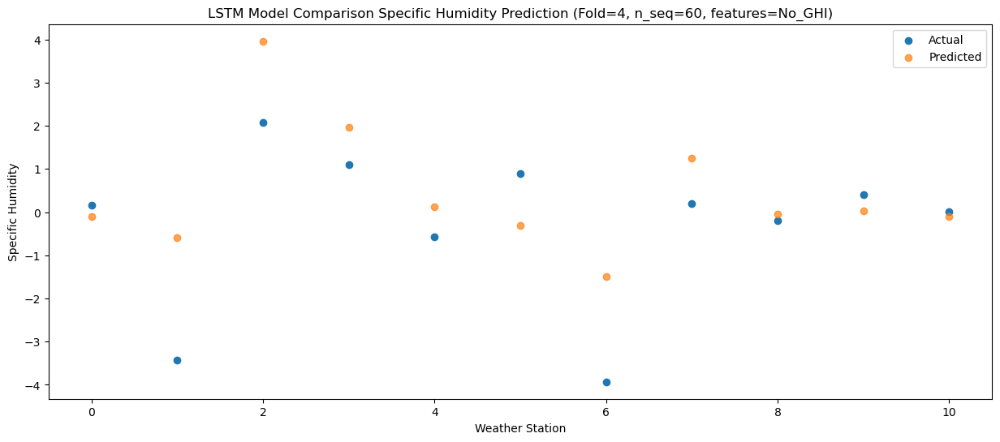

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17   0.316886
1                 1   -4.12  -0.165039
2                 2    3.50   4.380556
3                 3    3.44   2.386271
4                 4    1.77   0.545361
5                 5    1.24   0.105416
6                 6   -3.75  -1.070559
7                 7    1.55   1.672737
8                 8    0.38   0.381611
9                 9    1.32   0.455263
10               10    0.03   0.316115


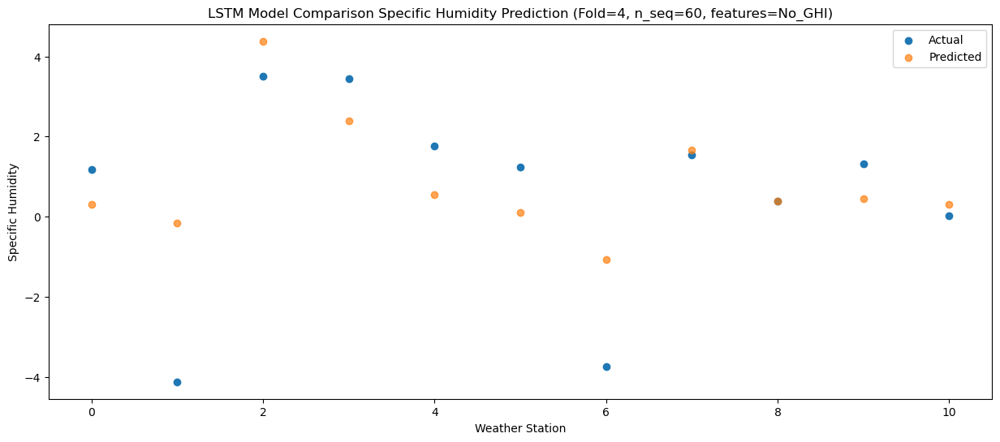

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23   1.154205
1                 1   -0.83   0.671523
2                 2    5.13   5.218607
3                 3    5.23   3.225879
4                 4    3.72   1.385021
5                 5    2.38   0.941946
6                 6   -2.18  -0.233889
7                 7    2.76   2.510346
8                 8    1.45   1.216384
9                 9    2.29   1.290035
10               10    1.10   1.147660


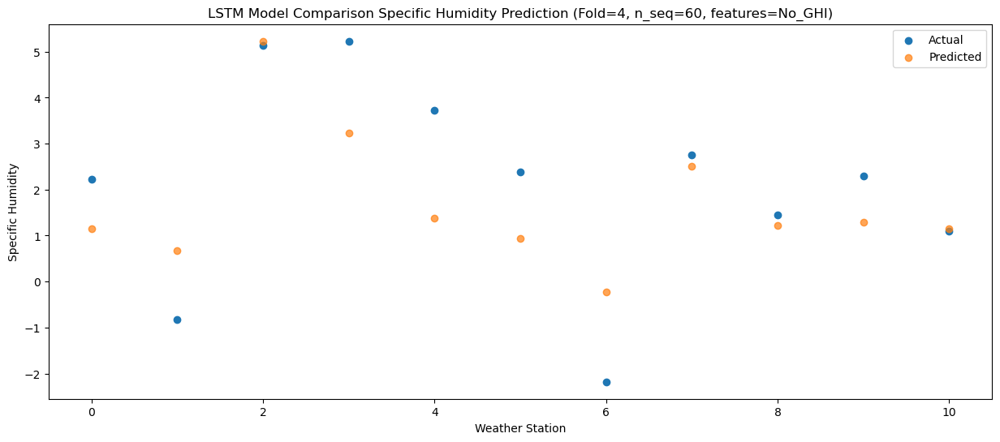

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   2.665370
1                 1   -1.43   2.181262
2                 2    7.31   6.727063
3                 3    7.60   4.740224
4                 4    6.22   2.901635
5                 5    2.98   2.458961
6                 6   -0.26   1.282195
7                 7    4.49   4.024246
8                 8    3.48   2.730027
9                 9    4.01   2.803574
10               10    2.88   2.660733


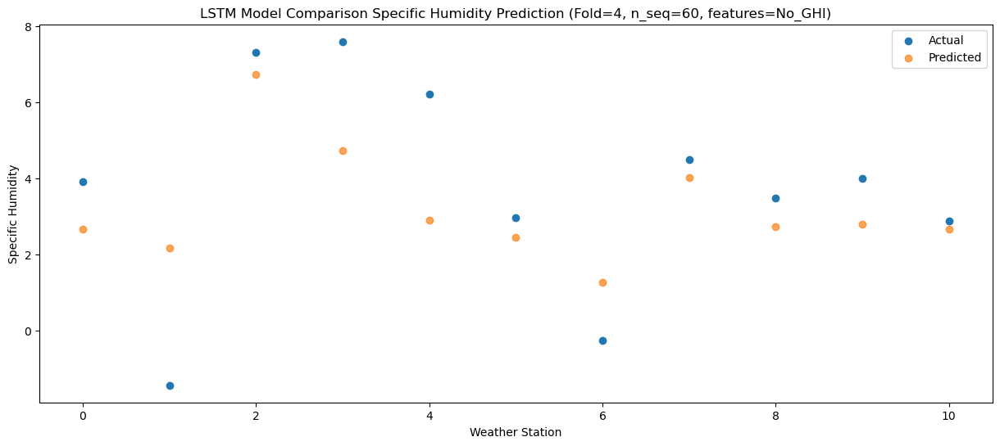

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   5.727032
1                 1    1.16   5.240623
2                 2   11.63   9.786924
3                 3   11.17   7.802075
4                 4    9.65   5.964411
5                 5    5.74   5.521686
6                 6    3.74   4.344170
7                 7    8.91   7.086421
8                 8    6.97   5.793439
9                 9    7.55   5.866881
10               10    5.80   5.721865


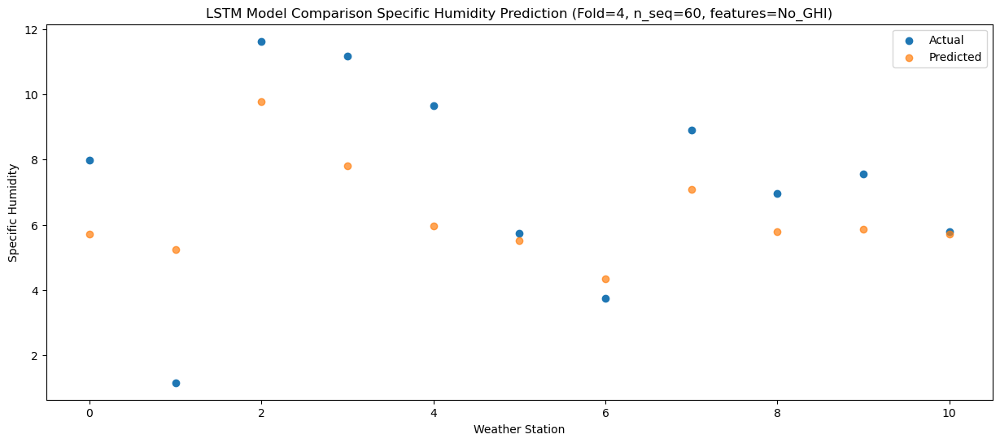

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24   7.766660
1                 1    2.62   7.281433
2                 2   12.97  11.826427
3                 3   13.11   9.840728
4                 4   11.76   8.003787
5                 5   10.27   7.561744
6                 6    5.50   6.384144
7                 7   10.89   9.126323
8                 8    8.66   7.833424
9                 9   10.31   7.906874
10               10    8.35   7.760247


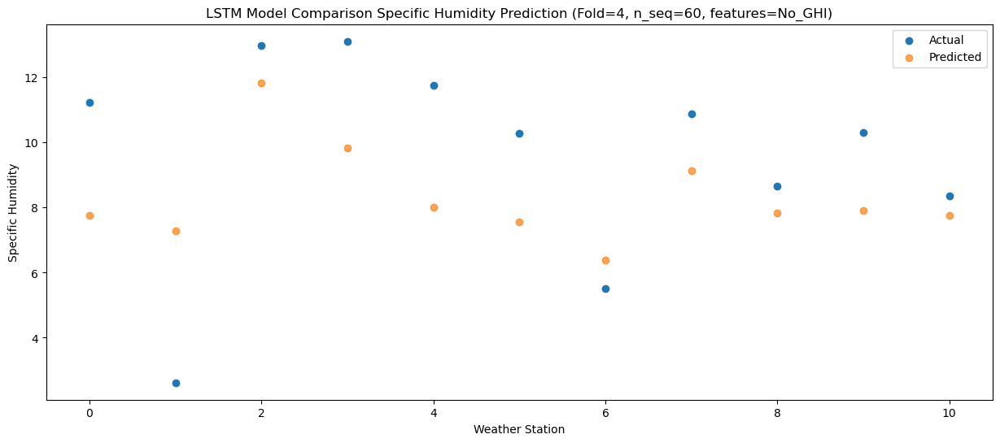

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43   9.077859
1                 1    4.08   8.598296
2                 2   15.00  13.144019
3                 3   13.07  11.155047
4                 4   11.29   9.317778
5                 5   10.15   8.875882
6                 6    7.89   7.699634
7                 7   11.87  10.440982
8                 8    9.96   9.147185
9                 9   11.92   9.220379
10               10    9.47   9.073198


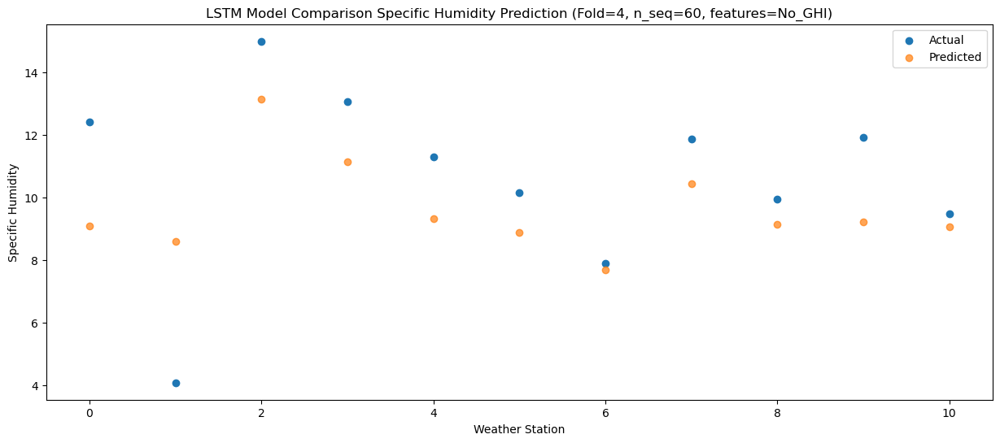

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27   8.669393
1                 1    6.69   8.188560
2                 2   12.69  12.732956
3                 3   12.36  10.744344
4                 4   10.52   8.906704
5                 5    8.95   8.465050
6                 6    7.15   7.286926
7                 7   10.58  10.028971
8                 8    9.60   8.734310
9                 9   11.56   8.808650
10               10    9.45   8.659979


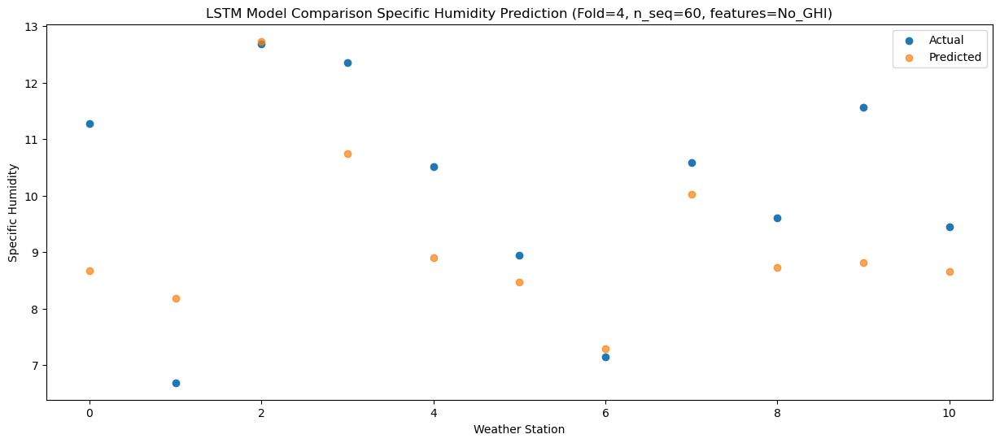

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97   6.512731
1                 1    6.50   6.033436
2                 2   11.59  10.580164
3                 3    9.83   8.591976
4                 4    8.36   6.754007
5                 5    8.07   6.310317
6                 6    4.83   5.134574
7                 7    8.54   7.877533
8                 8    6.92   6.585110
9                 9    8.06   6.658797
10               10    7.38   6.511140


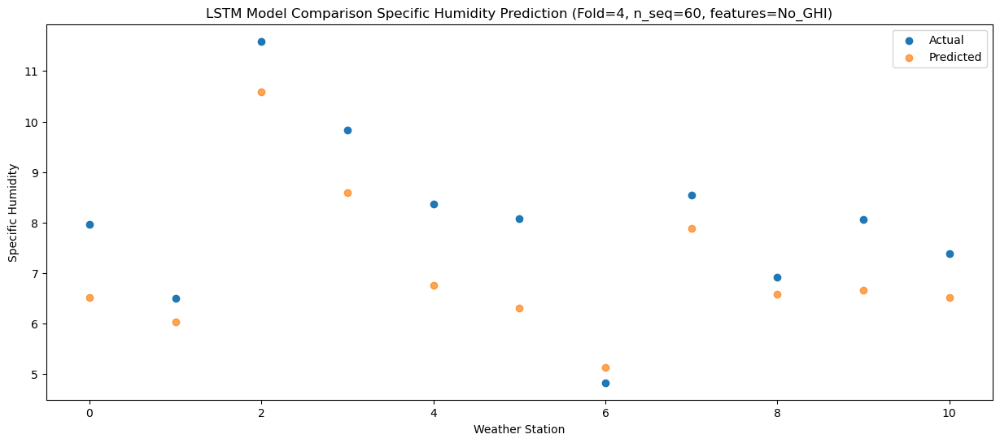

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   3.021205
1                 1    2.08   2.543435
2                 2    6.80   7.090724
3                 3    6.37   5.100902
4                 4    4.62   3.262625
5                 5    4.38   2.821383
6                 6    0.43   1.644278
7                 7    4.22   4.387538
8                 8    3.34   3.093921
9                 9    3.96   3.166743
10               10    3.27   3.018736


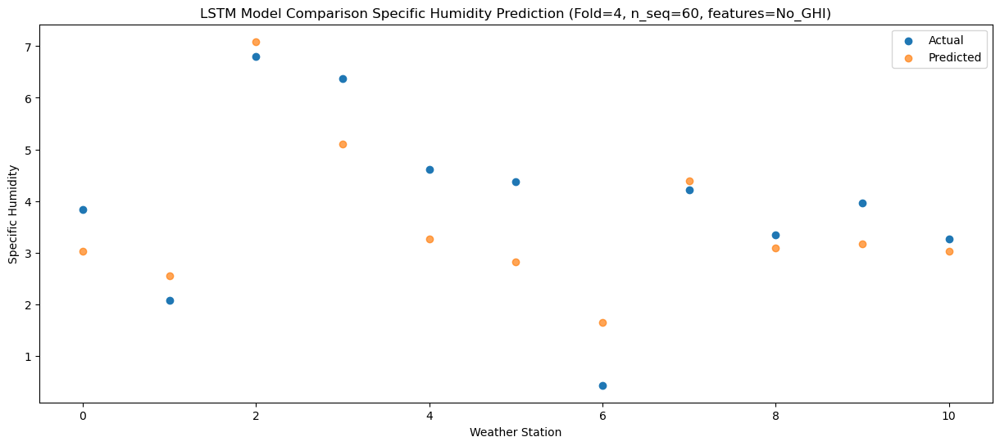

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

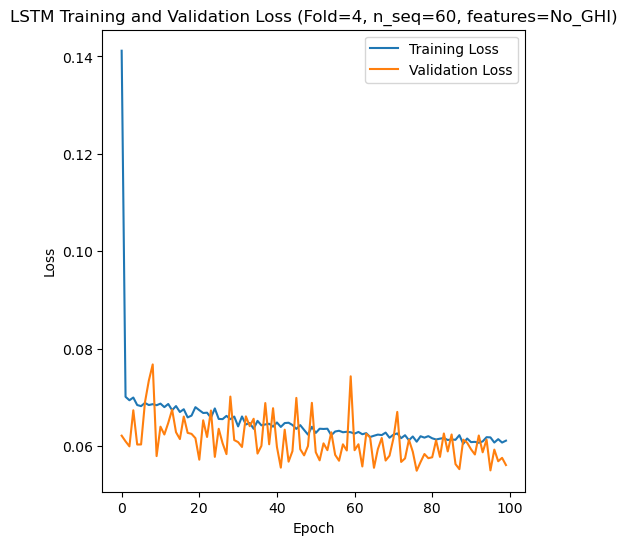

[[1.4399798146885074], [1.422261390331534], [1.6564523287488166], [2.0940027868780593], [1.522053837587417]]
[[array(1.43997981)], [array(1.42226139)], [array(1.65645233)], [array(2.09400279)], [array(1.52205384)]]
[[1.1175692276995286], [1.1354834109581444], [1.2610834166999119], [1.6847259799219452], [1.1621127519749783]]
[[0.9250898359831402], [1.1759809997219046], [0.8918001589816535], [1.3200180990403438], [0.873940156305079]]
[[0.8925569638851991], [0.8977779014961105], [0.8519521639486267], [0.6615909070983704], [0.8849343873211145]]
[[array(0.09999346)], [array(0.2780607)], [array(0.39711598)], [array(0.43554059)], [array(0.44985116)]]
[[array(0.90367978)], [array(0.90413836)], [array(0.86005462)], [array(0.74536359)], [array(0.8981008)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[0.67261924 0.4426064  0.15591665 ... 8.65997947 6.51113952 3.01873578]
Accuracy Results:
RMSE for each fold:
[[1.4399798146885074], [1.422261390331534], [1.6564523287488166], [2.0940027868780593], [1.522053

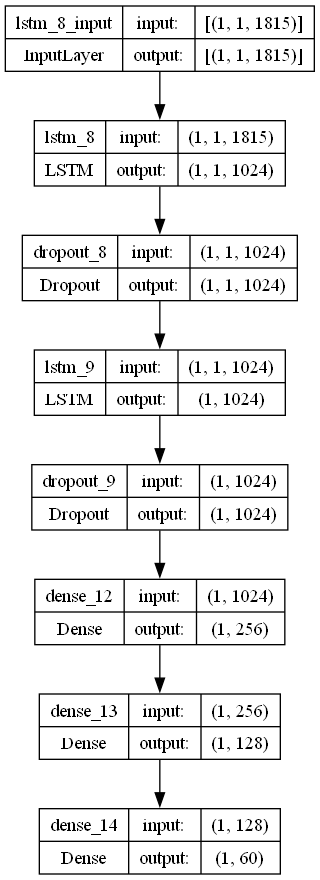

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.06159798934538093
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.33005465858705746

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)